In [28]:
import os
LOAD = False         # True = load previously saved model from disk?  False = (re)train the model
SAVE = "\_TFT_model_02.pth.tar"   # file name to save the model under

EPOCHS = 200
INLEN = 16          # input size
HIDDEN = 32         # hidden layers    
LSTMLAYERS = 2      # recurrent layers

ATTH = 2            # attention heads
BATCH = 64          # batch size
LEARN = 1e-3        # learning rate
DROPOUT = 0.1       # dropout rate
VALWAIT = 1         # epochs to wait before evaluating the loss on the test/validation set
N_FC = 2            # output size

RAND = 42           # random seed
N_SAMPLES = 100     # number of times a prediction is sampled from a probabilistic model
N_JOBS = -1          # parallel processors to use;  -1 = all processors

# default quantiles for QuantileRegression
QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99]

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

mpath = os.path.abspath(os.getcwd()) + SAVE     # path and file name to save the model

In [29]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno

import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)


from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, TFTModel
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [30]:
import pandas as pd
xls = pd.ExcelFile('../../data_complete.xlsx')
df_radon={}
for key in ['48','9']:
    df_radon[key] = pd.read_excel(xls, key)
    df_radon[key] = df_radon[key].loc[(df_radon[key]['SyncDate']>='2022-11-10')]

In [31]:
df_radon.keys()

dict_keys(['48', '9'])

In [32]:
#using 21 as the example since it has the most data
df = df_radon['48']

In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2166 entries, 0 to 2165
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     2166 non-null   object        
 1   DeviceName   2166 non-null   object        
 2   SyncDate     2166 non-null   datetime64[ns]
 3   Radon        2166 non-null   float64       
 4   eC02         2166 non-null   int64         
 5   VOC          2166 non-null   int64         
 6   Temperature  2166 non-null   int64         
 7   AirPressure  2166 non-null   float64       
 8   Humidity     2166 non-null   int64         
 9   LogIndex     2166 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 186.1+ KB


In [34]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [35]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:05:58,49,61,30.02,28.90
1,2023-02-11 16:05:58,56,53,30.08,25.40
2,2023-02-11 15:05:58,58,51,30.08,25.30
3,2023-02-11 14:05:58,57,51,30.13,25.30
4,2023-02-11 12:05:58,61,49,30.15,28.40
...,...,...,...,...,...
2161,2022-11-10 04:30:42,64,50,30.16,43.80
2162,2022-11-10 03:30:42,64,50,30.19,43.40
2163,2022-11-10 02:30:42,63,50,30.21,42.80
2164,2022-11-10 01:30:42,63,50,30.23,42.40


In [36]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [37]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,67.09,53.36,30.06,42.69
2022-11-11,69.29,69.62,29.67,74.10
2022-11-12,64.74,71.04,29.92,58.15
2022-11-13,52.42,60.21,30.14,12.51
2022-11-14,52.50,53.75,30.23,26.52
...,...,...,...,...
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65
2023-02-09,63.95,59.23,30.13,0.78


In [38]:
df = df[df.index<= '2023-02-10']

In [39]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,67.09,53.36,30.06,42.69
2022-11-11,69.29,69.62,29.67,74.10
2022-11-12,64.74,71.04,29.92,58.15
2022-11-13,52.42,60.21,30.14,12.51
2022-11-14,52.50,53.75,30.23,26.52
...,...,...,...,...
2023-02-06,63.92,46.08,30.17,3.23
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65


In [40]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [41]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [42]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [43]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [44]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [45]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,67.09,53.36,30.06,42.69,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,69.29,69.62,29.67,74.10,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,64.74,71.04,29.92,58.15,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,52.42,60.21,30.14,12.51,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,52.50,53.75,30.23,26.52,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,63.92,46.08,30.17,3.23,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,61.57,45.22,30.27,0.68,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,64.96,49.57,30.24,0.65,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [46]:
df.dropna(inplace=True)

In [47]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,67.09,53.36,30.06,42.69,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,69.29,69.62,29.67,74.10,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,64.74,71.04,29.92,58.15,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,52.42,60.21,30.14,12.51,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,52.50,53.75,30.23,26.52,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,63.92,46.08,30.17,3.23,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,61.57,45.22,30.27,0.68,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,64.96,49.57,30.24,0.65,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [48]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [49]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [50]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,56.12,58.15,30.14,26.46,47.34,0.24,0.96,5.17,303.79,0.01,0.31,0.13,0.98,5.63,56.98,29.10,78.09,29.10,316.21,0.16
std,7.21,8.18,0.14,24.13,9.00,0.20,0.69,2.50,14.58,0.02,0.57,0.33,1.19,4.22,6.71,0.14,12.73,0.14,7.93,0.17
min,29.26,45.18,29.67,0.65,15.70,0.01,0.03,1.54,244.70,0.00,0.00,0.00,0.00,0.00,44.87,28.62,46.78,28.62,279.18,0.00
25%,51.35,50.53,30.08,7.19,41.37,0.11,0.55,3.48,297.14,0.00,0.00,0.00,0.02,2.26,51.28,29.03,68.00,29.03,312.97,0.05
50%,56.54,57.75,30.15,19.84,47.84,0.20,0.80,4.46,306.77,0.00,0.03,0.00,0.39,5.66,57.15,29.11,78.39,29.11,317.25,0.12
75%,61.50,64.14,30.24,39.30,53.41,0.32,1.28,6.24,312.58,0.01,0.32,0.06,1.96,9.55,61.85,29.19,89.34,29.19,321.45,0.23
max,70.67,78.54,30.47,126.92,64.71,1.11,3.77,15.20,326.26,0.08,3.20,1.72,3.83,14.68,67.42,29.42,98.48,29.42,329.03,0.98


In [51]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [52]:
df.fillna(0, inplace=True)

In [53]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Hourly Rain (in/hr)_lag_1,0.55
Event Rain (in),0.54
Daily Rain (in)_lag_1,0.48
Event Rain (in)_lag_1,0.38
...,...
AirPressure_lag_28,-0.61
Relative Pressure (inHg)_lag_28,-0.61
Absolute Pressure (inHg)_lag_28,-0.61
Wind Direction (°)_lag_31,-0.61


In [54]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Hourly Rain (in/hr)_lag_1 0.5546459778899299
Event Rain (in) 0.5360131048260441
Daily Rain (in)_lag_1 0.47765605640919573
Event Rain (in)_lag_1 0.37541823344017267
Humidity 0.3181091764202079
Weekly Rain (in) 0.31393738031915136
Daily Rain (in) 0.2835731156648987
Hourly Rain (in/hr) 0.24777441162026495
Humidity (%) 0.23493581458401516
Outdoor h Temperature (°F) 0.20460720403318847
Avg Wind Speed (10 mins) (mph)_lag_9 0.18838973782044807
Outdoor h Temperature (°F)_lag_1 0.16915092137399904
Temperature 0.1577985156357368
Humidity (%)_lag_1 0.15579876324407793
Wind Speed (mph)_lag_9 0.13965498070396953
Daily Rain (in)_lag_6 0.12998652101504007
Avg Wind Speed (10 mins) (mph)_lag_10 0.12316062900139065
Avg Wind Speed (10 mins) (mph)_lag_8 0.1222354479197011
Hourly Rain (in/hr)_lag_2 0.11587552135030901
Humidity_lag_1 0.1109442881686777
Wind Gust (mph)_lag_9 0.10262064495777211
Hourly Rain (in/hr)_lag_20 0.10117911878591279
Wind Speed (mph)_lag_10 0.09947981403403568
Weekly Rain (i

In [55]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
# df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.35]
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.54]
df_corrH

,Radon
Radon,1.00
Hourly Rain (in/hr)_lag_1,0.55
Humidity (%)_lag_31,-0.54
Monthly Rain (in)_lag_28,-0.54
Yearly Rain (in)_lag_35,-0.54
...,...
AirPressure_lag_28,-0.61
Relative Pressure (inHg)_lag_28,-0.61
Absolute Pressure (inHg)_lag_28,-0.61
Wind Direction (°)_lag_31,-0.61


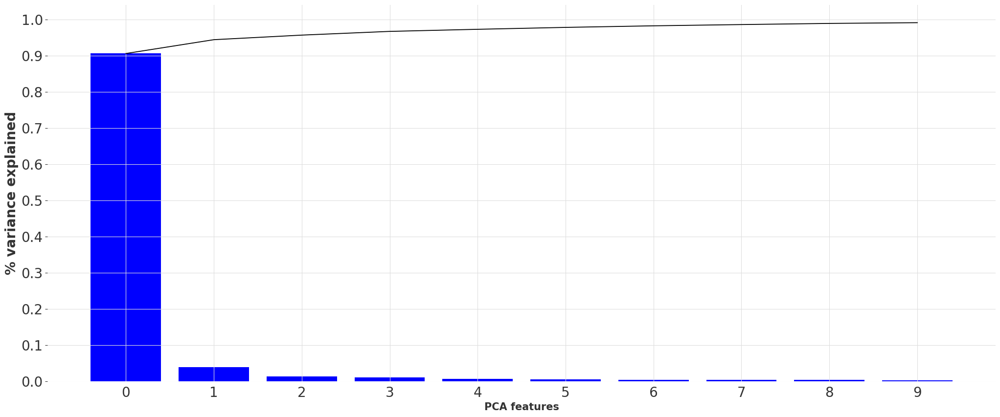

In [56]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import FastICA, PCA
df_feat = df[df_corrH.index]
df_feat = df_feat.loc[:, df_feat.columns != "Radon"]
df_feat =MinMaxScaler().fit_transform(df_feat)
pca = PCA(n_components=10)
res_pca = pca.fit_transform(df_feat)
# scree plot
features = range(pca.n_components_)
plt.figure(figsize = (25,10))
plt.bar(features, pca.explained_variance_ratio_, color="blue")
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("PCA features", fontsize=15)
plt.ylabel("% variance explained", fontsize=20)
plt.xticks(features, fontsize=20)
plt.yticks(ticks=np.arange(0.0, 1.0001, 0.1), fontsize=20);

In [57]:
# collect principal components in a dataframe
df_pca = pd.DataFrame(res_pca)
df_pca = df_pca.add_prefix("pca")


df3 = df.copy()
col = df3.pop("Radon")
df3.insert(0, col.name, col)     # move price column to the left

# drop the feature columns which the components summarize
df3.reset_index(inplace=True)
df3 = pd.concat([df3, df_pca], axis=1)
for col in df3.columns:
    if col != "Radon" and col != "SyncDate" and "pca" not in col:
        del df3[col]
df3.set_index("SyncDate", inplace=True)
df3.columns

Index(['Radon', 'pca0', 'pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7',
       'pca8', 'pca9'],
      dtype='object')

In [58]:
# prepare correlation matrix for principal components  
df_corr = df3.corr(method="pearson")
print("principal components with at least modest correlation to price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))

# absolute correlations with price > 10%
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) > 0.10]
df_corrH

principal components with at least modest correlation to price:


,Radon
Radon,1.00
pca0,0.61
pca6,0.43
pca5,0.21
pca4,0.17
pca3,0.10
pca2,-0.11


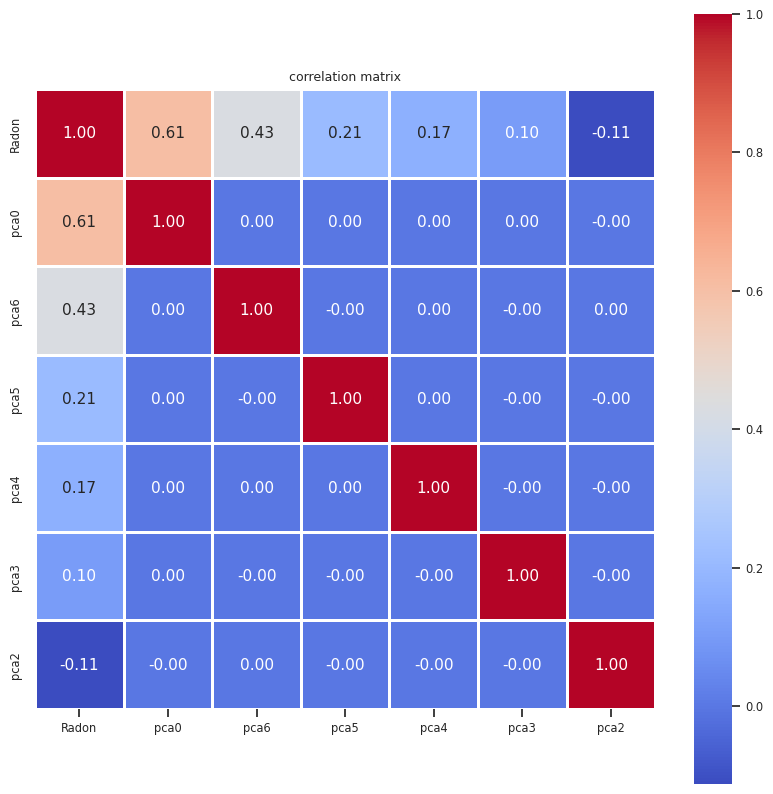

In [59]:
# helper method: correlation matrix as heatmap
def corr_heatmap(df):
    idx = df.corr().sort_values("Radon", ascending=False).index
    df_sorted = df.loc[:, idx]  # sort dataframe columns by their correlation 

    #plt.figure(figsize = (15,15))
    sns.set(font_scale=0.75)
    ax = sns.heatmap(df_sorted.corr().round(3), 
            annot=True, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
    ax.xaxis.tick_bottom()
    plt.title("correlation matrix")
    plt.show()



# visualize correlations with price     
df4 = df3.copy()
df4 = df4[df_corrH.index]   # keep the components with at least modest correlations

plt.figure(figsize = (10,10))
corr_heatmap(df4)

In [60]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-11-10 to 2023-02-10
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Radon   93 non-null     float32
 1   pca0    93 non-null     float32
 2   pca6    93 non-null     float32
 3   pca5    93 non-null     float32
 4   pca4    93 non-null     float32
 5   pca3    93 non-null     float32
 6   pca2    93 non-null     float32
dtypes: float32(7)
memory usage: 3.3 KB


In [61]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df4["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [63]:
# create time series object for the feature columns
df_covF = df4.loc[:, df4.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['pca0', 'pca6', 'pca5', 'pca4', 'pca3', 'pca2'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: False


In [64]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 6, 1)

In [65]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [66]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-11-10 00:00:00
training end: 2023-01-22 00:00:00
training duration: 73 days 00:00:00
test start: 2023-01-23 00:00:00
test end: 2023-02-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-11-10,0.33
2023-02-10,0.08


In [67]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,pca0,pca6,pca5,pca4,pca3,pca2
SyncDate,,,,,,
2022-11-10,1.00,0.31,0.37,0.49,0.47,0.46
2023-02-10,0.02,0.38,0.38,0.51,0.16,0.67


In [68]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-11-10,0.33
2023-01-22,0.42


In [69]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [70]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [71]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=1000
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [72]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-22 22:20:35 (running for 00:00:00.17)
Memory usage on this node: 2.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |          lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+---------

(build_fit_tft_model pid=1004998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1004998)   rank_zero_deprecation(
(build_fit_tft_model pid=1004998) Auto select gpus: [0]
(build_fit_tft_model pid=1004998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1004998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1004998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1004998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1004998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1004998) 
(build_fit_tft_model pid=1004998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1004998) ---------------

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_00001e96,2023-02-23_00-02-15,True,,5a9d423d72f84f1f80d9fd7dde62ff75,ip-172-31-10-87,10,0.247209,172.31.10.87,1097676,1.57846,11.8172,0.578715,11.8172,1677110535,0,,10,00001e96,0.00562763
build_fit_tft_model_0064d8b0,2023-02-22_23-40-32,True,,b2fe50e172b04c9386ca6564cea9aa7c,ip-172-31-10-87,40,0.119423,172.31.10.87,1069268,1.38504,17.2796,0.309045,17.2796,1677109232,0,,40,0064d8b0,0.00858235
build_fit_tft_model_01750520,2023-02-22_23-07-31,True,,a2588f4ee3954c9c91b21b9ef0c650ca,ip-172-31-10-87,91,0.125369,172.31.10.87,1026047,1.41047,20.5347,0.18488,20.5347,1677107251,0,,91,01750520,0.00483918
build_fit_tft_model_01e80a0e,2023-02-22_23-54-18,True,,ad8666e9e5e049a8a08d51fc10ab6b17,ip-172-31-10-87,48,0.142353,172.31.10.87,1086894,1.31487,20.5871,0.32248,20.5871,1677110058,0,,48,01e80a0e,0.00588107
build_fit_tft_model_02141ac3,2023-02-22_23-15-51,True,,ed50d4b548c14b3696d48de0f669a571,ip-172-31-10-87,20,0.262157,172.31.10.87,1036831,1.65781,12.4359,0.240975,12.4359,1677107751,0,,20,02141ac3,0.00723338
build_fit_tft_model_024812b0,2023-02-22_23-05-20,True,,7ffc5b832b994d1ea7365739d9562355,ip-172-31-10-87,20,0.207169,172.31.10.87,1024756,1.59678,7.90902,0.191324,7.90902,1677107120,0,,20,024812b0,0.00466537
build_fit_tft_model_02949081,2023-02-23_00-08-20,True,,c54d6a38f5f34996996e010a1f94e6d0,ip-172-31-10-87,22,0.226792,172.31.10.87,1105457,1.38215,17.7893,0.707042,17.7893,1677110900,0,,22,02949081,0.0096035
build_fit_tft_model_02d05677,2023-02-22_22-46-38,True,,2f7d56e019fc43ac8f9c1bfa37d30f9e,ip-172-31-10-87,10,1.38891,172.31.10.87,1013288,1.88352,5.51101,0.164511,5.51101,1677105998,0,,10,02d05677,0.00452828
build_fit_tft_model_047061df,2023-02-23_01-01-57,True,,ee380b1c1ca34700a436d8d2b03c19be,ip-172-31-10-87,40,0.106307,172.31.10.87,1173728,1.29886,18.338,0.292128,18.338,1677114117,0,,40,047061df,0.00728488
build_fit_tft_model_04f27cbe,2023-02-22_22-27-03,True,,ff81557810794fa28bcc11b4f4642179,ip-172-31-10-87,67,0.127225,172.31.10.87,1006893,1.40209,14.9296,0.166443,14.9296,1677104823,0,,67,04f27cbe,0.00470805


== Status ==
Current time: 2023-02-22 22:20:47 (running for 00:00:11.57)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1d7f2582 with sMAPE=1.8624687194824219 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.21247522103623484, 'lr': 0.0001366386746784277, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------+---------+----------------------+
| Trial name                   | statu

(build_fit_tft_model pid=1005091) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005091)   rank_zero_deprecation(
(build_fit_tft_model pid=1005091) Auto select gpus: [0]
(build_fit_tft_model pid=1005091) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005091) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005091) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005091) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005091) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005091) 
(build_fit_tft_model pid=1005091)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005091) ---------------

== Status ==
Current time: 2023-02-22 22:21:09 (running for 00:00:34.10)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.838674783706665 | Iter 20.000: -1.721142292022705 | Iter 10.000: -1.8071839809417725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1d7f2582 with sMAPE=1.6091244220733643 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.21247522103623484, 'lr': 0.0001366386746784277, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1005177) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005177)   rank_zero_deprecation(
(build_fit_tft_model pid=1005177) Auto select gpus: [0]
(build_fit_tft_model pid=1005177) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005177) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005177) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005177) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005177) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005177) 
(build_fit_tft_model pid=1005177)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005177) ---------------

== Status ==
Current time: 2023-02-22 22:21:27 (running for 00:00:51.56)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.838674783706665 | Iter 20.000: -1.7196345329284668 | Iter 10.000: -1.6971821784973145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4593f576 with sMAPE=1.4984320402145386 and parameters={'in_len': 8, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 1, 'dropout': 0.13855900346655758, 'lr': 5.415105266265682e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1005263) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005263)   rank_zero_deprecation(
(build_fit_tft_model pid=1005263) Auto select gpus: [0]
(build_fit_tft_model pid=1005263) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005263) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005263) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005263) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005263) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005263) 
(build_fit_tft_model pid=1005263)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005263) ---------------

== Status ==
Current time: 2023-02-22 22:21:42 (running for 00:01:07.01)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.838674783706665 | Iter 20.000: -1.7181267738342285 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4593f576 with sMAPE=1.4984320402145386 and parameters={'in_len': 8, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 1, 'dropout': 0.13855900346655758, 'lr': 5.415105266265682e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1005349) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1005349)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1005349) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005349)   rank_zero_deprecation(
(build_fit_tft_model pid=1005349) Auto select gpus: [0]
(build_fit_tft_model pid=1005349) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005349) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005349) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005349) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:21:56 (running for 00:01:20.99)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.838674783706665 | Iter 20.000: -1.7181267738342285 | Iter 10.000: -1.6508862972259521
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 4593f576 with sMAPE=1.4984320402145386 and parameters={'in_len': 8, 'out_len': 1, 'lstm_layers': 3, 'num_attention_heads': 1, 'dropout': 0.13855900346655758, 'lr': 5.415105266265682e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

== Status ==
Current time: 2023-02-22 22:22:16 (running for 00:01:40.43)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.640245258808136 | Iter 20.000: -1.6593904495239258 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cfd4b77d with sMAPE=1.4618812799453735 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.3981763901438081, 'lr': 0.04748881358493885, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-----

(build_fit_tft_model pid=1005436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005436)   rank_zero_deprecation(
(build_fit_tft_model pid=1005436) Auto select gpus: [0]
(build_fit_tft_model pid=1005436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005436) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005436) 
(build_fit_tft_model pid=1005436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005436) ---------------

== Status ==
Current time: 2023-02-22 22:22:21 (running for 00:01:45.86)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.640245258808136 | Iter 20.000: -1.6593904495239258 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cfd4b77d with sMAPE=1.4618812799453735 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.3981763901438081, 'lr': 0.04748881358493885, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-----

(build_fit_tft_model pid=1005523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005523)   rank_zero_deprecation(
(build_fit_tft_model pid=1005523) Auto select gpus: [0]
(build_fit_tft_model pid=1005523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005523) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005523) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005523) 
(build_fit_tft_model pid=1005523)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005523) ---------------

== Status ==
Current time: 2023-02-22 22:22:34 (running for 00:01:58.84)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.640245258808136 | Iter 20.000: -1.6593904495239258 | Iter 10.000: -1.6481854915618896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cfd4b77d with sMAPE=1.4618812799453735 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.3981763901438081, 'lr': 0.04748881358493885, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-----

== Status ==
Current time: 2023-02-22 22:22:51 (running for 00:02:15.43)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6116899251937866 | Iter 20.000: -1.600654125213623 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1005610) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005610)   rank_zero_deprecation(
(build_fit_tft_model pid=1005610) Auto select gpus: [0]
(build_fit_tft_model pid=1005610) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005610) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005610) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005610) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005610) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005610) 
(build_fit_tft_model pid=1005610)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005610) ---------------

== Status ==
Current time: 2023-02-22 22:22:56 (running for 00:02:20.91)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6116899251937866 | Iter 20.000: -1.600654125213623 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1005695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005695)   rank_zero_deprecation(
(build_fit_tft_model pid=1005695) Auto select gpus: [0]
(build_fit_tft_model pid=1005695) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005695) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005695) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005695) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005695) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005695) 
(build_fit_tft_model pid=1005695)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005695) ---------------

== Status ==
Current time: 2023-02-22 22:23:14 (running for 00:02:39.07)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5267528295516968 | Iter 20.000: -1.5719180703163147 | Iter 10.000: -1.5814043879508972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1005780) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005780)   rank_zero_deprecation(
(build_fit_tft_model pid=1005780) Auto select gpus: [0]
(build_fit_tft_model pid=1005780) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005780) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005780) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005780) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005780) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005780) 
(build_fit_tft_model pid=1005780)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005780) ---------------

== Status ==
Current time: 2023-02-22 22:23:28 (running for 00:02:52.92)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5267528295516968 | Iter 20.000: -1.5719180703163147 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1005866) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1005866)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1005866) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005866)   rank_zero_deprecation(
(build_fit_tft_model pid=1005866) Auto select gpus: [0]
(build_fit_tft_model pid=1005866) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005866) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005866) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005866) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:23:41 (running for 00:03:05.92)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5267528295516968 | Iter 20.000: -1.5719180703163147 | Iter 10.000: -1.590219259262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1005951) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1005951)   rank_zero_deprecation(
(build_fit_tft_model pid=1005951) Auto select gpus: [0]
(build_fit_tft_model pid=1005951) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1005951) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1005951) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1005951) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1005951) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1005951) 
(build_fit_tft_model pid=1005951)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1005951) ---------------

== Status ==
Current time: 2023-02-22 22:23:54 (running for 00:03:18.88)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5267528295516968 | Iter 20.000: -1.5719180703163147 | Iter 10.000: -1.5932581424713135
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1006038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006038)   rank_zero_deprecation(
(build_fit_tft_model pid=1006038) Auto select gpus: [0]
(build_fit_tft_model pid=1006038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006038) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006038) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006038) 
(build_fit_tft_model pid=1006038)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006038) ---------------

== Status ==
Current time: 2023-02-22 22:24:08 (running for 00:03:32.86)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5267528295516968 | Iter 20.000: -1.600654125213623 | Iter 10.000: -1.590219259262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1006123) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006123)   rank_zero_deprecation(
(build_fit_tft_model pid=1006123) Auto select gpus: [0]
(build_fit_tft_model pid=1006123) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006123) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006123) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006123) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006123) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006123) 
(build_fit_tft_model pid=1006123)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006123) ---------------

== Status ==
Current time: 2023-02-22 22:24:23 (running for 00:03:47.92)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5267528295516968 | Iter 20.000: -1.5737111568450928 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1006207) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006207)   rank_zero_deprecation(
(build_fit_tft_model pid=1006207) Auto select gpus: [0]
(build_fit_tft_model pid=1006207) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006207) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006207) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006207) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006207) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006207) 
(build_fit_tft_model pid=1006207)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006207) ---------------

== Status ==
Current time: 2023-02-22 22:24:35 (running for 00:03:59.88)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5267528295516968 | Iter 20.000: -1.5737111568450928 | Iter 10.000: -1.590219259262085
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-22 22:24:48 (running for 00:04:12.47)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6001086235046387 | Iter 20.000: -1.5467681884765625 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1006293) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006293)   rank_zero_deprecation(
(build_fit_tft_model pid=1006293) Auto select gpus: [0]
(build_fit_tft_model pid=1006293) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006293) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006293) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006293) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006293) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006293) 
(build_fit_tft_model pid=1006293)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006293) ---------------

== Status ==
Current time: 2023-02-22 22:24:53 (running for 00:04:17.87)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6001086235046387 | Iter 20.000: -1.5467681884765625 | Iter 10.000: -1.5871803760528564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-22 22:25:03 (running for 00:04:28.00)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5209621787071228 | Iter 20.000: -1.5449751019477844 | Iter 10.000: -1.5814043879508972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1006381) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006381)   rank_zero_deprecation(
(build_fit_tft_model pid=1006381) Auto select gpus: [0]
(build_fit_tft_model pid=1006381) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006381) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006381) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006381) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006381) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006381) 
(build_fit_tft_model pid=1006381)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006381) ---------------

== Status ==
Current time: 2023-02-22 22:25:16 (running for 00:04:40.86)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5209621787071228 | Iter 20.000: -1.5449751019477844 | Iter 10.000: -1.5814043879508972
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1006466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006466)   rank_zero_deprecation(
(build_fit_tft_model pid=1006466) Auto select gpus: [0]
(build_fit_tft_model pid=1006466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006466) 
(build_fit_tft_model pid=1006466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006466) ---------------

== Status ==
Current time: 2023-02-22 22:25:32 (running for 00:04:56.84)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5209621787071228 | Iter 20.000: -1.5431820154190063 | Iter 10.000: -1.575628399848938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1006551) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006551)   rank_zero_deprecation(
(build_fit_tft_model pid=1006551) Auto select gpus: [0]
(build_fit_tft_model pid=1006551) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006551) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006551) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006551) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006551) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006551) 
(build_fit_tft_model pid=1006551)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006551) ---------------

== Status ==
Current time: 2023-02-22 22:25:45 (running for 00:05:09.89)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.5209621787071228 | Iter 20.000: -1.5431820154190063 | Iter 10.000: -1.5809579491615295
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-22 22:25:55 (running for 00:05:20.03)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.441815733909607 | Iter 20.000: -1.5318716764450073 | Iter 10.000: -1.575628399848938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1006640) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006640)   rank_zero_deprecation(
(build_fit_tft_model pid=1006640) Auto select gpus: [0]
(build_fit_tft_model pid=1006640) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006640) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006640) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006640) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006640) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006640) 
(build_fit_tft_model pid=1006640)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006640) ---------------

== Status ==
Current time: 2023-02-22 22:26:10 (running for 00:05:34.96)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.441815733909607 | Iter 20.000: -1.5318716764450073 | Iter 10.000: -1.575628399848938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1006724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006724)   rank_zero_deprecation(
(build_fit_tft_model pid=1006724) Auto select gpus: [0]
(build_fit_tft_model pid=1006724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006724) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006724) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006724) 
(build_fit_tft_model pid=1006724)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006724) ---------------

== Status ==
Current time: 2023-02-22 22:26:25 (running for 00:05:49.94)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.441815733909607 | Iter 20.000: -1.5431820154190063 | Iter 10.000: -1.5745677947998047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1006807) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006807)   rank_zero_deprecation(
(build_fit_tft_model pid=1006807) Auto select gpus: [0]
(build_fit_tft_model pid=1006807) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006807) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006807) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006807) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006807) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006807) 
(build_fit_tft_model pid=1006807)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006807) ---------------

== Status ==
Current time: 2023-02-22 22:26:38 (running for 00:06:02.85)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.441815733909607 | Iter 20.000: -1.5431820154190063 | Iter 10.000: -1.575628399848938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1006893) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006893)   rank_zero_deprecation(
(build_fit_tft_model pid=1006893) Auto select gpus: [0]
(build_fit_tft_model pid=1006893) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006893) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006893) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006893) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006893) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006893) 
(build_fit_tft_model pid=1006893)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006893) ---------------

== Status ==
Current time: 2023-02-22 22:26:52 (running for 00:06:16.89)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.441815733909607 | Iter 20.000: -1.5449751019477844 | Iter 10.000: -1.5745677947998047
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:27:02 (running for 00:06:27.09)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4060996174812317 | Iter 20.000: -1.5431820154190063 | Iter 10.000: -1.5735071897506714
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1006981) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1006981)   rank_zero_deprecation(
(build_fit_tft_model pid=1006981) Auto select gpus: [0]
(build_fit_tft_model pid=1006981) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1006981) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1006981) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1006981) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1006981) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1006981) 
(build_fit_tft_model pid=1006981)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1006981) ---------------

== Status ==
Current time: 2023-02-22 22:27:14 (running for 00:06:38.94)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4060996174812317 | Iter 20.000: -1.5431820154190063 | Iter 10.000: -1.5735071897506714
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:27:25 (running for 00:06:49.54)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4060996174812317 | Iter 20.000: -1.5318716764450073 | Iter 10.000: -1.5703197717666626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1007066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1007066)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1007066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007066)   rank_zero_deprecation(
(build_fit_tft_model pid=1007066) Auto select gpus: [0]
(build_fit_tft_model pid=1007066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007066) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:27:30 (running for 00:06:54.99)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4060996174812317 | Iter 20.000: -1.5318716764450073 | Iter 10.000: -1.5703197717666626
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:27:40 (running for 00:07:05.13)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4060996174812317 | Iter 20.000: -1.5205613374710083 | Iter 10.000: -1.5671323537826538
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1007152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1007152)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1007152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007152)   rank_zero_deprecation(
(build_fit_tft_model pid=1007152) Auto select gpus: [0]
(build_fit_tft_model pid=1007152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007152) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:27:52 (running for 00:07:16.91)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.5205613374710083 | Iter 10.000: -1.5671323537826538
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:28:02 (running for 00:07:27.22)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.5121615529060364 | Iter 10.000: -1.563991367816925
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:28:14 (running for 00:07:38.48)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.392240285873413 | Iter 20.000: -1.5121615529060364 | Iter 10.000: -1.563991367816925
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1007240) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007240)   rank_zero_deprecation(
(build_fit_tft_model pid=1007240) Auto select gpus: [0]
(build_fit_tft_model pid=1007240) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007240) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007240) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007240) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007240) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007240) 
(build_fit_tft_model pid=1007240)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007240) ---------------

== Status ==
Current time: 2023-02-22 22:28:19 (running for 00:07:43.87)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.392240285873413 | Iter 20.000: -1.5121615529060364 | Iter 10.000: -1.563991367816925
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1007325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007325)   rank_zero_deprecation(
(build_fit_tft_model pid=1007325) Auto select gpus: [0]
(build_fit_tft_model pid=1007325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007325) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007325) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007325) 
(build_fit_tft_model pid=1007325)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007325) ---------------

== Status ==
Current time: 2023-02-22 22:28:31 (running for 00:07:55.88)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.392240285873413 | Iter 20.000: -1.5121615529060364 | Iter 10.000: -1.5671323537826538
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1007410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007410)   rank_zero_deprecation(
(build_fit_tft_model pid=1007410) Auto select gpus: [0]
(build_fit_tft_model pid=1007410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007410) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007410) 
(build_fit_tft_model pid=1007410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007410) ---------------

== Status ==
Current time: 2023-02-22 22:28:45 (running for 00:08:09.89)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.392240285873413 | Iter 20.000: -1.5160939693450928 | Iter 10.000: -1.563991367816925
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1007494) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007494)   rank_zero_deprecation(
(build_fit_tft_model pid=1007494) Auto select gpus: [0]
(build_fit_tft_model pid=1007494) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007494) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007494) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007494) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007494) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007494) 
(build_fit_tft_model pid=1007494)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007494) ---------------

== Status ==
Current time: 2023-02-22 22:28:57 (running for 00:08:21.93)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.392240285873413 | Iter 20.000: -1.5160939693450928 | Iter 10.000: -1.5671323537826538
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1007580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007580)   rank_zero_deprecation(
(build_fit_tft_model pid=1007580) Auto select gpus: [0]
(build_fit_tft_model pid=1007580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007580) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007580) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007580) 
(build_fit_tft_model pid=1007580)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007580) ---------------

== Status ==
Current time: 2023-02-22 22:29:11 (running for 00:08:35.86)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.392240285873413 | Iter 20.000: -1.5183276534080505 | Iter 10.000: -1.563991367816925
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:29:22 (running for 00:08:46.51)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.5160939693450928 | Iter 10.000: -1.5608503818511963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1007665) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007665)   rank_zero_deprecation(
(build_fit_tft_model pid=1007665) Auto select gpus: [0]
(build_fit_tft_model pid=1007665) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007665) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007665) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007665) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007665) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007665) 
(build_fit_tft_model pid=1007665)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007665) ---------------

== Status ==
Current time: 2023-02-22 22:29:30 (running for 00:08:54.55)
Memory usage on this node: 4.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.5160939693450928 | Iter 10.000: -1.5608503818511963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:29:43 (running for 00:09:07.50)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4243520498275757 | Iter 20.000: -1.512905776500702 | Iter 10.000: -1.5596388578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1007752) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007752)   rank_zero_deprecation(
(build_fit_tft_model pid=1007752) Auto select gpus: [0]
(build_fit_tft_model pid=1007752) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007752) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007752) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007752) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007752) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007752) 
(build_fit_tft_model pid=1007752)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007752) ---------------

== Status ==
Current time: 2023-02-22 22:29:48 (running for 00:09:13.07)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4243520498275757 | Iter 20.000: -1.512905776500702 | Iter 10.000: -1.5596388578414917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:29:58 (running for 00:09:23.28)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.509717583656311 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1007841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007841)   rank_zero_deprecation(
(build_fit_tft_model pid=1007841) Auto select gpus: [0]
(build_fit_tft_model pid=1007841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007841) 
(build_fit_tft_model pid=1007841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007841) ---------------

== Status ==
Current time: 2023-02-22 22:30:13 (running for 00:09:37.69)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.509717583656311 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:30:26 (running for 00:09:50.50)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.5067396759986877 | Iter 10.000: -1.549325406551361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1007927) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1007927)   rank_zero_deprecation(
(build_fit_tft_model pid=1007927) Auto select gpus: [0]
(build_fit_tft_model pid=1007927) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1007927) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1007927) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1007927) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1007927) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1007927) 
(build_fit_tft_model pid=1007927)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1007927) ---------------

== Status ==
Current time: 2023-02-22 22:30:31 (running for 00:09:55.99)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.5067396759986877 | Iter 10.000: -1.549325406551361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1008020) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008020)   rank_zero_deprecation(
(build_fit_tft_model pid=1008020) Auto select gpus: [0]
(build_fit_tft_model pid=1008020) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008020) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008020) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008020) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008020) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008020) 
(build_fit_tft_model pid=1008020)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008020) ---------------

== Status ==
Current time: 2023-02-22 22:30:44 (running for 00:10:09.23)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.5067396759986877 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1008107) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1008107)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1008107) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008107)   rank_zero_deprecation(
(build_fit_tft_model pid=1008107) Auto select gpus: [0]
(build_fit_tft_model pid=1008107) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008107) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008107) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008107) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:30:57 (running for 00:10:22.16)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.5067396759986877 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008194) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008194)   rank_zero_deprecation(
(build_fit_tft_model pid=1008194) Auto select gpus: [0]
(build_fit_tft_model pid=1008194) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008194) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008194) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008194) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008194) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008194) 
(build_fit_tft_model pid=1008194)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008194) ---------------

== Status ==
Current time: 2023-02-22 22:31:13 (running for 00:10:38.10)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.5067396759986877 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008280)   rank_zero_deprecation(
(build_fit_tft_model pid=1008280) Auto select gpus: [0]
(build_fit_tft_model pid=1008280) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008280) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008280) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008280) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008280) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008280) 
(build_fit_tft_model pid=1008280)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008280) ---------------

== Status ==
Current time: 2023-02-22 22:31:27 (running for 00:10:52.37)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.5067396759986877 | Iter 10.000: -1.5599068403244019
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:31:38 (running for 00:11:02.78)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.5037617683410645 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008366) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008366)   rank_zero_deprecation(
(build_fit_tft_model pid=1008366) Auto select gpus: [0]
(build_fit_tft_model pid=1008366) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008366) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008366) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008366) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008366) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008366) 
(build_fit_tft_model pid=1008366)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008366) ---------------

== Status ==
Current time: 2023-02-22 22:31:49 (running for 00:11:14.01)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.5037617683410645 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008451)   rank_zero_deprecation(
(build_fit_tft_model pid=1008451) Auto select gpus: [0]
(build_fit_tft_model pid=1008451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008451) 
(build_fit_tft_model pid=1008451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008451) ---------------

== Status ==
Current time: 2023-02-22 22:32:02 (running for 00:11:27.07)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.5037617683410645 | Iter 10.000: -1.5599068403244019
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008537)   rank_zero_deprecation(
(build_fit_tft_model pid=1008537) Auto select gpus: [0]
(build_fit_tft_model pid=1008537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008537) 
(build_fit_tft_model pid=1008537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008537) ---------------

== Status ==
Current time: 2023-02-22 22:32:17 (running for 00:11:42.13)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.4926108121871948 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008622)   rank_zero_deprecation(
(build_fit_tft_model pid=1008622) Auto select gpus: [0]
(build_fit_tft_model pid=1008622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008622) 
(build_fit_tft_model pid=1008622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008622) ---------------

== Status ==
Current time: 2023-02-22 22:32:30 (running for 00:11:55.06)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.4926108121871948 | Iter 10.000: -1.5599068403244019
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:32:43 (running for 00:12:07.52)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4267295002937317 | Iter 20.000: -1.4814598560333252 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008707)   rank_zero_deprecation(
(build_fit_tft_model pid=1008707) Auto select gpus: [0]
(build_fit_tft_model pid=1008707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008707) 
(build_fit_tft_model pid=1008707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008707) ---------------

== Status ==
Current time: 2023-02-22 22:32:48 (running for 00:12:12.99)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4267295002937317 | Iter 20.000: -1.4814598560333252 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008792) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008792)   rank_zero_deprecation(
(build_fit_tft_model pid=1008792) Auto select gpus: [0]
(build_fit_tft_model pid=1008792) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008792) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008792) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008792) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008792) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008792) 
(build_fit_tft_model pid=1008792)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008792) ---------------

== Status ==
Current time: 2023-02-22 22:33:01 (running for 00:12:26.21)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4267295002937317 | Iter 20.000: -1.4814598560333252 | Iter 10.000: -1.5599068403244019
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:33:16 (running for 00:12:40.52)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.479211449623108 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1008878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008878)   rank_zero_deprecation(
(build_fit_tft_model pid=1008878) Auto select gpus: [0]
(build_fit_tft_model pid=1008878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008878) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008878) 
(build_fit_tft_model pid=1008878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008878) ---------------

== Status ==
Current time: 2023-02-22 22:33:21 (running for 00:12:46.14)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.479211449623108 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:33:33 (running for 00:12:57.54)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.4769630432128906 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1008963) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1008963)   rank_zero_deprecation(
(build_fit_tft_model pid=1008963) Auto select gpus: [0]
(build_fit_tft_model pid=1008963) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1008963) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1008963) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1008963) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1008963) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1008963) 
(build_fit_tft_model pid=1008963)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1008963) ---------------

== Status ==
Current time: 2023-02-22 22:33:38 (running for 00:13:03.13)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4188519716262817 | Iter 20.000: -1.4769630432128906 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:33:53 (running for 00:13:17.52)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.472774624824524 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1009048) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1009048)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1009048) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009048)   rank_zero_deprecation(
(build_fit_tft_model pid=1009048) Auto select gpus: [0]
(build_fit_tft_model pid=1009048) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009048) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009048) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009048) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:33:58 (running for 00:13:23.26)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.472774624824524 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1009134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1009134)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1009134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009134)   rank_zero_deprecation(
(build_fit_tft_model pid=1009134) Auto select gpus: [0]
(build_fit_tft_model pid=1009134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009134) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:34:12 (running for 00:13:37.26)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.472774624824524 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1009233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009233)   rank_zero_deprecation(
(build_fit_tft_model pid=1009233) Auto select gpus: [0]
(build_fit_tft_model pid=1009233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009233) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009233) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009233) 
(build_fit_tft_model pid=1009233)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009233) ---------------

== Status ==
Current time: 2023-02-22 22:34:26 (running for 00:13:51.04)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4164745211601257 | Iter 20.000: -1.472774624824524 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:34:36 (running for 00:14:01.29)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1009319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009319)   rank_zero_deprecation(
(build_fit_tft_model pid=1009319) Auto select gpus: [0]
(build_fit_tft_model pid=1009319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009319) 
(build_fit_tft_model pid=1009319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009319) ---------------

== Status ==
Current time: 2023-02-22 22:34:47 (running for 00:14:12.03)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1009403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009403)   rank_zero_deprecation(
(build_fit_tft_model pid=1009403) Auto select gpus: [0]
(build_fit_tft_model pid=1009403) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009403) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009403) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009403) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009403) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009403) 
(build_fit_tft_model pid=1009403)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009403) ---------------

== Status ==
Current time: 2023-02-22 22:35:01 (running for 00:14:26.12)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4140970706939697 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:35:16 (running for 00:14:40.54)
Memory usage on this node: 3.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1009492) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009492)   rank_zero_deprecation(
(build_fit_tft_model pid=1009492) Auto select gpus: [0]
(build_fit_tft_model pid=1009492) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009492) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009492) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009492) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009492) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009492) 
(build_fit_tft_model pid=1009492)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009492) ---------------

== Status ==
Current time: 2023-02-22 22:35:21 (running for 00:14:46.25)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:35:31 (running for 00:14:56.38)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.467646598815918 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 929aa908 with sMAPE=1.1850886344909668 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.4938831531331197, 'lr': 0.004760019632793558, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1009578) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009578)   rank_zero_deprecation(
(build_fit_tft_model pid=1009578) Auto select gpus: [0]
(build_fit_tft_model pid=1009578) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009578) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009578) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009578) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009578) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009578) 
(build_fit_tft_model pid=1009578)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009578) ---------------

== Status ==
Current time: 2023-02-22 22:35:43 (running for 00:15:08.03)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.467646598815918 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1009663) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009663)   rank_zero_deprecation(
(build_fit_tft_model pid=1009663) Auto select gpus: [0]
(build_fit_tft_model pid=1009663) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009663) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009663) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009663) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009663) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009663) 
(build_fit_tft_model pid=1009663)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009663) ---------------

== Status ==
Current time: 2023-02-22 22:35:56 (running for 00:15:20.98)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.467646598815918 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1009750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009750)   rank_zero_deprecation(
(build_fit_tft_model pid=1009750) Auto select gpus: [0]
(build_fit_tft_model pid=1009750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009750) 
(build_fit_tft_model pid=1009750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009750) ---------------

== Status ==
Current time: 2023-02-22 22:36:11 (running for 00:15:36.16)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4664870500564575 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1009835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009835)   rank_zero_deprecation(
(build_fit_tft_model pid=1009835) Auto select gpus: [0]
(build_fit_tft_model pid=1009835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009835) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009835) 
(build_fit_tft_model pid=1009835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009835) ---------------

== Status ==
Current time: 2023-02-22 22:36:25 (running for 00:15:50.07)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.467646598815918 | Iter 10.000: -1.549325406551361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1009921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1009921)   rank_zero_deprecation(
(build_fit_tft_model pid=1009921) Auto select gpus: [0]
(build_fit_tft_model pid=1009921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1009921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1009921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1009921) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1009921) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1009921) 
(build_fit_tft_model pid=1009921)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1009921) ---------------

== Status ==
Current time: 2023-02-22 22:36:39 (running for 00:16:03.93)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1010005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010005)   rank_zero_deprecation(
(build_fit_tft_model pid=1010005) Auto select gpus: [0]
(build_fit_tft_model pid=1010005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010005) 
(build_fit_tft_model pid=1010005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010005) ---------------

== Status ==
Current time: 2023-02-22 22:36:51 (running for 00:16:16.04)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.549325406551361
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1010089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010089)   rank_zero_deprecation(
(build_fit_tft_model pid=1010089) Auto select gpus: [0]
(build_fit_tft_model pid=1010089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010089) 
(build_fit_tft_model pid=1010089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010089) ---------------

== Status ==
Current time: 2023-02-22 22:37:04 (running for 00:16:28.98)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1010176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010176)   rank_zero_deprecation(
(build_fit_tft_model pid=1010176) Auto select gpus: [0]
(build_fit_tft_model pid=1010176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010176) 
(build_fit_tft_model pid=1010176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010176) ---------------

== Status ==
Current time: 2023-02-22 22:37:17 (running for 00:16:42.03)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1010260) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010260)   rank_zero_deprecation(
(build_fit_tft_model pid=1010260) Auto select gpus: [0]
(build_fit_tft_model pid=1010260) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010260) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010260) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010260) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010260) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010260) 
(build_fit_tft_model pid=1010260)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010260) ---------------

== Status ==
Current time: 2023-02-22 22:37:29 (running for 00:16:54.02)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1010345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010345)   rank_zero_deprecation(
(build_fit_tft_model pid=1010345) Auto select gpus: [0]
(build_fit_tft_model pid=1010345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010345) 
(build_fit_tft_model pid=1010345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010345) ---------------

== Status ==
Current time: 2023-02-22 22:37:41 (running for 00:17:06.06)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1010431) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010431)   rank_zero_deprecation(
(build_fit_tft_model pid=1010431) Auto select gpus: [0]
(build_fit_tft_model pid=1010431) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010431) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010431) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010431) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010431) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010431) 
(build_fit_tft_model pid=1010431)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010431) ---------------

== Status ==
Current time: 2023-02-22 22:37:54 (running for 00:17:18.93)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1010515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010515)   rank_zero_deprecation(
(build_fit_tft_model pid=1010515) Auto select gpus: [0]
(build_fit_tft_model pid=1010515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010515) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010515) 
(build_fit_tft_model pid=1010515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010515) ---------------

== Status ==
Current time: 2023-02-22 22:38:08 (running for 00:17:33.06)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1010601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010601)   rank_zero_deprecation(
(build_fit_tft_model pid=1010601) Auto select gpus: [0]
(build_fit_tft_model pid=1010601) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010601) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010601) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010601) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010601) 
(build_fit_tft_model pid=1010601)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010601) ---------------

== Status ==
Current time: 2023-02-22 22:38:21 (running for 00:17:46.03)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1010684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010684)   rank_zero_deprecation(
(build_fit_tft_model pid=1010684) Auto select gpus: [0]
(build_fit_tft_model pid=1010684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010684) 
(build_fit_tft_model pid=1010684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010684) ---------------

== Status ==
Current time: 2023-02-22 22:38:34 (running for 00:17:59.18)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1010769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010769)   rank_zero_deprecation(
(build_fit_tft_model pid=1010769) Auto select gpus: [0]
(build_fit_tft_model pid=1010769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010769) 
(build_fit_tft_model pid=1010769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010769) ---------------

== Status ==
Current time: 2023-02-22 22:38:49 (running for 00:18:14.05)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.472774624824524 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:39:02 (running for 00:18:26.56)
Memory usage on this node: 3.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1010855) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010855)   rank_zero_deprecation(
(build_fit_tft_model pid=1010855) Auto select gpus: [0]
(build_fit_tft_model pid=1010855) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010855) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010855) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010855) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010855) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010855) 
(build_fit_tft_model pid=1010855)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010855) ---------------

== Status ==
Current time: 2023-02-22 22:39:07 (running for 00:18:32.09)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1010940) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1010940)   rank_zero_deprecation(
(build_fit_tft_model pid=1010940) Auto select gpus: [0]
(build_fit_tft_model pid=1010940) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1010940) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1010940) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1010940) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1010940) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1010940) 
(build_fit_tft_model pid=1010940)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1010940) ---------------

== Status ==
Current time: 2023-02-22 22:39:20 (running for 00:18:45.01)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1011024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011024)   rank_zero_deprecation(
(build_fit_tft_model pid=1011024) Auto select gpus: [0]
(build_fit_tft_model pid=1011024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011024) 
(build_fit_tft_model pid=1011024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011024) ---------------

== Status ==
Current time: 2023-02-22 22:39:33 (running for 00:18:57.76)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1011108) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011108)   rank_zero_deprecation(
(build_fit_tft_model pid=1011108) Auto select gpus: [0]
(build_fit_tft_model pid=1011108) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011108) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011108) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011108) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011108) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011108) 
(build_fit_tft_model pid=1011108)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011108) ---------------

== Status ==
Current time: 2023-02-22 22:39:45 (running for 00:19:10.01)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5608503818511963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1011193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011193)   rank_zero_deprecation(
(build_fit_tft_model pid=1011193) Auto select gpus: [0]
(build_fit_tft_model pid=1011193) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011193) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011193) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011193) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011193) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011193) 
(build_fit_tft_model pid=1011193)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011193) ---------------

== Status ==
Current time: 2023-02-22 22:39:58 (running for 00:19:23.06)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.4003063440322876 | Iter 20.000: -1.4685862064361572 | Iter 10.000: -1.5610955357551575
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:40:08 (running for 00:19:33.12)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.5608503818511963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1011284) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011284)   rank_zero_deprecation(
(build_fit_tft_model pid=1011284) Auto select gpus: [0]
(build_fit_tft_model pid=1011284) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011284) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011284) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011284) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011284) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011284) 
(build_fit_tft_model pid=1011284)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011284) ---------------

== Status ==
Current time: 2023-02-22 22:40:20 (running for 00:19:45.32)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4681164026260376 | Iter 10.000: -1.5608503818511963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:40:31 (running for 00:19:55.55)
Memory usage on this node: 2.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.467646598815918 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1011371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011371)   rank_zero_deprecation(
(build_fit_tft_model pid=1011371) Auto select gpus: [0]
(build_fit_tft_model pid=1011371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011371) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011371) 
(build_fit_tft_model pid=1011371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011371) ---------------

== Status ==
Current time: 2023-02-22 22:40:42 (running for 00:20:06.58)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.467646598815918 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:40:54 (running for 00:20:18.60)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4664870500564575 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1011466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011466)   rank_zero_deprecation(
(build_fit_tft_model pid=1011466) Auto select gpus: [0]
(build_fit_tft_model pid=1011466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011466) 
(build_fit_tft_model pid=1011466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011466) ---------------

== Status ==
Current time: 2023-02-22 22:40:59 (running for 00:20:24.32)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4664870500564575 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:41:10 (running for 00:20:34.54)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.465327501296997 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1011555) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011555)   rank_zero_deprecation(
(build_fit_tft_model pid=1011555) Auto select gpus: [0]
(build_fit_tft_model pid=1011555) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011555) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011555) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011555) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011555) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011555) 
(build_fit_tft_model pid=1011555)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011555) ---------------

== Status ==
Current time: 2023-02-22 22:41:23 (running for 00:20:47.48)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.465327501296997 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1011642) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011642)   rank_zero_deprecation(
(build_fit_tft_model pid=1011642) Auto select gpus: [0]
(build_fit_tft_model pid=1011642) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011642) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011642) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011642) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011642) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011642) 
(build_fit_tft_model pid=1011642)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011642) ---------------

== Status ==
Current time: 2023-02-22 22:41:37 (running for 00:21:02.39)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.4664870500564575 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1011726) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011726)   rank_zero_deprecation(
(build_fit_tft_model pid=1011726) Auto select gpus: [0]
(build_fit_tft_model pid=1011726) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011726) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011726) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011726) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011726) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011726) 
(build_fit_tft_model pid=1011726)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011726) ---------------

== Status ==
Current time: 2023-02-22 22:41:51 (running for 00:21:15.40)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.4664870500564575 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1011811) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011811)   rank_zero_deprecation(
(build_fit_tft_model pid=1011811) Auto select gpus: [0]
(build_fit_tft_model pid=1011811) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011811) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011811) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011811) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1011811) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1011811) 
(build_fit_tft_model pid=1011811)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1011811) ---------------

== Status ==
Current time: 2023-02-22 22:42:04 (running for 00:21:28.39)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.4664870500564575 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:42:15 (running for 00:21:39.58)
Memory usage on this node: 2.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.465327501296997 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1011897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1011897)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1011897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011897)   rank_zero_deprecation(
(build_fit_tft_model pid=1011897) Auto select gpus: [0]
(build_fit_tft_model pid=1011897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011897) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:42:20 (running for 00:21:45.15)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.465327501296997 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1011982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1011982)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1011982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1011982)   rank_zero_deprecation(
(build_fit_tft_model pid=1011982) Auto select gpus: [0]
(build_fit_tft_model pid=1011982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1011982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1011982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1011982) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:42:34 (running for 00:21:59.19)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.465327501296997 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1012067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012067)   rank_zero_deprecation(
(build_fit_tft_model pid=1012067) Auto select gpus: [0]
(build_fit_tft_model pid=1012067) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012067) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012067) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012067) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012067) 
(build_fit_tft_model pid=1012067)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012067) ---------------

== Status ==
Current time: 2023-02-22 22:42:48 (running for 00:22:13.03)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.465327501296997 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1012152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012152)   rank_zero_deprecation(
(build_fit_tft_model pid=1012152) Auto select gpus: [0]
(build_fit_tft_model pid=1012152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012152) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012152) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012152) 
(build_fit_tft_model pid=1012152)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012152) ---------------

== Status ==
Current time: 2023-02-22 22:43:01 (running for 00:22:26.07)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.465327501296997 | Iter 10.000: -1.5608503818511963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:43:14 (running for 00:22:38.60)
Memory usage on this node: 3.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4642435312271118 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1012239) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012239)   rank_zero_deprecation(
(build_fit_tft_model pid=1012239) Auto select gpus: [0]
(build_fit_tft_model pid=1012239) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012239) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012239) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012239) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012239) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012239) 
(build_fit_tft_model pid=1012239)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012239) ---------------

== Status ==
Current time: 2023-02-22 22:43:19 (running for 00:22:44.10)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3865156173706055 | Iter 20.000: -1.4642435312271118 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:43:29 (running for 00:22:54.39)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.4631595611572266 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1012327) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012327)   rank_zero_deprecation(
(build_fit_tft_model pid=1012327) Auto select gpus: [0]
(build_fit_tft_model pid=1012327) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012327) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012327) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012327) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012327) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012327) 
(build_fit_tft_model pid=1012327)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012327) ---------------

== Status ==
Current time: 2023-02-22 22:43:41 (running for 00:23:05.98)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.4631595611572266 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1012413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012413)   rank_zero_deprecation(
(build_fit_tft_model pid=1012413) Auto select gpus: [0]
(build_fit_tft_model pid=1012413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012413) 
(build_fit_tft_model pid=1012413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012413) ---------------

== Status ==
Current time: 2023-02-22 22:43:57 (running for 00:23:22.10)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.378449559211731 | Iter 20.000: -1.4627996683120728 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:44:10 (running for 00:23:34.61)
Memory usage on this node: 3.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1012498) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012498)   rank_zero_deprecation(
(build_fit_tft_model pid=1012498) Auto select gpus: [0]
(build_fit_tft_model pid=1012498) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012498) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012498) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012498) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012498) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012498) 
(build_fit_tft_model pid=1012498)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012498) ---------------

== Status ==
Current time: 2023-02-22 22:44:15 (running for 00:23:40.19)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1012584) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012584)   rank_zero_deprecation(
(build_fit_tft_model pid=1012584) Auto select gpus: [0]
(build_fit_tft_model pid=1012584) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012584) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012584) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012584) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012584) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012584) 
(build_fit_tft_model pid=1012584)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012584) ---------------

== Status ==
Current time: 2023-02-22 22:44:29 (running for 00:23:54.15)
Memory usage on this node: 4.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.4627996683120728 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:44:39 (running for 00:24:04.35)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1012670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012670)   rank_zero_deprecation(
(build_fit_tft_model pid=1012670) Auto select gpus: [0]
(build_fit_tft_model pid=1012670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012670) 
(build_fit_tft_model pid=1012670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012670) ---------------

== Status ==
Current time: 2023-02-22 22:44:51 (running for 00:24:16.09)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1012754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012754)   rank_zero_deprecation(
(build_fit_tft_model pid=1012754) Auto select gpus: [0]
(build_fit_tft_model pid=1012754) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012754) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012754) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012754) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012754) 
(build_fit_tft_model pid=1012754)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012754) ---------------

== Status ==
Current time: 2023-02-22 22:45:05 (running for 00:24:30.02)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.4627996683120728 | Iter 10.000: -1.553562045097351
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1012840) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012840)   rank_zero_deprecation(
(build_fit_tft_model pid=1012840) Auto select gpus: [0]
(build_fit_tft_model pid=1012840) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012840) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012840) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012840) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012840) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012840) 
(build_fit_tft_model pid=1012840)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012840) ---------------

== Status ==
Current time: 2023-02-22 22:45:18 (running for 00:24:43.20)
Memory usage on this node: 4.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.4627996683120728 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:45:31 (running for 00:24:55.60)
Memory usage on this node: 3.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.553562045097351
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1012947) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1012947)   rank_zero_deprecation(
(build_fit_tft_model pid=1012947) Auto select gpus: [0]
(build_fit_tft_model pid=1012947) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1012947) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1012947) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1012947) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1012947) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1012947) 
(build_fit_tft_model pid=1012947)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1012947) ---------------

== Status ==
Current time: 2023-02-22 22:45:36 (running for 00:25:01.03)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.553562045097351
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1013032) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013032)   rank_zero_deprecation(
(build_fit_tft_model pid=1013032) Auto select gpus: [0]
(build_fit_tft_model pid=1013032) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013032) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013032) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013032) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013032) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013032) 
(build_fit_tft_model pid=1013032)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013032) ---------------

== Status ==
Current time: 2023-02-22 22:45:49 (running for 00:25:14.08)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1013117) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013117)   rank_zero_deprecation(
(build_fit_tft_model pid=1013117) Auto select gpus: [0]
(build_fit_tft_model pid=1013117) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013117) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013117) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013117) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013117) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013117) 
(build_fit_tft_model pid=1013117)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013117) ---------------

== Status ==
Current time: 2023-02-22 22:46:02 (running for 00:25:27.04)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1013201) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013201)   rank_zero_deprecation(
(build_fit_tft_model pid=1013201) Auto select gpus: [0]
(build_fit_tft_model pid=1013201) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013201) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013201) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013201) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013201) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013201) 
(build_fit_tft_model pid=1013201)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013201) ---------------

== Status ==
Current time: 2023-02-22 22:46:15 (running for 00:25:40.12)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.462439775466919 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:46:25 (running for 00:25:50.18)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.4619792699813843 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1013288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013288)   rank_zero_deprecation(
(build_fit_tft_model pid=1013288) Auto select gpus: [0]
(build_fit_tft_model pid=1013288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013288) 
(build_fit_tft_model pid=1013288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013288) ---------------

== Status ==
Current time: 2023-02-22 22:46:36 (running for 00:26:01.38)
Memory usage on this node: 4.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.4619792699813843 | Iter 10.000: -1.5586953163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1013409) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013409)   rank_zero_deprecation(


== Status ==
Current time: 2023-02-22 22:47:16 (running for 00:26:40.63)
Memory usage on this node: 3.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1013580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013580)   rank_zero_deprecation(
(build_fit_tft_model pid=1013580) Auto select gpus: [0]
(build_fit_tft_model pid=1013580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013580) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013580) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013580) 
(build_fit_tft_model pid=1013580)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013580) ---------------

== Status ==
Current time: 2023-02-22 22:47:21 (running for 00:26:46.38)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1013702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013702)   rank_zero_deprecation(
(build_fit_tft_model pid=1013702) Auto select gpus: [0]
(build_fit_tft_model pid=1013702) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013702) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013702) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013702) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013702) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013702) 
(build_fit_tft_model pid=1013702)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013702) ---------------

== Status ==
Current time: 2023-02-22 22:47:34 (running for 00:26:59.17)
Memory usage on this node: 5.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1013788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013788)   rank_zero_deprecation(
(build_fit_tft_model pid=1013788) Auto select gpus: [0]
(build_fit_tft_model pid=1013788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013788) 
(build_fit_tft_model pid=1013788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013788) ---------------

== Status ==
Current time: 2023-02-22 22:47:48 (running for 00:27:13.27)
Memory usage on this node: 4.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.4619792699813843 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1013908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013908)   rank_zero_deprecation(
(build_fit_tft_model pid=1013908) Auto select gpus: [0]
(build_fit_tft_model pid=1013908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013908) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013908) 
(build_fit_tft_model pid=1013908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013908) ---------------

== Status ==
Current time: 2023-02-22 22:48:01 (running for 00:27:26.08)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.4619792699813843 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1013994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1013994)   rank_zero_deprecation(
(build_fit_tft_model pid=1013994) Auto select gpus: [0]
(build_fit_tft_model pid=1013994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1013994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1013994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1013994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1013994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1013994) 
(build_fit_tft_model pid=1013994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1013994) ---------------

== Status ==
Current time: 2023-02-22 22:48:13 (running for 00:27:38.12)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3703835010528564 | Iter 20.000: -1.4619792699813843 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:48:27 (running for 00:27:51.63)
Memory usage on this node: 3.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1014085) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1014085)   rank_zero_deprecation(
(build_fit_tft_model pid=1014085) Auto select gpus: [0]
(build_fit_tft_model pid=1014085) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1014085) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1014085) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1014085) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1014085) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1014085) 
(build_fit_tft_model pid=1014085)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1014085) ---------------

== Status ==
Current time: 2023-02-22 22:48:32 (running for 00:27:57.16)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1014168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1014168)   rank_zero_deprecation(
(build_fit_tft_model pid=1014168) Auto select gpus: [0]
(build_fit_tft_model pid=1014168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1014168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1014168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1014168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1014168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1014168) 
(build_fit_tft_model pid=1014168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1014168) ---------------

== Status ==
Current time: 2023-02-22 22:48:44 (running for 00:28:09.12)
Memory usage on this node: 5.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:48:54 (running for 00:28:19.33)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1014929) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1014929)   rank_zero_deprecation(
(build_fit_tft_model pid=1014929) Auto select gpus: [0]
(build_fit_tft_model pid=1014929) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1014929) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1014929) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1014929) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1014929) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1014929) 
(build_fit_tft_model pid=1014929)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1014929) ---------------

== Status ==
Current time: 2023-02-22 22:49:07 (running for 00:28:31.47)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:49:18 (running for 00:28:42.67)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1015049) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015049)   rank_zero_deprecation(
(build_fit_tft_model pid=1015049) Auto select gpus: [0]
(build_fit_tft_model pid=1015049) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015049) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015049) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015049) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015049) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015049) 
(build_fit_tft_model pid=1015049)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015049) ---------------

== Status ==
Current time: 2023-02-22 22:49:24 (running for 00:28:48.53)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1015185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015185)   rank_zero_deprecation(
(build_fit_tft_model pid=1015185) Auto select gpus: [0]
(build_fit_tft_model pid=1015185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015185) 
(build_fit_tft_model pid=1015185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015185) ---------------

== Status ==
Current time: 2023-02-22 22:49:39 (running for 00:29:04.26)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:49:50 (running for 00:29:14.54)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:50:04 (running for 00:29:28.66)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1015389) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015389)   rank_zero_deprecation(
(build_fit_tft_model pid=1015389) Auto select gpus: [0]
(build_fit_tft_model pid=1015389) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015389) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015389) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015389) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015389) 
(build_fit_tft_model pid=1015389)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015389) ---------------

== Status ==
Current time: 2023-02-22 22:50:10 (running for 00:29:34.55)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1015476) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015476)   rank_zero_deprecation(
(build_fit_tft_model pid=1015476) Auto select gpus: [0]
(build_fit_tft_model pid=1015476) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015476) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015476) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015476) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015476) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015476) 
(build_fit_tft_model pid=1015476)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015476) ---------------

== Status ==
Current time: 2023-02-22 22:50:24 (running for 00:29:48.42)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1015611) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015611)   rank_zero_deprecation(
(build_fit_tft_model pid=1015611) Auto select gpus: [0]
(build_fit_tft_model pid=1015611) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015611) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015611) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015611) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015611) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015611) 
(build_fit_tft_model pid=1015611)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015611) ---------------

== Status ==
Current time: 2023-02-22 22:50:36 (running for 00:30:01.18)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 22:50:50 (running for 00:30:14.67)
Memory usage on this node: 4.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1015790) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015790)   rank_zero_deprecation(
(build_fit_tft_model pid=1015790) Auto select gpus: [0]
(build_fit_tft_model pid=1015790) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015790) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015790) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015790) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015790) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015790) 
(build_fit_tft_model pid=1015790)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015790) ---------------

== Status ==
Current time: 2023-02-22 22:50:56 (running for 00:30:20.42)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1015907) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015907)   rank_zero_deprecation(
(build_fit_tft_model pid=1015907) Auto select gpus: [0]
(build_fit_tft_model pid=1015907) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015907) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015907) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015907) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015907) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015907) 
(build_fit_tft_model pid=1015907)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015907) ---------------

== Status ==
Current time: 2023-02-22 22:51:09 (running for 00:30:33.68)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1015991) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015991)   rank_zero_deprecation(
(build_fit_tft_model pid=1015991) Auto select gpus: [0]
(build_fit_tft_model pid=1015991) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015991) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015991) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015991) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015991) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015991) 
(build_fit_tft_model pid=1015991)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015991) ---------------

== Status ==
Current time: 2023-02-22 22:51:24 (running for 00:30:48.89)
Memory usage on this node: 6.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1016161) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016161)   rank_zero_deprecation(
(build_fit_tft_model pid=1016161) Auto select gpus: [0]
(build_fit_tft_model pid=1016161) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016161) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016161) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016161) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1016161) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1016161) 
(build_fit_tft_model pid=1016161)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1016161) ---------------

== Status ==
Current time: 2023-02-22 22:51:37 (running for 00:31:01.53)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1016301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016301)   rank_zero_deprecation(
(build_fit_tft_model pid=1016301) Auto select gpus: [0]
(build_fit_tft_model pid=1016301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1016301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1016301) 
(build_fit_tft_model pid=1016301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1016301) ---------------

== Status ==
Current time: 2023-02-22 22:51:50 (running for 00:31:14.62)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5600513815879822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 22:52:03 (running for 00:31:27.71)
Memory usage on this node: 4.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1016471) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016471)   rank_zero_deprecation(
(build_fit_tft_model pid=1016471) Auto select gpus: [0]
(build_fit_tft_model pid=1016471) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016471) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016471) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016471) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1016471) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1016471) 
(build_fit_tft_model pid=1016471)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1016471) ---------------

== Status ==
Current time: 2023-02-22 22:52:09 (running for 00:31:33.53)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3668572902679443 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.559252381324768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:52:22 (running for 00:31:46.69)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1016590) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016590)   rank_zero_deprecation(
(build_fit_tft_model pid=1016590) Auto select gpus: [0]
(build_fit_tft_model pid=1016590) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016590) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016590) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016590) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1016590) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1016590) 
(build_fit_tft_model pid=1016590)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1016590) ---------------

== Status ==
Current time: 2023-02-22 22:52:28 (running for 00:31:52.54)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1016749) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016749)   rank_zero_deprecation(
(build_fit_tft_model pid=1016749) Auto select gpus: [0]
(build_fit_tft_model pid=1016749) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016749) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016749) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016749) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1016749) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1016749) 
(build_fit_tft_model pid=1016749)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1016749) ---------------

== Status ==
Current time: 2023-02-22 22:52:43 (running for 00:32:07.52)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:52:56 (running for 00:32:20.70)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1016843) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1016843)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1016843) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016843)   rank_zero_deprecation(
(build_fit_tft_model pid=1016843) Auto select gpus: [0]
(build_fit_tft_model pid=1016843) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016843) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016843) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016843) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:53:02 (running for 00:32:26.74)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 22:53:13 (running for 00:32:37.68)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1017005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017005)   rank_zero_deprecation(
(build_fit_tft_model pid=1017005) Auto select gpus: [0]
(build_fit_tft_model pid=1017005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017005) 
(build_fit_tft_model pid=1017005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017005) ---------------

== Status ==
Current time: 2023-02-22 22:53:19 (running for 00:32:43.68)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1017099) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017099)   rank_zero_deprecation(
(build_fit_tft_model pid=1017099) Auto select gpus: [0]
(build_fit_tft_model pid=1017099) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017099) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017099) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017099) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017099) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017099) 
(build_fit_tft_model pid=1017099)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017099) ---------------

== Status ==
Current time: 2023-02-22 22:53:33 (running for 00:32:57.54)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:53:43 (running for 00:33:07.73)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3665186762809753 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1017324) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017324)   rank_zero_deprecation(
(build_fit_tft_model pid=1017324) Auto select gpus: [0]
(build_fit_tft_model pid=1017324) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017324) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017324) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017324) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017324) 
(build_fit_tft_model pid=1017324)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017324) ---------------

== Status ==
Current time: 2023-02-22 22:53:56 (running for 00:33:20.41)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3665186762809753 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1017528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017528)   rank_zero_deprecation(
(build_fit_tft_model pid=1017528) Auto select gpus: [0]
(build_fit_tft_model pid=1017528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017528) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017528) 
(build_fit_tft_model pid=1017528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017528) ---------------

== Status ==
Current time: 2023-02-22 22:54:09 (running for 00:33:33.46)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3665186762809753 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1017645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017645)   rank_zero_deprecation(
(build_fit_tft_model pid=1017645) Auto select gpus: [0]
(build_fit_tft_model pid=1017645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017645) 
(build_fit_tft_model pid=1017645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017645) ---------------

== Status ==
Current time: 2023-02-22 22:54:24 (running for 00:33:48.71)
Memory usage on this node: 6.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3665186762809753 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:54:36 (running for 00:34:00.72)
Memory usage on this node: 4.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1017866) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017866)   rank_zero_deprecation(
(build_fit_tft_model pid=1017866) Auto select gpus: [0]
(build_fit_tft_model pid=1017866) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017866) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017866) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017866) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017866) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017866) 
(build_fit_tft_model pid=1017866)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017866) ---------------

== Status ==
Current time: 2023-02-22 22:54:42 (running for 00:34:06.40)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1018035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018035)   rank_zero_deprecation(
(build_fit_tft_model pid=1018035) Auto select gpus: [0]
(build_fit_tft_model pid=1018035) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018035) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018035) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018035) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018035) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018035) 
(build_fit_tft_model pid=1018035)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018035) ---------------

== Status ==
Current time: 2023-02-22 22:54:56 (running for 00:34:20.44)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:55:08 (running for 00:34:32.71)
Memory usage on this node: 4.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3652283549308777 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1018205) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018205)   rank_zero_deprecation(
(build_fit_tft_model pid=1018205) Auto select gpus: [0]
(build_fit_tft_model pid=1018205) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018205) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018205) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018205) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018205) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018205) 
(build_fit_tft_model pid=1018205)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018205) ---------------

== Status ==
Current time: 2023-02-22 22:55:14 (running for 00:34:38.44)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3652283549308777 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:55:24 (running for 00:34:48.61)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3818671703338623 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:55:39 (running for 00:35:03.74)
Memory usage on this node: 4.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1018427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018427)   rank_zero_deprecation(
(build_fit_tft_model pid=1018427) Auto select gpus: [0]
(build_fit_tft_model pid=1018427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018427) 
(build_fit_tft_model pid=1018427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018427) ---------------

== Status ==
Current time: 2023-02-22 22:55:45 (running for 00:35:09.43)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1018577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018577)   rank_zero_deprecation(
(build_fit_tft_model pid=1018577) Auto select gpus: [0]
(build_fit_tft_model pid=1018577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018577) 
(build_fit_tft_model pid=1018577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018577) ---------------

== Status ==
Current time: 2023-02-22 22:55:58 (running for 00:35:22.79)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1018745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018745)   rank_zero_deprecation(
(build_fit_tft_model pid=1018745) Auto select gpus: [0]
(build_fit_tft_model pid=1018745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018745) 
(build_fit_tft_model pid=1018745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018745) ---------------

== Status ==
Current time: 2023-02-22 22:56:11 (running for 00:35:35.53)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1018848) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018848)   rank_zero_deprecation(
(build_fit_tft_model pid=1018848) Auto select gpus: [0]
(build_fit_tft_model pid=1018848) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018848) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018848) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018848) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018848) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018848) 
(build_fit_tft_model pid=1018848)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018848) ---------------

== Status ==
Current time: 2023-02-22 22:56:26 (running for 00:35:50.41)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:56:36 (running for 00:36:00.55)
Memory usage on this node: 7.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019079)   rank_zero_deprecation(
(build_fit_tft_model pid=1019079) Auto select gpus: [0]
(build_fit_tft_model pid=1019079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019079) 
(build_fit_tft_model pid=1019079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019079) ---------------

== Status ==
Current time: 2023-02-22 22:56:48 (running for 00:36:12.61)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019244)   rank_zero_deprecation(
(build_fit_tft_model pid=1019244) Auto select gpus: [0]
(build_fit_tft_model pid=1019244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019244) 
(build_fit_tft_model pid=1019244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019244) ---------------

== Status ==
Current time: 2023-02-22 22:57:01 (running for 00:36:25.50)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1019412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019412)   rank_zero_deprecation(
(build_fit_tft_model pid=1019412) Auto select gpus: [0]
(build_fit_tft_model pid=1019412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019412) 
(build_fit_tft_model pid=1019412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019412) ---------------

== Status ==
Current time: 2023-02-22 22:57:15 (running for 00:36:39.67)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1019581) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019581)   rank_zero_deprecation(
(build_fit_tft_model pid=1019581) Auto select gpus: [0]
(build_fit_tft_model pid=1019581) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019581) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019581) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019581) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019581) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019581) 
(build_fit_tft_model pid=1019581)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019581) ---------------

== Status ==
Current time: 2023-02-22 22:57:29 (running for 00:36:53.77)
Memory usage on this node: 6.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.5524353384971619
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019753)   rank_zero_deprecation(
(build_fit_tft_model pid=1019753) Auto select gpus: [0]
(build_fit_tft_model pid=1019753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019753) 
(build_fit_tft_model pid=1019753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019753) ---------------

== Status ==
Current time: 2023-02-22 22:57:44 (running for 00:37:08.65)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019889)   rank_zero_deprecation(
(build_fit_tft_model pid=1019889) Auto select gpus: [0]
(build_fit_tft_model pid=1019889) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019889) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019889) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019889) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019889) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019889) 
(build_fit_tft_model pid=1019889)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019889) ---------------

== Status ==
Current time: 2023-02-22 22:57:57 (running for 00:37:21.72)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5524353384971619
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020056)   rank_zero_deprecation(
(build_fit_tft_model pid=1020056) Auto select gpus: [0]
(build_fit_tft_model pid=1020056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020056) 
(build_fit_tft_model pid=1020056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020056) ---------------

== Status ==
Current time: 2023-02-22 22:58:12 (running for 00:37:36.70)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020224)   rank_zero_deprecation(
(build_fit_tft_model pid=1020224) Auto select gpus: [0]
(build_fit_tft_model pid=1020224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020224) 
(build_fit_tft_model pid=1020224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020224) ---------------

== Status ==
Current time: 2023-02-22 22:58:26 (running for 00:37:50.50)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5448458790779114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020343) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020343)   rank_zero_deprecation(
(build_fit_tft_model pid=1020343) Auto select gpus: [0]
(build_fit_tft_model pid=1020343) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020343) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020343) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020343) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020343) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020343) 
(build_fit_tft_model pid=1020343)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020343) ---------------

== Status ==
Current time: 2023-02-22 22:58:39 (running for 00:38:03.45)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1020428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020428)   rank_zero_deprecation(
(build_fit_tft_model pid=1020428) Auto select gpus: [0]
(build_fit_tft_model pid=1020428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020428) 
(build_fit_tft_model pid=1020428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020428) ---------------

== Status ==
Current time: 2023-02-22 22:58:52 (running for 00:38:16.98)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5524353384971619
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020656)   rank_zero_deprecation(
(build_fit_tft_model pid=1020656) Auto select gpus: [0]
(build_fit_tft_model pid=1020656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020656) 
(build_fit_tft_model pid=1020656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020656) ---------------

== Status ==
Current time: 2023-02-22 22:59:07 (running for 00:38:31.76)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020773)   rank_zero_deprecation(
(build_fit_tft_model pid=1020773) Auto select gpus: [0]
(build_fit_tft_model pid=1020773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020773) 
(build_fit_tft_model pid=1020773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020773) ---------------

== Status ==
Current time: 2023-02-22 22:59:20 (running for 00:38:44.96)
Memory usage on this node: 7.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5524353384971619
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1020941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020941)   rank_zero_deprecation(
(build_fit_tft_model pid=1020941) Auto select gpus: [0]
(build_fit_tft_model pid=1020941) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020941) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020941) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020941) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020941) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020941) 
(build_fit_tft_model pid=1020941)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020941) ---------------

== Status ==
Current time: 2023-02-22 22:59:33 (running for 00:38:57.94)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1021111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021111)   rank_zero_deprecation(
(build_fit_tft_model pid=1021111) Auto select gpus: [0]
(build_fit_tft_model pid=1021111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021111) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021111) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021111) 
(build_fit_tft_model pid=1021111)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021111) ---------------

== Status ==
Current time: 2023-02-22 22:59:46 (running for 00:39:10.79)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021248) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021248)   rank_zero_deprecation(
(build_fit_tft_model pid=1021248) Auto select gpus: [0]
(build_fit_tft_model pid=1021248) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021248) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021248) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021248) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021248) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021248) 
(build_fit_tft_model pid=1021248)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021248) ---------------

== Status ==
Current time: 2023-02-22 22:59:59 (running for 00:39:23.96)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021413)   rank_zero_deprecation(
(build_fit_tft_model pid=1021413) Auto select gpus: [0]
(build_fit_tft_model pid=1021413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021413) 
(build_fit_tft_model pid=1021413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021413) ---------------

== Status ==
Current time: 2023-02-22 23:00:12 (running for 00:39:36.91)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021530) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021530)   rank_zero_deprecation(
(build_fit_tft_model pid=1021530) Auto select gpus: [0]
(build_fit_tft_model pid=1021530) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021530) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021530) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021530) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021530) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021530) 
(build_fit_tft_model pid=1021530)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021530) ---------------

== Status ==
Current time: 2023-02-22 23:00:27 (running for 00:39:52.12)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3591885566711426 | Iter 20.000: -1.4618176817893982 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:00:40 (running for 00:40:04.78)
Memory usage on this node: 4.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021710) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021710)   rank_zero_deprecation(
(build_fit_tft_model pid=1021710) Auto select gpus: [0]
(build_fit_tft_model pid=1021710) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021710) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021710) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021710) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021710) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021710) 
(build_fit_tft_model pid=1021710)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021710) ---------------

== Status ==
Current time: 2023-02-22 23:00:46 (running for 00:40:10.92)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021876) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021876)   rank_zero_deprecation(
(build_fit_tft_model pid=1021876) Auto select gpus: [0]
(build_fit_tft_model pid=1021876) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021876) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021876) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021876) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021876) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021876) 
(build_fit_tft_model pid=1021876)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021876) ---------------

== Status ==
Current time: 2023-02-22 23:00:59 (running for 00:40:23.65)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1022015) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022015)   rank_zero_deprecation(
(build_fit_tft_model pid=1022015) Auto select gpus: [0]
(build_fit_tft_model pid=1022015) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022015) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022015) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022015) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022015) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022015) 
(build_fit_tft_model pid=1022015)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022015) ---------------

== Status ==
Current time: 2023-02-22 23:01:12 (running for 00:40:36.60)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1022183) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022183)   rank_zero_deprecation(
(build_fit_tft_model pid=1022183) Auto select gpus: [0]
(build_fit_tft_model pid=1022183) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022183) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022183) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022183) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022183) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022183) 
(build_fit_tft_model pid=1022183)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022183) ---------------

== Status ==
Current time: 2023-02-22 23:01:25 (running for 00:40:49.71)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:01:36 (running for 00:41:00.78)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3652283549308777 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022371)   rank_zero_deprecation(
(build_fit_tft_model pid=1022371) Auto select gpus: [0]
(build_fit_tft_model pid=1022371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022371) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022371) 
(build_fit_tft_model pid=1022371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022371) ---------------

== Status ==
Current time: 2023-02-22 23:01:42 (running for 00:41:06.53)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3652283549308777 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022464)   rank_zero_deprecation(
(build_fit_tft_model pid=1022464) Auto select gpus: [0]
(build_fit_tft_model pid=1022464) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022464) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022464) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022464) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022464) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022464) 
(build_fit_tft_model pid=1022464)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022464) ---------------

== Status ==
Current time: 2023-02-22 23:01:55 (running for 00:41:19.61)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3652283549308777 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022627) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022627)   rank_zero_deprecation(
(build_fit_tft_model pid=1022627) Auto select gpus: [0]
(build_fit_tft_model pid=1022627) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022627) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022627) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022627) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022627) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022627) 
(build_fit_tft_model pid=1022627)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022627) ---------------

== Status ==
Current time: 2023-02-22 23:02:09 (running for 00:41:33.65)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3652283549308777 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:02:20 (running for 00:41:44.81)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022794) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022794)   rank_zero_deprecation(
(build_fit_tft_model pid=1022794) Auto select gpus: [0]
(build_fit_tft_model pid=1022794) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022794) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022794) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022794) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022794) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022794) 
(build_fit_tft_model pid=1022794)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022794) ---------------

== Status ==
Current time: 2023-02-22 23:02:25 (running for 00:41:50.31)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022939) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022939)   rank_zero_deprecation(
(build_fit_tft_model pid=1022939) Auto select gpus: [0]
(build_fit_tft_model pid=1022939) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022939) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022939) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022939) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022939) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022939) 
(build_fit_tft_model pid=1022939)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022939) ---------------

== Status ==
Current time: 2023-02-22 23:02:38 (running for 00:42:02.70)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1023131) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023131)   rank_zero_deprecation(
(build_fit_tft_model pid=1023131) Auto select gpus: [0]
(build_fit_tft_model pid=1023131) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023131) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023131) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023131) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023131) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023131) 
(build_fit_tft_model pid=1023131)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023131) ---------------

== Status ==
Current time: 2023-02-22 23:02:52 (running for 00:42:16.69)
Memory usage on this node: 6.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1023274) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023274)   rank_zero_deprecation(
(build_fit_tft_model pid=1023274) Auto select gpus: [0]
(build_fit_tft_model pid=1023274) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023274) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023274) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023274) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023274) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023274) 
(build_fit_tft_model pid=1023274)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023274) ---------------

== Status ==
Current time: 2023-02-22 23:03:06 (running for 00:42:30.69)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:03:18 (running for 00:42:42.77)
Memory usage on this node: 3.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1023465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023465)   rank_zero_deprecation(
(build_fit_tft_model pid=1023465) Auto select gpus: [0]
(build_fit_tft_model pid=1023465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023465) 
(build_fit_tft_model pid=1023465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023465) ---------------

== Status ==
Current time: 2023-02-22 23:03:24 (running for 00:42:48.72)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1023634) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023634)   rank_zero_deprecation(
(build_fit_tft_model pid=1023634) Auto select gpus: [0]
(build_fit_tft_model pid=1023634) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023634) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023634) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023634) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023634) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023634) 
(build_fit_tft_model pid=1023634)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023634) ---------------

== Status ==
Current time: 2023-02-22 23:03:37 (running for 00:43:01.63)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1023778) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023778)   rank_zero_deprecation(
(build_fit_tft_model pid=1023778) Auto select gpus: [0]
(build_fit_tft_model pid=1023778) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023778) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023778) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023778) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023778) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023778) 
(build_fit_tft_model pid=1023778)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023778) ---------------

== Status ==
Current time: 2023-02-22 23:03:50 (running for 00:43:14.72)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1023893) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023893)   rank_zero_deprecation(
(build_fit_tft_model pid=1023893) Auto select gpus: [0]
(build_fit_tft_model pid=1023893) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023893) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023893) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023893) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023893) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023893) 
(build_fit_tft_model pid=1023893)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023893) ---------------

== Status ==
Current time: 2023-02-22 23:04:03 (running for 00:43:27.73)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:04:15 (running for 00:43:39.82)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1024114) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024114)   rank_zero_deprecation(
(build_fit_tft_model pid=1024114) Auto select gpus: [0]
(build_fit_tft_model pid=1024114) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024114) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024114) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024114) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024114) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024114) 
(build_fit_tft_model pid=1024114)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024114) ---------------

== Status ==
Current time: 2023-02-22 23:04:21 (running for 00:43:45.70)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1024283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024283)   rank_zero_deprecation(
(build_fit_tft_model pid=1024283) Auto select gpus: [0]
(build_fit_tft_model pid=1024283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024283) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024283) 
(build_fit_tft_model pid=1024283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024283) ---------------

== Status ==
Current time: 2023-02-22 23:04:35 (running for 00:43:59.58)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1024417) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024417)   rank_zero_deprecation(
(build_fit_tft_model pid=1024417) Auto select gpus: [0]
(build_fit_tft_model pid=1024417) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024417) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024417) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024417) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024417) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024417) 
(build_fit_tft_model pid=1024417)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024417) ---------------

== Status ==
Current time: 2023-02-22 23:04:48 (running for 00:44:12.56)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1024587) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024587)   rank_zero_deprecation(
(build_fit_tft_model pid=1024587) Auto select gpus: [0]
(build_fit_tft_model pid=1024587) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024587) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024587) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024587) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024587) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024587) 
(build_fit_tft_model pid=1024587)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024587) ---------------

== Status ==
Current time: 2023-02-22 23:05:01 (running for 00:44:25.62)
Memory usage on this node: 7.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5591078400611877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1024756) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024756)   rank_zero_deprecation(
(build_fit_tft_model pid=1024756) Auto select gpus: [0]
(build_fit_tft_model pid=1024756) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024756) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024756) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024756) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024756) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024756) 
(build_fit_tft_model pid=1024756)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024756) ---------------

== Status ==
Current time: 2023-02-22 23:05:16 (running for 00:44:40.74)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1024973) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024973)   rank_zero_deprecation(
(build_fit_tft_model pid=1024973) Auto select gpus: [0]
(build_fit_tft_model pid=1024973) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024973) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024973) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024973) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024973) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024973) 
(build_fit_tft_model pid=1024973)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024973) ---------------

== Status ==
Current time: 2023-02-22 23:05:32 (running for 00:44:56.84)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4615187644958496 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:05:42 (running for 00:45:07.18)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: feee8311 with sMAPE=1.1747993230819702 and parameters={'in_len': 32, 'out_len': 2, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.3266794618817068, 'lr': 0.004252168972940992, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1025176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025176)   rank_zero_deprecation(
(build_fit_tft_model pid=1025176) Auto select gpus: [0]
(build_fit_tft_model pid=1025176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025176) 
(build_fit_tft_model pid=1025176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025176) ---------------

== Status ==
Current time: 2023-02-22 23:05:57 (running for 00:45:21.97)
Memory usage on this node: 6.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1025345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025345)   rank_zero_deprecation(
(build_fit_tft_model pid=1025345) Auto select gpus: [0]
(build_fit_tft_model pid=1025345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025345) 
(build_fit_tft_model pid=1025345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025345) ---------------

== Status ==
Current time: 2023-02-22 23:06:11 (running for 00:45:36.39)
Memory usage on this node: 6.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.460524559020996 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:06:24 (running for 00:45:48.82)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1025538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025538)   rank_zero_deprecation(
(build_fit_tft_model pid=1025538) Auto select gpus: [0]
(build_fit_tft_model pid=1025538) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025538) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025538) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025538) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025538) 
(build_fit_tft_model pid=1025538)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025538) ---------------

== Status ==
Current time: 2023-02-22 23:06:30 (running for 00:45:54.80)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1025680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025680)   rank_zero_deprecation(
(build_fit_tft_model pid=1025680) Auto select gpus: [0]
(build_fit_tft_model pid=1025680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025680) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025680) 
(build_fit_tft_model pid=1025680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025680) ---------------

== Status ==
Current time: 2023-02-22 23:06:43 (running for 00:46:07.65)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1025850) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025850)   rank_zero_deprecation(
(build_fit_tft_model pid=1025850) Auto select gpus: [0]
(build_fit_tft_model pid=1025850) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025850) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025850) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025850) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025850) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025850) 
(build_fit_tft_model pid=1025850)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025850) ---------------

== Status ==
Current time: 2023-02-22 23:06:56 (running for 00:46:20.86)
Memory usage on this node: 6.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.4595303535461426 | Iter 10.000: -1.5589632987976074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:07:09 (running for 00:46:33.81)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3700448870658875 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1026047) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026047)   rank_zero_deprecation(
(build_fit_tft_model pid=1026047) Auto select gpus: [0]
(build_fit_tft_model pid=1026047) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026047) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026047) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026047) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026047) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026047) 
(build_fit_tft_model pid=1026047)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026047) ---------------

== Status ==
Current time: 2023-02-22 23:07:15 (running for 00:46:39.62)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3700448870658875 | Iter 20.000: -1.4584157466888428 | Iter 10.000: -1.5589527487754822
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:07:25 (running for 00:46:49.87)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3693017959594727 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:07:37 (running for 00:47:01.82)
Memory usage on this node: 5.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1026276) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026276)   rank_zero_deprecation(
(build_fit_tft_model pid=1026276) Auto select gpus: [0]
(build_fit_tft_model pid=1026276) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026276) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026276) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026276) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026276) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026276) 
(build_fit_tft_model pid=1026276)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026276) ---------------

== Status ==
Current time: 2023-02-22 23:07:43 (running for 00:47:07.68)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3697062730789185 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:07:56 (running for 00:47:20.82)
Memory usage on this node: 4.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1026447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026447)   rank_zero_deprecation(
(build_fit_tft_model pid=1026447) Auto select gpus: [0]
(build_fit_tft_model pid=1026447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026447) 
(build_fit_tft_model pid=1026447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026447) ---------------

== Status ==
Current time: 2023-02-22 23:08:02 (running for 00:47:26.69)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1026582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1026582)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1026582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026582)   rank_zero_deprecation(
(build_fit_tft_model pid=1026582) Auto select gpus: [0]
(build_fit_tft_model pid=1026582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026582) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:08:15 (running for 00:47:39.74)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558942198753357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:08:30 (running for 00:47:54.86)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1026809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1026809)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1026809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026809)   rank_zero_deprecation(
(build_fit_tft_model pid=1026809) Auto select gpus: [0]
(build_fit_tft_model pid=1026809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026809) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:08:36 (running for 00:48:01.06)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.558684766292572
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:08:48 (running for 00:48:12.85)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1026978) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026978)   rank_zero_deprecation(
(build_fit_tft_model pid=1026978) Auto select gpus: [0]
(build_fit_tft_model pid=1026978) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026978) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026978) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026978) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026978) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026978) 
(build_fit_tft_model pid=1026978)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026978) ---------------

== Status ==
Current time: 2023-02-22 23:08:54 (running for 00:48:18.89)
Memory usage on this node: 6.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4529752135276794 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1027151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1027151)   rank_zero_deprecation(
(build_fit_tft_model pid=1027151) Auto select gpus: [0]
(build_fit_tft_model pid=1027151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1027151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1027151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1027151) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1027151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1027151) 
(build_fit_tft_model pid=1027151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1027151) ---------------

== Status ==
Current time: 2023-02-22 23:09:10 (running for 00:48:34.84)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1027245) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1027245)   rank_zero_deprecation(
(build_fit_tft_model pid=1027245) Auto select gpus: [0]
(build_fit_tft_model pid=1027245) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1027245) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1027245) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1027245) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1027245) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1027245) 
(build_fit_tft_model pid=1027245)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1027245) ---------------

== Status ==
Current time: 2023-02-22 23:09:25 (running for 00:48:49.51)
Memory usage on this node: 8.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.457301139831543 | Iter 10.000: -1.558427333831787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:09:35 (running for 00:48:59.78)
Memory usage on this node: 9.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.321589708328247 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.45466947555542 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:09:48 (running for 00:49:12.85)
Memory usage on this node: 5.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.45466947555542 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1028144) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028144)   rank_zero_deprecation(
(build_fit_tft_model pid=1028144) Auto select gpus: [0]
(build_fit_tft_model pid=1028144) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028144) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028144) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028144) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028144) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028144) 
(build_fit_tft_model pid=1028144)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028144) ---------------

== Status ==
Current time: 2023-02-22 23:09:55 (running for 00:49:19.68)
Memory usage on this node: 9.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.45466947555542 | Iter 10.000: -1.557300627231598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 23:10:08 (running for 00:49:32.83)
Memory usage on this node: 9.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4520378112792969 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1028500) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028500)   rank_zero_deprecation(
(build_fit_tft_model pid=1028500) Auto select gpus: [0]
(build_fit_tft_model pid=1028500) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028500) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028500) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028500) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028500) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028500) 
(build_fit_tft_model pid=1028500)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028500) ---------------

== Status ==
Current time: 2023-02-22 23:10:15 (running for 00:49:39.90)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4520378112792969 | Iter 10.000: -1.5561739206314087
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:10:30 (running for 00:49:54.88)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4503435492515564 | Iter 10.000: -1.5552778244018555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1028834) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028834)   rank_zero_deprecation(
(build_fit_tft_model pid=1028834) Auto select gpus: [0]
(build_fit_tft_model pid=1028834) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028834) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028834) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028834) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028834) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028834) 
(build_fit_tft_model pid=1028834)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028834) ---------------

== Status ==
Current time: 2023-02-22 23:10:36 (running for 00:50:01.26)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4503435492515564 | Iter 10.000: -1.5552778244018555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:10:47 (running for 00:50:11.78)
Memory usage on this node: 8.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5543817281723022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1029119) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1029119)   rank_zero_deprecation(
(build_fit_tft_model pid=1029119) Auto select gpus: [0]
(build_fit_tft_model pid=1029119) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1029119) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1029119) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1029119) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1029119) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1029119) 
(build_fit_tft_model pid=1029119)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1029119) ---------------

== Status ==
Current time: 2023-02-22 23:10:59 (running for 00:50:23.66)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5543817281723022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:11:09 (running for 00:50:34.03)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.279013752937317 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5515392422676086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:11:23 (running for 00:50:47.95)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5515392422676086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1030233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030233)   rank_zero_deprecation(
(build_fit_tft_model pid=1030233) Auto select gpus: [0]
(build_fit_tft_model pid=1030233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030233) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1030233) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030233) 
(build_fit_tft_model pid=1030233)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030233) ---------------

== Status ==
Current time: 2023-02-22 23:11:31 (running for 00:50:55.79)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5515392422676086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1030529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030529)   rank_zero_deprecation(
(build_fit_tft_model pid=1030529) Auto select gpus: [0]
(build_fit_tft_model pid=1030529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030529) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:11:46 (running for 00:51:10.69)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5543817281723022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1030529) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030529) 
(build_fit_tft_model pid=1030529)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030529) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1030529) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1030529) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1030529) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1030529) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1030529) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1030529) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:11:51 (running for 00:51:15.89)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5515392422676086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1031618) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1031618)   rank_zero_deprecation(
(build_fit_tft_model pid=1031618) Auto select gpus: [0]
(build_fit_tft_model pid=1031618) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1031618) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1031618) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1031618) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1031618) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1031618) 
(build_fit_tft_model pid=1031618)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1031618) ---------------

== Status ==
Current time: 2023-02-22 23:12:09 (running for 00:51:34.04)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5515392422676086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:12:20 (running for 00:51:44.51)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:12:30 (running for 00:51:55.11)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1032878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1032878)   rank_zero_deprecation(
(build_fit_tft_model pid=1032878) Auto select gpus: [0]
(build_fit_tft_model pid=1032878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1032878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1032878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1032878) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1032878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1032878) 
(build_fit_tft_model pid=1032878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1032878) ---------------

== Status ==
Current time: 2023-02-22 23:12:47 (running for 00:52:12.39)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1033381) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033381)   rank_zero_deprecation(
(build_fit_tft_model pid=1033381) Auto select gpus: [0]
(build_fit_tft_model pid=1033381) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033381) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033381) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033381) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033381) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033381) 
(build_fit_tft_model pid=1033381)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033381) ---------------

== Status ==
Current time: 2023-02-22 23:13:07 (running for 00:52:32.32)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5515392422676086
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:13:22 (running for 00:52:46.96)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1033828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033828)   rank_zero_deprecation(
(build_fit_tft_model pid=1033828) Auto select gpus: [0]
(build_fit_tft_model pid=1033828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033828) 
(build_fit_tft_model pid=1033828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033828) ---------------

== Status ==
Current time: 2023-02-22 23:13:34 (running for 00:52:58.84)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1034285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034285)   rank_zero_deprecation(
(build_fit_tft_model pid=1034285) Auto select gpus: [0]
(build_fit_tft_model pid=1034285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034285) 
(build_fit_tft_model pid=1034285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034285) ---------------

== Status ==
Current time: 2023-02-22 23:13:55 (running for 00:53:20.05)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:14:06 (running for 00:53:30.53)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:14:19 (running for 00:53:44.00)
Memory usage on this node: 9.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1035026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035026)   rank_zero_deprecation(
(build_fit_tft_model pid=1035026) Auto select gpus: [0]
(build_fit_tft_model pid=1035026) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035026) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035026) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035026) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035026) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035026) 
(build_fit_tft_model pid=1035026)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035026) ---------------

== Status ==
Current time: 2023-02-22 23:14:30 (running for 00:53:54.55)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:14:40 (running for 00:54:04.88)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1035717) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035717)   rank_zero_deprecation(
(build_fit_tft_model pid=1035717) Auto select gpus: [0]
(build_fit_tft_model pid=1035717) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035717) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035717) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035717) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035717) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035717) 
(build_fit_tft_model pid=1035717)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035717) ---------------

== Status ==
Current time: 2023-02-22 23:14:58 (running for 00:54:22.83)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:15:12 (running for 00:54:37.01)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1036318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036318)   rank_zero_deprecation(
(build_fit_tft_model pid=1036318) Auto select gpus: [0]
(build_fit_tft_model pid=1036318) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036318) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036318) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036318) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:15:23 (running for 00:54:48.21)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1036318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036318) 
(build_fit_tft_model pid=1036318)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036318) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1036318) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1036318) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1036318) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1036318) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1036318) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1036318) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:15:33 (running for 00:54:57.92)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1036831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036831)   rank_zero_deprecation(
(build_fit_tft_model pid=1036831) Auto select gpus: [0]
(build_fit_tft_model pid=1036831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036831) 
(build_fit_tft_model pid=1036831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036831) ---------------

== Status ==
Current time: 2023-02-22 23:15:44 (running for 00:55:08.63)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:15:57 (running for 00:55:22.03)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1037319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037319)   rank_zero_deprecation(
(build_fit_tft_model pid=1037319) Auto select gpus: [0]
(build_fit_tft_model pid=1037319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037319) 
(build_fit_tft_model pid=1037319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037319) ---------------

== Status ==
Current time: 2023-02-22 23:16:08 (running for 00:55:33.25)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1037852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037852)   rank_zero_deprecation(
(build_fit_tft_model pid=1037852) Auto select gpus: [0]
(build_fit_tft_model pid=1037852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037852) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037852) 
(build_fit_tft_model pid=1037852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037852) ---------------

== Status ==
Current time: 2023-02-22 23:16:29 (running for 00:55:53.56)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1038261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038261)   rank_zero_deprecation(
(build_fit_tft_model pid=1038261) Auto select gpus: [0]
(build_fit_tft_model pid=1038261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038261) 
(build_fit_tft_model pid=1038261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038261) ---------------

== Status ==
Current time: 2023-02-22 23:16:49 (running for 00:56:13.59)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1038743) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038743)   rank_zero_deprecation(
(build_fit_tft_model pid=1038743) Auto select gpus: [0]
(build_fit_tft_model pid=1038743) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038743) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038743) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038743) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038743) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038743) 
(build_fit_tft_model pid=1038743)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038743) ---------------

== Status ==
Current time: 2023-02-22 23:17:09 (running for 00:56:33.87)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:17:19 (running for 00:56:44.27)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1039328) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039328)   rank_zero_deprecation(
(build_fit_tft_model pid=1039328) Auto select gpus: [0]
(build_fit_tft_model pid=1039328) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039328) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039328) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039328) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039328) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039328) 
(build_fit_tft_model pid=1039328)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039328) ---------------

== Status ==
Current time: 2023-02-22 23:17:38 (running for 00:57:02.61)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1039744) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039744)   rank_zero_deprecation(
(build_fit_tft_model pid=1039744) Auto select gpus: [0]
(build_fit_tft_model pid=1039744) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039744) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039744) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039744) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039744) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039744) 
(build_fit_tft_model pid=1039744)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039744) ---------------

== Status ==
Current time: 2023-02-22 23:17:59 (running for 00:57:23.71)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1040181) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040181)   rank_zero_deprecation(
(build_fit_tft_model pid=1040181) Auto select gpus: [0]
(build_fit_tft_model pid=1040181) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040181) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040181) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040181) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040181) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040181) 
(build_fit_tft_model pid=1040181)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040181) ---------------

== Status ==
Current time: 2023-02-22 23:18:18 (running for 00:57:42.96)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1040638) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040638)   rank_zero_deprecation(
(build_fit_tft_model pid=1040638) Auto select gpus: [0]
(build_fit_tft_model pid=1040638) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040638) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040638) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040638) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040638) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040638) 
(build_fit_tft_model pid=1040638)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040638) ---------------

== Status ==
Current time: 2023-02-22 23:18:38 (running for 00:58:02.43)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:18:50 (running for 00:58:15.09)
Memory usage on this node: 8.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1041055) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041055)   rank_zero_deprecation(
(build_fit_tft_model pid=1041055) Auto select gpus: [0]
(build_fit_tft_model pid=1041055) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041055) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041055) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041055) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041055) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041055) 
(build_fit_tft_model pid=1041055)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041055) ---------------

== Status ==
Current time: 2023-02-22 23:19:01 (running for 00:58:25.61)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:19:11 (running for 00:58:35.86)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1041731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041731)   rank_zero_deprecation(
(build_fit_tft_model pid=1041731) Auto select gpus: [0]
(build_fit_tft_model pid=1041731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041731) 
(build_fit_tft_model pid=1041731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041731) ---------------

== Status ==
Current time: 2023-02-22 23:19:32 (running for 00:58:56.81)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:19:42 (running for 00:59:07.01)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:19:53 (running for 00:59:18.08)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1042370) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042370)   rank_zero_deprecation(
(build_fit_tft_model pid=1042370) Auto select gpus: [0]
(build_fit_tft_model pid=1042370) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042370) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042370) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042370) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:20:04 (running for 00:59:28.64)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1042370) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042370) 
(build_fit_tft_model pid=1042370)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042370) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1042370) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1042370) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1042370) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1042370) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1042370) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1042370) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:20:09 (running for 00:59:34.00)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1042825) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042825)   rank_zero_deprecation(
(build_fit_tft_model pid=1042825) Auto select gpus: [0]
(build_fit_tft_model pid=1042825) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042825) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042825) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042825) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042825) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042825) 
(build_fit_tft_model pid=1042825)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042825) ---------------

== Status ==
Current time: 2023-02-22 23:20:25 (running for 00:59:49.97)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1043241) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043241)   rank_zero_deprecation(
(build_fit_tft_model pid=1043241) Auto select gpus: [0]
(build_fit_tft_model pid=1043241) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043241) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043241) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043241) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043241) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043241) 
(build_fit_tft_model pid=1043241)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043241) ---------------

== Status ==
Current time: 2023-02-22 23:20:45 (running for 01:00:09.46)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:20:55 (running for 01:00:20.01)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425174593925476 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1043765) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043765)   rank_zero_deprecation(
(build_fit_tft_model pid=1043765) Auto select gpus: [0]
(build_fit_tft_model pid=1043765) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043765) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043765) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043765) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043765) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043765) 
(build_fit_tft_model pid=1043765)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043765) ---------------

== Status ==
Current time: 2023-02-22 23:21:11 (running for 01:00:35.85)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425174593925476 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:21:23 (running for 01:00:48.11)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1044276) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044276)   rank_zero_deprecation(
(build_fit_tft_model pid=1044276) Auto select gpus: [0]
(build_fit_tft_model pid=1044276) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044276) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044276) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044276) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044276) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044276) 
(build_fit_tft_model pid=1044276)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044276) ---------------

== Status ==
Current time: 2023-02-22 23:21:34 (running for 01:00:58.96)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1044691) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044691)   rank_zero_deprecation(
(build_fit_tft_model pid=1044691) Auto select gpus: [0]
(build_fit_tft_model pid=1044691) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044691) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044691) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044691) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044691) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044691) 
(build_fit_tft_model pid=1044691)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044691) ---------------

== Status ==
Current time: 2023-02-22 23:21:54 (running for 01:01:18.96)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1045127) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045127)   rank_zero_deprecation(
(build_fit_tft_model pid=1045127) Auto select gpus: [0]
(build_fit_tft_model pid=1045127) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045127) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045127) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045127) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045127) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045127) 
(build_fit_tft_model pid=1045127)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045127) ---------------

== Status ==
Current time: 2023-02-22 23:22:14 (running for 01:01:38.75)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1045586) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045586)   rank_zero_deprecation(
(build_fit_tft_model pid=1045586) Auto select gpus: [0]
(build_fit_tft_model pid=1045586) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045586) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045586) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045586) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045586) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045586) 
(build_fit_tft_model pid=1045586)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045586) ---------------

== Status ==
Current time: 2023-02-22 23:22:34 (running for 01:01:58.74)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:22:45 (running for 01:02:10.11)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1046074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046074)   rank_zero_deprecation(
(build_fit_tft_model pid=1046074) Auto select gpus: [0]
(build_fit_tft_model pid=1046074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046074) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046074) 
(build_fit_tft_model pid=1046074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046074) ---------------

== Status ==
Current time: 2023-02-22 23:22:55 (running for 01:02:20.19)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:23:08 (running for 01:02:33.14)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1046560) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046560)   rank_zero_deprecation(
(build_fit_tft_model pid=1046560) Auto select gpus: [0]
(build_fit_tft_model pid=1046560) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046560) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046560) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046560) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046560) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046560) 
(build_fit_tft_model pid=1046560)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046560) ---------------

== Status ==
Current time: 2023-02-22 23:23:19 (running for 01:02:44.25)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.448649287223816 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:23:30 (running for 01:02:55.00)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--

(build_fit_tft_model pid=1047195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047195)   rank_zero_deprecation(
(build_fit_tft_model pid=1047195) Auto select gpus: [0]
(build_fit_tft_model pid=1047195) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047195) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047195) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047195) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1047195) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047195) 
(build_fit_tft_model pid=1047195)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047195) ---------------

== Status ==
Current time: 2023-02-22 23:23:45 (running for 01:03:10.37)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4456223845481873 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:23:56 (running for 01:03:20.60)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1047684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047684)   rank_zero_deprecation(
(build_fit_tft_model pid=1047684) Auto select gpus: [0]
(build_fit_tft_model pid=1047684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1047684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047684) 
(build_fit_tft_model pid=1047684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047684) ---------------

== Status ==
Current time: 2023-02-22 23:24:14 (running for 01:03:39.32)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1048137) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048137)   rank_zero_deprecation(
(build_fit_tft_model pid=1048137) Auto select gpus: [0]
(build_fit_tft_model pid=1048137) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048137) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048137) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048137) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048137) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048137) 
(build_fit_tft_model pid=1048137)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048137) ---------------

== Status ==
Current time: 2023-02-22 23:24:35 (running for 01:04:00.26)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425954818725586 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:24:46 (running for 01:04:10.53)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4425174593925476 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:25:00 (running for 01:04:25.17)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425174593925476 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1048954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048954)   rank_zero_deprecation(
(build_fit_tft_model pid=1048954) Auto select gpus: [0]
(build_fit_tft_model pid=1048954) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048954) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048954) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048954) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048954) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048954) 
(build_fit_tft_model pid=1048954)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048954) ---------------

== Status ==
Current time: 2023-02-22 23:25:11 (running for 01:04:36.26)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425174593925476 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1049371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049371)   rank_zero_deprecation(
(build_fit_tft_model pid=1049371) Auto select gpus: [0]
(build_fit_tft_model pid=1049371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049371) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049371) 
(build_fit_tft_model pid=1049371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049371) ---------------

== Status ==
Current time: 2023-02-22 23:25:32 (running for 01:04:57.01)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425174593925476 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1049858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049858)   rank_zero_deprecation(
(build_fit_tft_model pid=1049858) Auto select gpus: [0]
(build_fit_tft_model pid=1049858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049858) 
(build_fit_tft_model pid=1049858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049858) ---------------

== Status ==
Current time: 2023-02-22 23:25:52 (running for 01:05:17.35)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4425174593925476 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:26:03 (running for 01:05:27.66)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1050374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050374)   rank_zero_deprecation(
(build_fit_tft_model pid=1050374) Auto select gpus: [0]
(build_fit_tft_model pid=1050374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050374) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050374) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050374) 
(build_fit_tft_model pid=1050374)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050374) ---------------

== Status ==
Current time: 2023-02-22 23:26:23 (running for 01:05:48.05)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:26:33 (running for 01:05:58.15)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.441452980041504 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1050965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050965)   rank_zero_deprecation(
(build_fit_tft_model pid=1050965) Auto select gpus: [0]
(build_fit_tft_model pid=1050965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050965) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:26:53 (running for 01:06:17.57)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.441452980041504 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1050965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050965) 
(build_fit_tft_model pid=1050965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050965) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1050965) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1050965) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1050965) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1050965) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1050965) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1050965) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:26:58 (running for 01:06:22.88)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.441452980041504 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1051572) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051572)   rank_zero_deprecation(
(build_fit_tft_model pid=1051572) Auto select gpus: [0]
(build_fit_tft_model pid=1051572) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051572) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051572) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051572) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051572) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051572) 
(build_fit_tft_model pid=1051572)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051572) ---------------

== Status ==
Current time: 2023-02-22 23:27:17 (running for 01:06:41.81)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:27:27 (running for 01:06:52.14)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.441452980041504 | Iter 10.000: -1.5455044507980347
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1052210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052210)   rank_zero_deprecation(
(build_fit_tft_model pid=1052210) Auto select gpus: [0]
(build_fit_tft_model pid=1052210) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052210) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052210) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052210) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052210) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052210) 
(build_fit_tft_model pid=1052210)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052210) ---------------

== Status ==
Current time: 2023-02-22 23:27:44 (running for 01:07:09.29)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.441452980041504 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:27:57 (running for 01:07:22.23)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1052730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052730)   rank_zero_deprecation(
(build_fit_tft_model pid=1052730) Auto select gpus: [0]
(build_fit_tft_model pid=1052730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052730) 
(build_fit_tft_model pid=1052730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052730) ---------------

== Status ==
Current time: 2023-02-22 23:28:08 (running for 01:07:32.91)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1053268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053268)   rank_zero_deprecation(
(build_fit_tft_model pid=1053268) Auto select gpus: [0]
(build_fit_tft_model pid=1053268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053268) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:28:28 (running for 01:07:52.69)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1053268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053268) 
(build_fit_tft_model pid=1053268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053268) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1053268) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1053268) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1053268) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1053268) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1053268) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1053268) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:28:33 (running for 01:07:57.76)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:28:47 (running for 01:08:12.21)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1053900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053900)   rank_zero_deprecation(
(build_fit_tft_model pid=1053900) Auto select gpus: [0]
(build_fit_tft_model pid=1053900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053900) 
(build_fit_tft_model pid=1053900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053900) ---------------

== Status ==
Current time: 2023-02-22 23:28:58 (running for 01:08:22.82)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1054426) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054426)   rank_zero_deprecation(
(build_fit_tft_model pid=1054426) Auto select gpus: [0]
(build_fit_tft_model pid=1054426) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054426) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054426) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054426) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054426) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054426) 
(build_fit_tft_model pid=1054426)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054426) ---------------

== Status ==
Current time: 2023-02-22 23:29:19 (running for 01:08:43.89)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1054852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054852)   rank_zero_deprecation(
(build_fit_tft_model pid=1054852) Auto select gpus: [0]
(build_fit_tft_model pid=1054852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054852) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054852) 
(build_fit_tft_model pid=1054852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054852) ---------------

== Status ==
Current time: 2023-02-22 23:29:39 (running for 01:09:03.42)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:29:49 (running for 01:09:13.81)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1055537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055537)   rank_zero_deprecation(
(build_fit_tft_model pid=1055537) Auto select gpus: [0]
(build_fit_tft_model pid=1055537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055537) 
(build_fit_tft_model pid=1055537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055537) ---------------

== Status ==
Current time: 2023-02-22 23:30:10 (running for 01:09:35.17)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:30:22 (running for 01:09:47.22)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1056089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056089)   rank_zero_deprecation(
(build_fit_tft_model pid=1056089) Auto select gpus: [0]
(build_fit_tft_model pid=1056089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056089) 
(build_fit_tft_model pid=1056089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056089) ---------------

== Status ==
Current time: 2023-02-22 23:30:33 (running for 01:09:58.06)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:30:45 (running for 01:10:10.20)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1056623) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056623)   rank_zero_deprecation(
(build_fit_tft_model pid=1056623) Auto select gpus: [0]
(build_fit_tft_model pid=1056623) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056623) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056623) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056623) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056623) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056623) 
(build_fit_tft_model pid=1056623)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056623) ---------------

== Status ==
Current time: 2023-02-22 23:30:55 (running for 01:10:20.26)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1057075) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057075)   rank_zero_deprecation(
(build_fit_tft_model pid=1057075) Auto select gpus: [0]
(build_fit_tft_model pid=1057075) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057075) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057075) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057075) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057075) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057075) 
(build_fit_tft_model pid=1057075)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057075) ---------------

== Status ==
Current time: 2023-02-22 23:31:17 (running for 01:10:41.53)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1057629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057629)   rank_zero_deprecation(
(build_fit_tft_model pid=1057629) Auto select gpus: [0]
(build_fit_tft_model pid=1057629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057629) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057629) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057629) 
(build_fit_tft_model pid=1057629)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057629) ---------------

== Status ==
Current time: 2023-02-22 23:31:38 (running for 01:11:02.45)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1058074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058074)   rank_zero_deprecation(
(build_fit_tft_model pid=1058074) Auto select gpus: [0]
(build_fit_tft_model pid=1058074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058074) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058074) 
(build_fit_tft_model pid=1058074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058074) ---------------

== Status ==
Current time: 2023-02-22 23:31:58 (running for 01:11:23.03)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1058525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058525)   rank_zero_deprecation(
(build_fit_tft_model pid=1058525) Auto select gpus: [0]
(build_fit_tft_model pid=1058525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058525) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058525) 
(build_fit_tft_model pid=1058525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058525) ---------------

== Status ==
Current time: 2023-02-22 23:32:18 (running for 01:11:43.12)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1059041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059041)   rank_zero_deprecation(
(build_fit_tft_model pid=1059041) Auto select gpus: [0]
(build_fit_tft_model pid=1059041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059041) 
(build_fit_tft_model pid=1059041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059041) ---------------

== Status ==
Current time: 2023-02-22 23:32:38 (running for 01:12:02.82)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:32:48 (running for 01:12:13.18)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:32:59 (running for 01:12:23.52)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3030414581298828 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:33:09 (running for 01:12:34.25)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1059931) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059931)   rank_zero_deprecation(
(build_fit_tft_model pid=1059931) Auto select gpus: [0]
(build_fit_tft_model pid=1059931) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059931) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059931) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059931) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059931) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059931) 
(build_fit_tft_model pid=1059931)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059931) ---------------

== Status ==
Current time: 2023-02-22 23:33:20 (running for 01:12:45.06)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:33:32 (running for 01:12:57.25)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1060474) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060474)   rank_zero_deprecation(
(build_fit_tft_model pid=1060474) Auto select gpus: [0]
(build_fit_tft_model pid=1060474) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060474) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060474) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060474) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060474) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060474) 
(build_fit_tft_model pid=1060474)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060474) ---------------

== Status ==
Current time: 2023-02-22 23:33:43 (running for 01:13:07.84)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1060965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060965)   rank_zero_deprecation(
(build_fit_tft_model pid=1060965) Auto select gpus: [0]
(build_fit_tft_model pid=1060965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060965) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060965) 
(build_fit_tft_model pid=1060965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060965) ---------------

== Status ==
Current time: 2023-02-22 23:34:03 (running for 01:13:27.82)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1061442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061442)   rank_zero_deprecation(
(build_fit_tft_model pid=1061442) Auto select gpus: [0]
(build_fit_tft_model pid=1061442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061442) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061442) 
(build_fit_tft_model pid=1061442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061442) ---------------

== Status ==
Current time: 2023-02-22 23:34:22 (running for 01:13:46.92)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:34:34 (running for 01:13:59.31)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1061835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061835)   rank_zero_deprecation(
(build_fit_tft_model pid=1061835) Auto select gpus: [0]
(build_fit_tft_model pid=1061835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061835) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061835) 
(build_fit_tft_model pid=1061835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061835) ---------------

== Status ==
Current time: 2023-02-22 23:34:46 (running for 01:14:10.48)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:34:56 (running for 01:14:20.71)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1062442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062442)   rank_zero_deprecation(
(build_fit_tft_model pid=1062442) Auto select gpus: [0]
(build_fit_tft_model pid=1062442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062442) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062442) 
(build_fit_tft_model pid=1062442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062442) ---------------

== Status ==
Current time: 2023-02-22 23:35:14 (running for 01:14:38.61)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1062928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062928)   rank_zero_deprecation(
(build_fit_tft_model pid=1062928) Auto select gpus: [0]
(build_fit_tft_model pid=1062928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062928) 
(build_fit_tft_model pid=1062928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062928) ---------------

== Status ==
Current time: 2023-02-22 23:35:34 (running for 01:14:58.57)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:35:45 (running for 01:15:10.31)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1063463) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063463)   rank_zero_deprecation(
(build_fit_tft_model pid=1063463) Auto select gpus: [0]
(build_fit_tft_model pid=1063463) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063463) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063463) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063463) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063463) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063463) 
(build_fit_tft_model pid=1063463)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063463) ---------------

== Status ==
Current time: 2023-02-22 23:35:57 (running for 01:15:21.42)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4424394369125366 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:36:07 (running for 01:15:31.81)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1064153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064153)   rank_zero_deprecation(
(build_fit_tft_model pid=1064153) Auto select gpus: [0]
(build_fit_tft_model pid=1064153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064153) 
(build_fit_tft_model pid=1064153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064153) ---------------

== Status ==
Current time: 2023-02-22 23:36:27 (running for 01:15:52.32)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1064583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064583)   rank_zero_deprecation(
(build_fit_tft_model pid=1064583) Auto select gpus: [0]
(build_fit_tft_model pid=1064583) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064583) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064583) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064583) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064583) 
(build_fit_tft_model pid=1064583)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064583) ---------------

== Status ==
Current time: 2023-02-22 23:36:48 (running for 01:16:12.90)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.442395806312561 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:36:58 (running for 01:16:23.22)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3684159517288208 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:37:13 (running for 01:16:38.30)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1065293) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065293)   rank_zero_deprecation(
(build_fit_tft_model pid=1065293) Auto select gpus: [0]
(build_fit_tft_model pid=1065293) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065293) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065293) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065293) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065293) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065293) 
(build_fit_tft_model pid=1065293)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065293) ---------------

== Status ==
Current time: 2023-02-22 23:37:24 (running for 01:16:49.05)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1065734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065734)   rank_zero_deprecation(
(build_fit_tft_model pid=1065734) Auto select gpus: [0]
(build_fit_tft_model pid=1065734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065734) 
(build_fit_tft_model pid=1065734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065734) ---------------

== Status ==
Current time: 2023-02-22 23:37:45 (running for 01:17:09.56)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4423521757125854 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:37:55 (running for 01:17:19.88)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3671256303787231 | Iter 20.000: -1.4414093494415283 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:38:08 (running for 01:17:33.35)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4414093494415283 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1066475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066475)   rank_zero_deprecation(
(build_fit_tft_model pid=1066475) Auto select gpus: [0]
(build_fit_tft_model pid=1066475) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066475) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066475) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066475) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:38:19 (running for 01:17:43.47)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4414093494415283 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1066475) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066475) 
(build_fit_tft_model pid=1066475)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066475) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1066475) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1066475) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1066475) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1066475) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1066475) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1066475) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:38:24 (running for 01:17:48.63)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3653780221939087 | Iter 20.000: -1.4414093494415283 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:38:36 (running for 01:18:01.31)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4404665231704712 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1067089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067089)   rank_zero_deprecation(
(build_fit_tft_model pid=1067089) Auto select gpus: [0]
(build_fit_tft_model pid=1067089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067089) 
(build_fit_tft_model pid=1067089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067089) ---------------

== Status ==
Current time: 2023-02-22 23:38:47 (running for 01:18:12.37)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4404665231704712 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1067598) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067598)   rank_zero_deprecation(
(build_fit_tft_model pid=1067598) Auto select gpus: [0]
(build_fit_tft_model pid=1067598) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067598) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067598) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067598) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067598) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067598) 
(build_fit_tft_model pid=1067598)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067598) ---------------

== Status ==
Current time: 2023-02-22 23:39:08 (running for 01:18:33.28)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4404665231704712 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1068112) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068112)   rank_zero_deprecation(
(build_fit_tft_model pid=1068112) Auto select gpus: [0]
(build_fit_tft_model pid=1068112) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068112) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068112) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068112) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068112) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068112) 
(build_fit_tft_model pid=1068112)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068112) ---------------

== Status ==
Current time: 2023-02-22 23:39:30 (running for 01:18:54.56)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4404665231704712 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:39:40 (running for 01:19:05.06)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1068759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068759)   rank_zero_deprecation(
(build_fit_tft_model pid=1068759) Auto select gpus: [0]
(build_fit_tft_model pid=1068759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068759) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068759) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068759) 
(build_fit_tft_model pid=1068759)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068759) ---------------

== Status ==
Current time: 2023-02-22 23:40:00 (running for 01:19:24.62)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1069268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069268)   rank_zero_deprecation(
(build_fit_tft_model pid=1069268) Auto select gpus: [0]
(build_fit_tft_model pid=1069268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069268) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069268) 
(build_fit_tft_model pid=1069268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069268) ---------------

== Status ==
Current time: 2023-02-22 23:40:20 (running for 01:19:44.97)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:40:30 (running for 01:19:55.29)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1069927) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069927)   rank_zero_deprecation(
(build_fit_tft_model pid=1069927) Auto select gpus: [0]
(build_fit_tft_model pid=1069927) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069927) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069927) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069927) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069927) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069927) 
(build_fit_tft_model pid=1069927)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069927) ---------------

== Status ==
Current time: 2023-02-22 23:40:49 (running for 01:20:14.38)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1070433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070433)   rank_zero_deprecation(
(build_fit_tft_model pid=1070433) Auto select gpus: [0]
(build_fit_tft_model pid=1070433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070433) 
(build_fit_tft_model pid=1070433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070433) ---------------

== Status ==
Current time: 2023-02-22 23:41:12 (running for 01:20:37.31)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:41:26 (running for 01:20:50.40)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1070947) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070947)   rank_zero_deprecation(
(build_fit_tft_model pid=1070947) Auto select gpus: [0]
(build_fit_tft_model pid=1070947) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070947) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070947) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070947) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070947) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070947) 
(build_fit_tft_model pid=1070947)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070947) ---------------

== Status ==
Current time: 2023-02-22 23:41:37 (running for 01:21:01.85)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1071437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071437)   rank_zero_deprecation(
(build_fit_tft_model pid=1071437) Auto select gpus: [0]
(build_fit_tft_model pid=1071437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071437) 
(build_fit_tft_model pid=1071437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071437) ---------------

== Status ==
Current time: 2023-02-22 23:41:57 (running for 01:21:22.20)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1071899) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071899)   rank_zero_deprecation(
(build_fit_tft_model pid=1071899) Auto select gpus: [0]
(build_fit_tft_model pid=1071899) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071899) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071899) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071899) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:42:18 (running for 01:21:43.27)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1071899) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071899) 
(build_fit_tft_model pid=1071899)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071899) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1071899) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1071899) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1071899) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1071899) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1071899) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1071899) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:42:23 (running for 01:21:48.34)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5521548986434937
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1072306) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072306)   rank_zero_deprecation(
(build_fit_tft_model pid=1072306) Auto select gpus: [0]
(build_fit_tft_model pid=1072306) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072306) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072306) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072306) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072306) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072306) 
(build_fit_tft_model pid=1072306)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072306) ---------------

== Status ==
Current time: 2023-02-22 23:42:40 (running for 01:22:04.72)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1072831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072831)   rank_zero_deprecation(
(build_fit_tft_model pid=1072831) Auto select gpus: [0]
(build_fit_tft_model pid=1072831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072831) 
(build_fit_tft_model pid=1072831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072831) ---------------

== Status ==
Current time: 2023-02-22 23:42:59 (running for 01:22:24.35)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4382832646369934 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:43:10 (running for 01:22:34.69)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:43:25 (running for 01:22:49.43)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1073505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073505)   rank_zero_deprecation(
(build_fit_tft_model pid=1073505) Auto select gpus: [0]
(build_fit_tft_model pid=1073505) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073505) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073505) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073505) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073505) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073505) 
(build_fit_tft_model pid=1073505)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073505) ---------------

== Status ==
Current time: 2023-02-22 23:43:36 (running for 01:23:01.17)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1074045) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074045)   rank_zero_deprecation(
(build_fit_tft_model pid=1074045) Auto select gpus: [0]
(build_fit_tft_model pid=1074045) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074045) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074045) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074045) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074045) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074045) 
(build_fit_tft_model pid=1074045)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074045) ---------------

== Status ==
Current time: 2023-02-22 23:43:58 (running for 01:23:22.60)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1074490) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074490)   rank_zero_deprecation(
(build_fit_tft_model pid=1074490) Auto select gpus: [0]
(build_fit_tft_model pid=1074490) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074490) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074490) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074490) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074490) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074490) 
(build_fit_tft_model pid=1074490)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074490) ---------------

== Status ==
Current time: 2023-02-22 23:44:18 (running for 01:23:43.33)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.553552269935608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:44:29 (running for 01:23:53.73)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:44:44 (running for 01:24:08.48)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1075206) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075206)   rank_zero_deprecation(
(build_fit_tft_model pid=1075206) Auto select gpus: [0]
(build_fit_tft_model pid=1075206) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075206) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075206) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075206) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075206) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075206) 
(build_fit_tft_model pid=1075206)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075206) ---------------

== Status ==
Current time: 2023-02-22 23:44:55 (running for 01:24:19.65)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1075683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075683)   rank_zero_deprecation(
(build_fit_tft_model pid=1075683) Auto select gpus: [0]
(build_fit_tft_model pid=1075683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075683) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075683) 
(build_fit_tft_model pid=1075683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075683) ---------------

== Status ==
Current time: 2023-02-22 23:45:15 (running for 01:24:40.18)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.553552269935608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:45:29 (running for 01:24:53.48)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1076196) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076196)   rank_zero_deprecation(
(build_fit_tft_model pid=1076196) Auto select gpus: [0]
(build_fit_tft_model pid=1076196) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076196) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076196) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076196) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076196) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076196) 
(build_fit_tft_model pid=1076196)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076196) ---------------

== Status ==
Current time: 2023-02-22 23:45:39 (running for 01:25:04.29)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4361000061035156 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:45:50 (running for 01:25:14.65)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1076801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1076801)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1076801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076801)   rank_zero_deprecation(
(build_fit_tft_model pid=1076801) Auto select gpus: [0]
(build_fit_tft_model pid=1076801) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076801) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076801) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076801) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:46:11 (running for 01:25:35.86)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:46:24 (running for 01:25:48.47)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1077400) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077400)   rank_zero_deprecation(
(build_fit_tft_model pid=1077400) Auto select gpus: [0]
(build_fit_tft_model pid=1077400) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077400) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077400) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077400) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077400) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077400) 
(build_fit_tft_model pid=1077400)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077400) ---------------

== Status ==
Current time: 2023-02-22 23:46:34 (running for 01:25:59.39)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:46:45 (running for 01:26:10.03)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4356712698936462 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:46:59 (running for 01:26:23.50)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4352425336837769 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1078096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078096)   rank_zero_deprecation(
(build_fit_tft_model pid=1078096) Auto select gpus: [0]
(build_fit_tft_model pid=1078096) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078096) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078096) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078096) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078096) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078096) 
(build_fit_tft_model pid=1078096)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078096) ---------------

== Status ==
Current time: 2023-02-22 23:47:09 (running for 01:26:34.18)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4352425336837769 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:47:19 (running for 01:26:44.34)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1078670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078670)   rank_zero_deprecation(
(build_fit_tft_model pid=1078670) Auto select gpus: [0]
(build_fit_tft_model pid=1078670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078670) 
(build_fit_tft_model pid=1078670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078670) ---------------

== Status ==
Current time: 2023-02-22 23:47:38 (running for 01:27:02.80)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1079081) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079081)   rank_zero_deprecation(
(build_fit_tft_model pid=1079081) Auto select gpus: [0]
(build_fit_tft_model pid=1079081) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079081) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079081) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079081) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079081) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079081) 
(build_fit_tft_model pid=1079081)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079081) ---------------

== Status ==
Current time: 2023-02-22 23:48:00 (running for 01:27:24.44)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1079556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079556)   rank_zero_deprecation(
(build_fit_tft_model pid=1079556) Auto select gpus: [0]
(build_fit_tft_model pid=1079556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079556) 
(build_fit_tft_model pid=1079556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079556) ---------------

== Status ==
Current time: 2023-02-22 23:48:20 (running for 01:27:44.77)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1080013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080013)   rank_zero_deprecation(
(build_fit_tft_model pid=1080013) Auto select gpus: [0]
(build_fit_tft_model pid=1080013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080013) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080013) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080013) 
(build_fit_tft_model pid=1080013)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080013) ---------------

== Status ==
Current time: 2023-02-22 23:48:41 (running for 01:28:06.30)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.553552269935608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1080360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080360)   rank_zero_deprecation(
(build_fit_tft_model pid=1080360) Auto select gpus: [0]
(build_fit_tft_model pid=1080360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080360) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080360) 
(build_fit_tft_model pid=1080360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080360) ---------------

== Status ==
Current time: 2023-02-22 23:49:01 (running for 01:28:26.05)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.553966999053955
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1080820) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080820)   rank_zero_deprecation(
(build_fit_tft_model pid=1080820) Auto select gpus: [0]
(build_fit_tft_model pid=1080820) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080820) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080820) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080820) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:49:23 (running for 01:28:47.62)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5543817281723022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1080820) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080820) 
(build_fit_tft_model pid=1080820)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080820) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1080820) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1080820) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1080820) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1080820) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1080820) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1080820) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:49:33 (running for 01:28:57.46)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5552778244018555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1081352) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081352)   rank_zero_deprecation(
(build_fit_tft_model pid=1081352) Auto select gpus: [0]
(build_fit_tft_model pid=1081352) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081352) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081352) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081352) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081352) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081352) 
(build_fit_tft_model pid=1081352)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081352) ---------------

== Status ==
Current time: 2023-02-22 23:49:43 (running for 01:29:07.97)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5552778244018555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:49:53 (running for 01:29:18.19)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5543817281723022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:50:04 (running for 01:29:28.46)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5543817281723022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1082021) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082021)   rank_zero_deprecation(
(build_fit_tft_model pid=1082021) Auto select gpus: [0]
(build_fit_tft_model pid=1082021) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082021) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082021) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082021) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082021) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082021) 
(build_fit_tft_model pid=1082021)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082021) ---------------

== Status ==
Current time: 2023-02-22 23:50:20 (running for 01:29:45.25)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5543817281723022
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:50:34 (running for 01:29:58.52)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.553966999053955
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1082602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082602)   rank_zero_deprecation(
(build_fit_tft_model pid=1082602) Auto select gpus: [0]
(build_fit_tft_model pid=1082602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082602) 
(build_fit_tft_model pid=1082602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082602) ---------------

== Status ==
Current time: 2023-02-22 23:50:45 (running for 01:30:09.81)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.553966999053955
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:50:55 (running for 01:30:20.09)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.553552269935608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1083203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083203)   rank_zero_deprecation(
(build_fit_tft_model pid=1083203) Auto select gpus: [0]
(build_fit_tft_model pid=1083203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083203) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083203) 
(build_fit_tft_model pid=1083203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083203) ---------------

== Status ==
Current time: 2023-02-22 23:51:13 (running for 01:30:38.33)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.553552269935608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:51:27 (running for 01:30:51.58)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1083774) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083774)   rank_zero_deprecation(
(build_fit_tft_model pid=1083774) Auto select gpus: [0]
(build_fit_tft_model pid=1083774) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083774) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083774) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083774) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083774) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083774) 
(build_fit_tft_model pid=1083774)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083774) ---------------

== Status ==
Current time: 2023-02-22 23:51:37 (running for 01:31:02.16)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5528535842895508
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:51:48 (running for 01:31:12.44)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1084427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084427)   rank_zero_deprecation(
(build_fit_tft_model pid=1084427) Auto select gpus: [0]
(build_fit_tft_model pid=1084427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084427) 
(build_fit_tft_model pid=1084427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084427) ---------------

== Status ==
Current time: 2023-02-22 23:52:06 (running for 01:31:31.06)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:52:19 (running for 01:31:43.67)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1084880) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084880)   rank_zero_deprecation(
(build_fit_tft_model pid=1084880) Auto select gpus: [0]
(build_fit_tft_model pid=1084880) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084880) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084880) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084880) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084880) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084880) 
(build_fit_tft_model pid=1084880)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084880) ---------------

== Status ==
Current time: 2023-02-22 23:52:30 (running for 01:31:54.60)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:52:40 (running for 01:32:04.95)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1085529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085529)   rank_zero_deprecation(
(build_fit_tft_model pid=1085529) Auto select gpus: [0]
(build_fit_tft_model pid=1085529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085529) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085529) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085529) 
(build_fit_tft_model pid=1085529)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085529) ---------------

== Status ==
Current time: 2023-02-22 23:52:59 (running for 01:32:24.08)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1085966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085966)   rank_zero_deprecation(
(build_fit_tft_model pid=1085966) Auto select gpus: [0]
(build_fit_tft_model pid=1085966) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085966) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085966) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085966) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085966) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085966) 
(build_fit_tft_model pid=1085966)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085966) ---------------

== Status ==
Current time: 2023-02-22 23:53:20 (running for 01:32:44.47)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:53:33 (running for 01:32:57.52)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1086489) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086489)   rank_zero_deprecation(
(build_fit_tft_model pid=1086489) Auto select gpus: [0]
(build_fit_tft_model pid=1086489) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086489) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086489) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086489) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086489) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086489) 
(build_fit_tft_model pid=1086489)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086489) ---------------

== Status ==
Current time: 2023-02-22 23:53:43 (running for 01:33:07.96)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1086894) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086894)   rank_zero_deprecation(
(build_fit_tft_model pid=1086894) Auto select gpus: [0]
(build_fit_tft_model pid=1086894) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086894) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086894) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086894) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086894) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086894) 
(build_fit_tft_model pid=1086894)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086894) ---------------

== Status ==
Current time: 2023-02-22 23:54:02 (running for 01:33:27.38)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4347425699234009 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:54:13 (running for 01:33:37.71)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:54:24 (running for 01:33:48.64)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1087596) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087596)   rank_zero_deprecation(
(build_fit_tft_model pid=1087596) Auto select gpus: [0]
(build_fit_tft_model pid=1087596) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087596) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087596) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087596) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:54:35 (running for 01:33:59.54)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1087596) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087596) 
(build_fit_tft_model pid=1087596)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087596) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1087596) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1087596) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1087596) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1087596) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1087596) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1087596) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:54:45 (running for 01:34:09.53)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1087995) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087995)   rank_zero_deprecation(
(build_fit_tft_model pid=1087995) Auto select gpus: [0]
(build_fit_tft_model pid=1087995) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087995) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087995) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087995) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087995) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087995) 
(build_fit_tft_model pid=1087995)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087995) ---------------

== Status ==
Current time: 2023-02-22 23:54:55 (running for 01:34:20.27)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1088493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088493)   rank_zero_deprecation(
(build_fit_tft_model pid=1088493) Auto select gpus: [0]
(build_fit_tft_model pid=1088493) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088493) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088493) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088493) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088493) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088493) 
(build_fit_tft_model pid=1088493)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088493) ---------------

== Status ==
Current time: 2023-02-22 23:55:16 (running for 01:34:40.53)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.434242606163025 | Iter 10.000: -1.5521548986434937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-22 23:55:26 (running for 01:34:50.76)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1089151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089151)   rank_zero_deprecation(
(build_fit_tft_model pid=1089151) Auto select gpus: [0]
(build_fit_tft_model pid=1089151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089151) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:55:46 (running for 01:35:10.47)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1089151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089151) 
(build_fit_tft_model pid=1089151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089151) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1089151) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1089151) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1089151) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1089151) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1089151) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1089151) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:55:51 (running for 01:35:15.51)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5504258275032043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:56:03 (running for 01:35:27.55)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1089698) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089698)   rank_zero_deprecation(
(build_fit_tft_model pid=1089698) Auto select gpus: [0]
(build_fit_tft_model pid=1089698) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089698) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089698) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089698) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089698) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089698) 
(build_fit_tft_model pid=1089698)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089698) ---------------

== Status ==
Current time: 2023-02-22 23:56:14 (running for 01:35:38.54)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:56:27 (running for 01:35:51.62)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1090273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090273)   rank_zero_deprecation(
(build_fit_tft_model pid=1090273) Auto select gpus: [0]
(build_fit_tft_model pid=1090273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090273) 
(build_fit_tft_model pid=1090273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090273) ---------------

== Status ==
Current time: 2023-02-22 23:56:37 (running for 01:36:02.36)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:56:52 (running for 01:36:16.63)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1090798) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090798)   rank_zero_deprecation(
(build_fit_tft_model pid=1090798) Auto select gpus: [0]
(build_fit_tft_model pid=1090798) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090798) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090798) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090798) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090798) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090798) 
(build_fit_tft_model pid=1090798)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090798) ---------------

== Status ==
Current time: 2023-02-22 23:57:02 (running for 01:36:27.29)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:57:15 (running for 01:36:39.64)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1091392) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091392)   rank_zero_deprecation(
(build_fit_tft_model pid=1091392) Auto select gpus: [0]
(build_fit_tft_model pid=1091392) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091392) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091392) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091392) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091392) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091392) 
(build_fit_tft_model pid=1091392)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091392) ---------------

== Status ==
Current time: 2023-02-22 23:57:26 (running for 01:36:50.48)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1091844) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091844)   rank_zero_deprecation(
(build_fit_tft_model pid=1091844) Auto select gpus: [0]
(build_fit_tft_model pid=1091844) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091844) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091844) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091844) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091844) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091844) 
(build_fit_tft_model pid=1091844)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091844) ---------------

== Status ==
Current time: 2023-02-22 23:57:46 (running for 01:37:10.77)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4321017265319824 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:57:56 (running for 01:37:20.90)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:58:06 (running for 01:37:31.29)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:58:19 (running for 01:37:43.67)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1092734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092734)   rank_zero_deprecation(
(build_fit_tft_model pid=1092734) Auto select gpus: [0]
(build_fit_tft_model pid=1092734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092734) 
(build_fit_tft_model pid=1092734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092734) ---------------

== Status ==
Current time: 2023-02-22 23:58:30 (running for 01:37:54.96)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1093200) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093200)   rank_zero_deprecation(
(build_fit_tft_model pid=1093200) Auto select gpus: [0]
(build_fit_tft_model pid=1093200) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093200) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093200) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093200) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1093200) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093200) 
(build_fit_tft_model pid=1093200)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093200) ---------------

== Status ==
Current time: 2023-02-22 23:58:50 (running for 01:38:15.28)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:59:01 (running for 01:38:25.48)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1093796) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093796)   rank_zero_deprecation(
(build_fit_tft_model pid=1093796) Auto select gpus: [0]
(build_fit_tft_model pid=1093796) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093796) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093796) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093796) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1093796) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093796) 
(build_fit_tft_model pid=1093796)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093796) ---------------

== Status ==
Current time: 2023-02-22 23:59:18 (running for 01:38:43.15)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1094340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094340)   rank_zero_deprecation(
(build_fit_tft_model pid=1094340) Auto select gpus: [0]
(build_fit_tft_model pid=1094340) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094340) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094340) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094340) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094340) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094340) 
(build_fit_tft_model pid=1094340)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094340) ---------------

== Status ==
Current time: 2023-02-22 23:59:39 (running for 01:39:04.16)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1094861) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094861)   rank_zero_deprecation(
(build_fit_tft_model pid=1094861) Auto select gpus: [0]
(build_fit_tft_model pid=1094861) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094861) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094861) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094861) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094861) 
(build_fit_tft_model pid=1094861)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094861) ---------------

== Status ==
Current time: 2023-02-23 00:00:00 (running for 01:39:24.69)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1095310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095310)   rank_zero_deprecation(
(build_fit_tft_model pid=1095310) Auto select gpus: [0]
(build_fit_tft_model pid=1095310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095310) 
(build_fit_tft_model pid=1095310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095310) ---------------

== Status ==
Current time: 2023-02-23 00:00:21 (running for 01:39:46.18)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.548696756362915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:00:35 (running for 01:39:59.68)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1095906) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095906)   rank_zero_deprecation(
(build_fit_tft_model pid=1095906) Auto select gpus: [0]
(build_fit_tft_model pid=1095906) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095906) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095906) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095906) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095906) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095906) 
(build_fit_tft_model pid=1095906)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095906) ---------------

== Status ==
Current time: 2023-02-23 00:00:46 (running for 01:40:11.07)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:00:59 (running for 01:40:23.74)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1096449) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096449)   rank_zero_deprecation(
(build_fit_tft_model pid=1096449) Auto select gpus: [0]
(build_fit_tft_model pid=1096449) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096449) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096449) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096449) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096449) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096449) 
(build_fit_tft_model pid=1096449)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096449) ---------------

== Status ==
Current time: 2023-02-23 00:01:09 (running for 01:40:34.18)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1096928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096928)   rank_zero_deprecation(
(build_fit_tft_model pid=1096928) Auto select gpus: [0]
(build_fit_tft_model pid=1096928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096928) 
(build_fit_tft_model pid=1096928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096928) ---------------

== Status ==
Current time: 2023-02-23 00:01:31 (running for 01:40:55.79)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:01:41 (running for 01:41:06.34)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:01:52 (running for 01:41:16.59)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1097676) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097676)   rank_zero_deprecation(
(build_fit_tft_model pid=1097676) Auto select gpus: [0]
(build_fit_tft_model pid=1097676) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097676) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097676) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097676) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097676) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097676) 
(build_fit_tft_model pid=1097676)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097676) ---------------

== Status ==
Current time: 2023-02-23 00:02:08 (running for 01:41:32.80)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:02:21 (running for 01:41:45.72)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1098237) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098237)   rank_zero_deprecation(
(build_fit_tft_model pid=1098237) Auto select gpus: [0]
(build_fit_tft_model pid=1098237) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098237) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098237) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098237) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098237) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098237) 
(build_fit_tft_model pid=1098237)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098237) ---------------

== Status ==
Current time: 2023-02-23 00:02:32 (running for 01:41:57.15)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5482102632522583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:02:43 (running for 01:42:07.53)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1098894) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098894)   rank_zero_deprecation(
(build_fit_tft_model pid=1098894) Auto select gpus: [0]
(build_fit_tft_model pid=1098894) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098894) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098894) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098894) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098894) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098894) 
(build_fit_tft_model pid=1098894)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098894) ---------------

== Status ==
Current time: 2023-02-23 00:03:01 (running for 01:42:25.68)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5477237701416016
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:03:15 (running for 01:42:39.74)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4321694374084473 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1099399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099399)   rank_zero_deprecation(
(build_fit_tft_model pid=1099399) Auto select gpus: [0]
(build_fit_tft_model pid=1099399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099399) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099399) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099399) 
(build_fit_tft_model pid=1099399)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099399) ---------------

== Status ==
Current time: 2023-02-23 00:03:25 (running for 01:42:50.31)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4321694374084473 | Iter 10.000: -1.5455044507980347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:03:36 (running for 01:43:00.70)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:03:46 (running for 01:43:11.29)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1100311) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100311)   rank_zero_deprecation(
(build_fit_tft_model pid=1100311) Auto select gpus: [0]
(build_fit_tft_model pid=1100311) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100311) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100311) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100311) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100311) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100311) 
(build_fit_tft_model pid=1100311)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100311) ---------------

== Status ==
Current time: 2023-02-23 00:04:04 (running for 01:43:28.55)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:04:14 (running for 01:43:38.79)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1100926) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100926)   rank_zero_deprecation(
(build_fit_tft_model pid=1100926) Auto select gpus: [0]
(build_fit_tft_model pid=1100926) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100926) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100926) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100926) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100926) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100926) 
(build_fit_tft_model pid=1100926)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100926) ---------------

== Status ==
Current time: 2023-02-23 00:04:34 (running for 01:43:59.24)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1101353) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101353)   rank_zero_deprecation(
(build_fit_tft_model pid=1101353) Auto select gpus: [0]
(build_fit_tft_model pid=1101353) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101353) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101353) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101353) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101353) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101353) 
(build_fit_tft_model pid=1101353)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101353) ---------------

== Status ==
Current time: 2023-02-23 00:04:55 (running for 01:44:19.84)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:05:09 (running for 01:44:33.73)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1101859) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101859)   rank_zero_deprecation(
(build_fit_tft_model pid=1101859) Auto select gpus: [0]
(build_fit_tft_model pid=1101859) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101859) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101859) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101859) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101859) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101859) 
(build_fit_tft_model pid=1101859)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101859) ---------------

== Status ==
Current time: 2023-02-23 00:05:19 (running for 01:44:44.30)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:05:30 (running for 01:44:54.87)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:05:44 (running for 01:45:08.78)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1102561) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102561)   rank_zero_deprecation(
(build_fit_tft_model pid=1102561) Auto select gpus: [0]
(build_fit_tft_model pid=1102561) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102561) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102561) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102561) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102561) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102561) 
(build_fit_tft_model pid=1102561)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102561) ---------------

== Status ==
Current time: 2023-02-23 00:05:55 (running for 01:45:19.41)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:06:08 (running for 01:45:32.82)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1103143) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103143)   rank_zero_deprecation(
(build_fit_tft_model pid=1103143) Auto select gpus: [0]
(build_fit_tft_model pid=1103143) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103143) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103143) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103143) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103143) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103143) 
(build_fit_tft_model pid=1103143)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103143) ---------------

== Status ==
Current time: 2023-02-23 00:06:19 (running for 01:45:43.81)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4310651421546936 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:06:29 (running for 01:45:54.10)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:06:42 (running for 01:46:06.78)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1103877) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103877)   rank_zero_deprecation(
(build_fit_tft_model pid=1103877) Auto select gpus: [0]
(build_fit_tft_model pid=1103877) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103877) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103877) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103877) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103877) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103877) 
(build_fit_tft_model pid=1103877)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103877) ---------------

== Status ==
Current time: 2023-02-23 00:06:52 (running for 01:46:16.91)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1104357) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104357)   rank_zero_deprecation(
(build_fit_tft_model pid=1104357) Auto select gpus: [0]
(build_fit_tft_model pid=1104357) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104357) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104357) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104357) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104357) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104357) 
(build_fit_tft_model pid=1104357)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104357) ---------------

== Status ==
Current time: 2023-02-23 00:07:14 (running for 01:46:38.48)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.42996084690094 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:07:24 (running for 01:46:48.94)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:07:35 (running for 01:46:59.80)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1104986) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104986)   rank_zero_deprecation(
(build_fit_tft_model pid=1104986) Auto select gpus: [0]
(build_fit_tft_model pid=1104986) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104986) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104986) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104986) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104986) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104986) 
(build_fit_tft_model pid=1104986)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104986) ---------------

== Status ==
Current time: 2023-02-23 00:07:47 (running for 01:47:11.76)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1105457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1105457)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1105457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105457)   rank_zero_deprecation(
(build_fit_tft_model pid=1105457) Auto select gpus: [0]
(build_fit_tft_model pid=1105457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105457) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:08:07 (running for 01:47:32.30)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:08:18 (running for 01:47:42.75)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1106091) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1106091)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1106091) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106091)   rank_zero_deprecation(
(build_fit_tft_model pid=1106091) Auto select gpus: [0]
(build_fit_tft_model pid=1106091) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106091) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106091) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106091) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:08:37 (running for 01:48:02.28)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:08:50 (running for 01:48:14.83)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1106645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106645)   rank_zero_deprecation(
(build_fit_tft_model pid=1106645) Auto select gpus: [0]
(build_fit_tft_model pid=1106645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106645) 
(build_fit_tft_model pid=1106645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106645) ---------------

== Status ==
Current time: 2023-02-23 00:09:01 (running for 01:48:25.61)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:09:11 (running for 01:48:35.94)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:09:21 (running for 01:48:46.14)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1107450) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107450)   rank_zero_deprecation(
(build_fit_tft_model pid=1107450) Auto select gpus: [0]
(build_fit_tft_model pid=1107450) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107450) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107450) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107450) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107450) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107450) 
(build_fit_tft_model pid=1107450)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107450) ---------------

== Status ==
Current time: 2023-02-23 00:09:38 (running for 01:49:03.15)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:09:52 (running for 01:49:16.84)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1107973) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107973)   rank_zero_deprecation(
(build_fit_tft_model pid=1107973) Auto select gpus: [0]
(build_fit_tft_model pid=1107973) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107973) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107973) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107973) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107973) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107973) 
(build_fit_tft_model pid=1107973)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107973) ---------------

== Status ==
Current time: 2023-02-23 00:10:03 (running for 01:49:27.96)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1108441) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108441)   rank_zero_deprecation(
(build_fit_tft_model pid=1108441) Auto select gpus: [0]
(build_fit_tft_model pid=1108441) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108441) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108441) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108441) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108441) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108441) 
(build_fit_tft_model pid=1108441)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108441) ---------------

== Status ==
Current time: 2023-02-23 00:10:24 (running for 01:49:49.13)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1108870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108870)   rank_zero_deprecation(
(build_fit_tft_model pid=1108870) Auto select gpus: [0]
(build_fit_tft_model pid=1108870) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108870) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108870) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108870) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108870) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108870) 
(build_fit_tft_model pid=1108870)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108870) ---------------

== Status ==
Current time: 2023-02-23 00:10:45 (running for 01:50:09.94)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1109330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109330)   rank_zero_deprecation(
(build_fit_tft_model pid=1109330) Auto select gpus: [0]
(build_fit_tft_model pid=1109330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109330) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109330) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109330) 
(build_fit_tft_model pid=1109330)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109330) ---------------

== Status ==
Current time: 2023-02-23 00:11:05 (running for 01:50:29.95)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1109794) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109794)   rank_zero_deprecation(
(build_fit_tft_model pid=1109794) Auto select gpus: [0]
(build_fit_tft_model pid=1109794) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109794) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109794) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109794) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109794) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109794) 
(build_fit_tft_model pid=1109794)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109794) ---------------

== Status ==
Current time: 2023-02-23 00:11:26 (running for 01:50:50.74)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1110182) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110182)   rank_zero_deprecation(
(build_fit_tft_model pid=1110182) Auto select gpus: [0]
(build_fit_tft_model pid=1110182) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110182) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110182) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110182) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110182) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110182) 
(build_fit_tft_model pid=1110182)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110182) ---------------

== Status ==
Current time: 2023-02-23 00:11:46 (running for 01:51:11.25)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:11:57 (running for 01:51:21.49)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1110820) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110820)   rank_zero_deprecation(
(build_fit_tft_model pid=1110820) Auto select gpus: [0]
(build_fit_tft_model pid=1110820) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110820) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110820) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110820) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110820) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110820) 
(build_fit_tft_model pid=1110820)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110820) ---------------

== Status ==
Current time: 2023-02-23 00:12:17 (running for 01:51:41.54)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:12:30 (running for 01:51:54.88)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1111210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111210)   rank_zero_deprecation(
(build_fit_tft_model pid=1111210) Auto select gpus: [0]
(build_fit_tft_model pid=1111210) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111210) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111210) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111210) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111210) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111210) 
(build_fit_tft_model pid=1111210)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111210) ---------------

== Status ==
Current time: 2023-02-23 00:12:41 (running for 01:52:05.66)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1111663) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111663)   rank_zero_deprecation(
(build_fit_tft_model pid=1111663) Auto select gpus: [0]
(build_fit_tft_model pid=1111663) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111663) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111663) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111663) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111663) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111663) 
(build_fit_tft_model pid=1111663)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111663) ---------------

== Status ==
Current time: 2023-02-23 00:13:02 (running for 01:52:27.13)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:13:13 (running for 01:52:37.50)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:13:24 (running for 01:52:48.91)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1112419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112419)   rank_zero_deprecation(
(build_fit_tft_model pid=1112419) Auto select gpus: [0]
(build_fit_tft_model pid=1112419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112419) 
(build_fit_tft_model pid=1112419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112419) ---------------

== Status ==
Current time: 2023-02-23 00:13:35 (running for 01:52:59.64)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1112807) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112807)   rank_zero_deprecation(
(build_fit_tft_model pid=1112807) Auto select gpus: [0]
(build_fit_tft_model pid=1112807) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112807) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112807) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112807) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112807) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112807) 
(build_fit_tft_model pid=1112807)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112807) ---------------

== Status ==
Current time: 2023-02-23 00:13:55 (running for 01:53:19.56)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:14:08 (running for 01:53:32.97)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1113359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113359)   rank_zero_deprecation(
(build_fit_tft_model pid=1113359) Auto select gpus: [0]
(build_fit_tft_model pid=1113359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113359) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113359) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113359) 
(build_fit_tft_model pid=1113359)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113359) ---------------

== Status ==
Current time: 2023-02-23 00:14:18 (running for 01:53:43.13)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:14:32 (running for 01:53:56.93)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1113937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113937)   rank_zero_deprecation(
(build_fit_tft_model pid=1113937) Auto select gpus: [0]
(build_fit_tft_model pid=1113937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113937) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:14:42 (running for 01:54:07.07)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1113937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113937) 
(build_fit_tft_model pid=1113937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113937) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1113937) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1113937) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1113937) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1113937) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1113937) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1113937) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:14:47 (running for 01:54:12.32)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1114349) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114349)   rank_zero_deprecation(
(build_fit_tft_model pid=1114349) Auto select gpus: [0]
(build_fit_tft_model pid=1114349) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114349) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114349) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114349) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114349) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114349) 
(build_fit_tft_model pid=1114349)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114349) ---------------

== Status ==
Current time: 2023-02-23 00:15:05 (running for 01:54:29.94)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.429895043373108 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:15:16 (running for 01:54:40.62)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3556177020072937 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:15:27 (running for 01:54:51.94)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1115094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115094)   rank_zero_deprecation(
(build_fit_tft_model pid=1115094) Auto select gpus: [0]
(build_fit_tft_model pid=1115094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115094) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115094) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115094) 
(build_fit_tft_model pid=1115094)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115094) ---------------

== Status ==
Current time: 2023-02-23 00:15:38 (running for 01:55:02.50)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:15:48 (running for 01:55:12.77)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1115718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115718)   rank_zero_deprecation(
(build_fit_tft_model pid=1115718) Auto select gpus: [0]
(build_fit_tft_model pid=1115718) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115718) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115718) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115718) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115718) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115718) 
(build_fit_tft_model pid=1115718)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115718) ---------------

== Status ==
Current time: 2023-02-23 00:16:08 (running for 01:55:32.98)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:16:21 (running for 01:55:45.95)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1116221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116221)   rank_zero_deprecation(
(build_fit_tft_model pid=1116221) Auto select gpus: [0]
(build_fit_tft_model pid=1116221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116221) 
(build_fit_tft_model pid=1116221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116221) ---------------

== Status ==
Current time: 2023-02-23 00:16:32 (running for 01:55:57.32)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4298292398452759 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:16:43 (running for 01:56:07.77)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1116829) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116829)   rank_zero_deprecation(
(build_fit_tft_model pid=1116829) Auto select gpus: [0]
(build_fit_tft_model pid=1116829) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116829) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116829) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116829) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116829) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116829) 
(build_fit_tft_model pid=1116829)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116829) ---------------

== Status ==
Current time: 2023-02-23 00:17:03 (running for 01:56:27.77)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:17:13 (running for 01:56:38.03)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5394198894500732
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1117433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117433)   rank_zero_deprecation(
(build_fit_tft_model pid=1117433) Auto select gpus: [0]
(build_fit_tft_model pid=1117433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117433) 
(build_fit_tft_model pid=1117433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117433) ---------------

== Status ==
Current time: 2023-02-23 00:17:31 (running for 01:56:56.10)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5394198894500732
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:17:44 (running for 01:57:08.97)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1117964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117964)   rank_zero_deprecation(
(build_fit_tft_model pid=1117964) Auto select gpus: [0]
(build_fit_tft_model pid=1117964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117964) 
(build_fit_tft_model pid=1117964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117964) ---------------

== Status ==
Current time: 2023-02-23 00:17:55 (running for 01:57:19.68)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:18:05 (running for 01:57:29.92)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5382279753684998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:18:15 (running for 01:57:40.36)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5382279753684998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1118787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118787)   rank_zero_deprecation(
(build_fit_tft_model pid=1118787) Auto select gpus: [0]
(build_fit_tft_model pid=1118787) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118787) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118787) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118787) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118787) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118787) 
(build_fit_tft_model pid=1118787)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118787) ---------------

== Status ==
Current time: 2023-02-23 00:18:33 (running for 01:57:58.16)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5382279753684998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1119239) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119239)   rank_zero_deprecation(
(build_fit_tft_model pid=1119239) Auto select gpus: [0]
(build_fit_tft_model pid=1119239) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119239) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119239) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119239) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119239) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119239) 
(build_fit_tft_model pid=1119239)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119239) ---------------

== Status ==
Current time: 2023-02-23 00:18:54 (running for 01:58:19.10)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:19:07 (running for 01:58:32.00)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5382279753684998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1119813) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119813)   rank_zero_deprecation(
(build_fit_tft_model pid=1119813) Auto select gpus: [0]
(build_fit_tft_model pid=1119813) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119813) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119813) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119813) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119813) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119813) 
(build_fit_tft_model pid=1119813)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119813) ---------------

== Status ==
Current time: 2023-02-23 00:19:17 (running for 01:58:41.96)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5382279753684998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1120204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120204)   rank_zero_deprecation(
(build_fit_tft_model pid=1120204) Auto select gpus: [0]
(build_fit_tft_model pid=1120204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120204) 
(build_fit_tft_model pid=1120204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120204) ---------------

== Status ==
Current time: 2023-02-23 00:19:37 (running for 01:59:02.27)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1120631) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120631)   rank_zero_deprecation(
(build_fit_tft_model pid=1120631) Auto select gpus: [0]
(build_fit_tft_model pid=1120631) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120631) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120631) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120631) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120631) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120631) 
(build_fit_tft_model pid=1120631)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120631) ---------------

== Status ==
Current time: 2023-02-23 00:19:58 (running for 01:59:23.20)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5394198894500732
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:20:09 (running for 01:59:33.46)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:20:20 (running for 01:59:44.99)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1121283) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121283)   rank_zero_deprecation(
(build_fit_tft_model pid=1121283) Auto select gpus: [0]
(build_fit_tft_model pid=1121283) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121283) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121283) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121283) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121283) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121283) 
(build_fit_tft_model pid=1121283)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121283) ---------------

== Status ==
Current time: 2023-02-23 00:20:32 (running for 01:59:56.53)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:20:44 (running for 02:00:09.02)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5394198894500732
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1121913) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121913)   rank_zero_deprecation(
(build_fit_tft_model pid=1121913) Auto select gpus: [0]
(build_fit_tft_model pid=1121913) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121913) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121913) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121913) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121913) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121913) 
(build_fit_tft_model pid=1121913)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121913) ---------------

== Status ==
Current time: 2023-02-23 00:20:55 (running for 02:00:19.48)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5394198894500732
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:21:05 (running for 02:00:30.01)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1122428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122428)   rank_zero_deprecation(
(build_fit_tft_model pid=1122428) Auto select gpus: [0]
(build_fit_tft_model pid=1122428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122428) 
(build_fit_tft_model pid=1122428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122428) ---------------

== Status ==
Current time: 2023-02-23 00:21:16 (running for 02:00:40.92)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:21:27 (running for 02:00:52.00)
Memory usage on this node: 9.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1122919) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122919)   rank_zero_deprecation(
(build_fit_tft_model pid=1122919) Auto select gpus: [0]
(build_fit_tft_model pid=1122919) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122919) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122919) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122919) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122919) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122919) 
(build_fit_tft_model pid=1122919)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122919) ---------------

== Status ==
Current time: 2023-02-23 00:21:38 (running for 02:01:03.17)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1123340) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123340)   rank_zero_deprecation(
(build_fit_tft_model pid=1123340) Auto select gpus: [0]
(build_fit_tft_model pid=1123340) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123340) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123340) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123340) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123340) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123340) 
(build_fit_tft_model pid=1123340)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123340) ---------------

== Status ==
Current time: 2023-02-23 00:21:59 (running for 02:01:23.79)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1123787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123787)   rank_zero_deprecation(
(build_fit_tft_model pid=1123787) Auto select gpus: [0]
(build_fit_tft_model pid=1123787) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123787) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123787) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123787) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123787) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123787) 
(build_fit_tft_model pid=1123787)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123787) ---------------

== Status ==
Current time: 2023-02-23 00:22:20 (running for 02:01:44.77)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:22:34 (running for 02:01:59.04)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1124258) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124258)   rank_zero_deprecation(
(build_fit_tft_model pid=1124258) Auto select gpus: [0]
(build_fit_tft_model pid=1124258) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124258) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124258) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124258) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124258) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124258) 
(build_fit_tft_model pid=1124258)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124258) ---------------

== Status ==
Current time: 2023-02-23 00:22:45 (running for 02:02:09.97)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1124804) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124804)   rank_zero_deprecation(
(build_fit_tft_model pid=1124804) Auto select gpus: [0]
(build_fit_tft_model pid=1124804) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124804) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124804) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124804) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124804) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124804) 
(build_fit_tft_model pid=1124804)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124804) ---------------

== Status ==
Current time: 2023-02-23 00:23:07 (running for 02:02:32.11)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:23:17 (running for 02:02:42.29)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1125454) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125454)   rank_zero_deprecation(
(build_fit_tft_model pid=1125454) Auto select gpus: [0]
(build_fit_tft_model pid=1125454) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125454) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125454) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125454) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125454) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125454) 
(build_fit_tft_model pid=1125454)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125454) ---------------

== Status ==
Current time: 2023-02-23 00:23:38 (running for 02:03:03.01)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1125827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125827)   rank_zero_deprecation(
(build_fit_tft_model pid=1125827) Auto select gpus: [0]
(build_fit_tft_model pid=1125827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125827) 
(build_fit_tft_model pid=1125827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125827) ---------------

== Status ==
Current time: 2023-02-23 00:23:59 (running for 02:03:23.45)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:24:13 (running for 02:03:38.09)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1126342) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126342)   rank_zero_deprecation(
(build_fit_tft_model pid=1126342) Auto select gpus: [0]
(build_fit_tft_model pid=1126342) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126342) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126342) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126342) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126342) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126342) 
(build_fit_tft_model pid=1126342)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126342) ---------------

== Status ==
Current time: 2023-02-23 00:24:23 (running for 02:03:48.22)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.428699791431427 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:24:34 (running for 02:03:58.62)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3561893701553345 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1126958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126958)   rank_zero_deprecation(
(build_fit_tft_model pid=1126958) Auto select gpus: [0]
(build_fit_tft_model pid=1126958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126958) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126958) 
(build_fit_tft_model pid=1126958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126958) ---------------

== Status ==
Current time: 2023-02-23 00:24:54 (running for 02:04:19.02)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1127365) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127365)   rank_zero_deprecation(
(build_fit_tft_model pid=1127365) Auto select gpus: [0]
(build_fit_tft_model pid=1127365) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127365) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127365) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127365) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127365) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127365) 
(build_fit_tft_model pid=1127365)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127365) ---------------

== Status ==
Current time: 2023-02-23 00:25:14 (running for 02:04:38.57)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1127807) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127807)   rank_zero_deprecation(
(build_fit_tft_model pid=1127807) Auto select gpus: [0]
(build_fit_tft_model pid=1127807) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127807) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127807) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127807) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127807) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127807) 
(build_fit_tft_model pid=1127807)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127807) ---------------

== Status ==
Current time: 2023-02-23 00:25:34 (running for 02:04:58.91)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1128269) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128269)   rank_zero_deprecation(
(build_fit_tft_model pid=1128269) Auto select gpus: [0]
(build_fit_tft_model pid=1128269) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128269) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128269) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128269) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128269) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128269) 
(build_fit_tft_model pid=1128269)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128269) ---------------

== Status ==
Current time: 2023-02-23 00:25:54 (running for 02:05:19.38)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1128738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128738)   rank_zero_deprecation(
(build_fit_tft_model pid=1128738) Auto select gpus: [0]
(build_fit_tft_model pid=1128738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128738) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128738) 
(build_fit_tft_model pid=1128738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128738) ---------------

== Status ==
Current time: 2023-02-23 00:26:16 (running for 02:05:40.46)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1129188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129188)   rank_zero_deprecation(
(build_fit_tft_model pid=1129188) Auto select gpus: [0]
(build_fit_tft_model pid=1129188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129188) 
(build_fit_tft_model pid=1129188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129188) ---------------

== Status ==
Current time: 2023-02-23 00:26:36 (running for 02:06:00.69)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1129751) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129751)   rank_zero_deprecation(
(build_fit_tft_model pid=1129751) Auto select gpus: [0]
(build_fit_tft_model pid=1129751) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129751) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129751) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129751) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129751) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129751) 
(build_fit_tft_model pid=1129751)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129751) ---------------

== Status ==
Current time: 2023-02-23 00:26:57 (running for 02:06:21.78)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:27:08 (running for 02:06:33.10)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5434765815734863
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1130190) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130190)   rank_zero_deprecation(
(build_fit_tft_model pid=1130190) Auto select gpus: [0]
(build_fit_tft_model pid=1130190) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130190) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130190) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130190) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130190) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130190) 
(build_fit_tft_model pid=1130190)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130190) ---------------

== Status ==
Current time: 2023-02-23 00:27:21 (running for 02:06:46.30)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5434765815734863
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:27:32 (running for 02:06:56.69)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3597602248191833 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:27:42 (running for 02:07:07.14)
Memory usage on this node: 9.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1130878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130878)   rank_zero_deprecation(
(build_fit_tft_model pid=1130878) Auto select gpus: [0]
(build_fit_tft_model pid=1130878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130878) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:27:53 (running for 02:07:18.04)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1130878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130878) 
(build_fit_tft_model pid=1130878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130878) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1130878) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1130878) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1130878) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1130878) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1130878) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1130878) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:27:58 (running for 02:07:23.07)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:28:13 (running for 02:07:38.04)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1131480) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131480)   rank_zero_deprecation(
(build_fit_tft_model pid=1131480) Auto select gpus: [0]
(build_fit_tft_model pid=1131480) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131480) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131480) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131480) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131480) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131480) 
(build_fit_tft_model pid=1131480)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131480) ---------------

== Status ==
Current time: 2023-02-23 00:28:25 (running for 02:07:49.55)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:28:36 (running for 02:08:01.13)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1132060) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132060)   rank_zero_deprecation(
(build_fit_tft_model pid=1132060) Auto select gpus: [0]
(build_fit_tft_model pid=1132060) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132060) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132060) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132060) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132060) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132060) 
(build_fit_tft_model pid=1132060)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132060) ---------------

== Status ==
Current time: 2023-02-23 00:28:47 (running for 02:08:11.96)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:28:57 (running for 02:08:22.16)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1132710) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132710)   rank_zero_deprecation(
(build_fit_tft_model pid=1132710) Auto select gpus: [0]
(build_fit_tft_model pid=1132710) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132710) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132710) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132710) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132710) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132710) 
(build_fit_tft_model pid=1132710)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132710) ---------------

== Status ==
Current time: 2023-02-23 00:29:17 (running for 02:08:42.21)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1133196) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133196)   rank_zero_deprecation(
(build_fit_tft_model pid=1133196) Auto select gpus: [0]
(build_fit_tft_model pid=1133196) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133196) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133196) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133196) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133196) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133196) 
(build_fit_tft_model pid=1133196)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133196) ---------------

== Status ==
Current time: 2023-02-23 00:29:39 (running for 02:09:03.75)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1133703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133703)   rank_zero_deprecation(
(build_fit_tft_model pid=1133703) Auto select gpus: [0]
(build_fit_tft_model pid=1133703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133703) 
(build_fit_tft_model pid=1133703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133703) ---------------

== Status ==
Current time: 2023-02-23 00:29:59 (running for 02:09:23.70)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1134084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134084)   rank_zero_deprecation(
(build_fit_tft_model pid=1134084) Auto select gpus: [0]
(build_fit_tft_model pid=1134084) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134084) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134084) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134084) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:30:19 (running for 02:09:44.29)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1134084) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134084) 
(build_fit_tft_model pid=1134084)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134084) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1134084) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1134084) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1134084) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1134084) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1134084) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1134084) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:30:25 (running for 02:09:49.54)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:30:35 (running for 02:09:59.84)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1134709) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134709)   rank_zero_deprecation(
(build_fit_tft_model pid=1134709) Auto select gpus: [0]
(build_fit_tft_model pid=1134709) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134709) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134709) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134709) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134709) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134709) 
(build_fit_tft_model pid=1134709)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134709) ---------------

== Status ==
Current time: 2023-02-23 00:30:52 (running for 02:10:17.31)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:31:03 (running for 02:10:28.15)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1135238) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135238)   rank_zero_deprecation(
(build_fit_tft_model pid=1135238) Auto select gpus: [0]
(build_fit_tft_model pid=1135238) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135238) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135238) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135238) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135238) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135238) 
(build_fit_tft_model pid=1135238)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135238) ---------------

== Status ==
Current time: 2023-02-23 00:31:14 (running for 02:10:38.86)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.543380856513977
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:31:27 (running for 02:10:52.24)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1135776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135776)   rank_zero_deprecation(
(build_fit_tft_model pid=1135776) Auto select gpus: [0]
(build_fit_tft_model pid=1135776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135776) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135776) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135776) 
(build_fit_tft_model pid=1135776)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135776) ---------------

== Status ==
Current time: 2023-02-23 00:31:38 (running for 02:11:02.60)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:31:48 (running for 02:11:13.11)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1136410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136410)   rank_zero_deprecation(
(build_fit_tft_model pid=1136410) Auto select gpus: [0]
(build_fit_tft_model pid=1136410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136410) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136410) 
(build_fit_tft_model pid=1136410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136410) ---------------

== Status ==
Current time: 2023-02-23 00:32:08 (running for 02:11:32.74)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:32:21 (running for 02:11:46.18)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1136903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136903)   rank_zero_deprecation(
(build_fit_tft_model pid=1136903) Auto select gpus: [0]
(build_fit_tft_model pid=1136903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136903) 
(build_fit_tft_model pid=1136903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136903) ---------------

== Status ==
Current time: 2023-02-23 00:32:32 (running for 02:11:57.23)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1137369) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137369)   rank_zero_deprecation(
(build_fit_tft_model pid=1137369) Auto select gpus: [0]
(build_fit_tft_model pid=1137369) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137369) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137369) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137369) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137369) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137369) 
(build_fit_tft_model pid=1137369)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137369) ---------------

== Status ==
Current time: 2023-02-23 00:32:53 (running for 02:12:17.72)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:33:03 (running for 02:12:27.92)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1138068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138068)   rank_zero_deprecation(
(build_fit_tft_model pid=1138068) Auto select gpus: [0]
(build_fit_tft_model pid=1138068) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138068) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138068) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138068) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138068) 
(build_fit_tft_model pid=1138068)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138068) ---------------

== Status ==
Current time: 2023-02-23 00:33:23 (running for 02:12:48.34)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1138580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138580)   rank_zero_deprecation(
(build_fit_tft_model pid=1138580) Auto select gpus: [0]
(build_fit_tft_model pid=1138580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138580) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138580) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138580) 
(build_fit_tft_model pid=1138580)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138580) ---------------

== Status ==
Current time: 2023-02-23 00:33:44 (running for 02:13:08.88)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:33:57 (running for 02:13:22.19)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1138958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138958)   rank_zero_deprecation(
(build_fit_tft_model pid=1138958) Auto select gpus: [0]
(build_fit_tft_model pid=1138958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138958) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138958) 
(build_fit_tft_model pid=1138958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138958) ---------------

== Status ==
Current time: 2023-02-23 00:34:08 (running for 02:13:32.92)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:34:19 (running for 02:13:43.41)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1139549) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139549)   rank_zero_deprecation(
(build_fit_tft_model pid=1139549) Auto select gpus: [0]
(build_fit_tft_model pid=1139549) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139549) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139549) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139549) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139549) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139549) 
(build_fit_tft_model pid=1139549)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139549) ---------------

== Status ==
Current time: 2023-02-23 00:34:37 (running for 02:14:02.14)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:34:48 (running for 02:14:12.71)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:34:58 (running for 02:14:23.07)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1140445) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140445)   rank_zero_deprecation(
(build_fit_tft_model pid=1140445) Auto select gpus: [0]
(build_fit_tft_model pid=1140445) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140445) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140445) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140445) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140445) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140445) 
(build_fit_tft_model pid=1140445)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140445) ---------------

== Status ==
Current time: 2023-02-23 00:35:19 (running for 02:14:43.78)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:35:29 (running for 02:14:54.05)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:35:41 (running for 02:15:06.24)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1141054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141054)   rank_zero_deprecation(
(build_fit_tft_model pid=1141054) Auto select gpus: [0]
(build_fit_tft_model pid=1141054) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141054) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141054) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141054) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141054) 
(build_fit_tft_model pid=1141054)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141054) ---------------

== Status ==
Current time: 2023-02-23 00:35:52 (running for 02:15:16.96)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1141537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141537)   rank_zero_deprecation(
(build_fit_tft_model pid=1141537) Auto select gpus: [0]
(build_fit_tft_model pid=1141537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141537) 
(build_fit_tft_model pid=1141537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141537) ---------------

== Status ==
Current time: 2023-02-23 00:36:13 (running for 02:15:37.92)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:36:26 (running for 02:15:51.28)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1142066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142066)   rank_zero_deprecation(
(build_fit_tft_model pid=1142066) Auto select gpus: [0]
(build_fit_tft_model pid=1142066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142066) 
(build_fit_tft_model pid=1142066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142066) ---------------

== Status ==
Current time: 2023-02-23 00:36:38 (running for 02:16:02.92)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1142571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142571)   rank_zero_deprecation(
(build_fit_tft_model pid=1142571) Auto select gpus: [0]
(build_fit_tft_model pid=1142571) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142571) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142571) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142571) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142571) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142571) 
(build_fit_tft_model pid=1142571)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142571) ---------------

== Status ==
Current time: 2023-02-23 00:36:58 (running for 02:16:22.78)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1142985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142985)   rank_zero_deprecation(
(build_fit_tft_model pid=1142985) Auto select gpus: [0]
(build_fit_tft_model pid=1142985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142985) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142985) 
(build_fit_tft_model pid=1142985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142985) ---------------

== Status ==
Current time: 2023-02-23 00:37:20 (running for 02:16:44.52)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:37:30 (running for 02:16:54.90)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1143610) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143610)   rank_zero_deprecation(
(build_fit_tft_model pid=1143610) Auto select gpus: [0]
(build_fit_tft_model pid=1143610) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143610) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143610) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143610) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143610) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143610) 
(build_fit_tft_model pid=1143610)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143610) ---------------

== Status ==
Current time: 2023-02-23 00:37:52 (running for 02:17:16.89)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1144164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144164)   rank_zero_deprecation(
(build_fit_tft_model pid=1144164) Auto select gpus: [0]
(build_fit_tft_model pid=1144164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144164) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144164) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144164) 
(build_fit_tft_model pid=1144164)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144164) ---------------

== Status ==
Current time: 2023-02-23 00:38:12 (running for 02:17:36.98)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1144530) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144530)   rank_zero_deprecation(
(build_fit_tft_model pid=1144530) Auto select gpus: [0]
(build_fit_tft_model pid=1144530) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144530) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144530) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144530) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144530) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144530) 
(build_fit_tft_model pid=1144530)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144530) ---------------

== Status ==
Current time: 2023-02-23 00:38:34 (running for 02:17:59.08)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:38:45 (running for 02:18:09.48)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1145141) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145141)   rank_zero_deprecation(
(build_fit_tft_model pid=1145141) Auto select gpus: [0]
(build_fit_tft_model pid=1145141) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145141) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145141) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145141) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145141) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145141) 
(build_fit_tft_model pid=1145141)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145141) ---------------

== Status ==
Current time: 2023-02-23 00:39:03 (running for 02:18:28.13)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1145566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145566)   rank_zero_deprecation(
(build_fit_tft_model pid=1145566) Auto select gpus: [0]
(build_fit_tft_model pid=1145566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145566) 
(build_fit_tft_model pid=1145566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145566) ---------------

== Status ==
Current time: 2023-02-23 00:39:25 (running for 02:18:49.53)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1146027) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146027)   rank_zero_deprecation(
(build_fit_tft_model pid=1146027) Auto select gpus: [0]
(build_fit_tft_model pid=1146027) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146027) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146027) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146027) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146027) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146027) 
(build_fit_tft_model pid=1146027)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146027) ---------------

== Status ==
Current time: 2023-02-23 00:39:45 (running for 02:19:10.07)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:39:56 (running for 02:19:20.49)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:40:06 (running for 02:19:30.97)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1146861) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146861)   rank_zero_deprecation(
(build_fit_tft_model pid=1146861) Auto select gpus: [0]
(build_fit_tft_model pid=1146861) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146861) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146861) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146861) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146861) 
(build_fit_tft_model pid=1146861)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146861) ---------------

== Status ==
Current time: 2023-02-23 00:40:24 (running for 02:19:49.00)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1147216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147216)   rank_zero_deprecation(
(build_fit_tft_model pid=1147216) Auto select gpus: [0]
(build_fit_tft_model pid=1147216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147216) 
(build_fit_tft_model pid=1147216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147216) ---------------

== Status ==
Current time: 2023-02-23 00:40:46 (running for 02:20:10.76)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:40:59 (running for 02:20:24.34)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1147856) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147856)   rank_zero_deprecation(
(build_fit_tft_model pid=1147856) Auto select gpus: [0]
(build_fit_tft_model pid=1147856) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147856) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147856) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147856) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147856) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147856) 
(build_fit_tft_model pid=1147856)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147856) ---------------

== Status ==
Current time: 2023-02-23 00:41:11 (running for 02:20:35.43)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:41:22 (running for 02:20:47.36)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1148293) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148293)   rank_zero_deprecation(
(build_fit_tft_model pid=1148293) Auto select gpus: [0]
(build_fit_tft_model pid=1148293) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148293) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148293) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148293) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148293) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148293) 
(build_fit_tft_model pid=1148293)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148293) ---------------

== Status ==
Current time: 2023-02-23 00:41:34 (running for 02:20:58.70)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1148792) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148792)   rank_zero_deprecation(
(build_fit_tft_model pid=1148792) Auto select gpus: [0]
(build_fit_tft_model pid=1148792) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148792) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148792) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148792) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:41:54 (running for 02:21:18.54)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5432851314544678
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1148792) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148792) 
(build_fit_tft_model pid=1148792)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148792) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1148792) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1148792) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1148792) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1148792) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1148792) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1148792) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:41:59 (running for 02:21:23.93)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1149310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149310)   rank_zero_deprecation(
(build_fit_tft_model pid=1149310) Auto select gpus: [0]
(build_fit_tft_model pid=1149310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149310) 
(build_fit_tft_model pid=1149310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149310) ---------------

== Status ==
Current time: 2023-02-23 00:42:18 (running for 02:21:43.06)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5421400666236877
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:42:31 (running for 02:21:56.37)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1149836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149836)   rank_zero_deprecation(
(build_fit_tft_model pid=1149836) Auto select gpus: [0]
(build_fit_tft_model pid=1149836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149836) 
(build_fit_tft_model pid=1149836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149836) ---------------

== Status ==
Current time: 2023-02-23 00:42:43 (running for 02:22:07.43)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5409950017929077
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:42:55 (running for 02:22:20.35)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1150365) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150365)   rank_zero_deprecation(
(build_fit_tft_model pid=1150365) Auto select gpus: [0]
(build_fit_tft_model pid=1150365) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150365) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150365) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150365) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150365) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150365) 
(build_fit_tft_model pid=1150365)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150365) ---------------

== Status ==
Current time: 2023-02-23 00:43:07 (running for 02:22:31.58)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5408023595809937
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:43:17 (running for 02:22:42.28)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:43:32 (running for 02:22:57.33)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1151115) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151115)   rank_zero_deprecation(
(build_fit_tft_model pid=1151115) Auto select gpus: [0]
(build_fit_tft_model pid=1151115) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151115) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151115) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151115) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151115) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151115) 
(build_fit_tft_model pid=1151115)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151115) ---------------

== Status ==
Current time: 2023-02-23 00:43:44 (running for 02:23:08.39)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:43:54 (running for 02:23:18.83)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1151758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151758)   rank_zero_deprecation(
(build_fit_tft_model pid=1151758) Auto select gpus: [0]
(build_fit_tft_model pid=1151758) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151758) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151758) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151758) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151758) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151758) 
(build_fit_tft_model pid=1151758)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151758) ---------------

== Status ==
Current time: 2023-02-23 00:44:13 (running for 02:23:38.28)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1152202) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152202)   rank_zero_deprecation(
(build_fit_tft_model pid=1152202) Auto select gpus: [0]
(build_fit_tft_model pid=1152202) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152202) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152202) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152202) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152202) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152202) 
(build_fit_tft_model pid=1152202)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152202) ---------------

== Status ==
Current time: 2023-02-23 00:44:35 (running for 02:23:59.57)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5406097173690796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:44:46 (running for 02:24:11.38)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1152653) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152653)   rank_zero_deprecation(
(build_fit_tft_model pid=1152653) Auto select gpus: [0]
(build_fit_tft_model pid=1152653) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152653) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152653) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152653) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152653) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152653) 
(build_fit_tft_model pid=1152653)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152653) ---------------

== Status ==
Current time: 2023-02-23 00:44:57 (running for 02:24:22.21)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:45:10 (running for 02:24:35.33)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1153004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153004)   rank_zero_deprecation(
(build_fit_tft_model pid=1153004) Auto select gpus: [0]
(build_fit_tft_model pid=1153004) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153004) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153004) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153004) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153004) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153004) 
(build_fit_tft_model pid=1153004)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153004) ---------------

== Status ==
Current time: 2023-02-23 00:45:22 (running for 02:24:46.48)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1153454) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153454)   rank_zero_deprecation(
(build_fit_tft_model pid=1153454) Auto select gpus: [0]
(build_fit_tft_model pid=1153454) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153454) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153454) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153454) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153454) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153454) 
(build_fit_tft_model pid=1153454)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153454) ---------------

== Status ==
Current time: 2023-02-23 00:45:44 (running for 02:25:08.51)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5404165983200073
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:45:54 (running for 02:25:19.01)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1154060) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154060)   rank_zero_deprecation(
(build_fit_tft_model pid=1154060) Auto select gpus: [0]
(build_fit_tft_model pid=1154060) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154060) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154060) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154060) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154060) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154060) 
(build_fit_tft_model pid=1154060)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154060) ---------------

== Status ==
Current time: 2023-02-23 00:46:13 (running for 02:25:37.44)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.540223479270935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:46:23 (running for 02:25:47.76)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5394198894500732
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1154749) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154749)   rank_zero_deprecation(
(build_fit_tft_model pid=1154749) Auto select gpus: [0]
(build_fit_tft_model pid=1154749) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154749) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154749) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154749) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154749) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154749) 
(build_fit_tft_model pid=1154749)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154749) ---------------

== Status ==
Current time: 2023-02-23 00:46:43 (running for 02:26:08.03)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5394198894500732
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:46:54 (running for 02:26:18.83)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1155291) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155291)   rank_zero_deprecation(
(build_fit_tft_model pid=1155291) Auto select gpus: [0]
(build_fit_tft_model pid=1155291) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155291) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155291) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155291) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155291) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155291) 
(build_fit_tft_model pid=1155291)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155291) ---------------

== Status ==
Current time: 2023-02-23 00:47:12 (running for 02:26:36.54)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5386162996292114
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:47:23 (running for 02:26:47.43)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5382279753684998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1155767) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155767)   rank_zero_deprecation(
(build_fit_tft_model pid=1155767) Auto select gpus: [0]
(build_fit_tft_model pid=1155767) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155767) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155767) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155767) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155767) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155767) 
(build_fit_tft_model pid=1155767)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155767) ---------------

== Status ==
Current time: 2023-02-23 00:47:40 (running for 02:27:05.12)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5382279753684998
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:47:50 (running for 02:27:15.27)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.537839651107788
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1156398) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156398)   rank_zero_deprecation(
(build_fit_tft_model pid=1156398) Auto select gpus: [0]
(build_fit_tft_model pid=1156398) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156398) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156398) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156398) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156398) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156398) 
(build_fit_tft_model pid=1156398)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156398) ---------------

== Status ==
Current time: 2023-02-23 00:48:12 (running for 02:27:36.53)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.537839651107788
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:48:26 (running for 02:27:50.46)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.537760078907013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1156911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156911)   rank_zero_deprecation(
(build_fit_tft_model pid=1156911) Auto select gpus: [0]
(build_fit_tft_model pid=1156911) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156911) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156911) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156911) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156911) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156911) 
(build_fit_tft_model pid=1156911)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156911) ---------------

== Status ==
Current time: 2023-02-23 00:48:36 (running for 02:28:01.22)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.537760078907013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:48:52 (running for 02:28:16.49)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1157475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157475)   rank_zero_deprecation(
(build_fit_tft_model pid=1157475) Auto select gpus: [0]
(build_fit_tft_model pid=1157475) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157475) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157475) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157475) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157475) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157475) 
(build_fit_tft_model pid=1157475)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157475) ---------------

== Status ==
Current time: 2023-02-23 00:49:03 (running for 02:28:28.29)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:49:14 (running for 02:28:38.77)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:49:24 (running for 02:28:49.13)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3270691633224487 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:49:38 (running for 02:29:02.48)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1158465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158465)   rank_zero_deprecation(
(build_fit_tft_model pid=1158465) Auto select gpus: [0]
(build_fit_tft_model pid=1158465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158465) 
(build_fit_tft_model pid=1158465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158465) ---------------

== Status ==
Current time: 2023-02-23 00:49:50 (running for 02:29:14.93)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:50:00 (running for 02:29:25.33)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1159084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159084)   rank_zero_deprecation(
(build_fit_tft_model pid=1159084) Auto select gpus: [0]
(build_fit_tft_model pid=1159084) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159084) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159084) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159084) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:50:20 (running for 02:29:45.18)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1159084) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159084) 
(build_fit_tft_model pid=1159084)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159084) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1159084) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1159084) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1159084) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1159084) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1159084) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1159084) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:50:26 (running for 02:29:50.43)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5367469787597656
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1159613) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159613)   rank_zero_deprecation(
(build_fit_tft_model pid=1159613) Auto select gpus: [0]
(build_fit_tft_model pid=1159613) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159613) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159613) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159613) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1159613) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159613) 
(build_fit_tft_model pid=1159613)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159613) ---------------

== Status ==
Current time: 2023-02-23 00:50:44 (running for 02:30:08.92)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1160149) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160149)   rank_zero_deprecation(
(build_fit_tft_model pid=1160149) Auto select gpus: [0]
(build_fit_tft_model pid=1160149) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160149) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160149) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160149) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160149) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160149) 
(build_fit_tft_model pid=1160149)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160149) ---------------

== Status ==
Current time: 2023-02-23 00:51:06 (running for 02:30:30.42)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:51:17 (running for 02:30:41.55)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.537760078907013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1160610) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160610)   rank_zero_deprecation(
(build_fit_tft_model pid=1160610) Auto select gpus: [0]
(build_fit_tft_model pid=1160610) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160610) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160610) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160610) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160610) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160610) 
(build_fit_tft_model pid=1160610)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160610) ---------------

== Status ==
Current time: 2023-02-23 00:51:28 (running for 02:30:52.39)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.537760078907013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:51:38 (running for 02:31:03.04)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1161242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161242)   rank_zero_deprecation(
(build_fit_tft_model pid=1161242) Auto select gpus: [0]
(build_fit_tft_model pid=1161242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161242) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161242) 
(build_fit_tft_model pid=1161242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161242) ---------------

== Status ==
Current time: 2023-02-23 00:52:00 (running for 02:31:24.96)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:52:10 (running for 02:31:35.16)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1161828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161828)   rank_zero_deprecation(
(build_fit_tft_model pid=1161828) Auto select gpus: [0]
(build_fit_tft_model pid=1161828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161828) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:52:31 (running for 02:31:55.82)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1161828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161828) 
(build_fit_tft_model pid=1161828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161828) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1161828) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1161828) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1161828) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1161828) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1161828) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1161828) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:52:36 (running for 02:32:00.90)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1162365) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162365)   rank_zero_deprecation(
(build_fit_tft_model pid=1162365) Auto select gpus: [0]
(build_fit_tft_model pid=1162365) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162365) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162365) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162365) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162365) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162365) 
(build_fit_tft_model pid=1162365)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162365) ---------------

== Status ==
Current time: 2023-02-23 00:52:54 (running for 02:32:18.77)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:53:04 (running for 02:32:29.22)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:53:19 (running for 02:32:43.59)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1163034) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163034)   rank_zero_deprecation(
(build_fit_tft_model pid=1163034) Auto select gpus: [0]
(build_fit_tft_model pid=1163034) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163034) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163034) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163034) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163034) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163034) 
(build_fit_tft_model pid=1163034)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163034) ---------------

== Status ==
Current time: 2023-02-23 00:53:30 (running for 02:32:54.69)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1163513) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163513)   rank_zero_deprecation(
(build_fit_tft_model pid=1163513) Auto select gpus: [0]
(build_fit_tft_model pid=1163513) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163513) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163513) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163513) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163513) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163513) 
(build_fit_tft_model pid=1163513)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163513) ---------------

== Status ==
Current time: 2023-02-23 00:53:51 (running for 02:33:16.02)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1164001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164001)   rank_zero_deprecation(
(build_fit_tft_model pid=1164001) Auto select gpus: [0]
(build_fit_tft_model pid=1164001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164001) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164001) 
(build_fit_tft_model pid=1164001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164001) ---------------

== Status ==
Current time: 2023-02-23 00:54:13 (running for 02:33:37.54)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.537760078907013
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:54:23 (running for 02:33:48.17)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:54:34 (running for 02:33:58.84)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1164810) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164810)   rank_zero_deprecation(
(build_fit_tft_model pid=1164810) Auto select gpus: [0]
(build_fit_tft_model pid=1164810) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164810) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164810) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164810) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164810) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164810) 
(build_fit_tft_model pid=1164810)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164810) ---------------

== Status ==
Current time: 2023-02-23 00:54:54 (running for 02:34:19.16)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:55:05 (running for 02:34:29.55)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:55:15 (running for 02:34:39.83)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3115673065185547 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:55:30 (running for 02:34:54.59)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1165680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165680)   rank_zero_deprecation(
(build_fit_tft_model pid=1165680) Auto select gpus: [0]
(build_fit_tft_model pid=1165680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165680) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:55:41 (running for 02:35:05.98)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1165680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165680) 
(build_fit_tft_model pid=1165680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165680) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1165680) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1165680) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1165680) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1165680) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1165680) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1165680) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:55:46 (running for 02:35:11.08)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1166299) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166299)   rank_zero_deprecation(
(build_fit_tft_model pid=1166299) Auto select gpus: [0]
(build_fit_tft_model pid=1166299) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166299) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166299) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166299) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166299) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166299) 
(build_fit_tft_model pid=1166299)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166299) ---------------

== Status ==
Current time: 2023-02-23 00:56:07 (running for 02:35:31.90)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:56:18 (running for 02:35:42.78)
Memory usage on this node: 8.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1166876) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166876)   rank_zero_deprecation(
(build_fit_tft_model pid=1166876) Auto select gpus: [0]
(build_fit_tft_model pid=1166876) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166876) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166876) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166876) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166876) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166876) 
(build_fit_tft_model pid=1166876)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166876) ---------------

== Status ==
Current time: 2023-02-23 00:56:28 (running for 02:35:53.30)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1167335) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167335)   rank_zero_deprecation(
(build_fit_tft_model pid=1167335) Auto select gpus: [0]
(build_fit_tft_model pid=1167335) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167335) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167335) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167335) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167335) 
(build_fit_tft_model pid=1167335)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167335) ---------------

== Status ==
Current time: 2023-02-23 00:56:50 (running for 02:36:15.06)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5376805067062378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:57:04 (running for 02:36:28.62)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1167882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167882)   rank_zero_deprecation(
(build_fit_tft_model pid=1167882) Auto select gpus: [0]
(build_fit_tft_model pid=1167882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167882) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167882) 
(build_fit_tft_model pid=1167882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167882) ---------------

== Status ==
Current time: 2023-02-23 00:57:14 (running for 02:36:39.36)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5367469787597656
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:57:28 (running for 02:36:52.69)
Memory usage on this node: 9.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1168446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168446)   rank_zero_deprecation(
(build_fit_tft_model pid=1168446) Auto select gpus: [0]
(build_fit_tft_model pid=1168446) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168446) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168446) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168446) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168446) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168446) 
(build_fit_tft_model pid=1168446)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168446) ---------------

== Status ==
Current time: 2023-02-23 00:57:38 (running for 02:37:02.99)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:57:53 (running for 02:37:17.74)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1168918) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168918)   rank_zero_deprecation(
(build_fit_tft_model pid=1168918) Auto select gpus: [0]
(build_fit_tft_model pid=1168918) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168918) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168918) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168918) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168918) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168918) 
(build_fit_tft_model pid=1168918)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168918) ---------------

== Status ==
Current time: 2023-02-23 00:58:04 (running for 02:37:28.99)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1169378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169378)   rank_zero_deprecation(
(build_fit_tft_model pid=1169378) Auto select gpus: [0]
(build_fit_tft_model pid=1169378) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169378) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169378) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169378) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169378) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169378) 
(build_fit_tft_model pid=1169378)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169378) ---------------

== Status ==
Current time: 2023-02-23 00:58:25 (running for 02:37:50.37)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:58:36 (running for 02:38:00.78)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:58:46 (running for 02:38:10.89)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1170286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170286)   rank_zero_deprecation(
(build_fit_tft_model pid=1170286) Auto select gpus: [0]
(build_fit_tft_model pid=1170286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170286) 
(build_fit_tft_model pid=1170286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170286) ---------------

== Status ==
Current time: 2023-02-23 00:59:05 (running for 02:38:30.02)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:59:16 (running for 02:38:40.41)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1170962) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170962)   rank_zero_deprecation(
(build_fit_tft_model pid=1170962) Auto select gpus: [0]
(build_fit_tft_model pid=1170962) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170962) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170962) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170962) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170962) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170962) 
(build_fit_tft_model pid=1170962)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170962) ---------------

== Status ==
Current time: 2023-02-23 00:59:37 (running for 02:39:02.20)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258801937103271 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:59:48 (running for 02:39:12.59)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1171721) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171721)   rank_zero_deprecation(
(build_fit_tft_model pid=1171721) Auto select gpus: [0]
(build_fit_tft_model pid=1171721) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171721) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171721) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171721) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171721) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171721) 
(build_fit_tft_model pid=1171721)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171721) ---------------

== Status ==
Current time: 2023-02-23 01:00:08 (running for 02:39:33.39)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:00:19 (running for 02:39:43.77)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1172347) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172347)   rank_zero_deprecation(
(build_fit_tft_model pid=1172347) Auto select gpus: [0]
(build_fit_tft_model pid=1172347) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172347) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172347) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172347) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172347) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172347) 
(build_fit_tft_model pid=1172347)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172347) ---------------

== Status ==
Current time: 2023-02-23 01:00:40 (running for 02:40:05.38)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.365537703037262 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1172827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172827)   rank_zero_deprecation(
(build_fit_tft_model pid=1172827) Auto select gpus: [0]
(build_fit_tft_model pid=1172827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172827) 
(build_fit_tft_model pid=1172827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172827) ---------------

== Status ==
Current time: 2023-02-23 01:01:01 (running for 02:40:26.38)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.365537703037262 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1173320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173320)   rank_zero_deprecation(
(build_fit_tft_model pid=1173320) Auto select gpus: [0]
(build_fit_tft_model pid=1173320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173320) 
(build_fit_tft_model pid=1173320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173320) ---------------

== Status ==
Current time: 2023-02-23 01:01:23 (running for 02:40:48.00)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.365537703037262 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1173728) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173728)   rank_zero_deprecation(
(build_fit_tft_model pid=1173728) Auto select gpus: [0]
(build_fit_tft_model pid=1173728) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173728) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173728) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173728) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173728) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173728) 
(build_fit_tft_model pid=1173728)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173728) ---------------

== Status ==
Current time: 2023-02-23 01:01:43 (running for 02:41:08.31)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.365537703037262 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:01:54 (running for 02:41:18.53)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.365537703037262 | Iter 20.000: -1.4255573749542236 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1174360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174360)   rank_zero_deprecation(
(build_fit_tft_model pid=1174360) Auto select gpus: [0]
(build_fit_tft_model pid=1174360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174360) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174360) 
(build_fit_tft_model pid=1174360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174360) ---------------

== Status ==
Current time: 2023-02-23 01:02:14 (running for 02:41:39.13)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4255573749542236 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:02:25 (running for 02:41:49.67)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3639497756958008 | Iter 20.000: -1.4254724383354187 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:02:37 (running for 02:42:01.79)
Memory usage on this node: 9.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4254724383354187 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1175132) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175132)   rank_zero_deprecation(
(build_fit_tft_model pid=1175132) Auto select gpus: [0]
(build_fit_tft_model pid=1175132) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175132) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175132) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175132) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175132) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175132) 
(build_fit_tft_model pid=1175132)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175132) ---------------

== Status ==
Current time: 2023-02-23 01:02:47 (running for 02:42:12.35)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4254724383354187 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:03:02 (running for 02:42:26.79)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255573749542236 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1175690) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175690)   rank_zero_deprecation(
(build_fit_tft_model pid=1175690) Auto select gpus: [0]
(build_fit_tft_model pid=1175690) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175690) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175690) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175690) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175690) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175690) 
(build_fit_tft_model pid=1175690)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175690) ---------------

== Status ==
Current time: 2023-02-23 01:03:13 (running for 02:42:37.65)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255573749542236 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:03:27 (running for 02:42:51.85)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1176230) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176230)   rank_zero_deprecation(
(build_fit_tft_model pid=1176230) Auto select gpus: [0]
(build_fit_tft_model pid=1176230) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176230) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176230) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176230) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176230) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176230) 
(build_fit_tft_model pid=1176230)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176230) ---------------

== Status ==
Current time: 2023-02-23 01:03:37 (running for 02:43:02.21)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4255976676940918 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:03:50 (running for 02:43:14.89)
Memory usage on this node: 9.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5299586057662964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1176661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176661)   rank_zero_deprecation(
(build_fit_tft_model pid=1176661) Auto select gpus: [0]
(build_fit_tft_model pid=1176661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176661) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:04:01 (running for 02:43:25.82)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5299586057662964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1176661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176661) 
(build_fit_tft_model pid=1176661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176661) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1176661) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1176661) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1176661) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1176661) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1176661) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1176661) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:04:07 (running for 02:43:31.62)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1177227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177227)   rank_zero_deprecation(
(build_fit_tft_model pid=1177227) Auto select gpus: [0]
(build_fit_tft_model pid=1177227) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177227) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177227) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177227) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:04:26 (running for 02:43:50.65)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1177227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177227) 
(build_fit_tft_model pid=1177227)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177227) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1177227) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1177227) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1177227) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1177227) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1177227) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1177227) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:04:31 (running for 02:43:56.00)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1177747) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177747)   rank_zero_deprecation(
(build_fit_tft_model pid=1177747) Auto select gpus: [0]
(build_fit_tft_model pid=1177747) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177747) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177747) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177747) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1177747) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177747) 
(build_fit_tft_model pid=1177747)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177747) ---------------

== Status ==
Current time: 2023-02-23 01:04:48 (running for 02:44:12.85)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.42563796043396 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:05:03 (running for 02:44:27.87)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4257279634475708 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1178262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178262)   rank_zero_deprecation(
(build_fit_tft_model pid=1178262) Auto select gpus: [0]
(build_fit_tft_model pid=1178262) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178262) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178262) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178262) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178262) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178262) 
(build_fit_tft_model pid=1178262)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178262) ---------------

== Status ==
Current time: 2023-02-23 01:05:14 (running for 02:44:39.07)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4257279634475708 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1178769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178769)   rank_zero_deprecation(
(build_fit_tft_model pid=1178769) Auto select gpus: [0]
(build_fit_tft_model pid=1178769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178769) 
(build_fit_tft_model pid=1178769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178769) ---------------

== Status ==
Current time: 2023-02-23 01:05:35 (running for 02:45:00.14)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4257279634475708 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1179231) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179231)   rank_zero_deprecation(
(build_fit_tft_model pid=1179231) Auto select gpus: [0]
(build_fit_tft_model pid=1179231) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179231) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179231) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179231) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:05:56 (running for 02:45:21.15)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4257279634475708 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1179231) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179231) 
(build_fit_tft_model pid=1179231)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179231) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1179231) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1179231) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1179231) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1179231) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1179231) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1179231) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:06:02 (running for 02:45:27.04)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4257279634475708 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1179892) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1179892)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1179892) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179892)   rank_zero_deprecation(
(build_fit_tft_model pid=1179892) Auto select gpus: [0]
(build_fit_tft_model pid=1179892) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179892) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179892) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179892) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:06:22 (running for 02:45:46.92)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258179664611816 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:06:35 (running for 02:45:59.94)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258179664611816 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1180346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180346)   rank_zero_deprecation(
(build_fit_tft_model pid=1180346) Auto select gpus: [0]
(build_fit_tft_model pid=1180346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180346) 
(build_fit_tft_model pid=1180346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180346) ---------------

== Status ==
Current time: 2023-02-23 01:06:46 (running for 02:46:11.21)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258179664611816 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:06:57 (running for 02:46:21.39)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4258179664611816 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1180973) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180973)   rank_zero_deprecation(
(build_fit_tft_model pid=1180973) Auto select gpus: [0]
(build_fit_tft_model pid=1180973) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180973) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180973) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180973) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180973) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180973) 
(build_fit_tft_model pid=1180973)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180973) ---------------

== Status ==
Current time: 2023-02-23 01:07:16 (running for 02:46:40.61)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1181502) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181502)   rank_zero_deprecation(
(build_fit_tft_model pid=1181502) Auto select gpus: [0]
(build_fit_tft_model pid=1181502) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181502) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181502) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181502) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181502) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181502) 
(build_fit_tft_model pid=1181502)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181502) ---------------

== Status ==
Current time: 2023-02-23 01:07:37 (running for 02:47:02.05)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:07:50 (running for 02:47:14.98)
Memory usage on this node: 9.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1181996) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181996)   rank_zero_deprecation(
(build_fit_tft_model pid=1181996) Auto select gpus: [0]
(build_fit_tft_model pid=1181996) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181996) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181996) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181996) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:08:03 (running for 02:47:27.87)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1181996) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181996) 
(build_fit_tft_model pid=1181996)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181996) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1181996) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1181996) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1181996) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1181996) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1181996) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1181996) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:08:08 (running for 02:47:33.22)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3637900948524475 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:08:19 (running for 02:47:43.56)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1182799) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182799)   rank_zero_deprecation(
(build_fit_tft_model pid=1182799) Auto select gpus: [0]
(build_fit_tft_model pid=1182799) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182799) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182799) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182799) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182799) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182799) 
(build_fit_tft_model pid=1182799)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182799) ---------------

== Status ==
Current time: 2023-02-23 01:08:38 (running for 02:48:02.70)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1183204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183204)   rank_zero_deprecation(
(build_fit_tft_model pid=1183204) Auto select gpus: [0]
(build_fit_tft_model pid=1183204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183204) 
(build_fit_tft_model pid=1183204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183204) ---------------

== Status ==
Current time: 2023-02-23 01:08:59 (running for 02:48:24.01)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:09:13 (running for 02:48:38.09)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1183629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183629)   rank_zero_deprecation(
(build_fit_tft_model pid=1183629) Auto select gpus: [0]
(build_fit_tft_model pid=1183629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183629) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183629) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183629) 
(build_fit_tft_model pid=1183629)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183629) ---------------

== Status ==
Current time: 2023-02-23 01:09:24 (running for 02:48:48.95)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1184036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184036)   rank_zero_deprecation(
(build_fit_tft_model pid=1184036) Auto select gpus: [0]
(build_fit_tft_model pid=1184036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184036) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184036) 
(build_fit_tft_model pid=1184036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184036) ---------------

== Status ==
Current time: 2023-02-23 01:09:45 (running for 02:49:10.00)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:09:56 (running for 02:49:20.67)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3636304140090942 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:10:08 (running for 02:49:33.12)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1184716) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184716)   rank_zero_deprecation(
(build_fit_tft_model pid=1184716) Auto select gpus: [0]
(build_fit_tft_model pid=1184716) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184716) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184716) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184716) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184716) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184716) 
(build_fit_tft_model pid=1184716)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184716) ---------------

== Status ==
Current time: 2023-02-23 01:10:19 (running for 02:49:43.51)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:10:33 (running for 02:49:58.09)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5299586057662964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1185230) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185230)   rank_zero_deprecation(
(build_fit_tft_model pid=1185230) Auto select gpus: [0]
(build_fit_tft_model pid=1185230) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185230) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185230) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185230) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185230) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185230) 
(build_fit_tft_model pid=1185230)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185230) ---------------

== Status ==
Current time: 2023-02-23 01:10:44 (running for 02:50:08.87)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5299586057662964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1185688) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185688)   rank_zero_deprecation(
(build_fit_tft_model pid=1185688) Auto select gpus: [0]
(build_fit_tft_model pid=1185688) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185688) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185688) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185688) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185688) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185688) 
(build_fit_tft_model pid=1185688)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185688) ---------------

== Status ==
Current time: 2023-02-23 01:11:05 (running for 02:50:29.86)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5324010252952576
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:11:17 (running for 02:50:42.05)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1186106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186106)   rank_zero_deprecation(
(build_fit_tft_model pid=1186106) Auto select gpus: [0]
(build_fit_tft_model pid=1186106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186106) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1186106) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186106) 
(build_fit_tft_model pid=1186106)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186106) ---------------

== Status ==
Current time: 2023-02-23 01:11:28 (running for 02:50:52.69)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1186554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186554)   rank_zero_deprecation(
(build_fit_tft_model pid=1186554) Auto select gpus: [0]
(build_fit_tft_model pid=1186554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186554) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:11:50 (running for 02:51:14.47)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1186554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186554) 
(build_fit_tft_model pid=1186554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186554) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1186554) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1186554) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1186554) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1186554) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1186554) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1186554) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:11:55 (running for 02:51:19.91)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1187226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187226)   rank_zero_deprecation(
(build_fit_tft_model pid=1187226) Auto select gpus: [0]
(build_fit_tft_model pid=1187226) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187226) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187226) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187226) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187226) 
(build_fit_tft_model pid=1187226)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187226) ---------------

== Status ==
Current time: 2023-02-23 01:12:15 (running for 02:51:39.58)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5348434448242188
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1187609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187609)   rank_zero_deprecation(
(build_fit_tft_model pid=1187609) Auto select gpus: [0]
(build_fit_tft_model pid=1187609) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187609) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187609) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187609) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187609) 
(build_fit_tft_model pid=1187609)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187609) ---------------

== Status ==
Current time: 2023-02-23 01:12:37 (running for 02:52:01.60)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1188102) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188102)   rank_zero_deprecation(
(build_fit_tft_model pid=1188102) Auto select gpus: [0]
(build_fit_tft_model pid=1188102) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188102) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188102) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188102) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188102) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188102) 
(build_fit_tft_model pid=1188102)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188102) ---------------

== Status ==
Current time: 2023-02-23 01:12:59 (running for 02:52:23.46)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:13:09 (running for 02:52:33.83)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3634807467460632 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:13:19 (running for 02:52:44.35)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1188844) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188844)   rank_zero_deprecation(
(build_fit_tft_model pid=1188844) Auto select gpus: [0]
(build_fit_tft_model pid=1188844) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188844) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188844) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188844) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188844) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188844) 
(build_fit_tft_model pid=1188844)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188844) ---------------

== Status ==
Current time: 2023-02-23 01:13:40 (running for 02:53:04.81)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:13:51 (running for 02:53:16.20)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1189288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189288)   rank_zero_deprecation(
(build_fit_tft_model pid=1189288) Auto select gpus: [0]
(build_fit_tft_model pid=1189288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189288) 
(build_fit_tft_model pid=1189288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189288) ---------------

== Status ==
Current time: 2023-02-23 01:14:02 (running for 02:53:27.27)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:14:13 (running for 02:53:38.04)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1189684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189684)   rank_zero_deprecation(
(build_fit_tft_model pid=1189684) Auto select gpus: [0]
(build_fit_tft_model pid=1189684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189684) 
(build_fit_tft_model pid=1189684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189684) ---------------

== Status ==
Current time: 2023-02-23 01:14:24 (running for 02:53:49.36)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:14:35 (running for 02:53:59.73)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1190273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190273)   rank_zero_deprecation(
(build_fit_tft_model pid=1190273) Auto select gpus: [0]
(build_fit_tft_model pid=1190273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190273) 
(build_fit_tft_model pid=1190273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190273) ---------------

== Status ==
Current time: 2023-02-23 01:14:52 (running for 02:54:17.31)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:15:03 (running for 02:54:27.60)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4258179664611816 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1190956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190956)   rank_zero_deprecation(
(build_fit_tft_model pid=1190956) Auto select gpus: [0]
(build_fit_tft_model pid=1190956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190956) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190956) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190956) 
(build_fit_tft_model pid=1190956)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190956) ---------------

== Status ==
Current time: 2023-02-23 01:15:23 (running for 02:54:47.48)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4258179664611816 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1191418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191418)   rank_zero_deprecation(
(build_fit_tft_model pid=1191418) Auto select gpus: [0]
(build_fit_tft_model pid=1191418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191418) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191418) 
(build_fit_tft_model pid=1191418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191418) ---------------

== Status ==
Current time: 2023-02-23 01:15:43 (running for 02:55:08.21)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4258179664611816 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:15:57 (running for 02:55:22.18)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1191973) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191973)   rank_zero_deprecation(
(build_fit_tft_model pid=1191973) Auto select gpus: [0]
(build_fit_tft_model pid=1191973) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191973) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191973) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191973) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:16:08 (running for 02:55:32.99)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1191973) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191973) 
(build_fit_tft_model pid=1191973)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191973) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1191973) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1191973) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1191973) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1191973) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1191973) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1191973) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:16:14 (running for 02:55:38.53)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5352578163146973
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1192440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192440)   rank_zero_deprecation(
(build_fit_tft_model pid=1192440) Auto select gpus: [0]
(build_fit_tft_model pid=1192440) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192440) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192440) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192440) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192440) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192440) 
(build_fit_tft_model pid=1192440)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192440) ---------------

== Status ==
Current time: 2023-02-23 01:16:30 (running for 02:55:55.29)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1192932) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192932)   rank_zero_deprecation(
(build_fit_tft_model pid=1192932) Auto select gpus: [0]
(build_fit_tft_model pid=1192932) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192932) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192932) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192932) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192932) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192932) 
(build_fit_tft_model pid=1192932)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192932) ---------------

== Status ==
Current time: 2023-02-23 01:16:52 (running for 02:56:16.71)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.425970196723938 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:17:05 (running for 02:56:30.21)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1193367) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193367)   rank_zero_deprecation(
(build_fit_tft_model pid=1193367) Auto select gpus: [0]
(build_fit_tft_model pid=1193367) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193367) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193367) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193367) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193367) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193367) 
(build_fit_tft_model pid=1193367)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193367) ---------------

== Status ==
Current time: 2023-02-23 01:17:16 (running for 02:56:40.56)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1193844) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193844)   rank_zero_deprecation(
(build_fit_tft_model pid=1193844) Auto select gpus: [0]
(build_fit_tft_model pid=1193844) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193844) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193844) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193844) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193844) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193844) 
(build_fit_tft_model pid=1193844)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193844) ---------------

== Status ==
Current time: 2023-02-23 01:17:35 (running for 02:57:00.21)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:17:47 (running for 02:57:12.24)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1194368) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194368)   rank_zero_deprecation(
(build_fit_tft_model pid=1194368) Auto select gpus: [0]
(build_fit_tft_model pid=1194368) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194368) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194368) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194368) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194368) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194368) 
(build_fit_tft_model pid=1194368)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194368) ---------------

== Status ==
Current time: 2023-02-23 01:17:58 (running for 02:57:23.31)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:18:09 (running for 02:57:33.79)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1194965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194965)   rank_zero_deprecation(
(build_fit_tft_model pid=1194965) Auto select gpus: [0]
(build_fit_tft_model pid=1194965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194965) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194965) 
(build_fit_tft_model pid=1194965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194965) ---------------

== Status ==
Current time: 2023-02-23 01:18:27 (running for 02:57:51.67)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1195389) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195389)   rank_zero_deprecation(
(build_fit_tft_model pid=1195389) Auto select gpus: [0]
(build_fit_tft_model pid=1195389) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195389) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195389) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195389) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195389) 
(build_fit_tft_model pid=1195389)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195389) ---------------

== Status ==
Current time: 2023-02-23 01:18:47 (running for 02:58:11.79)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:19:01 (running for 02:58:26.31)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1195985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195985)   rank_zero_deprecation(
(build_fit_tft_model pid=1195985) Auto select gpus: [0]
(build_fit_tft_model pid=1195985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195985) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195985) 
(build_fit_tft_model pid=1195985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195985) ---------------

== Status ==
Current time: 2023-02-23 01:19:12 (running for 02:58:37.30)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.535050630569458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1196511) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196511)   rank_zero_deprecation(
(build_fit_tft_model pid=1196511) Auto select gpus: [0]
(build_fit_tft_model pid=1196511) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196511) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196511) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196511) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196511) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196511) 
(build_fit_tft_model pid=1196511)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196511) ---------------

== Status ==
Current time: 2023-02-23 01:19:34 (running for 02:58:59.09)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1197011) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197011)   rank_zero_deprecation(
(build_fit_tft_model pid=1197011) Auto select gpus: [0]
(build_fit_tft_model pid=1197011) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197011) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197011) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197011) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197011) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197011) 
(build_fit_tft_model pid=1197011)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197011) ---------------

== Status ==
Current time: 2023-02-23 01:19:55 (running for 02:59:20.32)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:20:06 (running for 02:59:30.72)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3633310794830322 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:20:20 (running for 02:59:45.31)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1197768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197768)   rank_zero_deprecation(
(build_fit_tft_model pid=1197768) Auto select gpus: [0]
(build_fit_tft_model pid=1197768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197768) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197768) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197768) 
(build_fit_tft_model pid=1197768)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197768) ---------------

== Status ==
Current time: 2023-02-23 01:20:31 (running for 02:59:56.19)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1198280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1198280)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1198280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198280)   rank_zero_deprecation(
(build_fit_tft_model pid=1198280) Auto select gpus: [0]
(build_fit_tft_model pid=1198280) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198280) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198280) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198280) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:20:53 (running for 03:00:17.61)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:21:03 (running for 03:00:28.01)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4261224269866943 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1198925) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198925)   rank_zero_deprecation(
(build_fit_tft_model pid=1198925) Auto select gpus: [0]
(build_fit_tft_model pid=1198925) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198925) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198925) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198925) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198925) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198925) 
(build_fit_tft_model pid=1198925)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198925) ---------------

== Status ==
Current time: 2023-02-23 01:21:21 (running for 03:00:45.51)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:21:33 (running for 03:00:57.83)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1199442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199442)   rank_zero_deprecation(
(build_fit_tft_model pid=1199442) Auto select gpus: [0]
(build_fit_tft_model pid=1199442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199442) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199442) 
(build_fit_tft_model pid=1199442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199442) ---------------

== Status ==
Current time: 2023-02-23 01:21:46 (running for 03:01:11.15)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1199967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199967)   rank_zero_deprecation(
(build_fit_tft_model pid=1199967) Auto select gpus: [0]
(build_fit_tft_model pid=1199967) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199967) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199967) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199967) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199967) 
(build_fit_tft_model pid=1199967)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199967) ---------------

== Status ==
Current time: 2023-02-23 01:22:07 (running for 03:01:31.90)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.426387906074524 | Iter 10.000: -1.5358134508132935
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:22:20 (running for 03:01:45.32)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1200374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200374)   rank_zero_deprecation(
(build_fit_tft_model pid=1200374) Auto select gpus: [0]
(build_fit_tft_model pid=1200374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200374) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200374) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200374) 
(build_fit_tft_model pid=1200374)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200374) ---------------

== Status ==
Current time: 2023-02-23 01:22:31 (running for 03:01:56.33)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4266533851623535 | Iter 10.000: -1.5355356335639954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:44 (running for 03:02:09.17)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1200889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200889)   rank_zero_deprecation(
(build_fit_tft_model pid=1200889) Auto select gpus: [0]
(build_fit_tft_model pid=1200889) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200889) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200889) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200889) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200889) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200889) 
(build_fit_tft_model pid=1200889)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200889) ---------------

== Status ==
Current time: 2023-02-23 01:22:56 (running for 03:02:20.40)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4271118640899658 | Iter 10.000: -1.5352578163146973
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

== Status ==
Current time: 2023-02-23 01:23:02 (running for 03:02:26.79)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.3051327466964722 | Iter 40.000: -1.3621644377708435 | Iter 20.000: -1.4275703430175781 | Iter 10.000: -1.535050630569458
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 14ba78ec with sMAPE=1.1017159223556519 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (500 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---------+------

Best hyperparameters found were:  {'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 8, 'dropout': 0.2716661627454927, 'lr': 0.022358544916188727, 'include_hour': False}


In [73]:
analysis.best_config

{'in_len': 32,
 'out_len': 1,
 'lstm_layers': 2,
 'num_attention_heads': 8,
 'dropout': 0.2716661627454927,
 'lr': 0.022358544916188727,
 'include_hour': False}

In [83]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

In [84]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=1000,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [85]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 15.22
50th MAPE: 79.35
50th SMAPE: 95.54
80th RMSE: 25.33
80th MAPE: 75.81
80th SMAPE: 124.64
90th RMSE: 38.74
90th MAPE: 80.84
90th SMAPE: 140.21


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2023-01-23,68.04,14.28,-48.38,-11.61,-0.57,32.46,43.85,191.32
2023-01-24,26.76,13.84,-47.49,-7.79,0.04,33.13,50.37,197.64
2023-02-09,0.78,13.40,-48.30,-7.65,0.35,32.69,43.06,193.39
2023-02-10,11.70,13.20,-47.52,-7.68,0.07,32.34,43.42,193.46


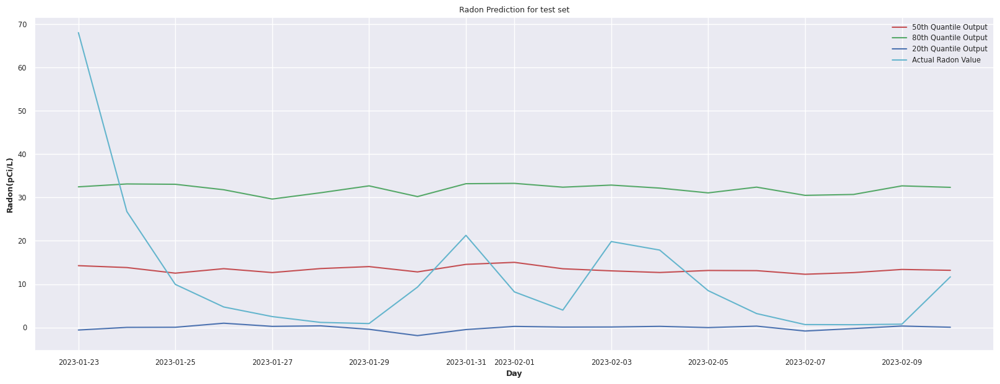

In [86]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 9

In [87]:
#using 21 as the example since it has the most data
df = df_radon['9']

In [88]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2195 entries, 0 to 2194
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     2195 non-null   object        
 1   DeviceName   2195 non-null   object        
 2   SyncDate     2195 non-null   datetime64[ns]
 3   Radon        2195 non-null   float64       
 4   eC02         2195 non-null   int64         
 5   VOC          2195 non-null   int64         
 6   Temperature  2195 non-null   int64         
 7   AirPressure  2195 non-null   float64       
 8   Humidity     2195 non-null   int64         
 9   LogIndex     2195 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 188.6+ KB


In [89]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [90]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:02:44,49,73,30.03,4.70
1,2023-02-11 17:02:44,50,69,30.07,5.50
2,2023-02-11 16:02:44,54,61,30.08,5.40
3,2023-02-11 15:02:44,55,59,30.08,6.00
4,2023-02-11 14:02:44,54,57,30.13,6.00
...,...,...,...,...,...
2190,2022-11-10 04:23:30,59,65,30.16,10.00
2191,2022-11-10 03:23:30,59,65,30.19,10.50
2192,2022-11-10 02:23:30,58,65,30.21,9.80
2193,2022-11-10 01:23:30,58,65,30.23,10.10


In [91]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [92]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,61.46,71.17,30.04,10.56
2022-11-11,65.54,83.88,29.66,30.35
2022-11-12,60.83,83.79,29.91,54.13
2022-11-13,44.08,79.46,30.13,44.88
2022-11-14,44.54,71.38,30.23,46.60
...,...,...,...,...
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94
2023-02-09,62.78,69.74,30.12,2.90


In [93]:
df = df[df.index<= '2023-02-10']

In [94]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-11-10,61.46,71.17,30.04,10.56
2022-11-11,65.54,83.88,29.66,30.35
2022-11-12,60.83,83.79,29.91,54.13
2022-11-13,44.08,79.46,30.13,44.88
2022-11-14,44.54,71.38,30.23,46.60
...,...,...,...,...
2023-02-06,54.67,60.52,30.17,0.55
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94


In [95]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [96]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [97]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [98]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [99]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [100]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,61.46,71.17,30.04,10.56,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,65.54,83.88,29.66,30.35,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,60.83,83.79,29.91,54.13,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,44.08,79.46,30.13,44.88,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,44.54,71.38,30.23,46.60,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,54.67,60.52,30.17,0.55,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,53.57,59.91,30.27,1.45,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,61.59,61.59,30.24,2.94,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [101]:
df.dropna(inplace=True)

In [102]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-11-10,61.46,71.17,30.04,10.56,60.47,0.53,2.44,9.37,258.31,0.01,...,0.02,0.07,44.87,28.99,81.32,0.04,22.60,28.99,300.35,0.32
2022-11-11,65.54,83.88,29.66,30.35,64.42,0.25,1.28,8.25,293.91,0.06,...,1.36,1.41,46.20,28.62,96.41,0.04,20.99,28.62,310.71,0.05
2022-11-12,60.83,83.79,29.91,54.13,56.74,0.20,1.02,5.06,306.24,0.00,...,1.68,1.73,46.52,28.87,89.31,0.15,30.46,28.87,312.79,0.09
2022-11-13,44.08,79.46,30.13,44.88,39.47,0.47,1.61,7.96,299.45,0.00,...,0.00,1.73,46.52,29.09,73.09,0.79,97.47,29.09,313.13,0.37
2022-11-14,44.54,71.38,30.23,46.60,41.51,0.37,1.42,6.48,295.55,0.00,...,0.00,1.73,46.52,29.19,69.46,0.64,84.99,29.19,316.30,0.22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,54.67,60.52,30.17,0.55,50.15,0.19,0.64,3.79,309.47,0.00,...,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,53.57,59.91,30.27,1.45,50.39,0.32,0.92,4.08,302.28,0.00,...,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,61.59,61.59,30.24,2.94,57.42,0.14,0.63,4.05,304.45,0.00,...,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [103]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [104]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [105]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,50.91,71.75,30.14,25.32,47.34,0.24,0.96,5.17,303.79,0.01,0.31,0.13,0.98,5.63,56.98,29.10,78.09,29.10,316.21,0.16
std,8.43,8.65,0.14,28.58,9.00,0.20,0.69,2.50,14.58,0.02,0.57,0.33,1.19,4.22,6.71,0.14,12.73,0.14,7.93,0.17
min,22.38,52.90,29.66,0.45,15.70,0.01,0.03,1.54,244.70,0.00,0.00,0.00,0.00,0.00,44.87,28.62,46.78,28.62,279.18,0.00
25%,46.14,64.92,30.07,4.04,41.37,0.11,0.55,3.48,297.14,0.00,0.00,0.00,0.02,2.26,51.28,29.03,68.00,29.03,312.97,0.05
50%,50.61,72.54,30.16,11.11,47.84,0.20,0.80,4.46,306.77,0.00,0.03,0.00,0.39,5.66,57.15,29.11,78.39,29.11,317.25,0.12
75%,56.78,77.38,30.24,40.69,53.41,0.32,1.28,6.24,312.58,0.01,0.32,0.06,1.96,9.55,61.85,29.19,89.34,29.19,321.45,0.23
max,65.54,90.12,30.47,138.14,64.71,1.11,3.77,15.20,326.26,0.08,3.20,1.72,3.83,14.68,67.42,29.42,98.48,29.42,329.03,0.98


In [106]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [107]:
df.fillna(0, inplace=True)

In [108]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Humidity,0.32
Humidity_lag_1,0.25
Event Rain (in),0.20
Hourly Rain (in/hr)_lag_1,0.19
...,...
Yearly Rain (in)_lag_29,-0.75
Avg Wind Direction (10 mins) (°)_lag_31,-0.75
Wind Direction (°)_lag_30,-0.75
Yearly Rain (in)_lag_31,-0.76


In [109]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Humidity 0.3226996148868811
Humidity_lag_1 0.24763335242365128
Event Rain (in) 0.19908880793795342
Hourly Rain (in/hr)_lag_1 0.19450354222717875
Hourly Rain (in/hr) 0.17950903985648856
Outdoor h Temperature (°F)_lag_1 0.17520133337864688
Daily Rain (in)_lag_5 0.15644411726407684
Outdoor h Temperature (°F) 0.14724122887434266
Humidity_lag_2 0.14126361459557205
Daily Rain (in)_lag_1 0.12651627073659558
Wind Direction (°) 0.1223268289165775
Outdoor h Temperature (°F)_lag_2 0.11848667779032397
Daily Rain (in) 0.10936133391568571
Daily Rain (in)_lag_6 0.10383743695826751
Hourly Rain (in/hr)_lag_5 0.09977699670705331
Humidity (%)_lag_1 0.09898029088058086
Absolute Pressure (inHg) 0.09815531102640089
Relative Pressure (inHg) 0.09815531102640089
Wind Direction (°)_lag_1 0.0966511009645657
Humidity (%) 0.09464926099351226
Weekly Rain (in)_lag_3 0.09327675790786896
Avg Wind Speed (10 mins) (mph)_lag_8 0.09204317535307342
AirPressure 0.08867026900601539
Avg Wind Speed (10 mins) (mph)_la

In [113]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
# df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.35]
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.32]
df_corrH

,Radon
Radon,1.00
Humidity,0.32
Wind Direction (°)_lag_15,-0.32
Absolute Pressure (inHg)_lag_14,-0.32
Relative Pressure (inHg)_lag_14,-0.32
...,...
Yearly Rain (in)_lag_29,-0.75
Avg Wind Direction (10 mins) (°)_lag_31,-0.75
Wind Direction (°)_lag_30,-0.75
Yearly Rain (in)_lag_31,-0.76


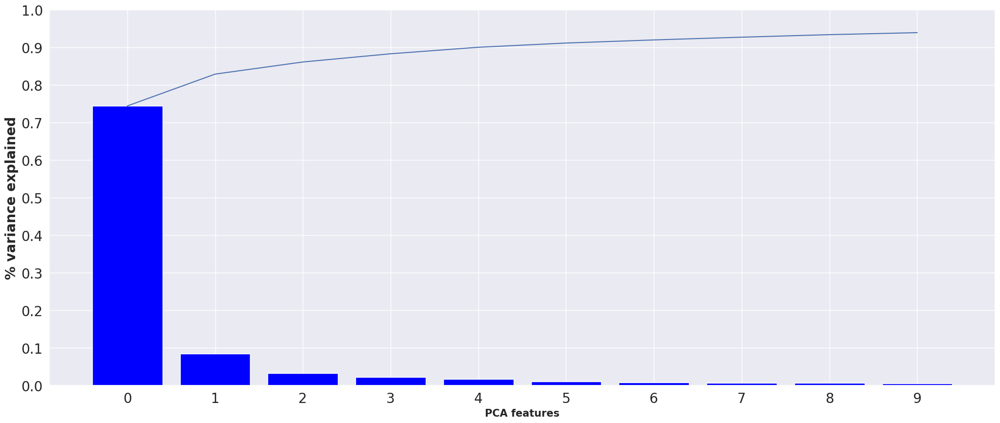

In [114]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import FastICA, PCA
df_feat = df[df_corrH.index]
df_feat = df_feat.loc[:, df_feat.columns != "Radon"]
df_feat =MinMaxScaler().fit_transform(df_feat)
pca = PCA(n_components=10)
res_pca = pca.fit_transform(df_feat)
# scree plot
features = range(pca.n_components_)
plt.figure(figsize = (25,10))
plt.bar(features, pca.explained_variance_ratio_, color="blue")
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("PCA features", fontsize=15)
plt.ylabel("% variance explained", fontsize=20)
plt.xticks(features, fontsize=20)
plt.yticks(ticks=np.arange(0.0, 1.0001, 0.1), fontsize=20);

In [115]:
# collect principal components in a dataframe
df_pca = pd.DataFrame(res_pca)
df_pca = df_pca.add_prefix("pca")


df3 = df.copy()
col = df3.pop("Radon")
df3.insert(0, col.name, col)     # move price column to the left

# drop the feature columns which the components summarize
df3.reset_index(inplace=True)
df3 = pd.concat([df3, df_pca], axis=1)
for col in df3.columns:
    if col != "Radon" and col != "SyncDate" and "pca" not in col:
        del df3[col]
df3.set_index("SyncDate", inplace=True)
df3.columns

Index(['Radon', 'pca0', 'pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7',
       'pca8', 'pca9'],
      dtype='object')

In [116]:
# prepare correlation matrix for principal components  
df_corr = df3.corr(method="pearson")
print("principal components with at least modest correlation to price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))

# absolute correlations with price > 10%
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) > 0.10]
df_corrH

principal components with at least modest correlation to price:


,Radon
Radon,1.00
pca0,0.67
pca1,0.29
pca8,-0.12
pca3,-0.13
pca2,-0.20
pca4,-0.34


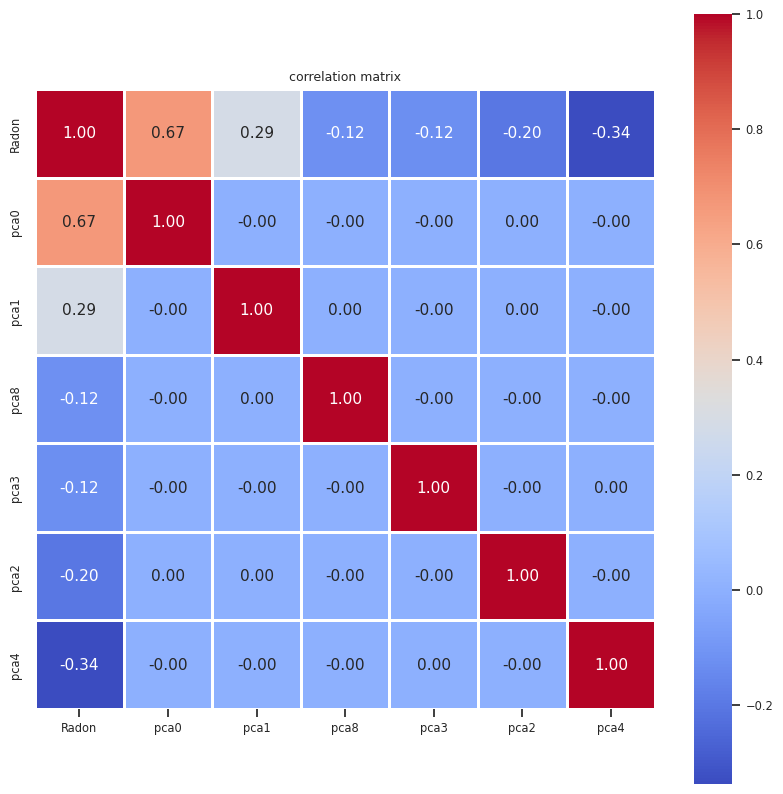

In [117]:
# helper method: correlation matrix as heatmap
def corr_heatmap(df):
    idx = df.corr().sort_values("Radon", ascending=False).index
    df_sorted = df.loc[:, idx]  # sort dataframe columns by their correlation 

    #plt.figure(figsize = (15,15))
    sns.set(font_scale=0.75)
    ax = sns.heatmap(df_sorted.corr().round(3), 
            annot=True, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
    ax.xaxis.tick_bottom()
    plt.title("correlation matrix")
    plt.show()



# visualize correlations with price     
df4 = df3.copy()
df4 = df4[df_corrH.index]   # keep the components with at least modest correlations

plt.figure(figsize = (10,10))
corr_heatmap(df4)

In [118]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-11-10 to 2023-02-10
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Radon   93 non-null     float32
 1   pca0    93 non-null     float32
 2   pca1    93 non-null     float32
 3   pca8    93 non-null     float32
 4   pca3    93 non-null     float32
 5   pca2    93 non-null     float32
 6   pca4    93 non-null     float32
dtypes: float32(7)
memory usage: 3.3 KB


In [119]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df4["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [120]:
# create time series object for the feature columns
df_covF = df4.loc[:, df4.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['pca0', 'pca1', 'pca8', 'pca3', 'pca2', 'pca4'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: False


In [121]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 6, 1)

In [122]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [123]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-11-10 00:00:00
training end: 2023-01-22 00:00:00
training duration: 73 days 00:00:00
test start: 2023-01-23 00:00:00
test end: 2023-02-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-11-10,0.07
2023-02-10,0.03


In [124]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,pca0,pca1,pca8,pca3,pca2,pca4
SyncDate,,,,,,
2022-11-10,1.00,0.00,0.64,0.59,0.69,0.36
2023-02-10,-0.04,0.17,0.61,0.95,0.26,0.62


In [125]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-11-10,0.07
2023-01-22,0.07


In [126]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [127]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [146]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=1000
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [129]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-23 01:43:39 (running for 00:00:00.28)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |         lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+----------

(build_fit_tft_model pid=1227517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227517)   rank_zero_deprecation(
(build_fit_tft_model pid=1227517) Auto select gpus: [0]
(build_fit_tft_model pid=1227517) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227517) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227517) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227517) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:43:56 (running for 00:00:17.39)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |         lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------

(build_fit_tft_model pid=1227517) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227517) 
(build_fit_tft_model pid=1227517)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227517) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1227517) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1227517) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1227517) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1227517) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1227517) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1227517) 5  | encoder_vsn              

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_025141cf,2023-02-23_03-50-32,True,,5efa590a6f424e57b5bed3ba370136aa,ip-172-31-10-87,10,0.552668,172.31.10.87,1370948,1.84258,8.12523,0.354539,8.12523,1677124232,0,,10,025141cf,0.00500679
build_fit_tft_model_025cd339,2023-02-23_04-10-18,True,,b84f9387c9fc4e64a22fa5cf85b6fa17,ip-172-31-10-87,10,0.279442,172.31.10.87,1390370,1.88547,6.65827,0.222446,6.65827,1677125418,0,,10,025cd339,0.00551128
build_fit_tft_model_02b45cae,2023-02-23_03-47-11,True,,babad954fbbe48e9a7058e28520d2f20,ip-172-31-10-87,20,0.395453,172.31.10.87,1367530,1.90556,11.5426,0.382123,11.5426,1677124031,0,,20,02b45cae,0.00462103
build_fit_tft_model_02d893aa,2023-02-23_03-22-16,True,,ffc5a90fa884473e8d2c4b1f4b0c7708,ip-172-31-10-87,20,0.171401,172.31.10.87,1343294,1.85561,8.76429,0.21352,8.76429,1677122536,0,,20,02d893aa,0.00488806
build_fit_tft_model_043f654f,2023-02-23_04-13-13,True,,587152abf4134bff8168962becb98d43,ip-172-31-10-87,40,0.103709,172.31.10.87,1393080,1.65985,13.2071,0.187565,13.2071,1677125593,0,,40,043f654f,0.00507522
build_fit_tft_model_045ced1e,2023-02-23_04-32-46,True,,050a6f66e67748209d8d525f4ba7f421,ip-172-31-10-87,50,0.118701,172.31.10.87,1411322,1.64367,16.1514,0.24945,16.1514,1677126766,0,,50,045ced1e,0.00570869
build_fit_tft_model_04ddc6ba,2023-02-23_03-07-10,True,,07b71f1bc99743e59d29fc63873e5435,ip-172-31-10-87,10,0.18203,172.31.10.87,1328534,1.82118,6.65962,0.204602,6.65962,1677121630,0,,10,04ddc6ba,0.00462127
build_fit_tft_model_051b322e,2023-02-23_03-04-35,True,,421a795e9b144ecbaa90c03a34ab8698,ip-172-31-10-87,20,0.22972,172.31.10.87,1326217,1.72447,8.28157,0.213386,8.28157,1677121475,0,,20,051b322e,0.0054853
build_fit_tft_model_05771703,2023-02-23_03-31-54,True,,69ff159ac69c4a3d8f5c8e107afc83af,ip-172-31-10-87,20,0.117266,172.31.10.87,1352634,1.83092,8.66279,0.229971,8.66279,1677123114,0,,20,05771703,0.00781536
build_fit_tft_model_05cc98a7,2023-02-23_01-50-44,True,,271b7bcb19054999b585ee3c4513e119,ip-172-31-10-87,60,0.12306,172.31.10.87,1236115,1.56137,27.6673,0.387312,27.6673,1677117044,0,,60,05cc98a7,0.00806785


== Status ==
Current time: 2023-02-23 01:44:01 (running for 00:00:22.40)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a90b95e9 with sMAPE=1.9212754964828491 and parameters={'in_len': 8, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 6, 'dropout': 0.4124119672148897, 'lr': 0.0016705356689937162, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+---------+----------------------+
| Trial name                   | status

(build_fit_tft_model pid=1228276) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228276)   rank_zero_deprecation(
(build_fit_tft_model pid=1228276) Auto select gpus: [0]
(build_fit_tft_model pid=1228276) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228276) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228276) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228276) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:44:33 (running for 00:00:54.08)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.770274043083191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a90b95e9 with sMAPE=1.8177655935287476 and parameters={'in_len': 8, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 6, 'dropout': 0.4124119672148897, 'lr': 0.0016705356689937162, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1228276) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228276) 
(build_fit_tft_model pid=1228276)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228276) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1228276) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1228276) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1228276) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1228276) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1228276) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1228276) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:44:38 (running for 00:00:59.30)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.7723528146743774
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----------------

(build_fit_tft_model pid=1228833) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228833)   rank_zero_deprecation(
(build_fit_tft_model pid=1228833) Auto select gpus: [0]
(build_fit_tft_model pid=1228833) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228833) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228833) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228833) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:44:56 (running for 00:01:17.16)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.7723528146743774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1228833) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228833) 
(build_fit_tft_model pid=1228833)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228833) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1228833) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1228833) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1228833) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1228833) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1228833) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1228833) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:45:01 (running for 00:01:22.42)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.774431586265564
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-----------------

(build_fit_tft_model pid=1229279) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229279)   rank_zero_deprecation(
(build_fit_tft_model pid=1229279) Auto select gpus: [0]
(build_fit_tft_model pid=1229279) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229279) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229279) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229279) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:45:19 (running for 00:01:40.03)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.774431586265564
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

(build_fit_tft_model pid=1229279) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229279) 
(build_fit_tft_model pid=1229279)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229279) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1229279) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1229279) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1229279) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1229279) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1229279) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1229279) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:45:24 (running for 00:01:45.12)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.8188740015029907
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+------------

(build_fit_tft_model pid=1229797) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229797)   rank_zero_deprecation(
(build_fit_tft_model pid=1229797) Auto select gpus: [0]
(build_fit_tft_model pid=1229797) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229797) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229797) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229797) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1229797) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229797) 
(build_fit_tft_model pid=1229797)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229797) ---------------

== Status ==
Current time: 2023-02-23 01:45:41 (running for 00:02:02.01)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.8188740015029907
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1230320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230320)   rank_zero_deprecation(
(build_fit_tft_model pid=1230320) Auto select gpus: [0]
(build_fit_tft_model pid=1230320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1230320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230320) 
(build_fit_tft_model pid=1230320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230320) ---------------

== Status ==
Current time: 2023-02-23 01:46:04 (running for 00:02:25.64)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1230829) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230829)   rank_zero_deprecation(
(build_fit_tft_model pid=1230829) Auto select gpus: [0]
(build_fit_tft_model pid=1230829) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230829) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230829) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230829) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:46:27 (running for 00:02:48.54)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.8456618189811707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: c74198bc with sMAPE=1.774431586265564 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.38477529824111645, 'lr': 0.013018334043309439, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1230829) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230829) 
(build_fit_tft_model pid=1230829)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230829) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1230829) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1230829) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1230829) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1230829) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1230829) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1230829) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:46:32 (running for 00:02:53.67)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.7871872186660767 | Iter 20.000: -1.8395897150039673 | Iter 10.000: -1.8456618189811707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.7370285987854004 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-23 01:46:51 (running for 00:03:12.17)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.714005947113037 | Iter 20.000: -1.7627136707305908 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1231656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231656)   rank_zero_deprecation(
(build_fit_tft_model pid=1231656) Auto select gpus: [0]
(build_fit_tft_model pid=1231656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1231656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231656) 
(build_fit_tft_model pid=1231656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231656) ---------------

== Status ==
Current time: 2023-02-23 01:47:03 (running for 00:03:24.20)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.714005947113037 | Iter 20.000: -1.7627136707305908 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+---

(build_fit_tft_model pid=1232134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232134)   rank_zero_deprecation(
(build_fit_tft_model pid=1232134) Auto select gpus: [0]
(build_fit_tft_model pid=1232134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232134) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1232134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232134) 
(build_fit_tft_model pid=1232134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232134) ---------------

== Status ==
Current time: 2023-02-23 01:47:29 (running for 00:03:50.01)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.714005947113037 | Iter 20.000: -1.7804330587387085 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--

== Status ==
Current time: 2023-02-23 01:47:44 (running for 00:04:05.41)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7331353425979614 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1232870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232870)   rank_zero_deprecation(
(build_fit_tft_model pid=1232870) Auto select gpus: [0]
(build_fit_tft_model pid=1232870) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232870) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232870) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232870) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1232870) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232870) 
(build_fit_tft_model pid=1232870)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232870) ---------------

== Status ==
Current time: 2023-02-23 01:48:04 (running for 00:04:25.01)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7331353425979614 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1233428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233428)   rank_zero_deprecation(
(build_fit_tft_model pid=1233428) Auto select gpus: [0]
(build_fit_tft_model pid=1233428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233428) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:29 (running for 00:04:50.69)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7331353425979614 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1233428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233428) 
(build_fit_tft_model pid=1233428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233428) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1233428) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1233428) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1233428) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1233428) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1233428) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1233428) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:34 (running for 00:04:55.93)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7331353425979614 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1233960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1233960)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1233960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233960)   rank_zero_deprecation(
(build_fit_tft_model pid=1233960) Auto select gpus: [0]
(build_fit_tft_model pid=1233960) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233960) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233960) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233960) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:53 (running for 00:05:14.74)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7331353425979614 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1233960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233960) 
(build_fit_tft_model pid=1233960)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233960) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1233960) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1233960) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1233960) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1233960) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1233960) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1233960) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:59 (running for 00:05:20.02)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7331353425979614 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 01:49:09 (running for 00:05:30.85)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.6858376264572144 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1234786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234786)   rank_zero_deprecation(
(build_fit_tft_model pid=1234786) Auto select gpus: [0]
(build_fit_tft_model pid=1234786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234786) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234786) 
(build_fit_tft_model pid=1234786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234786) ---------------

== Status ==
Current time: 2023-02-23 01:49:31 (running for 00:05:52.92)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.6858376264572144 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 01:49:44 (running for 00:06:05.28)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.6858376264572144 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1235382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235382)   rank_zero_deprecation(
(build_fit_tft_model pid=1235382) Auto select gpus: [0]
(build_fit_tft_model pid=1235382) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235382) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235382) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235382) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:49:56 (running for 00:06:17.48)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.6858376264572144 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1235382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235382) 
(build_fit_tft_model pid=1235382)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235382) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1235382) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1235382) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1235382) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1235382) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1235382) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1235382) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:01 (running for 00:06:22.59)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.6858376264572144 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1236115) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236115)   rank_zero_deprecation(
(build_fit_tft_model pid=1236115) Auto select gpus: [0]
(build_fit_tft_model pid=1236115) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236115) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236115) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236115) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:21 (running for 00:06:42.96)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7239093780517578 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1236115) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236115) 
(build_fit_tft_model pid=1236115)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236115) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1236115) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1236115) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1236115) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1236115) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1236115) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1236115) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:27 (running for 00:06:48.25)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7239093780517578 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 01:50:37 (running for 00:06:58.42)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 38e3e579 with sMAPE=1.6024621725082397 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.1688897502507908, 'lr': 0.004636398482617001, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 01:50:50 (running for 00:07:11.29)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1236998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236998)   rank_zero_deprecation(
(build_fit_tft_model pid=1236998) Auto select gpus: [0]
(build_fit_tft_model pid=1236998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236998) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:02 (running for 00:07:23.06)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1236998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236998) 
(build_fit_tft_model pid=1236998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236998) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1236998) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1236998) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1236998) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1236998) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1236998) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1236998) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:07 (running for 00:07:28.07)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.820386826992035
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 01:51:17 (running for 00:07:38.39)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.820386826992035
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

== Status ==
Current time: 2023-02-23 01:51:27 (running for 00:07:48.66)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.820386826992035
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--------

(build_fit_tft_model pid=1238460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1238460)   rank_zero_deprecation(
(build_fit_tft_model pid=1238460) Auto select gpus: [0]
(build_fit_tft_model pid=1238460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1238460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1238460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1238460) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:47 (running for 00:08:08.65)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.820386826992035
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1238460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1238460) 
(build_fit_tft_model pid=1238460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1238460) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1238460) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1238460) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1238460) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1238460) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1238460) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1238460) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:53 (running for 00:08:13.99)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.820386826992035
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1239061) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239061)   rank_zero_deprecation(
(build_fit_tft_model pid=1239061) Auto select gpus: [0]
(build_fit_tft_model pid=1239061) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239061) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239061) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239061) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:13 (running for 00:08:34.92)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1239061) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239061) 
(build_fit_tft_model pid=1239061)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239061) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239061) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239061) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239061) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239061) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239061) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239061) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:19 (running for 00:08:40.13)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1239624) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239624)   rank_zero_deprecation(
(build_fit_tft_model pid=1239624) Auto select gpus: [0]
(build_fit_tft_model pid=1239624) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239624) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239624) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239624) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:40 (running for 00:09:01.24)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1239624) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239624) 
(build_fit_tft_model pid=1239624)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239624) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239624) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239624) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239624) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239624) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239624) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239624) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:45 (running for 00:09:06.39)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1240172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240172)   rank_zero_deprecation(
(build_fit_tft_model pid=1240172) Auto select gpus: [0]
(build_fit_tft_model pid=1240172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240172) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:06 (running for 00:09:27.00)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1240172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240172) 
(build_fit_tft_model pid=1240172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240172) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240172) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240172) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240172) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240172) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240172) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240172) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:11 (running for 00:09:32.03)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6952080130577087 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 01:53:21 (running for 00:09:42.33)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1240888) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240888)   rank_zero_deprecation(
(build_fit_tft_model pid=1240888) Auto select gpus: [0]
(build_fit_tft_model pid=1240888) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240888) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240888) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240888) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:35 (running for 00:09:56.42)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1240888) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240888) 
(build_fit_tft_model pid=1240888)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240888) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240888) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240888) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240888) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240888) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240888) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240888) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:40 (running for 00:10:01.86)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1241604) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1241604)   rank_zero_deprecation(
(build_fit_tft_model pid=1241604) Auto select gpus: [0]
(build_fit_tft_model pid=1241604) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1241604) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1241604) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1241604) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:04 (running for 00:10:25.96)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1241604) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1241604) 
(build_fit_tft_model pid=1241604)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1241604) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1241604) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1241604) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1241604) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1241604) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1241604) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1241604) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:10 (running for 00:10:31.06)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1242286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242286)   rank_zero_deprecation(
(build_fit_tft_model pid=1242286) Auto select gpus: [0]
(build_fit_tft_model pid=1242286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242286) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:32 (running for 00:10:53.03)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1242286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242286) 
(build_fit_tft_model pid=1242286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242286) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242286) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242286) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242286) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242286) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242286) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242286) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:37 (running for 00:10:58.09)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1242910) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242910)   rank_zero_deprecation(
(build_fit_tft_model pid=1242910) Auto select gpus: [0]
(build_fit_tft_model pid=1242910) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242910) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242910) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242910) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:58 (running for 00:11:19.83)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1242910) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242910) 
(build_fit_tft_model pid=1242910)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242910) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242910) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242910) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242910) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242910) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242910) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242910) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:03 (running for 00:11:24.88)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 01:55:14 (running for 00:11:35.16)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1243754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243754)   rank_zero_deprecation(
(build_fit_tft_model pid=1243754) Auto select gpus: [0]
(build_fit_tft_model pid=1243754) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243754) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243754) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243754) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:38 (running for 00:11:59.85)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1243754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243754) 
(build_fit_tft_model pid=1243754)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243754) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243754) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243754) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243754) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243754) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243754) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243754) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:44 (running for 00:12:05.12)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8355035781860352
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1244516) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1244516)   rank_zero_deprecation(
(build_fit_tft_model pid=1244516) Auto select gpus: [0]
(build_fit_tft_model pid=1244516) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1244516) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1244516) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1244516) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:07 (running for 00:12:28.94)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1244516) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1244516) 
(build_fit_tft_model pid=1244516)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1244516) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1244516) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1244516) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1244516) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1244516) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1244516) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1244516) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:13 (running for 00:12:34.58)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1245184) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245184)   rank_zero_deprecation(
(build_fit_tft_model pid=1245184) Auto select gpus: [0]
(build_fit_tft_model pid=1245184) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245184) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245184) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245184) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:34 (running for 00:12:55.15)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1245184) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245184) 
(build_fit_tft_model pid=1245184)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245184) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245184) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245184) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245184) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245184) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245184) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245184) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:39 (running for 00:13:00.43)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1245842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245842)   rank_zero_deprecation(
(build_fit_tft_model pid=1245842) Auto select gpus: [0]
(build_fit_tft_model pid=1245842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245842) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:00 (running for 00:13:21.76)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1245842) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245842) 
(build_fit_tft_model pid=1245842)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245842) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245842) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245842) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245842) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245842) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245842) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245842) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:06 (running for 00:13:27.06)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 01:57:16 (running for 00:13:37.40)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1246515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246515)   rank_zero_deprecation(
(build_fit_tft_model pid=1246515) Auto select gpus: [0]
(build_fit_tft_model pid=1246515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246515) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:30 (running for 00:13:51.45)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1246515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246515) 
(build_fit_tft_model pid=1246515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246515) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246515) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246515) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246515) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246515) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246515) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246515) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:35 (running for 00:13:56.57)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1247151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247151)   rank_zero_deprecation(
(build_fit_tft_model pid=1247151) Auto select gpus: [0]
(build_fit_tft_model pid=1247151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247151) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:56 (running for 00:14:16.99)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1247151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247151) 
(build_fit_tft_model pid=1247151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247151) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247151) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247151) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247151) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247151) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247151) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247151) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:01 (running for 00:14:22.18)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1247749) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247749)   rank_zero_deprecation(
(build_fit_tft_model pid=1247749) Auto select gpus: [0]
(build_fit_tft_model pid=1247749) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247749) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247749) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247749) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:21 (running for 00:14:42.67)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8532806634902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1247749) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247749) 
(build_fit_tft_model pid=1247749)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247749) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247749) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247749) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247749) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247749) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247749) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247749) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:26 (running for 00:14:47.93)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8532806634902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 01:58:37 (running for 00:14:58.32)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 01:58:47 (running for 00:15:08.95)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 01:58:58 (running for 00:15:19.44)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1248738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1248738)   rank_zero_deprecation(
(build_fit_tft_model pid=1248738) Auto select gpus: [0]
(build_fit_tft_model pid=1248738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1248738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1248738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1248738) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:12 (running for 00:15:33.08)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1248738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1248738) 
(build_fit_tft_model pid=1248738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1248738) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1248738) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1248738) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1248738) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1248738) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1248738) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1248738) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:17 (running for 00:15:38.28)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1249298) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249298)   rank_zero_deprecation(
(build_fit_tft_model pid=1249298) Auto select gpus: [0]
(build_fit_tft_model pid=1249298) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249298) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249298) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249298) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:38 (running for 00:15:59.45)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8519426584243774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1249298) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249298) 
(build_fit_tft_model pid=1249298)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249298) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249298) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249298) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249298) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249298) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249298) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249298) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:43 (running for 00:16:04.68)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.6970456838607788 | Iter 10.000: -1.8519426584243774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1250047) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1250047)   rank_zero_deprecation(
(build_fit_tft_model pid=1250047) Auto select gpus: [0]
(build_fit_tft_model pid=1250047) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1250047) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1250047) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1250047) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:07 (running for 00:16:28.30)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1250047) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1250047) 
(build_fit_tft_model pid=1250047)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1250047) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1250047) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1250047) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1250047) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1250047) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1250047) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1250047) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:12 (running for 00:16:33.41)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1250645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1250645)   rank_zero_deprecation(
(build_fit_tft_model pid=1250645) Auto select gpus: [0]
(build_fit_tft_model pid=1250645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1250645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1250645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1250645) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:32 (running for 00:16:53.64)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8519426584243774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1250645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1250645) 
(build_fit_tft_model pid=1250645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1250645) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1250645) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1250645) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1250645) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1250645) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1250645) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1250645) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:37 (running for 00:16:58.83)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8519426584243774
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1251269) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251269)   rank_zero_deprecation(
(build_fit_tft_model pid=1251269) Auto select gpus: [0]
(build_fit_tft_model pid=1251269) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251269) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251269) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251269) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:59 (running for 00:17:20.62)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8581663370132446
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1251269) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251269) 
(build_fit_tft_model pid=1251269)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251269) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251269) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251269) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251269) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251269) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251269) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251269) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:04 (running for 00:17:25.64)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7125207781791687 | Iter 10.000: -1.8581663370132446
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1251983) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251983)   rank_zero_deprecation(
(build_fit_tft_model pid=1251983) Auto select gpus: [0]
(build_fit_tft_model pid=1251983) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251983) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251983) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251983) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:29 (running for 00:17:50.91)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8507969379425049
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1251983) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251983) 
(build_fit_tft_model pid=1251983)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251983) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251983) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251983) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251983) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251983) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251983) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251983) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:35 (running for 00:17:56.29)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8507969379425049
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1252699) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252699)   rank_zero_deprecation(
(build_fit_tft_model pid=1252699) Auto select gpus: [0]
(build_fit_tft_model pid=1252699) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252699) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252699) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252699) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:55 (running for 00:18:16.57)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8581663370132446
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1252699) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252699) 
(build_fit_tft_model pid=1252699)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252699) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1252699) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1252699) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1252699) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1252699) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1252699) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1252699) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:00 (running for 00:18:21.82)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8581663370132446
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1253423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253423)   rank_zero_deprecation(
(build_fit_tft_model pid=1253423) Auto select gpus: [0]
(build_fit_tft_model pid=1253423) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253423) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253423) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253423) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:20 (running for 00:18:41.88)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8593120574951172
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1253423) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253423) 
(build_fit_tft_model pid=1253423)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253423) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253423) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253423) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253423) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253423) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253423) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253423) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:26 (running for 00:18:47.22)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8593120574951172
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1253936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253936)   rank_zero_deprecation(
(build_fit_tft_model pid=1253936) Auto select gpus: [0]
(build_fit_tft_model pid=1253936) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253936) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253936) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253936) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:46 (running for 00:19:07.53)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8604577779769897
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1253936) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253936) 
(build_fit_tft_model pid=1253936)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253936) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253936) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253936) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253936) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253936) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253936) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253936) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:51 (running for 00:19:12.92)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8604577779769897
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:03:02 (running for 00:19:23.53)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7367901802062988 | Iter 10.000: -1.8593120574951172
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1254632) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254632)   rank_zero_deprecation(
(build_fit_tft_model pid=1254632) Auto select gpus: [0]
(build_fit_tft_model pid=1254632) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254632) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254632) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254632) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:16 (running for 00:19:37.15)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7367901802062988 | Iter 10.000: -1.8593120574951172
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1254632) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254632) 
(build_fit_tft_model pid=1254632)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254632) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254632) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254632) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254632) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254632) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254632) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254632) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:21 (running for 00:19:42.45)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7367901802062988 | Iter 10.000: -1.8593120574951172
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:03:33 (running for 00:19:54.55)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.745584487915039 | Iter 10.000: -1.8581663370132446
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1255393) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255393)   rank_zero_deprecation(
(build_fit_tft_model pid=1255393) Auto select gpus: [0]
(build_fit_tft_model pid=1255393) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255393) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255393) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255393) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:46 (running for 00:20:07.96)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.745584487915039 | Iter 10.000: -1.8581663370132446
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1255393) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255393) 
(build_fit_tft_model pid=1255393)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255393) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255393) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255393) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255393) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255393) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255393) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255393) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:52 (running for 00:20:13.67)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.745584487915039 | Iter 10.000: -1.8581663370132446
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 02:04:03 (running for 00:20:24.27)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.745584487915039 | Iter 10.000: -1.8564046621322632
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1256248) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1256248)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1256248) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1256248)   rank_zero_deprecation(
(build_fit_tft_model pid=1256248) Auto select gpus: [0]
(build_fit_tft_model pid=1256248) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1256248) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1256248) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1256248) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:23 (running for 00:20:44.77)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8564046621322632
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1256248) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1256248) 
(build_fit_tft_model pid=1256248)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1256248) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1256248) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1256248) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1256248) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1256248) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1256248) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1256248) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:28 (running for 00:20:49.94)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8564046621322632
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:04:40 (running for 00:21:01.07)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8546429872512817
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1257134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1257134)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1257134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257134)   rank_zero_deprecation(
(build_fit_tft_model pid=1257134) Auto select gpus: [0]
(build_fit_tft_model pid=1257134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257134) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:00 (running for 00:21:21.01)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8546429872512817
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1257134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257134) 
(build_fit_tft_model pid=1257134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257134) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257134) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257134) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257134) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257134) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257134) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257134) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:05 (running for 00:21:26.57)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8546429872512817
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 02:05:15 (running for 00:21:36.90)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8544872403144836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1258043) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1258043)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1258043) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258043)   rank_zero_deprecation(
(build_fit_tft_model pid=1258043) Auto select gpus: [0]
(build_fit_tft_model pid=1258043) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258043) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258043) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258043) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:37 (running for 00:21:58.45)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8544872403144836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1258043) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258043) 
(build_fit_tft_model pid=1258043)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258043) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258043) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258043) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258043) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258043) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258043) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258043) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:42 (running for 00:22:03.58)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8544872403144836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:05:53 (running for 00:22:14.19)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1258781) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1258781)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1258781) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258781)   rank_zero_deprecation(
(build_fit_tft_model pid=1258781) Auto select gpus: [0]
(build_fit_tft_model pid=1258781) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258781) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258781) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258781) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:15 (running for 00:22:36.40)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1258781) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258781) 
(build_fit_tft_model pid=1258781)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258781) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258781) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258781) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258781) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258781) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258781) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258781) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:21 (running for 00:22:42.10)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 02:06:31 (running for 00:22:52.94)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8505672812461853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 02:06:42 (running for 00:23:03.74)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8505672812461853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:06:54 (running for 00:23:15.62)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8505672812461853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1260049) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1260049)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1260049) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260049)   rank_zero_deprecation(
(build_fit_tft_model pid=1260049) Auto select gpus: [0]
(build_fit_tft_model pid=1260049) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260049) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260049) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260049) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:09 (running for 00:23:30.80)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8505672812461853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1260049) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260049) 
(build_fit_tft_model pid=1260049)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260049) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260049) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260049) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260049) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260049) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260049) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260049) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:15 (running for 00:23:36.31)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8505672812461853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:07:26 (running for 00:23:47.23)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 02:07:37 (running for 00:23:58.14)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:07:47 (running for 00:24:08.65)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1261247) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1261247)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1261247) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261247)   rank_zero_deprecation(
(build_fit_tft_model pid=1261247) Auto select gpus: [0]
(build_fit_tft_model pid=1261247) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261247) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261247) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261247) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:02 (running for 00:24:23.37)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1261247) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261247) 
(build_fit_tft_model pid=1261247)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261247) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261247) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261247) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261247) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261247) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261247) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261247) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:07 (running for 00:24:28.45)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:08:18 (running for 00:24:39.07)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.845115303993225
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1262164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1262164)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1262164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262164)   rank_zero_deprecation(
(build_fit_tft_model pid=1262164) Auto select gpus: [0]
(build_fit_tft_model pid=1262164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262164) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:39 (running for 00:25:00.29)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.845115303993225
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1262164) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262164) 
(build_fit_tft_model pid=1262164)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262164) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262164) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262164) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262164) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262164) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262164) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262164) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:44 (running for 00:25:05.33)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.845115303993225
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1262786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262786)   rank_zero_deprecation(
(build_fit_tft_model pid=1262786) Auto select gpus: [0]
(build_fit_tft_model pid=1262786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262786) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:05 (running for 00:25:26.74)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1262786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262786) 
(build_fit_tft_model pid=1262786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262786) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262786) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262786) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262786) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262786) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262786) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262786) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:10 (running for 00:25:31.76)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1263399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1263399)   rank_zero_deprecation(
(build_fit_tft_model pid=1263399) Auto select gpus: [0]
(build_fit_tft_model pid=1263399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1263399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1263399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1263399) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:33 (running for 00:25:54.20)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1263399) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1263399) 
(build_fit_tft_model pid=1263399)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1263399) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1263399) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1263399) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1263399) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1263399) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1263399) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1263399) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:38 (running for 00:25:59.62)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1263931) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1263931)   rank_zero_deprecation(
(build_fit_tft_model pid=1263931) Auto select gpus: [0]
(build_fit_tft_model pid=1263931) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1263931) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1263931) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1263931) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:00 (running for 00:26:21.00)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1263931) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1263931) 
(build_fit_tft_model pid=1263931)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1263931) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1263931) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1263931) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1263931) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1263931) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1263931) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1263931) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:05 (running for 00:26:26.15)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1264634) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1264634)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1264634) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264634)   rank_zero_deprecation(
(build_fit_tft_model pid=1264634) Auto select gpus: [0]
(build_fit_tft_model pid=1264634) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264634) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264634) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264634) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:27 (running for 00:26:47.98)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1264634) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264634) 
(build_fit_tft_model pid=1264634)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264634) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264634) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264634) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264634) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264634) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264634) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264634) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:32 (running for 00:26:53.34)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1265277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1265277)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1265277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265277)   rank_zero_deprecation(
(build_fit_tft_model pid=1265277) Auto select gpus: [0]
(build_fit_tft_model pid=1265277) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265277) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265277) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265277) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:57 (running for 00:27:18.08)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1265277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265277) 
(build_fit_tft_model pid=1265277)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265277) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265277) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265277) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265277) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265277) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265277) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265277) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:02 (running for 00:27:23.53)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:11:12 (running for 00:27:33.76)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:11:23 (running for 00:27:44.65)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+------------

(build_fit_tft_model pid=1266366) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1266366)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1266366) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266366)   rank_zero_deprecation(
(build_fit_tft_model pid=1266366) Auto select gpus: [0]
(build_fit_tft_model pid=1266366) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266366) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266366) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266366) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:42 (running for 00:28:03.65)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1266366) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266366) 
(build_fit_tft_model pid=1266366)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266366) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266366) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266366) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266366) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266366) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266366) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266366) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:48 (running for 00:28:09.29)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-23 02:11:58 (running for 00:28:19.71)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1267073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1267073)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1267073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267073)   rank_zero_deprecation(
(build_fit_tft_model pid=1267073) Auto select gpus: [0]
(build_fit_tft_model pid=1267073) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267073) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267073) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267073) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:12 (running for 00:28:33.61)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1267073) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267073) 
(build_fit_tft_model pid=1267073)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267073) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267073) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267073) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267073) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267073) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267073) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267073) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:18 (running for 00:28:39.08)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 02:12:28 (running for 00:28:49.56)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1268030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1268030)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1268030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268030)   rank_zero_deprecation(
(build_fit_tft_model pid=1268030) Auto select gpus: [0]
(build_fit_tft_model pid=1268030) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268030) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268030) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268030) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:50 (running for 00:29:11.45)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1268030) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268030) 
(build_fit_tft_model pid=1268030)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268030) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268030) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268030) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268030) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268030) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268030) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268030) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:56 (running for 00:29:16.97)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:13:06 (running for 00:29:27.28)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1268877) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268877)   rank_zero_deprecation(
(build_fit_tft_model pid=1268877) Auto select gpus: [0]
(build_fit_tft_model pid=1268877) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268877) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268877) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268877) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:26 (running for 00:29:47.41)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1268877) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268877) 
(build_fit_tft_model pid=1268877)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268877) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268877) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268877) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268877) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268877) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268877) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268877) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:31 (running for 00:29:52.87)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1269421) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269421)   rank_zero_deprecation(
(build_fit_tft_model pid=1269421) Auto select gpus: [0]
(build_fit_tft_model pid=1269421) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269421) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269421) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269421) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:53 (running for 00:30:14.32)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1269421) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269421) 
(build_fit_tft_model pid=1269421)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269421) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269421) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269421) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269421) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269421) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269421) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269421) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:58 (running for 00:30:19.51)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

== Status ==
Current time: 2023-02-23 02:14:09 (running for 00:30:30.78)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1270220) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270220)   rank_zero_deprecation(
(build_fit_tft_model pid=1270220) Auto select gpus: [0]
(build_fit_tft_model pid=1270220) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270220) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270220) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270220) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:24 (running for 00:30:45.02)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1270220) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270220) 
(build_fit_tft_model pid=1270220)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270220) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270220) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270220) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270220) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270220) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270220) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270220) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:29 (running for 00:30:50.36)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1270916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270916)   rank_zero_deprecation(
(build_fit_tft_model pid=1270916) Auto select gpus: [0]
(build_fit_tft_model pid=1270916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270916) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:51 (running for 00:31:11.98)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+-

(build_fit_tft_model pid=1270916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270916) 
(build_fit_tft_model pid=1270916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270916) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270916) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270916) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270916) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270916) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270916) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270916) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:56 (running for 00:31:17.71)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----------

(build_fit_tft_model pid=1271527) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271527)   rank_zero_deprecation(
(build_fit_tft_model pid=1271527) Auto select gpus: [0]
(build_fit_tft_model pid=1271527) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271527) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271527) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271527) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:15 (running for 00:31:36.85)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1271527) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271527) 
(build_fit_tft_model pid=1271527)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271527) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271527) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271527) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271527) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271527) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271527) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271527) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:21 (running for 00:31:41.97)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 02:15:32 (running for 00:31:53.81)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1272216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272216)   rank_zero_deprecation(
(build_fit_tft_model pid=1272216) Auto select gpus: [0]
(build_fit_tft_model pid=1272216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272216) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:46 (running for 00:32:07.24)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1272216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272216) 
(build_fit_tft_model pid=1272216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272216) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272216) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272216) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272216) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272216) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272216) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272216) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:51 (running for 00:32:12.47)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:16:03 (running for 00:32:24.80)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1272971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272971)   rank_zero_deprecation(
(build_fit_tft_model pid=1272971) Auto select gpus: [0]
(build_fit_tft_model pid=1272971) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272971) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272971) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272971) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:17 (running for 00:32:38.54)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1272971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272971) 
(build_fit_tft_model pid=1272971)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272971) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272971) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272971) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272971) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272971) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272971) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272971) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:22 (running for 00:32:43.76)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1273368) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1273368)   rank_zero_deprecation(
(build_fit_tft_model pid=1273368) Auto select gpus: [0]
(build_fit_tft_model pid=1273368) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1273368) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1273368) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1273368) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:44 (running for 00:33:05.79)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1273368) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1273368) 
(build_fit_tft_model pid=1273368)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1273368) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1273368) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1273368) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1273368) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1273368) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1273368) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1273368) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:50 (running for 00:33:11.08)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:17:00 (running for 00:33:21.44)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6812829971313477 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 05cc98a7 with sMAPE=1.5613702535629272 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32365314631642783, 'lr': 0.008708993899457538, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:17:11 (running for 00:33:32.80)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1274426) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274426)   rank_zero_deprecation(
(build_fit_tft_model pid=1274426) Auto select gpus: [0]
(build_fit_tft_model pid=1274426) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274426) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274426) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274426) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:25 (running for 00:33:46.83)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1274426) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274426) 
(build_fit_tft_model pid=1274426)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274426) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274426) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274426) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274426) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274426) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274426) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274426) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:31 (running for 00:33:51.97)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:17:42 (running for 00:34:03.86)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1275036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275036)   rank_zero_deprecation(
(build_fit_tft_model pid=1275036) Auto select gpus: [0]
(build_fit_tft_model pid=1275036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275036) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:56 (running for 00:34:17.58)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1275036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275036) 
(build_fit_tft_model pid=1275036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275036) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275036) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275036) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275036) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275036) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275036) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275036) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:01 (running for 00:34:22.94)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1275585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275585)   rank_zero_deprecation(
(build_fit_tft_model pid=1275585) Auto select gpus: [0]
(build_fit_tft_model pid=1275585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275585) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:22 (running for 00:34:43.94)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1275585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275585) 
(build_fit_tft_model pid=1275585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275585) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275585) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275585) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275585) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275585) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275585) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275585) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:28 (running for 00:34:48.99)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:18:39 (running for 00:35:00.84)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1276264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276264)   rank_zero_deprecation(
(build_fit_tft_model pid=1276264) Auto select gpus: [0]
(build_fit_tft_model pid=1276264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276264) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:54 (running for 00:35:15.40)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1276264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276264) 
(build_fit_tft_model pid=1276264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276264) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276264) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276264) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276264) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276264) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276264) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276264) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:59 (running for 00:35:20.43)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1276819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276819)   rank_zero_deprecation(
(build_fit_tft_model pid=1276819) Auto select gpus: [0]
(build_fit_tft_model pid=1276819) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276819) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276819) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276819) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:21 (running for 00:35:42.17)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1276819) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276819) 
(build_fit_tft_model pid=1276819)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276819) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276819) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276819) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276819) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276819) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276819) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276819) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:26 (running for 00:35:47.34)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1277406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1277406)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1277406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277406)   rank_zero_deprecation(
(build_fit_tft_model pid=1277406) Auto select gpus: [0]
(build_fit_tft_model pid=1277406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277406) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:47 (running for 00:36:08.80)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

(build_fit_tft_model pid=1277406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277406) 
(build_fit_tft_model pid=1277406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277406) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277406) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277406) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277406) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277406) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277406) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277406) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:53 (running for 00:36:14.06)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:20:04 (running for 00:36:25.88)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1278191) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1278191)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1278191) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278191)   rank_zero_deprecation(
(build_fit_tft_model pid=1278191) Auto select gpus: [0]
(build_fit_tft_model pid=1278191) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278191) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278191) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278191) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:18 (running for 00:36:39.92)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1278191) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278191) 
(build_fit_tft_model pid=1278191)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278191) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278191) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278191) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278191) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278191) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278191) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278191) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:24 (running for 00:36:45.03)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:20:34 (running for 00:36:55.89)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8544872403144836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1278863) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278863)   rank_zero_deprecation(
(build_fit_tft_model pid=1278863) Auto select gpus: [0]
(build_fit_tft_model pid=1278863) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278863) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278863) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278863) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:49 (running for 00:37:10.62)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8544872403144836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1278863) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278863) 
(build_fit_tft_model pid=1278863)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278863) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278863) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278863) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278863) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278863) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278863) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278863) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:55 (running for 00:37:16.00)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7619811296463013 | Iter 10.000: -1.8544872403144836
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:21:05 (running for 00:37:26.50)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6610538363456726 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1279808) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279808)   rank_zero_deprecation(
(build_fit_tft_model pid=1279808) Auto select gpus: [0]
(build_fit_tft_model pid=1279808) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279808) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279808) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279808) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:31 (running for 00:37:52.08)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6708637475967407 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1279808) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279808) 
(build_fit_tft_model pid=1279808)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279808) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279808) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279808) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279808) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279808) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279808) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279808) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:36 (running for 00:37:57.26)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6708637475967407 | Iter 20.000: -1.7610791325569153 | Iter 10.000: -1.8543314933776855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 02:21:46 (running for 00:38:07.76)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6708637475967407 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:21:57 (running for 00:38:18.08)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.6558442115783691 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+

== Status ==
Current time: 2023-02-23 02:22:07 (running for 00:38:28.19)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6558442115783691 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1281000) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281000)   rank_zero_deprecation(
(build_fit_tft_model pid=1281000) Auto select gpus: [0]
(build_fit_tft_model pid=1281000) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281000) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281000) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281000) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:27 (running for 00:38:48.12)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6558442115783691 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1281000) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281000) 
(build_fit_tft_model pid=1281000)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281000) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281000) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281000) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281000) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281000) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281000) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281000) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:32 (running for 00:38:53.29)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6558442115783691 | Iter 20.000: -1.7601771354675293 | Iter 10.000: -1.85324627161026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:22:42 (running for 00:39:03.94)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6558442115783691 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1281860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281860)   rank_zero_deprecation(
(build_fit_tft_model pid=1281860) Auto select gpus: [0]
(build_fit_tft_model pid=1281860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281860) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:05 (running for 00:39:26.94)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1281860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281860) 
(build_fit_tft_model pid=1281860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281860) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281860) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281860) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281860) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281860) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281860) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281860) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:11 (running for 00:39:32.29)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.759399652481079 | Iter 10.000: -1.8521610498428345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:23:21 (running for 00:39:42.57)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:23:32 (running for 00:39:53.20)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 260cb7d2 with sMAPE=1.5257209539413452 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.30555348130256355, 'lr': 0.003582405313517766, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:23:44 (running for 00:40:04.97)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1282906) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282906)   rank_zero_deprecation(
(build_fit_tft_model pid=1282906) Auto select gpus: [0]
(build_fit_tft_model pid=1282906) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282906) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282906) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282906) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:57 (running for 00:40:18.38)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1282906) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282906) 
(build_fit_tft_model pid=1282906)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282906) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282906) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282906) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282906) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282906) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282906) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282906) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:02 (running for 00:40:23.60)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.758622169494629 | Iter 10.000: -1.8494820594787598
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:24:13 (running for 00:40:34.23)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1283812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283812)   rank_zero_deprecation(
(build_fit_tft_model pid=1283812) Auto select gpus: [0]
(build_fit_tft_model pid=1283812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283812) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:35 (running for 00:40:56.93)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1283812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283812) 
(build_fit_tft_model pid=1283812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283812) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283812) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283812) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283812) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283812) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283812) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283812) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:41 (running for 00:41:02.04)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.7562928795814514 | Iter 10.000: -1.846803069114685
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:24:51 (running for 00:41:12.44)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.845115303993225
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:25:01 (running for 00:41:22.76)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.845115303993225
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 90ec8264 with sMAPE=1.5512138605117798 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.32608933164036774, 'lr': 0.008060790005647658, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1284908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284908)   rank_zero_deprecation(
(build_fit_tft_model pid=1284908) Auto select gpus: [0]
(build_fit_tft_model pid=1284908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284908) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:23 (running for 00:41:44.26)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.845115303993225
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1284908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284908) 
(build_fit_tft_model pid=1284908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284908) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1284908) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1284908) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1284908) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1284908) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1284908) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1284908) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:28 (running for 00:41:49.31)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.845115303993225
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:25:38 (running for 00:41:59.61)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1285760) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285760)   rank_zero_deprecation(
(build_fit_tft_model pid=1285760) Auto select gpus: [0]
(build_fit_tft_model pid=1285760) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285760) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285760) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285760) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:03 (running for 00:42:24.27)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1285760) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285760) 
(build_fit_tft_model pid=1285760)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285760) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1285760) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1285760) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1285760) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1285760) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1285760) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1285760) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:08 (running for 00:42:29.44)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8434275388717651
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:26:20 (running for 00:42:41.10)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1286577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286577)   rank_zero_deprecation(
(build_fit_tft_model pid=1286577) Auto select gpus: [0]
(build_fit_tft_model pid=1286577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286577) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:34 (running for 00:42:55.11)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1286577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286577) 
(build_fit_tft_model pid=1286577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286577) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286577) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286577) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286577) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286577) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286577) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286577) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:39 (running for 00:43:00.28)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.753963589668274 | Iter 10.000: -1.8432137370109558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:26:49 (running for 00:43:10.91)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6699022054672241 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a2187ec8 with sMAPE=1.5096784830093384 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.34157340602139064, 'lr': 0.021368681218822187, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1287470) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287470)   rank_zero_deprecation(
(build_fit_tft_model pid=1287470) Auto select gpus: [0]
(build_fit_tft_model pid=1287470) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287470) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287470) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287470) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:27:13 (running for 00:43:34.93)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1287470) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287470) 
(build_fit_tft_model pid=1287470)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287470) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287470) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287470) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287470) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287470) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287470) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287470) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:19 (running for 00:43:40.02)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.7497740387916565 | Iter 10.000: -1.8371046781539917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:27:29 (running for 00:43:50.30)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6553634405136108 | Iter 20.000: -1.745584487915039 | Iter 10.000: -1.8371046781539917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 715ecc03 with sMAPE=1.4977647066116333 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.2679015413163974, 'lr': 0.001427898777895382, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:27:39 (running for 00:44:00.63)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.745584487915039 | Iter 10.000: -1.8371046781539917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f16977fb with sMAPE=1.5547653436660767 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.3424042885323623, 'lr': 0.0077229392904227985, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1288428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288428)   rank_zero_deprecation(
(build_fit_tft_model pid=1288428) Auto select gpus: [0]
(build_fit_tft_model pid=1288428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1288428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288428) 
(build_fit_tft_model pid=1288428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288428) ---------------

== Status ==
Current time: 2023-02-23 02:27:59 (running for 00:44:20.27)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.745584487915039 | Iter 10.000: -1.8371046781539917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 715ecc03 with sMAPE=1.5378766059875488 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.2679015413163974, 'lr': 0.001427898777895382, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:28:09 (running for 00:44:30.57)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 715ecc03 with sMAPE=1.5378766059875488 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.2679015413163974, 'lr': 0.001427898777895382, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:28:20 (running for 00:44:41.13)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.522700309753418 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:28:31 (running for 00:44:52.10)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1289303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289303)   rank_zero_deprecation(
(build_fit_tft_model pid=1289303) Auto select gpus: [0]
(build_fit_tft_model pid=1289303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289303) 
(build_fit_tft_model pid=1289303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289303) ---------------

== Status ==
Current time: 2023-02-23 02:28:42 (running for 00:45:03.81)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1289760) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289760)   rank_zero_deprecation(
(build_fit_tft_model pid=1289760) Auto select gpus: [0]
(build_fit_tft_model pid=1289760) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289760) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289760) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289760) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289760) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289760) 
(build_fit_tft_model pid=1289760)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289760) ---------------

== Status ==
Current time: 2023-02-23 02:29:03 (running for 00:45:24.01)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1290245) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1290245)   rank_zero_deprecation(
(build_fit_tft_model pid=1290245) Auto select gpus: [0]
(build_fit_tft_model pid=1290245) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1290245) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1290245) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1290245) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1290245) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1290245) 
(build_fit_tft_model pid=1290245)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1290245) ---------------

== Status ==
Current time: 2023-02-23 02:29:23 (running for 00:45:44.50)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1290645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1290645)   rank_zero_deprecation(
(build_fit_tft_model pid=1290645) Auto select gpus: [0]
(build_fit_tft_model pid=1290645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1290645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1290645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1290645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1290645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1290645) 
(build_fit_tft_model pid=1290645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1290645) ---------------

== Status ==
Current time: 2023-02-23 02:29:43 (running for 00:46:04.88)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.8389599323272705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1291135) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1291135)   rank_zero_deprecation(
(build_fit_tft_model pid=1291135) Auto select gpus: [0]
(build_fit_tft_model pid=1291135) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1291135) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1291135) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1291135) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1291135) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1291135) 
(build_fit_tft_model pid=1291135)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1291135) ---------------

== Status ==
Current time: 2023-02-23 02:30:03 (running for 00:46:24.15)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7378554344177246 | Iter 10.000: -1.8429999351501465
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:30:18 (running for 00:46:39.14)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7301263809204102 | Iter 10.000: -1.8389599323272705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1291735) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1291735)   rank_zero_deprecation(
(build_fit_tft_model pid=1291735) Auto select gpus: [0]
(build_fit_tft_model pid=1291735) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1291735) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1291735) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1291735) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1291735) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1291735) 
(build_fit_tft_model pid=1291735)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1291735) ---------------

== Status ==
Current time: 2023-02-23 02:30:27 (running for 00:46:48.14)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7301263809204102 | Iter 10.000: -1.8389599323272705
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:30:37 (running for 00:46:58.51)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7290611267089844 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1292280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1292280)   rank_zero_deprecation(
(build_fit_tft_model pid=1292280) Auto select gpus: [0]
(build_fit_tft_model pid=1292280) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1292280) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1292280) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1292280) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1292280) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1292280) 
(build_fit_tft_model pid=1292280)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1292280) ---------------

== Status ==
Current time: 2023-02-23 02:30:53 (running for 00:47:14.52)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7290611267089844 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:31:04 (running for 00:47:25.02)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:31:14 (running for 00:47:35.31)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1292940) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1292940)   rank_zero_deprecation(
(build_fit_tft_model pid=1292940) Auto select gpus: [0]
(build_fit_tft_model pid=1292940) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1292940) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1292940) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1292940) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1292940) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1292940) 
(build_fit_tft_model pid=1292940)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1292940) ---------------

== Status ==
Current time: 2023-02-23 02:31:32 (running for 00:47:53.66)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:31:42 (running for 00:48:03.78)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1293547) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1293547)   rank_zero_deprecation(
(build_fit_tft_model pid=1293547) Auto select gpus: [0]
(build_fit_tft_model pid=1293547) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1293547) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1293547) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1293547) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1293547) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1293547) 
(build_fit_tft_model pid=1293547)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1293547) ---------------

== Status ==
Current time: 2023-02-23 02:32:02 (running for 00:48:23.76)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1293926) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1293926)   rank_zero_deprecation(
(build_fit_tft_model pid=1293926) Auto select gpus: [0]
(build_fit_tft_model pid=1293926) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1293926) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1293926) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1293926) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1293926) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1293926) 
(build_fit_tft_model pid=1293926)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1293926) ---------------

== Status ==
Current time: 2023-02-23 02:32:20 (running for 00:48:41.62)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1294370) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1294370)   rank_zero_deprecation(
(build_fit_tft_model pid=1294370) Auto select gpus: [0]
(build_fit_tft_model pid=1294370) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1294370) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1294370) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1294370) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1294370) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1294370) 
(build_fit_tft_model pid=1294370)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1294370) ---------------

== Status ==
Current time: 2023-02-23 02:32:38 (running for 00:48:59.89)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1294705) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1294705)   rank_zero_deprecation(
(build_fit_tft_model pid=1294705) Auto select gpus: [0]
(build_fit_tft_model pid=1294705) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1294705) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1294705) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1294705) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1294705) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1294705) 
(build_fit_tft_model pid=1294705)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1294705) ---------------

== Status ==
Current time: 2023-02-23 02:32:56 (running for 00:49:17.56)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1295127) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1295127)   rank_zero_deprecation(
(build_fit_tft_model pid=1295127) Auto select gpus: [0]
(build_fit_tft_model pid=1295127) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1295127) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1295127) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1295127) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1295127) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1295127) 
(build_fit_tft_model pid=1295127)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1295127) ---------------

== Status ==
Current time: 2023-02-23 02:33:15 (running for 00:49:36.50)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8426462411880493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:33:25 (running for 00:49:46.78)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: aaa65a6b with sMAPE=1.4636297225952148 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.3414651577791342, 'lr': 0.015572887118641264, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:33:36 (running for 00:49:57.01)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5924699902534485 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.425872802734375 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 02:33:50 (running for 00:50:11.20)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1295923) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1295923)   rank_zero_deprecation(
(build_fit_tft_model pid=1295923) Auto select gpus: [0]
(build_fit_tft_model pid=1295923) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1295923) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1295923) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1295923) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1295923) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1295923) 
(build_fit_tft_model pid=1295923)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1295923) ---------------

== Status ==
Current time: 2023-02-23 02:33:58 (running for 00:50:19.95)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1296255) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1296255)   rank_zero_deprecation(
(build_fit_tft_model pid=1296255) Auto select gpus: [0]
(build_fit_tft_model pid=1296255) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1296255) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1296255) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1296255) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1296255) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1296255) 
(build_fit_tft_model pid=1296255)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1296255) ---------------

== Status ==
Current time: 2023-02-23 02:34:17 (running for 00:50:38.20)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8426462411880493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:34:27 (running for 00:50:48.50)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1296929) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1296929)   rank_zero_deprecation(
(build_fit_tft_model pid=1296929) Auto select gpus: [0]
(build_fit_tft_model pid=1296929) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1296929) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1296929) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1296929) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1296929) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1296929) 
(build_fit_tft_model pid=1296929)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1296929) ---------------

== Status ==
Current time: 2023-02-23 02:34:45 (running for 00:51:06.47)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:34:57 (running for 00:51:18.19)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1297320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1297320)   rank_zero_deprecation(
(build_fit_tft_model pid=1297320) Auto select gpus: [0]
(build_fit_tft_model pid=1297320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1297320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1297320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1297320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1297320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1297320) 
(build_fit_tft_model pid=1297320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1297320) ---------------

== Status ==
Current time: 2023-02-23 02:35:06 (running for 00:51:27.40)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1297745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1297745)   rank_zero_deprecation(
(build_fit_tft_model pid=1297745) Auto select gpus: [0]
(build_fit_tft_model pid=1297745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1297745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1297745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1297745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1297745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1297745) 
(build_fit_tft_model pid=1297745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1297745) ---------------

== Status ==
Current time: 2023-02-23 02:35:24 (running for 00:51:45.58)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:35:37 (running for 00:51:58.26)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1298204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1298204)   rank_zero_deprecation(
(build_fit_tft_model pid=1298204) Auto select gpus: [0]
(build_fit_tft_model pid=1298204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1298204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1298204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1298204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1298204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1298204) 
(build_fit_tft_model pid=1298204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1298204) ---------------

== Status ==
Current time: 2023-02-23 02:35:46 (running for 00:52:07.33)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1298538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1298538)   rank_zero_deprecation(
(build_fit_tft_model pid=1298538) Auto select gpus: [0]
(build_fit_tft_model pid=1298538) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1298538) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1298538) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1298538) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1298538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1298538) 
(build_fit_tft_model pid=1298538)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1298538) ---------------

== Status ==
Current time: 2023-02-23 02:36:04 (running for 00:52:25.57)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:36:15 (running for 00:52:36.24)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1298968) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1298968)   rank_zero_deprecation(
(build_fit_tft_model pid=1298968) Auto select gpus: [0]
(build_fit_tft_model pid=1298968) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1298968) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1298968) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1298968) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1298968) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1298968) 
(build_fit_tft_model pid=1298968)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1298968) ---------------

== Status ==
Current time: 2023-02-23 02:36:23 (running for 00:52:44.26)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1299306) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1299306)   rank_zero_deprecation(
(build_fit_tft_model pid=1299306) Auto select gpus: [0]
(build_fit_tft_model pid=1299306) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1299306) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1299306) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1299306) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1299306) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1299306) 
(build_fit_tft_model pid=1299306)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1299306) ---------------

== Status ==
Current time: 2023-02-23 02:36:39 (running for 00:53:00.20)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7279958724975586 | Iter 10.000: -1.838783085346222
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:36:49 (running for 00:53:10.34)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:37:03 (running for 00:53:24.25)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1299880) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1299880)   rank_zero_deprecation(
(build_fit_tft_model pid=1299880) Auto select gpus: [0]
(build_fit_tft_model pid=1299880) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1299880) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1299880) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1299880) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1299880) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1299880) 
(build_fit_tft_model pid=1299880)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1299880) ---------------

== Status ==
Current time: 2023-02-23 02:37:11 (running for 00:53:32.64)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1300229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1300229)   rank_zero_deprecation(
(build_fit_tft_model pid=1300229) Auto select gpus: [0]
(build_fit_tft_model pid=1300229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1300229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1300229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1300229) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1300229) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1300229) 
(build_fit_tft_model pid=1300229)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1300229) ---------------

== Status ==
Current time: 2023-02-23 02:37:28 (running for 00:53:49.03)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.7250016331672668 | Iter 10.000: -1.8387004733085632
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:37:43 (running for 00:54:04.24)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8353315591812134
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1300703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1300703)   rank_zero_deprecation(
(build_fit_tft_model pid=1300703) Auto select gpus: [0]
(build_fit_tft_model pid=1300703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1300703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1300703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1300703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1300703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1300703) 
(build_fit_tft_model pid=1300703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1300703) ---------------

== Status ==
Current time: 2023-02-23 02:37:51 (running for 00:54:12.49)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8353315591812134
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:38:02 (running for 00:54:23.19)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.835125744342804
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1301092) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1301092)   rank_zero_deprecation(
(build_fit_tft_model pid=1301092) Auto select gpus: [0]
(build_fit_tft_model pid=1301092) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1301092) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1301092) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1301092) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1301092) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1301092) 
(build_fit_tft_model pid=1301092)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1301092) ---------------

== Status ==
Current time: 2023-02-23 02:38:14 (running for 00:54:35.34)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6230649948120117 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.835125744342804
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:38:29 (running for 00:54:50.24)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1301459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1301459)   rank_zero_deprecation(
(build_fit_tft_model pid=1301459) Auto select gpus: [0]
(build_fit_tft_model pid=1301459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1301459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1301459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1301459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1301459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1301459) 
(build_fit_tft_model pid=1301459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1301459) ---------------

== Status ==
Current time: 2023-02-23 02:38:36 (running for 00:54:57.21)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:38:49 (running for 00:55:10.23)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1301773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1301773)   rank_zero_deprecation(
(build_fit_tft_model pid=1301773) Auto select gpus: [0]
(build_fit_tft_model pid=1301773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1301773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1301773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1301773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1301773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1301773) 
(build_fit_tft_model pid=1301773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1301773) ---------------

== Status ==
Current time: 2023-02-23 02:38:56 (running for 00:55:17.10)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1301990) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1301990)   rank_zero_deprecation(
(build_fit_tft_model pid=1301990) Auto select gpus: [0]
(build_fit_tft_model pid=1301990) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1301990) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1301990) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1301990) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1301990) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1301990) 
(build_fit_tft_model pid=1301990)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1301990) ---------------

== Status ==
Current time: 2023-02-23 02:39:10 (running for 00:55:31.22)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6327952146530151 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8349199295043945
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:39:24 (running for 00:55:45.26)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1302284) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1302284)   rank_zero_deprecation(
(build_fit_tft_model pid=1302284) Auto select gpus: [0]
(build_fit_tft_model pid=1302284) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1302284) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1302284) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1302284) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1302284) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1302284) 
(build_fit_tft_model pid=1302284)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1302284) ---------------

== Status ==
Current time: 2023-02-23 02:39:31 (running for 00:55:52.57)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8330646753311157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:39:46 (running for 00:56:07.25)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.709241807460785 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1302561) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1302561)   rank_zero_deprecation(
(build_fit_tft_model pid=1302561) Auto select gpus: [0]
(build_fit_tft_model pid=1302561) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1302561) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1302561) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1302561) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1302561) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1302561) 
(build_fit_tft_model pid=1302561)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1302561) ---------------

== Status ==
Current time: 2023-02-23 02:39:53 (running for 00:56:14.04)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.709241807460785 | Iter 10.000: -1.831209421157837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1302868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1302868)   rank_zero_deprecation(
(build_fit_tft_model pid=1302868) Auto select gpus: [0]
(build_fit_tft_model pid=1302868) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1302868) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1302868) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1302868) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1302868) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1302868) 
(build_fit_tft_model pid=1302868)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1302868) ---------------

== Status ==
Current time: 2023-02-23 02:40:10 (running for 00:56:31.16)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8305719494819641
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1303136) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1303136)   rank_zero_deprecation(
(build_fit_tft_model pid=1303136) Auto select gpus: [0]
(build_fit_tft_model pid=1303136) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1303136) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1303136) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1303136) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1303136) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1303136) 
(build_fit_tft_model pid=1303136)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1303136) ---------------

== Status ==
Current time: 2023-02-23 02:40:27 (running for 00:56:48.07)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8299344778060913
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:40:42 (running for 00:57:03.25)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8295021057128906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1303436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1303436)   rank_zero_deprecation(
(build_fit_tft_model pid=1303436) Auto select gpus: [0]
(build_fit_tft_model pid=1303436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1303436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1303436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1303436) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1303436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1303436) 
(build_fit_tft_model pid=1303436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1303436) ---------------

== Status ==
Current time: 2023-02-23 02:40:49 (running for 00:57:10.10)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8295021057128906
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:41:02 (running for 00:57:23.30)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.709241807460785 | Iter 10.000: -1.82906973361969
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1303719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1303719)   rank_zero_deprecation(
(build_fit_tft_model pid=1303719) Auto select gpus: [0]
(build_fit_tft_model pid=1303719) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1303719) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1303719) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1303719) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1303719) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1303719) 
(build_fit_tft_model pid=1303719)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1303719) ---------------

== Status ==
Current time: 2023-02-23 02:41:09 (running for 00:57:30.36)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.709241807460785 | Iter 10.000: -1.82906973361969
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-23 02:41:19 (running for 00:57:40.53)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1304066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1304066)   rank_zero_deprecation(
(build_fit_tft_model pid=1304066) Auto select gpus: [0]
(build_fit_tft_model pid=1304066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1304066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1304066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1304066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1304066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1304066) 
(build_fit_tft_model pid=1304066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1304066) ---------------

== Status ==
Current time: 2023-02-23 02:41:33 (running for 00:57:54.72)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1304326) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1304326)   rank_zero_deprecation(
(build_fit_tft_model pid=1304326) Auto select gpus: [0]
(build_fit_tft_model pid=1304326) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1304326) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1304326) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1304326) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1304326) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1304326) 
(build_fit_tft_model pid=1304326)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1304326) ---------------

== Status ==
Current time: 2023-02-23 02:41:48 (running for 00:58:09.38)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.82906973361969
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 02:42:02 (running for 00:58:23.31)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.705263078212738 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1304642) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1304642)   rank_zero_deprecation(
(build_fit_tft_model pid=1304642) Auto select gpus: [0]
(build_fit_tft_model pid=1304642) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1304642) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1304642) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1304642) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1304642) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1304642) 
(build_fit_tft_model pid=1304642)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1304642) ---------------

== Status ==
Current time: 2023-02-23 02:42:09 (running for 00:58:30.30)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.705263078212738 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1304884) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1304884)   rank_zero_deprecation(
(build_fit_tft_model pid=1304884) Auto select gpus: [0]
(build_fit_tft_model pid=1304884) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1304884) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1304884) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1304884) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1304884) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1304884) 
(build_fit_tft_model pid=1304884)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1304884) ---------------

== Status ==
Current time: 2023-02-23 02:42:24 (running for 00:58:45.68)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.705263078212738 | Iter 10.000: -1.82906973361969
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1305165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1305165)   rank_zero_deprecation(
(build_fit_tft_model pid=1305165) Auto select gpus: [0]
(build_fit_tft_model pid=1305165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1305165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1305165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1305165) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1305165) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1305165) 
(build_fit_tft_model pid=1305165)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1305165) ---------------

== Status ==
Current time: 2023-02-23 02:42:42 (running for 00:59:03.48)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1305400) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1305400)   rank_zero_deprecation(
(build_fit_tft_model pid=1305400) Auto select gpus: [0]
(build_fit_tft_model pid=1305400) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1305400) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1305400) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1305400) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1305400) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1305400) 
(build_fit_tft_model pid=1305400)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1305400) ---------------

== Status ==
Current time: 2023-02-23 02:42:58 (running for 00:59:19.40)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.82906973361969
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:43:09 (running for 00:59:30.35)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.709241807460785 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1305656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1305656)   rank_zero_deprecation(
(build_fit_tft_model pid=1305656) Auto select gpus: [0]
(build_fit_tft_model pid=1305656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1305656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1305656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1305656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1305656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1305656) 
(build_fit_tft_model pid=1305656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1305656) ---------------

== Status ==
Current time: 2023-02-23 02:43:16 (running for 00:59:37.68)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.709241807460785 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:43:31 (running for 00:59:52.34)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1305992) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1305992)   rank_zero_deprecation(
(build_fit_tft_model pid=1305992) Auto select gpus: [0]
(build_fit_tft_model pid=1305992) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1305992) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1305992) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1305992) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1305992) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1305992) 
(build_fit_tft_model pid=1305992)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1305992) ---------------

== Status ==
Current time: 2023-02-23 02:43:38 (running for 00:59:59.26)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1306208) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1306208)   rank_zero_deprecation(
(build_fit_tft_model pid=1306208) Auto select gpus: [0]
(build_fit_tft_model pid=1306208) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1306208) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1306208) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1306208) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1306208) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1306208) 
(build_fit_tft_model pid=1306208)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1306208) ---------------

== Status ==
Current time: 2023-02-23 02:43:53 (running for 01:00:14.52)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7059963941574097 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1306464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1306464)   rank_zero_deprecation(
(build_fit_tft_model pid=1306464) Auto select gpus: [0]
(build_fit_tft_model pid=1306464) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1306464) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1306464) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1306464) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1306464) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1306464) 
(build_fit_tft_model pid=1306464)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1306464) ---------------

== Status ==
Current time: 2023-02-23 02:44:10 (running for 01:00:31.44)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.709241807460785 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1306791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1306791)   rank_zero_deprecation(
(build_fit_tft_model pid=1306791) Auto select gpus: [0]
(build_fit_tft_model pid=1306791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1306791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1306791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1306791) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1306791) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1306791) 
(build_fit_tft_model pid=1306791)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1306791) ---------------

== Status ==
Current time: 2023-02-23 02:44:27 (running for 01:00:48.16)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.827139675617218
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1307002) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1307002)   rank_zero_deprecation(
(build_fit_tft_model pid=1307002) Auto select gpus: [0]
(build_fit_tft_model pid=1307002) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1307002) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1307002) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1307002) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1307002) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1307002) 
(build_fit_tft_model pid=1307002)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1307002) ---------------

== Status ==
Current time: 2023-02-23 02:44:41 (running for 01:01:02.53)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1307291) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1307291)   rank_zero_deprecation(
(build_fit_tft_model pid=1307291) Auto select gpus: [0]
(build_fit_tft_model pid=1307291) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1307291) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1307291) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1307291) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1307291) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1307291) 
(build_fit_tft_model pid=1307291)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1307291) ---------------

== Status ==
Current time: 2023-02-23 02:44:56 (running for 01:01:17.31)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1307601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1307601)   rank_zero_deprecation(
(build_fit_tft_model pid=1307601) Auto select gpus: [0]
(build_fit_tft_model pid=1307601) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1307601) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1307601) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1307601) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1307601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1307601) 
(build_fit_tft_model pid=1307601)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1307601) ---------------

== Status ==
Current time: 2023-02-23 02:45:13 (running for 01:01:34.14)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1307799) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1307799)   rank_zero_deprecation(
(build_fit_tft_model pid=1307799) Auto select gpus: [0]
(build_fit_tft_model pid=1307799) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1307799) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1307799) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1307799) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1307799) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1307799) 
(build_fit_tft_model pid=1307799)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1307799) ---------------

== Status ==
Current time: 2023-02-23 02:45:27 (running for 01:01:48.39)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8285384774208069
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1308064) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1308064)   rank_zero_deprecation(
(build_fit_tft_model pid=1308064) Auto select gpus: [0]
(build_fit_tft_model pid=1308064) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1308064) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1308064) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1308064) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1308064) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1308064) 
(build_fit_tft_model pid=1308064)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1308064) ---------------

== Status ==
Current time: 2023-02-23 02:45:44 (running for 01:02:05.32)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6468256711959839 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8280072212219238
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:45:54 (running for 01:02:15.55)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.827139675617218
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1308423) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1308423)   rank_zero_deprecation(
(build_fit_tft_model pid=1308423) Auto select gpus: [0]
(build_fit_tft_model pid=1308423) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1308423) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1308423) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1308423) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1308423) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1308423) 
(build_fit_tft_model pid=1308423)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1308423) ---------------

== Status ==
Current time: 2023-02-23 02:46:08 (running for 01:02:29.35)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.827139675617218
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:46:21 (running for 01:02:42.37)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8262721300125122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1308741) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1308741)   rank_zero_deprecation(
(build_fit_tft_model pid=1308741) Auto select gpus: [0]
(build_fit_tft_model pid=1308741) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1308741) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1308741) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1308741) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1308741) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1308741) 
(build_fit_tft_model pid=1308741)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1308741) ---------------

== Status ==
Current time: 2023-02-23 02:46:28 (running for 01:02:49.56)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8262721300125122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:46:41 (running for 01:03:02.36)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7107779383659363 | Iter 10.000: -1.8241334557533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1309062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1309062)   rank_zero_deprecation(
(build_fit_tft_model pid=1309062) Auto select gpus: [0]
(build_fit_tft_model pid=1309062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1309062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1309062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1309062) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1309062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1309062) 
(build_fit_tft_model pid=1309062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1309062) ---------------

== Status ==
Current time: 2023-02-23 02:46:48 (running for 01:03:09.67)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6408246755599976 | Iter 20.000: -1.7107779383659363 | Iter 10.000: -1.8241334557533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:46:58 (running for 01:03:19.75)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6388279795646667 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.8219947814941406
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1309394) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1309394)   rank_zero_deprecation(
(build_fit_tft_model pid=1309394) Auto select gpus: [0]
(build_fit_tft_model pid=1309394) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1309394) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1309394) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1309394) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1309394) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1309394) 
(build_fit_tft_model pid=1309394)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1309394) ---------------

== Status ==
Current time: 2023-02-23 02:47:12 (running for 01:03:33.66)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6388279795646667 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.8219947814941406
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1309661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1309661)   rank_zero_deprecation(
(build_fit_tft_model pid=1309661) Auto select gpus: [0]
(build_fit_tft_model pid=1309661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1309661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1309661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1309661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1309661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1309661) 
(build_fit_tft_model pid=1309661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1309661) ---------------

== Status ==
Current time: 2023-02-23 02:47:30 (running for 01:03:51.12)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6388279795646667 | Iter 20.000: -1.7107779383659363 | Iter 10.000: -1.8219457268714905
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1309930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1309930)   rank_zero_deprecation(
(build_fit_tft_model pid=1309930) Auto select gpus: [0]
(build_fit_tft_model pid=1309930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1309930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1309930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1309930) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1309930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1309930) 
(build_fit_tft_model pid=1309930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1309930) ---------------

== Status ==
Current time: 2023-02-23 02:47:44 (running for 01:04:05.43)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6388279795646667 | Iter 20.000: -1.7107779383659363 | Iter 10.000: -1.8219947814941406
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1310154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1310154)   rank_zero_deprecation(
(build_fit_tft_model pid=1310154) Auto select gpus: [0]
(build_fit_tft_model pid=1310154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1310154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1310154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1310154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1310154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1310154) 
(build_fit_tft_model pid=1310154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1310154) ---------------

== Status ==
Current time: 2023-02-23 02:48:00 (running for 01:04:21.57)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6388279795646667 | Iter 20.000: -1.7107779383659363 | Iter 10.000: -1.8241334557533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1310359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1310359)   rank_zero_deprecation(
(build_fit_tft_model pid=1310359) Auto select gpus: [0]
(build_fit_tft_model pid=1310359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1310359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1310359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1310359) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1310359) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1310359) 
(build_fit_tft_model pid=1310359)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1310359) ---------------

== Status ==
Current time: 2023-02-23 02:48:15 (running for 01:04:36.30)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6388279795646667 | Iter 20.000: -1.7107779383659363 | Iter 10.000: -1.8262721300125122
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:48:30 (running for 01:04:51.38)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.636831283569336 | Iter 20.000: -1.7093690633773804 | Iter 10.000: -1.8241334557533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1310638) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1310638)   rank_zero_deprecation(
(build_fit_tft_model pid=1310638) Auto select gpus: [0]
(build_fit_tft_model pid=1310638) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1310638) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1310638) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1310638) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1310638) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1310638) 
(build_fit_tft_model pid=1310638)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1310638) ---------------

== Status ==
Current time: 2023-02-23 02:48:37 (running for 01:04:58.37)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.636831283569336 | Iter 20.000: -1.7093690633773804 | Iter 10.000: -1.8241334557533264
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:48:48 (running for 01:05:09.11)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6328589916229248 | Iter 20.000: -1.7092188596725464 | Iter 10.000: -1.8219947814941406
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1310977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1310977)   rank_zero_deprecation(
(build_fit_tft_model pid=1310977) Auto select gpus: [0]
(build_fit_tft_model pid=1310977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1310977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1310977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1310977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1310977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1310977) 
(build_fit_tft_model pid=1310977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1310977) ---------------

== Status ==
Current time: 2023-02-23 02:49:04 (running for 01:05:25.18)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6328589916229248 | Iter 20.000: -1.7092188596725464 | Iter 10.000: -1.8219947814941406
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:49:14 (running for 01:05:35.59)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.8219457268714905
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1311352) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1311352)   rank_zero_deprecation(
(build_fit_tft_model pid=1311352) Auto select gpus: [0]
(build_fit_tft_model pid=1311352) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1311352) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1311352) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1311352) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1311352) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1311352) 
(build_fit_tft_model pid=1311352)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1311352) ---------------

== Status ==
Current time: 2023-02-23 02:49:29 (running for 01:05:50.69)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.8219457268714905
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1311618) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1311618)   rank_zero_deprecation(
(build_fit_tft_model pid=1311618) Auto select gpus: [0]
(build_fit_tft_model pid=1311618) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1311618) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1311618) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1311618) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1311618) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1311618) 
(build_fit_tft_model pid=1311618)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1311618) ---------------

== Status ==
Current time: 2023-02-23 02:49:45 (running for 01:06:06.07)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.8219947814941406
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1311954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1311954)   rank_zero_deprecation(
(build_fit_tft_model pid=1311954) Auto select gpus: [0]
(build_fit_tft_model pid=1311954) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1311954) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1311954) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1311954) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1311954) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1311954) 
(build_fit_tft_model pid=1311954)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1311954) ---------------

== Status ==
Current time: 2023-02-23 02:50:01 (running for 01:06:22.85)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7092188596725464 | Iter 10.000: -1.8219457268714905
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:50:15 (running for 01:06:36.42)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6328589916229248 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.8218966722488403
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1312252) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1312252)   rank_zero_deprecation(
(build_fit_tft_model pid=1312252) Auto select gpus: [0]
(build_fit_tft_model pid=1312252) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1312252) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1312252) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1312252) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1312252) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1312252) 
(build_fit_tft_model pid=1312252)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1312252) ---------------

== Status ==
Current time: 2023-02-23 02:50:21 (running for 01:06:42.89)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6328589916229248 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.8218966722488403
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:50:32 (running for 01:06:53.17)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.819905698299408
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1312669) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1312669)   rank_zero_deprecation(
(build_fit_tft_model pid=1312669) Auto select gpus: [0]
(build_fit_tft_model pid=1312669) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1312669) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1312669) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1312669) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1312669) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1312669) 
(build_fit_tft_model pid=1312669)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1312669) ---------------

== Status ==
Current time: 2023-02-23 02:50:48 (running for 01:07:09.04)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.819905698299408
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:51:02 (running for 01:07:23.42)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6328589916229248 | Iter 20.000: -1.7072683572769165 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1313025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1313025)   rank_zero_deprecation(
(build_fit_tft_model pid=1313025) Auto select gpus: [0]
(build_fit_tft_model pid=1313025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1313025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1313025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1313025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1313025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1313025) 
(build_fit_tft_model pid=1313025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1313025) ---------------

== Status ==
Current time: 2023-02-23 02:51:09 (running for 01:07:30.63)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6328589916229248 | Iter 20.000: -1.7072683572769165 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:51:20 (running for 01:07:41.36)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7067428231239319 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1313410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1313410)   rank_zero_deprecation(
(build_fit_tft_model pid=1313410) Auto select gpus: [0]
(build_fit_tft_model pid=1313410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1313410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1313410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1313410) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1313410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1313410) 
(build_fit_tft_model pid=1313410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1313410) ---------------

== Status ==
Current time: 2023-02-23 02:51:33 (running for 01:07:53.96)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7067428231239319 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1313676) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1313676)   rank_zero_deprecation(
(build_fit_tft_model pid=1313676) Auto select gpus: [0]
(build_fit_tft_model pid=1313676) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1313676) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1313676) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1313676) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1313676) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1313676) 
(build_fit_tft_model pid=1313676)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1313676) ---------------

== Status ==
Current time: 2023-02-23 02:51:48 (running for 01:08:09.62)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7067428231239319 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1313951) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1313951)   rank_zero_deprecation(
(build_fit_tft_model pid=1313951) Auto select gpus: [0]
(build_fit_tft_model pid=1313951) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1313951) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1313951) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1313951) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1313951) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1313951) 
(build_fit_tft_model pid=1313951)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1313951) ---------------

== Status ==
Current time: 2023-02-23 02:52:05 (running for 01:08:26.13)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7072683572769165 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1314166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1314166)   rank_zero_deprecation(
(build_fit_tft_model pid=1314166) Auto select gpus: [0]
(build_fit_tft_model pid=1314166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1314166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1314166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1314166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1314166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1314166) 
(build_fit_tft_model pid=1314166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1314166) ---------------

== Status ==
Current time: 2023-02-23 02:52:19 (running for 01:08:40.02)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7072683572769165 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1314438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1314438)   rank_zero_deprecation(
(build_fit_tft_model pid=1314438) Auto select gpus: [0]
(build_fit_tft_model pid=1314438) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1314438) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1314438) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1314438) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1314438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1314438) 
(build_fit_tft_model pid=1314438)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1314438) ---------------

== Status ==
Current time: 2023-02-23 02:52:35 (running for 01:08:56.24)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1314675) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1314675)   rank_zero_deprecation(
(build_fit_tft_model pid=1314675) Auto select gpus: [0]
(build_fit_tft_model pid=1314675) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1314675) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1314675) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1314675) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1314675) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1314675) 
(build_fit_tft_model pid=1314675)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1314675) ---------------

== Status ==
Current time: 2023-02-23 02:52:49 (running for 01:09:10.28)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1315016) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1315016)   rank_zero_deprecation(
(build_fit_tft_model pid=1315016) Auto select gpus: [0]
(build_fit_tft_model pid=1315016) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1315016) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1315016) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1315016) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1315016) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1315016) 
(build_fit_tft_model pid=1315016)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1315016) ---------------

== Status ==
Current time: 2023-02-23 02:53:06 (running for 01:09:27.64)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:53:17 (running for 01:09:38.05)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.8156185150146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1315424) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1315424)   rank_zero_deprecation(
(build_fit_tft_model pid=1315424) Auto select gpus: [0]
(build_fit_tft_model pid=1315424) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1315424) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1315424) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1315424) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1315424) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1315424) 
(build_fit_tft_model pid=1315424)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1315424) ---------------

== Status ==
Current time: 2023-02-23 02:53:34 (running for 01:09:55.51)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.8156185150146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1315705) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1315705)   rank_zero_deprecation(
(build_fit_tft_model pid=1315705) Auto select gpus: [0]
(build_fit_tft_model pid=1315705) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1315705) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1315705) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1315705) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1315705) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1315705) 
(build_fit_tft_model pid=1315705)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1315705) ---------------

== Status ==
Current time: 2023-02-23 02:53:49 (running for 01:10:10.34)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1315973) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1315973)   rank_zero_deprecation(
(build_fit_tft_model pid=1315973) Auto select gpus: [0]
(build_fit_tft_model pid=1315973) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1315973) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1315973) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1315973) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1315973) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1315973) 
(build_fit_tft_model pid=1315973)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1315973) ---------------

== Status ==
Current time: 2023-02-23 02:54:04 (running for 01:10:25.40)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1316263) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1316263)   rank_zero_deprecation(
(build_fit_tft_model pid=1316263) Auto select gpus: [0]
(build_fit_tft_model pid=1316263) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1316263) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1316263) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1316263) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1316263) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1316263) 
(build_fit_tft_model pid=1316263)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1316263) ---------------

== Status ==
Current time: 2023-02-23 02:54:19 (running for 01:10:40.42)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.819905698299408
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1316511) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1316511)   rank_zero_deprecation(
(build_fit_tft_model pid=1316511) Auto select gpus: [0]
(build_fit_tft_model pid=1316511) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1316511) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1316511) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1316511) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1316511) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1316511) 
(build_fit_tft_model pid=1316511)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1316511) ---------------

== Status ==
Current time: 2023-02-23 02:54:33 (running for 01:10:54.46)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7081685066223145 | Iter 10.000: -1.8218966722488403
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1316725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1316725)   rank_zero_deprecation(
(build_fit_tft_model pid=1316725) Auto select gpus: [0]
(build_fit_tft_model pid=1316725) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1316725) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1316725) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1316725) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1316725) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1316725) 
(build_fit_tft_model pid=1316725)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1316725) ---------------

== Status ==
Current time: 2023-02-23 02:54:50 (running for 01:11:11.33)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7090686559677124 | Iter 10.000: -1.819905698299408
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1316998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1316998)   rank_zero_deprecation(
(build_fit_tft_model pid=1316998) Auto select gpus: [0]
(build_fit_tft_model pid=1316998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1316998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1316998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1316998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1316998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1316998) 
(build_fit_tft_model pid=1316998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1316998) ---------------

== Status ==
Current time: 2023-02-23 02:55:07 (running for 01:11:28.88)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7092188596725464 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1317237) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1317237)   rank_zero_deprecation(
(build_fit_tft_model pid=1317237) Auto select gpus: [0]
(build_fit_tft_model pid=1317237) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1317237) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1317237) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1317237) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1317237) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1317237) 
(build_fit_tft_model pid=1317237)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1317237) ---------------

== Status ==
Current time: 2023-02-23 02:55:25 (running for 01:11:46.03)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7093690633773804 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1317531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1317531)   rank_zero_deprecation(
(build_fit_tft_model pid=1317531) Auto select gpus: [0]
(build_fit_tft_model pid=1317531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1317531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1317531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1317531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1317531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1317531) 
(build_fit_tft_model pid=1317531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1317531) ---------------

== Status ==
Current time: 2023-02-23 02:55:42 (running for 01:12:03.71)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7109281420707703 | Iter 10.000: -1.8156185150146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1317815) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1317815)   rank_zero_deprecation(
(build_fit_tft_model pid=1317815) Auto select gpus: [0]
(build_fit_tft_model pid=1317815) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1317815) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1317815) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1317815) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1317815) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1317815) 
(build_fit_tft_model pid=1317815)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1317815) ---------------

== Status ==
Current time: 2023-02-23 02:55:59 (running for 01:12:20.57)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8156147003173828
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1318079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1318079)   rank_zero_deprecation(
(build_fit_tft_model pid=1318079) Auto select gpus: [0]
(build_fit_tft_model pid=1318079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1318079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1318079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1318079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1318079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1318079) 
(build_fit_tft_model pid=1318079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1318079) ---------------

== Status ==
Current time: 2023-02-23 02:56:17 (running for 01:12:38.05)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8156108856201172
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1318353) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1318353)   rank_zero_deprecation(
(build_fit_tft_model pid=1318353) Auto select gpus: [0]
(build_fit_tft_model pid=1318353) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1318353) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1318353) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1318353) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1318353) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1318353) 
(build_fit_tft_model pid=1318353)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1318353) ---------------

== Status ==
Current time: 2023-02-23 02:56:31 (running for 01:12:52.68)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8156147003173828
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1318616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1318616)   rank_zero_deprecation(
(build_fit_tft_model pid=1318616) Auto select gpus: [0]
(build_fit_tft_model pid=1318616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1318616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1318616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1318616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1318616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1318616) 
(build_fit_tft_model pid=1318616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1318616) ---------------

== Status ==
Current time: 2023-02-23 02:56:46 (running for 01:13:07.53)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8156185150146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1318912) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1318912)   rank_zero_deprecation(
(build_fit_tft_model pid=1318912) Auto select gpus: [0]
(build_fit_tft_model pid=1318912) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1318912) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1318912) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1318912) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1318912) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1318912) 
(build_fit_tft_model pid=1318912)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1318912) ---------------

== Status ==
Current time: 2023-02-23 02:57:03 (running for 01:13:24.88)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8156147003173828
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1319178) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1319178)   rank_zero_deprecation(
(build_fit_tft_model pid=1319178) Auto select gpus: [0]
(build_fit_tft_model pid=1319178) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1319178) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1319178) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1319178) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1319178) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1319178) 
(build_fit_tft_model pid=1319178)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1319178) ---------------

== Status ==
Current time: 2023-02-23 02:57:18 (running for 01:13:39.81)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8156185150146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1319445) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1319445)   rank_zero_deprecation(
(build_fit_tft_model pid=1319445) Auto select gpus: [0]
(build_fit_tft_model pid=1319445) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1319445) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1319445) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1319445) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1319445) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1319445) 
(build_fit_tft_model pid=1319445)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1319445) ---------------

== Status ==
Current time: 2023-02-23 02:57:34 (running for 01:13:55.03)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1319717) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1319717)   rank_zero_deprecation(
(build_fit_tft_model pid=1319717) Auto select gpus: [0]
(build_fit_tft_model pid=1319717) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1319717) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1319717) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1319717) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1319717) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1319717) 
(build_fit_tft_model pid=1319717)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1319717) ---------------

== Status ==
Current time: 2023-02-23 02:57:49 (running for 01:14:10.04)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8179147243499756
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:58:03 (running for 01:14:24.54)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1320050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1320050)   rank_zero_deprecation(
(build_fit_tft_model pid=1320050) Auto select gpus: [0]
(build_fit_tft_model pid=1320050) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1320050) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1320050) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1320050) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1320050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1320050) 
(build_fit_tft_model pid=1320050)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1320050) ---------------

== Status ==
Current time: 2023-02-23 02:58:11 (running for 01:14:31.96)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.816766619682312
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:58:25 (running for 01:14:46.53)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8156185150146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1320329) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1320329)   rank_zero_deprecation(
(build_fit_tft_model pid=1320329) Auto select gpus: [0]
(build_fit_tft_model pid=1320329) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1320329) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1320329) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1320329) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1320329) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1320329) 
(build_fit_tft_model pid=1320329)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1320329) ---------------

== Status ==
Current time: 2023-02-23 02:58:32 (running for 01:14:53.88)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8156185150146484
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1320660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1320660)   rank_zero_deprecation(
(build_fit_tft_model pid=1320660) Auto select gpus: [0]
(build_fit_tft_model pid=1320660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1320660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1320660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1320660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1320660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1320660) 
(build_fit_tft_model pid=1320660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1320660) ---------------

== Status ==
Current time: 2023-02-23 02:58:49 (running for 01:15:10.76)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8156147003173828
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1320954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1320954)   rank_zero_deprecation(
(build_fit_tft_model pid=1320954) Auto select gpus: [0]
(build_fit_tft_model pid=1320954) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1320954) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1320954) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1320954) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1320954) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1320954) 
(build_fit_tft_model pid=1320954)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1320954) ---------------

== Status ==
Current time: 2023-02-23 02:59:06 (running for 01:15:27.48)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8156108856201172
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1321144) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1321144)   rank_zero_deprecation(
(build_fit_tft_model pid=1321144) Auto select gpus: [0]
(build_fit_tft_model pid=1321144) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1321144) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1321144) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1321144) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1321144) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1321144) 
(build_fit_tft_model pid=1321144)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1321144) ---------------

== Status ==
Current time: 2023-02-23 02:59:23 (running for 01:15:43.99)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8156072497367859
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1321418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1321418)   rank_zero_deprecation(
(build_fit_tft_model pid=1321418) Auto select gpus: [0]
(build_fit_tft_model pid=1321418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1321418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1321418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1321418) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1321418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1321418) 
(build_fit_tft_model pid=1321418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1321418) ---------------

== Status ==
Current time: 2023-02-23 02:59:39 (running for 01:16:00.52)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1321659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1321659)   rank_zero_deprecation(
(build_fit_tft_model pid=1321659) Auto select gpus: [0]
(build_fit_tft_model pid=1321659) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1321659) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1321659) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1321659) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1321659) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1321659) 
(build_fit_tft_model pid=1321659)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1321659) ---------------

== Status ==
Current time: 2023-02-23 02:59:53 (running for 01:16:14.75)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8156072497367859
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 03:00:04 (running for 01:16:25.18)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1322106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1322106)   rank_zero_deprecation(
(build_fit_tft_model pid=1322106) Auto select gpus: [0]
(build_fit_tft_model pid=1322106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1322106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1322106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1322106) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1322106) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1322106) 
(build_fit_tft_model pid=1322106)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1322106) ---------------

== Status ==
Current time: 2023-02-23 03:00:18 (running for 01:16:39.42)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1322371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1322371)   rank_zero_deprecation(
(build_fit_tft_model pid=1322371) Auto select gpus: [0]
(build_fit_tft_model pid=1322371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1322371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1322371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1322371) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1322371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1322371) 
(build_fit_tft_model pid=1322371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1322371) ---------------

== Status ==
Current time: 2023-02-23 03:00:33 (running for 01:16:54.11)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8156072497367859
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 03:00:46 (running for 01:17:07.58)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1322695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1322695)   rank_zero_deprecation(
(build_fit_tft_model pid=1322695) Auto select gpus: [0]
(build_fit_tft_model pid=1322695) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1322695) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1322695) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1322695) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1322695) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1322695) 
(build_fit_tft_model pid=1322695)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1322695) ---------------

== Status ==
Current time: 2023-02-23 03:00:52 (running for 01:17:13.88)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1322964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1322964)   rank_zero_deprecation(
(build_fit_tft_model pid=1322964) Auto select gpus: [0]
(build_fit_tft_model pid=1322964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1322964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1322964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1322964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1322964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1322964) 
(build_fit_tft_model pid=1322964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1322964) ---------------

== Status ==
Current time: 2023-02-23 03:01:09 (running for 01:17:30.53)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1323210) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1323210)   rank_zero_deprecation(
(build_fit_tft_model pid=1323210) Auto select gpus: [0]
(build_fit_tft_model pid=1323210) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1323210) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1323210) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1323210) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1323210) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1323210) 
(build_fit_tft_model pid=1323210)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1323210) ---------------

== Status ==
Current time: 2023-02-23 03:01:24 (running for 01:17:45.67)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 03:01:34 (running for 01:17:55.87)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.579594612121582 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:01:48 (running for 01:18:09.60)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1323657) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1323657)   rank_zero_deprecation(
(build_fit_tft_model pid=1323657) Auto select gpus: [0]
(build_fit_tft_model pid=1323657) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1323657) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1323657) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1323657) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1323657) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1323657) 
(build_fit_tft_model pid=1323657)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1323657) ---------------

== Status ==
Current time: 2023-02-23 03:01:55 (running for 01:18:16.00)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:02:08 (running for 01:18:29.56)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1323977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1323977)   rank_zero_deprecation(
(build_fit_tft_model pid=1323977) Auto select gpus: [0]
(build_fit_tft_model pid=1323977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1323977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1323977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1323977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1323977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1323977) 
(build_fit_tft_model pid=1323977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1323977) ---------------

== Status ==
Current time: 2023-02-23 03:02:15 (running for 01:18:36.06)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1324250) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1324250)   rank_zero_deprecation(
(build_fit_tft_model pid=1324250) Auto select gpus: [0]
(build_fit_tft_model pid=1324250) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1324250) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1324250) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1324250) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1324250) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1324250) 
(build_fit_tft_model pid=1324250)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1324250) ---------------

== Status ==
Current time: 2023-02-23 03:02:31 (running for 01:18:52.57)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8153873085975647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1324521) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1324521)   rank_zero_deprecation(
(build_fit_tft_model pid=1324521) Auto select gpus: [0]
(build_fit_tft_model pid=1324521) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1324521) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1324521) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1324521) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1324521) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1324521) 
(build_fit_tft_model pid=1324521)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1324521) ---------------

== Status ==
Current time: 2023-02-23 03:02:45 (running for 01:19:06.83)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1324770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1324770)   rank_zero_deprecation(
(build_fit_tft_model pid=1324770) Auto select gpus: [0]
(build_fit_tft_model pid=1324770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1324770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1324770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1324770) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1324770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1324770) 
(build_fit_tft_model pid=1324770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1324770) ---------------

== Status ==
Current time: 2023-02-23 03:03:00 (running for 01:19:21.79)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:03:14 (running for 01:19:35.60)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1325128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1325128)   rank_zero_deprecation(
(build_fit_tft_model pid=1325128) Auto select gpus: [0]
(build_fit_tft_model pid=1325128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1325128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1325128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1325128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1325128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1325128) 
(build_fit_tft_model pid=1325128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1325128) ---------------

== Status ==
Current time: 2023-02-23 03:03:21 (running for 01:19:42.94)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1325368) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1325368)   rank_zero_deprecation(
(build_fit_tft_model pid=1325368) Auto select gpus: [0]
(build_fit_tft_model pid=1325368) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1325368) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1325368) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1325368) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1325368) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1325368) 
(build_fit_tft_model pid=1325368)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1325368) ---------------

== Status ==
Current time: 2023-02-23 03:03:37 (running for 01:19:58.32)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1325593) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1325593)   rank_zero_deprecation(
(build_fit_tft_model pid=1325593) Auto select gpus: [0]
(build_fit_tft_model pid=1325593) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1325593) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1325593) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1325593) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1325593) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1325593) 
(build_fit_tft_model pid=1325593)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1325593) ---------------

== Status ==
Current time: 2023-02-23 03:03:51 (running for 01:20:12.12)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1325800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1325800)   rank_zero_deprecation(
(build_fit_tft_model pid=1325800) Auto select gpus: [0]
(build_fit_tft_model pid=1325800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1325800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1325800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1325800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1325800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1325800) 
(build_fit_tft_model pid=1325800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1325800) ---------------

== Status ==
Current time: 2023-02-23 03:04:05 (running for 01:20:26.64)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8156072497367859
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:04:15 (running for 01:20:36.81)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1326217) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1326217)   rank_zero_deprecation(
(build_fit_tft_model pid=1326217) Auto select gpus: [0]
(build_fit_tft_model pid=1326217) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1326217) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1326217) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1326217) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1326217) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1326217) 
(build_fit_tft_model pid=1326217)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1326217) ---------------

== Status ==
Current time: 2023-02-23 03:04:31 (running for 01:20:52.72)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1326486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1326486)   rank_zero_deprecation(
(build_fit_tft_model pid=1326486) Auto select gpus: [0]
(build_fit_tft_model pid=1326486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1326486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1326486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1326486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1326486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1326486) 
(build_fit_tft_model pid=1326486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1326486) ---------------

== Status ==
Current time: 2023-02-23 03:04:47 (running for 01:21:08.60)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1326764) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1326764)   rank_zero_deprecation(
(build_fit_tft_model pid=1326764) Auto select gpus: [0]
(build_fit_tft_model pid=1326764) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1326764) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1326764) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1326764) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1326764) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1326764) 
(build_fit_tft_model pid=1326764)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1326764) ---------------

== Status ==
Current time: 2023-02-23 03:05:01 (running for 01:21:22.28)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8156036138534546
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1327041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1327041)   rank_zero_deprecation(
(build_fit_tft_model pid=1327041) Auto select gpus: [0]
(build_fit_tft_model pid=1327041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1327041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1327041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1327041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1327041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1327041) 
(build_fit_tft_model pid=1327041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1327041) ---------------

== Status ==
Current time: 2023-02-23 03:05:17 (running for 01:21:38.80)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8155907988548279
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:05:28 (running for 01:21:49.23)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5445863604545593 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:05:38 (running for 01:21:59.60)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:05:49 (running for 01:22:10.55)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--

(build_fit_tft_model pid=1327593) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1327593)   rank_zero_deprecation(
(build_fit_tft_model pid=1327593) Auto select gpus: [0]
(build_fit_tft_model pid=1327593) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1327593) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1327593) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1327593) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1327593) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1327593) 
(build_fit_tft_model pid=1327593)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1327593) ---------------

== Status ==
Current time: 2023-02-23 03:06:01 (running for 01:22:22.93)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8155779838562012
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:06:15 (running for 01:22:36.67)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8153873085975647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1327900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1327900)   rank_zero_deprecation(
(build_fit_tft_model pid=1327900) Auto select gpus: [0]
(build_fit_tft_model pid=1327900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1327900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1327900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1327900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1327900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1327900) 
(build_fit_tft_model pid=1327900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1327900) ---------------

== Status ==
Current time: 2023-02-23 03:06:22 (running for 01:22:43.57)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8153873085975647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:06:32 (running for 01:22:53.79)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8151966333389282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: b49e7281 with sMAPE=1.4257866144180298 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 1, 'dropout': 0.170017829096718, 'lr': 0.007925963269516506, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:06:44 (running for 01:23:05.62)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8151966333389282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1328251) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1328251)   rank_zero_deprecation(
(build_fit_tft_model pid=1328251) Auto select gpus: [0]
(build_fit_tft_model pid=1328251) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1328251) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1328251) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1328251) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1328251) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1328251) 
(build_fit_tft_model pid=1328251)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1328251) ---------------

== Status ==
Current time: 2023-02-23 03:06:51 (running for 01:23:12.90)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8151966333389282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1328534) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1328534)   rank_zero_deprecation(
(build_fit_tft_model pid=1328534) Auto select gpus: [0]
(build_fit_tft_model pid=1328534) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1328534) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1328534) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1328534) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1328534) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1328534) 
(build_fit_tft_model pid=1328534)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1328534) ---------------

== Status ==
Current time: 2023-02-23 03:07:08 (running for 01:23:29.73)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8151758909225464
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1328841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1328841)   rank_zero_deprecation(
(build_fit_tft_model pid=1328841) Auto select gpus: [0]
(build_fit_tft_model pid=1328841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1328841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1328841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1328841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1328841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1328841) 
(build_fit_tft_model pid=1328841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1328841) ---------------

== Status ==
Current time: 2023-02-23 03:07:23 (running for 01:23:44.39)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8151966333389282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1329109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1329109)   rank_zero_deprecation(
(build_fit_tft_model pid=1329109) Auto select gpus: [0]
(build_fit_tft_model pid=1329109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1329109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1329109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1329109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1329109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1329109) 
(build_fit_tft_model pid=1329109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1329109) ---------------

== Status ==
Current time: 2023-02-23 03:07:38 (running for 01:23:59.43)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8153873085975647
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1329383) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1329383)   rank_zero_deprecation(
(build_fit_tft_model pid=1329383) Auto select gpus: [0]
(build_fit_tft_model pid=1329383) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1329383) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1329383) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1329383) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1329383) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1329383) 
(build_fit_tft_model pid=1329383)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1329383) ---------------

== Status ==
Current time: 2023-02-23 03:07:55 (running for 01:24:16.90)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8151966333389282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1329676) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1329676)   rank_zero_deprecation(
(build_fit_tft_model pid=1329676) Auto select gpus: [0]
(build_fit_tft_model pid=1329676) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1329676) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1329676) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1329676) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1329676) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1329676) 
(build_fit_tft_model pid=1329676)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1329676) ---------------

== Status ==
Current time: 2023-02-23 03:08:12 (running for 01:24:33.75)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8151758909225464
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1329945) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1329945)   rank_zero_deprecation(
(build_fit_tft_model pid=1329945) Auto select gpus: [0]
(build_fit_tft_model pid=1329945) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1329945) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1329945) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1329945) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1329945) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1329945) 
(build_fit_tft_model pid=1329945)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1329945) ---------------

== Status ==
Current time: 2023-02-23 03:08:27 (running for 01:24:48.75)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8151966333389282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1330243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1330243)   rank_zero_deprecation(
(build_fit_tft_model pid=1330243) Auto select gpus: [0]
(build_fit_tft_model pid=1330243) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1330243) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1330243) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1330243) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1330243) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1330243) 
(build_fit_tft_model pid=1330243)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1330243) ---------------

== Status ==
Current time: 2023-02-23 03:08:44 (running for 01:25:05.89)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8151758909225464
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1330511) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1330511)   rank_zero_deprecation(
(build_fit_tft_model pid=1330511) Auto select gpus: [0]
(build_fit_tft_model pid=1330511) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1330511) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1330511) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1330511) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1330511) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1330511) 
(build_fit_tft_model pid=1330511)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1330511) ---------------

== Status ==
Current time: 2023-02-23 03:09:01 (running for 01:25:22.93)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8151551485061646
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:09:12 (running for 01:25:33.16)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8149884939193726
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:09:23 (running for 01:25:44.72)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8149884939193726
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1330923) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1330923)   rank_zero_deprecation(
(build_fit_tft_model pid=1330923) Auto select gpus: [0]
(build_fit_tft_model pid=1330923) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1330923) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1330923) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1330923) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1330923) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1330923) 
(build_fit_tft_model pid=1330923)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1330923) ---------------

== Status ==
Current time: 2023-02-23 03:09:31 (running for 01:25:52.02)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8149884939193726
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:09:44 (running for 01:26:05.73)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1331229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1331229)   rank_zero_deprecation(
(build_fit_tft_model pid=1331229) Auto select gpus: [0]
(build_fit_tft_model pid=1331229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1331229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1331229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1331229) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1331229) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1331229) 
(build_fit_tft_model pid=1331229)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1331229) ---------------

== Status ==
Current time: 2023-02-23 03:09:51 (running for 01:26:12.88)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:10:02 (running for 01:26:23.28)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5131181478500366 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:10:15 (running for 01:26:36.69)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1331739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1331739)   rank_zero_deprecation(
(build_fit_tft_model pid=1331739) Auto select gpus: [0]
(build_fit_tft_model pid=1331739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1331739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1331739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1331739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1331739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1331739) 
(build_fit_tft_model pid=1331739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1331739) ---------------

== Status ==
Current time: 2023-02-23 03:10:22 (running for 01:26:43.59)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:10:34 (running for 01:26:55.67)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1332038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1332038)   rank_zero_deprecation(
(build_fit_tft_model pid=1332038) Auto select gpus: [0]
(build_fit_tft_model pid=1332038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1332038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1332038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1332038) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1332038) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1332038) 
(build_fit_tft_model pid=1332038)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1332038) ---------------

== Status ==
Current time: 2023-02-23 03:10:41 (running for 01:27:02.96)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1332337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1332337)   rank_zero_deprecation(
(build_fit_tft_model pid=1332337) Auto select gpus: [0]
(build_fit_tft_model pid=1332337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1332337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1332337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1332337) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1332337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1332337) 
(build_fit_tft_model pid=1332337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1332337) ---------------

== Status ==
Current time: 2023-02-23 03:10:59 (running for 01:27:20.11)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8142030835151672
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1332661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1332661)   rank_zero_deprecation(
(build_fit_tft_model pid=1332661) Auto select gpus: [0]
(build_fit_tft_model pid=1332661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1332661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1332661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1332661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1332661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1332661) 
(build_fit_tft_model pid=1332661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1332661) ---------------

== Status ==
Current time: 2023-02-23 03:11:15 (running for 01:27:36.79)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8139547109603882
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1332871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1332871)   rank_zero_deprecation(
(build_fit_tft_model pid=1332871) Auto select gpus: [0]
(build_fit_tft_model pid=1332871) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1332871) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1332871) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1332871) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1332871) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1332871) 
(build_fit_tft_model pid=1332871)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1332871) ---------------

== Status ==
Current time: 2023-02-23 03:11:32 (running for 01:27:53.83)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1333194) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1333194)   rank_zero_deprecation(
(build_fit_tft_model pid=1333194) Auto select gpus: [0]
(build_fit_tft_model pid=1333194) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1333194) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1333194) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1333194) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1333194) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1333194) 
(build_fit_tft_model pid=1333194)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1333194) ---------------

== Status ==
Current time: 2023-02-23 03:11:49 (running for 01:28:10.81)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8130189180374146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1333436) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1333436)   rank_zero_deprecation(
(build_fit_tft_model pid=1333436) Auto select gpus: [0]
(build_fit_tft_model pid=1333436) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1333436) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1333436) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1333436) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1333436) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1333436) 
(build_fit_tft_model pid=1333436)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1333436) ---------------

== Status ==
Current time: 2023-02-23 03:12:04 (running for 01:28:25.59)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1333693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1333693)   rank_zero_deprecation(
(build_fit_tft_model pid=1333693) Auto select gpus: [0]
(build_fit_tft_model pid=1333693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1333693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1333693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1333693) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1333693) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1333693) 
(build_fit_tft_model pid=1333693)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1333693) ---------------

== Status ==
Current time: 2023-02-23 03:12:18 (running for 01:28:39.68)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8139547109603882
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1333940) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1333940)   rank_zero_deprecation(
(build_fit_tft_model pid=1333940) Auto select gpus: [0]
(build_fit_tft_model pid=1333940) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1333940) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1333940) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1333940) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1333940) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1333940) 
(build_fit_tft_model pid=1333940)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1333940) ---------------

== Status ==
Current time: 2023-02-23 03:12:34 (running for 01:28:55.72)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8142030835151672
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1334161) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1334161)   rank_zero_deprecation(
(build_fit_tft_model pid=1334161) Auto select gpus: [0]
(build_fit_tft_model pid=1334161) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1334161) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1334161) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1334161) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1334161) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1334161) 
(build_fit_tft_model pid=1334161)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1334161) ---------------

== Status ==
Current time: 2023-02-23 03:12:52 (running for 01:29:13.15)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1334435) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1334435)   rank_zero_deprecation(
(build_fit_tft_model pid=1334435) Auto select gpus: [0]
(build_fit_tft_model pid=1334435) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1334435) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1334435) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1334435) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1334435) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1334435) 
(build_fit_tft_model pid=1334435)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1334435) ---------------

== Status ==
Current time: 2023-02-23 03:13:09 (running for 01:29:30.13)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.723236620426178 | Iter 10.000: -1.8142030835151672
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1334646) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1334646)   rank_zero_deprecation(
(build_fit_tft_model pid=1334646) Auto select gpus: [0]
(build_fit_tft_model pid=1334646) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1334646) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1334646) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1334646) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1334646) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1334646) 
(build_fit_tft_model pid=1334646)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1334646) ---------------

== Status ==
Current time: 2023-02-23 03:13:23 (running for 01:29:44.88)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.723236620426178 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1334911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1334911)   rank_zero_deprecation(
(build_fit_tft_model pid=1334911) Auto select gpus: [0]
(build_fit_tft_model pid=1334911) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1334911) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1334911) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1334911) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1334911) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1334911) 
(build_fit_tft_model pid=1334911)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1334911) ---------------

== Status ==
Current time: 2023-02-23 03:13:38 (running for 01:29:59.81)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.723236620426178 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:13:51 (running for 01:30:12.77)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1335239) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1335239)   rank_zero_deprecation(
(build_fit_tft_model pid=1335239) Auto select gpus: [0]
(build_fit_tft_model pid=1335239) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1335239) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1335239) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1335239) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1335239) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1335239) 
(build_fit_tft_model pid=1335239)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1335239) ---------------

== Status ==
Current time: 2023-02-23 03:13:58 (running for 01:30:19.81)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.722007393836975 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:14:09 (running for 01:30:30.15)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6233742237091064 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8142030835151672
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1335587) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1335587)   rank_zero_deprecation(
(build_fit_tft_model pid=1335587) Auto select gpus: [0]
(build_fit_tft_model pid=1335587) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1335587) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1335587) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1335587) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1335587) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1335587) 
(build_fit_tft_model pid=1335587)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1335587) ---------------

== Status ==
Current time: 2023-02-23 03:14:26 (running for 01:30:47.74)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6233742237091064 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8142030835151672
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1335827) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1335827)   rank_zero_deprecation(
(build_fit_tft_model pid=1335827) Auto select gpus: [0]
(build_fit_tft_model pid=1335827) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1335827) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1335827) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1335827) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1335827) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1335827) 
(build_fit_tft_model pid=1335827)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1335827) ---------------

== Status ==
Current time: 2023-02-23 03:14:40 (running for 01:31:01.67)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6233742237091064 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1336040) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1336040)   rank_zero_deprecation(
(build_fit_tft_model pid=1336040) Auto select gpus: [0]
(build_fit_tft_model pid=1336040) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1336040) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1336040) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1336040) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1336040) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1336040) 
(build_fit_tft_model pid=1336040)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1336040) ---------------

== Status ==
Current time: 2023-02-23 03:14:54 (running for 01:31:15.86)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6233742237091064 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1336303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1336303)   rank_zero_deprecation(
(build_fit_tft_model pid=1336303) Auto select gpus: [0]
(build_fit_tft_model pid=1336303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1336303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1336303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1336303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1336303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1336303) 
(build_fit_tft_model pid=1336303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1336303) ---------------

== Status ==
Current time: 2023-02-23 03:15:10 (running for 01:31:31.60)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6233742237091064 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1336545) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1336545)   rank_zero_deprecation(
(build_fit_tft_model pid=1336545) Auto select gpus: [0]
(build_fit_tft_model pid=1336545) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1336545) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1336545) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1336545) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1336545) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1336545) 
(build_fit_tft_model pid=1336545)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1336545) ---------------

== Status ==
Current time: 2023-02-23 03:15:25 (running for 01:31:46.86)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6233742237091064 | Iter 20.000: -1.717376470565796 | Iter 10.000: -1.8149884939193726
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:15:39 (running for 01:32:00.81)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1336882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1336882)   rank_zero_deprecation(
(build_fit_tft_model pid=1336882) Auto select gpus: [0]
(build_fit_tft_model pid=1336882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1336882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1336882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1336882) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1336882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1336882) 
(build_fit_tft_model pid=1336882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1336882) ---------------

== Status ==
Current time: 2023-02-23 03:15:47 (running for 01:32:08.04)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6247657537460327 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:16:01 (running for 01:32:22.95)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1337264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1337264)   rank_zero_deprecation(
(build_fit_tft_model pid=1337264) Auto select gpus: [0]
(build_fit_tft_model pid=1337264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1337264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1337264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1337264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1337264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1337264) 
(build_fit_tft_model pid=1337264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1337264) ---------------

== Status ==
Current time: 2023-02-23 03:16:10 (running for 01:32:31.38)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1337546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1337546)   rank_zero_deprecation(
(build_fit_tft_model pid=1337546) Auto select gpus: [0]
(build_fit_tft_model pid=1337546) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1337546) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1337546) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1337546) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1337546) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1337546) 
(build_fit_tft_model pid=1337546)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1337546) ---------------

== Status ==
Current time: 2023-02-23 03:16:24 (running for 01:32:45.85)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1337836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1337836)   rank_zero_deprecation(
(build_fit_tft_model pid=1337836) Auto select gpus: [0]
(build_fit_tft_model pid=1337836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1337836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1337836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1337836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1337836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1337836) 
(build_fit_tft_model pid=1337836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1337836) ---------------

== Status ==
Current time: 2023-02-23 03:16:40 (running for 01:33:01.86)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1338111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1338111)   rank_zero_deprecation(
(build_fit_tft_model pid=1338111) Auto select gpus: [0]
(build_fit_tft_model pid=1338111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1338111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1338111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1338111) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1338111) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1338111) 
(build_fit_tft_model pid=1338111)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1338111) ---------------

== Status ==
Current time: 2023-02-23 03:16:57 (running for 01:33:18.57)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7143961191177368 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1338377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1338377)   rank_zero_deprecation(
(build_fit_tft_model pid=1338377) Auto select gpus: [0]
(build_fit_tft_model pid=1338377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1338377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1338377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1338377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1338377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1338377) 
(build_fit_tft_model pid=1338377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1338377) ---------------

== Status ==
Current time: 2023-02-23 03:17:11 (running for 01:33:32.49)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7143961191177368 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1338593) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1338593)   rank_zero_deprecation(
(build_fit_tft_model pid=1338593) Auto select gpus: [0]
(build_fit_tft_model pid=1338593) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1338593) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1338593) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1338593) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1338593) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1338593) 
(build_fit_tft_model pid=1338593)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1338593) ---------------

== Status ==
Current time: 2023-02-23 03:17:25 (running for 01:33:46.69)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7143961191177368 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:17:38 (running for 01:33:59.84)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1338919) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1338919)   rank_zero_deprecation(
(build_fit_tft_model pid=1338919) Auto select gpus: [0]
(build_fit_tft_model pid=1338919) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1338919) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1338919) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1338919) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1338919) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1338919) 
(build_fit_tft_model pid=1338919)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1338919) ---------------

== Status ==
Current time: 2023-02-23 03:17:45 (running for 01:34:06.65)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1339181) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1339181)   rank_zero_deprecation(
(build_fit_tft_model pid=1339181) Auto select gpus: [0]
(build_fit_tft_model pid=1339181) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1339181) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1339181) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1339181) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1339181) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1339181) 
(build_fit_tft_model pid=1339181)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1339181) ---------------

== Status ==
Current time: 2023-02-23 03:18:00 (running for 01:34:21.18)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8148218393325806
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1339482) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1339482)   rank_zero_deprecation(
(build_fit_tft_model pid=1339482) Auto select gpus: [0]
(build_fit_tft_model pid=1339482) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1339482) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1339482) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1339482) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1339482) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1339482) 
(build_fit_tft_model pid=1339482)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1339482) ---------------

== Status ==
Current time: 2023-02-23 03:18:17 (running for 01:34:38.03)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.7143961191177368 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:18:32 (running for 01:34:53.83)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1339841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1339841)   rank_zero_deprecation(
(build_fit_tft_model pid=1339841) Auto select gpus: [0]
(build_fit_tft_model pid=1339841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1339841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1339841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1339841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1339841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1339841) 
(build_fit_tft_model pid=1339841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1339841) ---------------

== Status ==
Current time: 2023-02-23 03:18:39 (running for 01:35:00.75)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1340128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1340128)   rank_zero_deprecation(
(build_fit_tft_model pid=1340128) Auto select gpus: [0]
(build_fit_tft_model pid=1340128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1340128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1340128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1340128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1340128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1340128) 
(build_fit_tft_model pid=1340128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1340128) ---------------

== Status ==
Current time: 2023-02-23 03:18:54 (running for 01:35:15.38)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8146366477012634
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:19:08 (running for 01:35:29.87)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1340437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1340437)   rank_zero_deprecation(
(build_fit_tft_model pid=1340437) Auto select gpus: [0]
(build_fit_tft_model pid=1340437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1340437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1340437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1340437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1340437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1340437) 
(build_fit_tft_model pid=1340437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1340437) ---------------

== Status ==
Current time: 2023-02-23 03:19:16 (running for 01:35:37.18)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6294400691986084 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8144514560699463
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:19:29 (running for 01:35:50.89)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.814294159412384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1340800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1340800)   rank_zero_deprecation(
(build_fit_tft_model pid=1340800) Auto select gpus: [0]
(build_fit_tft_model pid=1340800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1340800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1340800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1340800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1340800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1340800) 
(build_fit_tft_model pid=1340800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1340800) ---------------

== Status ==
Current time: 2023-02-23 03:19:36 (running for 01:35:57.33)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.814294159412384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:19:46 (running for 01:36:07.53)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8141368627548218
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1341110) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1341110)   rank_zero_deprecation(
(build_fit_tft_model pid=1341110) Auto select gpus: [0]
(build_fit_tft_model pid=1341110) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1341110) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1341110) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1341110) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1341110) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1341110) 
(build_fit_tft_model pid=1341110)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1341110) ---------------

== Status ==
Current time: 2023-02-23 03:19:58 (running for 01:36:19.56)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8141368627548218
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1341364) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1341364)   rank_zero_deprecation(
(build_fit_tft_model pid=1341364) Auto select gpus: [0]
(build_fit_tft_model pid=1341364) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1341364) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1341364) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1341364) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1341364) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1341364) 
(build_fit_tft_model pid=1341364)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1341364) ---------------

== Status ==
Current time: 2023-02-23 03:20:14 (running for 01:36:35.61)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.814045786857605
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1341598) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1341598)   rank_zero_deprecation(
(build_fit_tft_model pid=1341598) Auto select gpus: [0]
(build_fit_tft_model pid=1341598) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1341598) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1341598) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1341598) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1341598) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1341598) 
(build_fit_tft_model pid=1341598)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1341598) ---------------

== Status ==
Current time: 2023-02-23 03:20:28 (running for 01:36:49.69)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8141368627548218
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1341819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1341819)   rank_zero_deprecation(
(build_fit_tft_model pid=1341819) Auto select gpus: [0]
(build_fit_tft_model pid=1341819) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1341819) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1341819) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1341819) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1341819) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1341819) 
(build_fit_tft_model pid=1341819)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1341819) ---------------

== Status ==
Current time: 2023-02-23 03:20:44 (running for 01:37:05.87)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.814045786857605
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1342132) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1342132)   rank_zero_deprecation(
(build_fit_tft_model pid=1342132) Auto select gpus: [0]
(build_fit_tft_model pid=1342132) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1342132) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1342132) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1342132) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1342132) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1342132) 
(build_fit_tft_model pid=1342132)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1342132) ---------------

== Status ==
Current time: 2023-02-23 03:21:00 (running for 01:37:21.79)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8139547109603882
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:21:15 (running for 01:37:36.86)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1342437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1342437)   rank_zero_deprecation(
(build_fit_tft_model pid=1342437) Auto select gpus: [0]
(build_fit_tft_model pid=1342437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1342437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1342437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1342437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1342437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1342437) 
(build_fit_tft_model pid=1342437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1342437) ---------------

== Status ==
Current time: 2023-02-23 03:21:23 (running for 01:37:44.06)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1342667) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1342667)   rank_zero_deprecation(
(build_fit_tft_model pid=1342667) Auto select gpus: [0]
(build_fit_tft_model pid=1342667) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1342667) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1342667) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1342667) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1342667) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1342667) 
(build_fit_tft_model pid=1342667)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1342667) ---------------

== Status ==
Current time: 2023-02-23 03:21:39 (running for 01:38:00.82)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8130189180374146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1343019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1343019)   rank_zero_deprecation(
(build_fit_tft_model pid=1343019) Auto select gpus: [0]
(build_fit_tft_model pid=1343019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1343019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1343019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1343019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1343019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1343019) 
(build_fit_tft_model pid=1343019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1343019) ---------------

== Status ==
Current time: 2023-02-23 03:21:54 (running for 01:38:15.92)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1343294) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1343294)   rank_zero_deprecation(
(build_fit_tft_model pid=1343294) Auto select gpus: [0]
(build_fit_tft_model pid=1343294) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1343294) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1343294) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1343294) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1343294) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1343294) 
(build_fit_tft_model pid=1343294)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1343294) ---------------

== Status ==
Current time: 2023-02-23 03:22:12 (running for 01:38:33.26)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8130189180374146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1343562) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1343562)   rank_zero_deprecation(
(build_fit_tft_model pid=1343562) Auto select gpus: [0]
(build_fit_tft_model pid=1343562) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1343562) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1343562) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1343562) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1343562) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1343562) 
(build_fit_tft_model pid=1343562)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1343562) ---------------

== Status ==
Current time: 2023-02-23 03:22:29 (running for 01:38:50.01)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8129618763923645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1343802) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1343802)   rank_zero_deprecation(
(build_fit_tft_model pid=1343802) Auto select gpus: [0]
(build_fit_tft_model pid=1343802) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1343802) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1343802) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1343802) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1343802) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1343802) 
(build_fit_tft_model pid=1343802)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1343802) ---------------

== Status ==
Current time: 2023-02-23 03:22:44 (running for 01:39:05.01)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8130189180374146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1344079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1344079)   rank_zero_deprecation(
(build_fit_tft_model pid=1344079) Auto select gpus: [0]
(build_fit_tft_model pid=1344079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1344079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1344079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1344079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1344079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1344079) 
(build_fit_tft_model pid=1344079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1344079) ---------------

== Status ==
Current time: 2023-02-23 03:23:01 (running for 01:39:22.02)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8129618763923645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:23:11 (running for 01:39:32.31)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8129048347473145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1344438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1344438)   rank_zero_deprecation(
(build_fit_tft_model pid=1344438) Auto select gpus: [0]
(build_fit_tft_model pid=1344438) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1344438) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1344438) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1344438) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1344438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1344438) 
(build_fit_tft_model pid=1344438)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1344438) ---------------

== Status ==
Current time: 2023-02-23 03:23:26 (running for 01:39:46.96)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8129048347473145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1344701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1344701)   rank_zero_deprecation(
(build_fit_tft_model pid=1344701) Auto select gpus: [0]
(build_fit_tft_model pid=1344701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1344701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1344701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1344701) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1344701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1344701) 
(build_fit_tft_model pid=1344701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1344701) ---------------

== Status ==
Current time: 2023-02-23 03:23:41 (running for 01:40:02.16)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8129618763923645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1344964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1344964)   rank_zero_deprecation(
(build_fit_tft_model pid=1344964) Auto select gpus: [0]
(build_fit_tft_model pid=1344964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1344964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1344964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1344964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1344964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1344964) 
(build_fit_tft_model pid=1344964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1344964) ---------------

== Status ==
Current time: 2023-02-23 03:23:56 (running for 01:40:17.13)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8130189180374146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1345213) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1345213)   rank_zero_deprecation(
(build_fit_tft_model pid=1345213) Auto select gpus: [0]
(build_fit_tft_model pid=1345213) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1345213) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1345213) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1345213) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1345213) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1345213) 
(build_fit_tft_model pid=1345213)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1345213) ---------------

== Status ==
Current time: 2023-02-23 03:24:11 (running for 01:40:32.26)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1345477) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1345477)   rank_zero_deprecation(
(build_fit_tft_model pid=1345477) Auto select gpus: [0]
(build_fit_tft_model pid=1345477) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1345477) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1345477) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1345477) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1345477) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1345477) 
(build_fit_tft_model pid=1345477)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1345477) ---------------

== Status ==
Current time: 2023-02-23 03:24:26 (running for 01:40:47.59)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8139547109603882
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1345801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1345801)   rank_zero_deprecation(
(build_fit_tft_model pid=1345801) Auto select gpus: [0]
(build_fit_tft_model pid=1345801) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1345801) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1345801) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1345801) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1345801) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1345801) 
(build_fit_tft_model pid=1345801)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1345801) ---------------

== Status ==
Current time: 2023-02-23 03:24:43 (running for 01:41:04.14)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1346014) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1346014)   rank_zero_deprecation(
(build_fit_tft_model pid=1346014) Auto select gpus: [0]
(build_fit_tft_model pid=1346014) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1346014) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1346014) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1346014) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1346014) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1346014) 
(build_fit_tft_model pid=1346014)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1346014) ---------------

== Status ==
Current time: 2023-02-23 03:24:58 (running for 01:41:19.24)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8139547109603882
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:25:08 (running for 01:41:29.64)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1346428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1346428)   rank_zero_deprecation(
(build_fit_tft_model pid=1346428) Auto select gpus: [0]
(build_fit_tft_model pid=1346428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1346428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1346428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1346428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1346428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1346428) 
(build_fit_tft_model pid=1346428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1346428) ---------------

== Status ==
Current time: 2023-02-23 03:25:24 (running for 01:41:45.01)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8134868144989014
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1346701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1346701)   rank_zero_deprecation(
(build_fit_tft_model pid=1346701) Auto select gpus: [0]
(build_fit_tft_model pid=1346701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1346701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1346701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1346701) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1346701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1346701) 
(build_fit_tft_model pid=1346701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1346701) ---------------

== Status ==
Current time: 2023-02-23 03:25:41 (running for 01:42:02.06)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8130189180374146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:25:52 (running for 01:42:13.96)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8129618763923645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1347034) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1347034)   rank_zero_deprecation(
(build_fit_tft_model pid=1347034) Auto select gpus: [0]
(build_fit_tft_model pid=1347034) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1347034) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1347034) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1347034) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1347034) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1347034) 
(build_fit_tft_model pid=1347034)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1347034) ---------------

== Status ==
Current time: 2023-02-23 03:25:59 (running for 01:42:20.74)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8129618763923645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1347321) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1347321)   rank_zero_deprecation(
(build_fit_tft_model pid=1347321) Auto select gpus: [0]
(build_fit_tft_model pid=1347321) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1347321) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1347321) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1347321) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1347321) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1347321) 
(build_fit_tft_model pid=1347321)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1347321) ---------------

== Status ==
Current time: 2023-02-23 03:26:17 (running for 01:42:37.97)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8129048347473145
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:26:27 (running for 01:42:48.25)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8128356337547302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1347696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1347696)   rank_zero_deprecation(
(build_fit_tft_model pid=1347696) Auto select gpus: [0]
(build_fit_tft_model pid=1347696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1347696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1347696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1347696) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1347696) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1347696) 
(build_fit_tft_model pid=1347696)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1347696) ---------------

== Status ==
Current time: 2023-02-23 03:26:43 (running for 01:43:03.97)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8128356337547302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1348005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1348005)   rank_zero_deprecation(
(build_fit_tft_model pid=1348005) Auto select gpus: [0]
(build_fit_tft_model pid=1348005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1348005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1348005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1348005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1348005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1348005) 
(build_fit_tft_model pid=1348005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1348005) ---------------

== Status ==
Current time: 2023-02-23 03:27:00 (running for 01:43:21.12)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.812766432762146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 03:27:15 (running for 01:43:35.99)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8123611807823181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1348318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1348318)   rank_zero_deprecation(
(build_fit_tft_model pid=1348318) Auto select gpus: [0]
(build_fit_tft_model pid=1348318) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1348318) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1348318) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1348318) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1348318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1348318) 
(build_fit_tft_model pid=1348318)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1348318) ---------------

== Status ==
Current time: 2023-02-23 03:27:21 (running for 01:43:42.60)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8123611807823181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:27:36 (running for 01:43:56.97)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8119559288024902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1348706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1348706)   rank_zero_deprecation(
(build_fit_tft_model pid=1348706) Auto select gpus: [0]
(build_fit_tft_model pid=1348706) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1348706) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1348706) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1348706) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1348706) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1348706) 
(build_fit_tft_model pid=1348706)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1348706) ---------------

== Status ==
Current time: 2023-02-23 03:27:42 (running for 01:44:03.75)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8119559288024902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:27:56 (running for 01:44:17.96)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.811385452747345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1349020) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1349020)   rank_zero_deprecation(
(build_fit_tft_model pid=1349020) Auto select gpus: [0]
(build_fit_tft_model pid=1349020) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1349020) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1349020) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1349020) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1349020) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1349020) 
(build_fit_tft_model pid=1349020)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1349020) ---------------

== Status ==
Current time: 2023-02-23 03:28:03 (running for 01:44:24.63)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.811385452747345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1349242) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1349242)   rank_zero_deprecation(
(build_fit_tft_model pid=1349242) Auto select gpus: [0]
(build_fit_tft_model pid=1349242) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1349242) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1349242) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1349242) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1349242) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1349242) 
(build_fit_tft_model pid=1349242)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1349242) ---------------

== Status ==
Current time: 2023-02-23 03:28:17 (running for 01:44:38.50)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8119559288024902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1349497) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1349497)   rank_zero_deprecation(
(build_fit_tft_model pid=1349497) Auto select gpus: [0]
(build_fit_tft_model pid=1349497) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1349497) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1349497) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1349497) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1349497) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1349497) 
(build_fit_tft_model pid=1349497)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1349497) ---------------

== Status ==
Current time: 2023-02-23 03:28:34 (running for 01:44:54.96)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.811385452747345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:28:44 (running for 01:45:05.07)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8108149766921997
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1349889) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1349889)   rank_zero_deprecation(
(build_fit_tft_model pid=1349889) Auto select gpus: [0]
(build_fit_tft_model pid=1349889) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1349889) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1349889) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1349889) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1349889) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1349889) 
(build_fit_tft_model pid=1349889)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1349889) ---------------

== Status ==
Current time: 2023-02-23 03:28:59 (running for 01:45:20.82)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8108149766921997
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1350177) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1350177)   rank_zero_deprecation(
(build_fit_tft_model pid=1350177) Auto select gpus: [0]
(build_fit_tft_model pid=1350177) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1350177) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1350177) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1350177) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1350177) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1350177) 
(build_fit_tft_model pid=1350177)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1350177) ---------------

== Status ==
Current time: 2023-02-23 03:29:14 (running for 01:45:35.10)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.811385452747345
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1350451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1350451)   rank_zero_deprecation(
(build_fit_tft_model pid=1350451) Auto select gpus: [0]
(build_fit_tft_model pid=1350451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1350451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1350451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1350451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1350451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1350451) 
(build_fit_tft_model pid=1350451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1350451) ---------------

== Status ==
Current time: 2023-02-23 03:29:30 (running for 01:45:51.13)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8108149766921997
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:29:43 (running for 01:46:04.01)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8098489046096802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1350750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1350750)   rank_zero_deprecation(
(build_fit_tft_model pid=1350750) Auto select gpus: [0]
(build_fit_tft_model pid=1350750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1350750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1350750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1350750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1350750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1350750) 
(build_fit_tft_model pid=1350750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1350750) ---------------

== Status ==
Current time: 2023-02-23 03:29:50 (running for 01:46:11.12)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8098489046096802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1351029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1351029)   rank_zero_deprecation(
(build_fit_tft_model pid=1351029) Auto select gpus: [0]
(build_fit_tft_model pid=1351029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1351029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1351029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1351029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1351029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1351029) 
(build_fit_tft_model pid=1351029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1351029) ---------------

== Status ==
Current time: 2023-02-23 03:30:07 (running for 01:46:27.98)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:30:20 (running for 01:46:41.00)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1351354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1351354)   rank_zero_deprecation(
(build_fit_tft_model pid=1351354) Auto select gpus: [0]
(build_fit_tft_model pid=1351354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1351354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1351354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1351354) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1351354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1351354) 
(build_fit_tft_model pid=1351354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1351354) ---------------

== Status ==
Current time: 2023-02-23 03:30:26 (running for 01:46:47.71)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1351614) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1351614)   rank_zero_deprecation(
(build_fit_tft_model pid=1351614) Auto select gpus: [0]
(build_fit_tft_model pid=1351614) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1351614) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1351614) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1351614) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1351614) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1351614) 
(build_fit_tft_model pid=1351614)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1351614) ---------------

== Status ==
Current time: 2023-02-23 03:30:43 (running for 01:47:04.03)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1351811) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1351811)   rank_zero_deprecation(
(build_fit_tft_model pid=1351811) Auto select gpus: [0]
(build_fit_tft_model pid=1351811) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1351811) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1351811) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1351811) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1351811) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1351811) 
(build_fit_tft_model pid=1351811)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1351811) ---------------

== Status ==
Current time: 2023-02-23 03:30:56 (running for 01:47:17.89)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:31:07 (running for 01:47:28.36)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1352171) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1352171)   rank_zero_deprecation(
(build_fit_tft_model pid=1352171) Auto select gpus: [0]
(build_fit_tft_model pid=1352171) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1352171) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1352171) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1352171) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1352171) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1352171) 
(build_fit_tft_model pid=1352171)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1352171) ---------------

== Status ==
Current time: 2023-02-23 03:31:21 (running for 01:47:42.00)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1352406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1352406)   rank_zero_deprecation(
(build_fit_tft_model pid=1352406) Auto select gpus: [0]
(build_fit_tft_model pid=1352406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1352406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1352406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1352406) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1352406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1352406) 
(build_fit_tft_model pid=1352406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1352406) ---------------

== Status ==
Current time: 2023-02-23 03:31:35 (running for 01:47:56.82)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1352634) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1352634)   rank_zero_deprecation(
(build_fit_tft_model pid=1352634) Auto select gpus: [0]
(build_fit_tft_model pid=1352634) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1352634) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1352634) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1352634) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1352634) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1352634) 
(build_fit_tft_model pid=1352634)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1352634) ---------------

== Status ==
Current time: 2023-02-23 03:31:50 (running for 01:48:11.31)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1352915) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1352915)   rank_zero_deprecation(
(build_fit_tft_model pid=1352915) Auto select gpus: [0]
(build_fit_tft_model pid=1352915) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1352915) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1352915) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1352915) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1352915) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1352915) 
(build_fit_tft_model pid=1352915)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1352915) ---------------

== Status ==
Current time: 2023-02-23 03:32:07 (running for 01:48:28.00)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1353202) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1353202)   rank_zero_deprecation(
(build_fit_tft_model pid=1353202) Auto select gpus: [0]
(build_fit_tft_model pid=1353202) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1353202) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1353202) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1353202) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1353202) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1353202) 
(build_fit_tft_model pid=1353202)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1353202) ---------------

== Status ==
Current time: 2023-02-23 03:32:22 (running for 01:48:43.45)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:32:37 (running for 01:48:58.05)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1353540) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1353540)   rank_zero_deprecation(
(build_fit_tft_model pid=1353540) Auto select gpus: [0]
(build_fit_tft_model pid=1353540) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1353540) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1353540) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1353540) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1353540) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1353540) 
(build_fit_tft_model pid=1353540)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1353540) ---------------

== Status ==
Current time: 2023-02-23 03:32:43 (running for 01:49:04.81)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1353807) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1353807)   rank_zero_deprecation(
(build_fit_tft_model pid=1353807) Auto select gpus: [0]
(build_fit_tft_model pid=1353807) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1353807) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1353807) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1353807) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1353807) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1353807) 
(build_fit_tft_model pid=1353807)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1353807) ---------------

== Status ==
Current time: 2023-02-23 03:33:00 (running for 01:49:21.94)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1354070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1354070)   rank_zero_deprecation(
(build_fit_tft_model pid=1354070) Auto select gpus: [0]
(build_fit_tft_model pid=1354070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1354070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1354070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1354070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1354070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1354070) 
(build_fit_tft_model pid=1354070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1354070) ---------------

== Status ==
Current time: 2023-02-23 03:33:14 (running for 01:49:35.96)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1354271) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1354271)   rank_zero_deprecation(
(build_fit_tft_model pid=1354271) Auto select gpus: [0]
(build_fit_tft_model pid=1354271) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1354271) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1354271) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1354271) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1354271) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1354271) 
(build_fit_tft_model pid=1354271)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1354271) ---------------

== Status ==
Current time: 2023-02-23 03:33:29 (running for 01:49:50.89)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1354534) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1354534)   rank_zero_deprecation(
(build_fit_tft_model pid=1354534) Auto select gpus: [0]
(build_fit_tft_model pid=1354534) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1354534) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1354534) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1354534) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1354534) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1354534) 
(build_fit_tft_model pid=1354534)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1354534) ---------------

== Status ==
Current time: 2023-02-23 03:33:44 (running for 01:50:05.80)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8098489046096802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:33:55 (running for 01:50:16.02)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1354964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1354964)   rank_zero_deprecation(
(build_fit_tft_model pid=1354964) Auto select gpus: [0]
(build_fit_tft_model pid=1354964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1354964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1354964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1354964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1354964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1354964) 
(build_fit_tft_model pid=1354964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1354964) ---------------

== Status ==
Current time: 2023-02-23 03:34:10 (running for 01:50:31.34)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1355193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1355193)   rank_zero_deprecation(
(build_fit_tft_model pid=1355193) Auto select gpus: [0]
(build_fit_tft_model pid=1355193) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1355193) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1355193) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1355193) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1355193) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1355193) 
(build_fit_tft_model pid=1355193)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1355193) ---------------

== Status ==
Current time: 2023-02-23 03:34:27 (running for 01:50:48.08)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:34:40 (running for 01:51:01.08)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1355465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1355465)   rank_zero_deprecation(
(build_fit_tft_model pid=1355465) Auto select gpus: [0]
(build_fit_tft_model pid=1355465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1355465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1355465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1355465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1355465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1355465) 
(build_fit_tft_model pid=1355465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1355465) ---------------

== Status ==
Current time: 2023-02-23 03:34:47 (running for 01:51:08.09)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1355732) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1355732)   rank_zero_deprecation(
(build_fit_tft_model pid=1355732) Auto select gpus: [0]
(build_fit_tft_model pid=1355732) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1355732) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1355732) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1355732) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1355732) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1355732) 
(build_fit_tft_model pid=1355732)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1355732) ---------------

== Status ==
Current time: 2023-02-23 03:35:03 (running for 01:51:24.67)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1355999) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1355999)   rank_zero_deprecation(
(build_fit_tft_model pid=1355999) Auto select gpus: [0]
(build_fit_tft_model pid=1355999) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1355999) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1355999) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1355999) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1355999) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1355999) 
(build_fit_tft_model pid=1355999)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1355999) ---------------

== Status ==
Current time: 2023-02-23 03:35:20 (running for 01:51:41.80)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1356264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1356264)   rank_zero_deprecation(
(build_fit_tft_model pid=1356264) Auto select gpus: [0]
(build_fit_tft_model pid=1356264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1356264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1356264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1356264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1356264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1356264) 
(build_fit_tft_model pid=1356264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1356264) ---------------

== Status ==
Current time: 2023-02-23 03:35:35 (running for 01:51:56.85)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:35:49 (running for 01:52:10.10)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1356531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1356531)   rank_zero_deprecation(
(build_fit_tft_model pid=1356531) Auto select gpus: [0]
(build_fit_tft_model pid=1356531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1356531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1356531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1356531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1356531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1356531) 
(build_fit_tft_model pid=1356531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1356531) ---------------

== Status ==
Current time: 2023-02-23 03:35:56 (running for 01:52:16.98)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1356768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1356768)   rank_zero_deprecation(
(build_fit_tft_model pid=1356768) Auto select gpus: [0]
(build_fit_tft_model pid=1356768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1356768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1356768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1356768) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1356768) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1356768) 
(build_fit_tft_model pid=1356768)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1356768) ---------------

== Status ==
Current time: 2023-02-23 03:36:09 (running for 01:52:30.55)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1357041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1357041)   rank_zero_deprecation(
(build_fit_tft_model pid=1357041) Auto select gpus: [0]
(build_fit_tft_model pid=1357041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1357041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1357041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1357041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1357041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1357041) 
(build_fit_tft_model pid=1357041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1357041) ---------------

== Status ==
Current time: 2023-02-23 03:36:23 (running for 01:52:44.75)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1357287) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1357287)   rank_zero_deprecation(
(build_fit_tft_model pid=1357287) Auto select gpus: [0]
(build_fit_tft_model pid=1357287) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1357287) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1357287) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1357287) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1357287) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1357287) 
(build_fit_tft_model pid=1357287)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1357287) ---------------

== Status ==
Current time: 2023-02-23 03:36:39 (running for 01:53:00.72)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1357552) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1357552)   rank_zero_deprecation(
(build_fit_tft_model pid=1357552) Auto select gpus: [0]
(build_fit_tft_model pid=1357552) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1357552) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1357552) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1357552) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1357552) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1357552) 
(build_fit_tft_model pid=1357552)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1357552) ---------------

== Status ==
Current time: 2023-02-23 03:36:54 (running for 01:53:15.11)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1357842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1357842)   rank_zero_deprecation(
(build_fit_tft_model pid=1357842) Auto select gpus: [0]
(build_fit_tft_model pid=1357842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1357842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1357842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1357842) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1357842) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1357842) 
(build_fit_tft_model pid=1357842)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1357842) ---------------

== Status ==
Current time: 2023-02-23 03:37:11 (running for 01:53:32.40)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:37:21 (running for 01:53:42.76)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1358266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1358266)   rank_zero_deprecation(
(build_fit_tft_model pid=1358266) Auto select gpus: [0]
(build_fit_tft_model pid=1358266) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1358266) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1358266) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1358266) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1358266) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1358266) 
(build_fit_tft_model pid=1358266)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1358266) ---------------

== Status ==
Current time: 2023-02-23 03:37:37 (running for 01:53:57.98)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1358531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1358531)   rank_zero_deprecation(
(build_fit_tft_model pid=1358531) Auto select gpus: [0]
(build_fit_tft_model pid=1358531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1358531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1358531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1358531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1358531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1358531) 
(build_fit_tft_model pid=1358531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1358531) ---------------

== Status ==
Current time: 2023-02-23 03:37:52 (running for 01:54:13.07)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1358802) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1358802)   rank_zero_deprecation(
(build_fit_tft_model pid=1358802) Auto select gpus: [0]
(build_fit_tft_model pid=1358802) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1358802) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1358802) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1358802) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1358802) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1358802) 
(build_fit_tft_model pid=1358802)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1358802) ---------------

== Status ==
Current time: 2023-02-23 03:38:09 (running for 01:54:30.07)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1359067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1359067)   rank_zero_deprecation(
(build_fit_tft_model pid=1359067) Auto select gpus: [0]
(build_fit_tft_model pid=1359067) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1359067) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1359067) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1359067) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1359067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1359067) 
(build_fit_tft_model pid=1359067)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1359067) ---------------

== Status ==
Current time: 2023-02-23 03:38:24 (running for 01:54:44.99)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1359285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1359285)   rank_zero_deprecation(
(build_fit_tft_model pid=1359285) Auto select gpus: [0]
(build_fit_tft_model pid=1359285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1359285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1359285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1359285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1359285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1359285) 
(build_fit_tft_model pid=1359285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1359285) ---------------

== Status ==
Current time: 2023-02-23 03:38:37 (running for 01:54:58.92)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:38:48 (running for 01:55:09.39)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1359665) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1359665)   rank_zero_deprecation(
(build_fit_tft_model pid=1359665) Auto select gpus: [0]
(build_fit_tft_model pid=1359665) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1359665) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1359665) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1359665) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1359665) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1359665) 
(build_fit_tft_model pid=1359665)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1359665) ---------------

== Status ==
Current time: 2023-02-23 03:39:01 (running for 01:55:22.08)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 03:39:16 (running for 01:55:37.14)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1360005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1360005)   rank_zero_deprecation(
(build_fit_tft_model pid=1360005) Auto select gpus: [0]
(build_fit_tft_model pid=1360005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1360005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1360005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1360005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1360005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1360005) 
(build_fit_tft_model pid=1360005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1360005) ---------------

== Status ==
Current time: 2023-02-23 03:39:23 (running for 01:55:44.39)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:39:36 (running for 01:55:57.08)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1360363) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1360363)   rank_zero_deprecation(
(build_fit_tft_model pid=1360363) Auto select gpus: [0]
(build_fit_tft_model pid=1360363) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1360363) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1360363) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1360363) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1360363) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1360363) 
(build_fit_tft_model pid=1360363)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1360363) ---------------

== Status ==
Current time: 2023-02-23 03:39:43 (running for 01:56:04.02)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1360630) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1360630)   rank_zero_deprecation(
(build_fit_tft_model pid=1360630) Auto select gpus: [0]
(build_fit_tft_model pid=1360630) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1360630) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1360630) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1360630) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1360630) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1360630) 
(build_fit_tft_model pid=1360630)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1360630) ---------------

== Status ==
Current time: 2023-02-23 03:39:58 (running for 01:56:19.21)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1360870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1360870)   rank_zero_deprecation(
(build_fit_tft_model pid=1360870) Auto select gpus: [0]
(build_fit_tft_model pid=1360870) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1360870) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1360870) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1360870) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1360870) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1360870) 
(build_fit_tft_model pid=1360870)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1360870) ---------------

== Status ==
Current time: 2023-02-23 03:40:13 (running for 01:56:34.13)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1361134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1361134)   rank_zero_deprecation(
(build_fit_tft_model pid=1361134) Auto select gpus: [0]
(build_fit_tft_model pid=1361134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1361134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1361134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1361134) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1361134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1361134) 
(build_fit_tft_model pid=1361134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1361134) ---------------

== Status ==
Current time: 2023-02-23 03:40:27 (running for 01:56:48.00)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1361403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1361403)   rank_zero_deprecation(
(build_fit_tft_model pid=1361403) Auto select gpus: [0]
(build_fit_tft_model pid=1361403) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1361403) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1361403) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1361403) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1361403) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1361403) 
(build_fit_tft_model pid=1361403)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1361403) ---------------

== Status ==
Current time: 2023-02-23 03:40:42 (running for 01:57:03.91)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1361677) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1361677)   rank_zero_deprecation(
(build_fit_tft_model pid=1361677) Auto select gpus: [0]
(build_fit_tft_model pid=1361677) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1361677) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1361677) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1361677) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1361677) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1361677) 
(build_fit_tft_model pid=1361677)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1361677) ---------------

== Status ==
Current time: 2023-02-23 03:40:58 (running for 01:57:19.13)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.7147554159164429 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1361945) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1361945)   rank_zero_deprecation(
(build_fit_tft_model pid=1361945) Auto select gpus: [0]
(build_fit_tft_model pid=1361945) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1361945) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1361945) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1361945) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1361945) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1361945) 
(build_fit_tft_model pid=1361945)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1361945) ---------------

== Status ==
Current time: 2023-02-23 03:41:15 (running for 01:57:36.17)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 03:41:30 (running for 01:57:51.16)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1362292) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1362292)   rank_zero_deprecation(
(build_fit_tft_model pid=1362292) Auto select gpus: [0]
(build_fit_tft_model pid=1362292) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1362292) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1362292) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1362292) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1362292) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1362292) 
(build_fit_tft_model pid=1362292)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1362292) ---------------

== Status ==
Current time: 2023-02-23 03:41:37 (running for 01:57:58.34)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1362621) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1362621)   rank_zero_deprecation(
(build_fit_tft_model pid=1362621) Auto select gpus: [0]
(build_fit_tft_model pid=1362621) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1362621) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1362621) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1362621) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1362621) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1362621) 
(build_fit_tft_model pid=1362621)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1362621) ---------------

== Status ==
Current time: 2023-02-23 03:41:54 (running for 01:58:15.50)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1362892) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1362892)   rank_zero_deprecation(
(build_fit_tft_model pid=1362892) Auto select gpus: [0]
(build_fit_tft_model pid=1362892) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1362892) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1362892) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1362892) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1362892) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1362892) 
(build_fit_tft_model pid=1362892)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1362892) ---------------

== Status ==
Current time: 2023-02-23 03:42:10 (running for 01:58:31.91)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1363156) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1363156)   rank_zero_deprecation(
(build_fit_tft_model pid=1363156) Auto select gpus: [0]
(build_fit_tft_model pid=1363156) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1363156) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1363156) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1363156) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1363156) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1363156) 
(build_fit_tft_model pid=1363156)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1363156) ---------------

== Status ==
Current time: 2023-02-23 03:42:28 (running for 01:58:49.34)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1363404) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1363404)   rank_zero_deprecation(
(build_fit_tft_model pid=1363404) Auto select gpus: [0]
(build_fit_tft_model pid=1363404) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1363404) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1363404) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1363404) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1363404) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1363404) 
(build_fit_tft_model pid=1363404)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1363404) ---------------

== Status ==
Current time: 2023-02-23 03:42:43 (running for 01:59:04.22)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1363695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1363695)   rank_zero_deprecation(
(build_fit_tft_model pid=1363695) Auto select gpus: [0]
(build_fit_tft_model pid=1363695) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1363695) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1363695) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1363695) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1363695) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1363695) 
(build_fit_tft_model pid=1363695)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1363695) ---------------

== Status ==
Current time: 2023-02-23 03:43:00 (running for 01:59:21.09)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1363962) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1363962)   rank_zero_deprecation(
(build_fit_tft_model pid=1363962) Auto select gpus: [0]
(build_fit_tft_model pid=1363962) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1363962) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1363962) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1363962) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1363962) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1363962) 
(build_fit_tft_model pid=1363962)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1363962) ---------------

== Status ==
Current time: 2023-02-23 03:43:15 (running for 01:59:36.14)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 03:43:25 (running for 01:59:46.61)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1364280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1364280)   rank_zero_deprecation(
(build_fit_tft_model pid=1364280) Auto select gpus: [0]
(build_fit_tft_model pid=1364280) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1364280) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1364280) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1364280) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1364280) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1364280) 
(build_fit_tft_model pid=1364280)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1364280) ---------------

== Status ==
Current time: 2023-02-23 03:43:40 (running for 02:00:01.38)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1364600) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1364600)   rank_zero_deprecation(
(build_fit_tft_model pid=1364600) Auto select gpus: [0]
(build_fit_tft_model pid=1364600) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1364600) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1364600) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1364600) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1364600) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1364600) 
(build_fit_tft_model pid=1364600)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1364600) ---------------

== Status ==
Current time: 2023-02-23 03:43:57 (running for 02:00:18.40)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:44:07 (running for 02:00:28.95)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:44:20 (running for 02:00:41.21)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1364972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1364972)   rank_zero_deprecation(
(build_fit_tft_model pid=1364972) Auto select gpus: [0]
(build_fit_tft_model pid=1364972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1364972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1364972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1364972) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1364972) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1364972) 
(build_fit_tft_model pid=1364972)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1364972) ---------------

== Status ==
Current time: 2023-02-23 03:44:27 (running for 02:00:48.09)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6268262267112732 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:44:42 (running for 02:01:03.20)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1365329) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1365329)   rank_zero_deprecation(
(build_fit_tft_model pid=1365329) Auto select gpus: [0]
(build_fit_tft_model pid=1365329) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1365329) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1365329) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1365329) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1365329) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1365329) 
(build_fit_tft_model pid=1365329)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1365329) ---------------

== Status ==
Current time: 2023-02-23 03:44:49 (running for 02:01:10.48)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1365619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1365619)   rank_zero_deprecation(
(build_fit_tft_model pid=1365619) Auto select gpus: [0]
(build_fit_tft_model pid=1365619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1365619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1365619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1365619) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1365619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1365619) 
(build_fit_tft_model pid=1365619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1365619) ---------------

== Status ==
Current time: 2023-02-23 03:45:07 (running for 02:01:28.32)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6288866996765137 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:45:18 (running for 02:01:39.15)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1365919) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1365919)   rank_zero_deprecation(
(build_fit_tft_model pid=1365919) Auto select gpus: [0]
(build_fit_tft_model pid=1365919) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1365919) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1365919) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1365919) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1365919) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1365919) 
(build_fit_tft_model pid=1365919)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1365919) ---------------

== Status ==
Current time: 2023-02-23 03:45:30 (running for 02:01:51.58)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1366176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1366176)   rank_zero_deprecation(
(build_fit_tft_model pid=1366176) Auto select gpus: [0]
(build_fit_tft_model pid=1366176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1366176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1366176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1366176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1366176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1366176) 
(build_fit_tft_model pid=1366176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1366176) ---------------

== Status ==
Current time: 2023-02-23 03:45:45 (running for 02:02:06.28)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1366480) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1366480)   rank_zero_deprecation(
(build_fit_tft_model pid=1366480) Auto select gpus: [0]
(build_fit_tft_model pid=1366480) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1366480) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1366480) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1366480) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1366480) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1366480) 
(build_fit_tft_model pid=1366480)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1366480) ---------------

== Status ==
Current time: 2023-02-23 03:46:02 (running for 02:02:23.64)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1366757) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1366757)   rank_zero_deprecation(
(build_fit_tft_model pid=1366757) Auto select gpus: [0]
(build_fit_tft_model pid=1366757) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1366757) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1366757) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1366757) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1366757) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1366757) 
(build_fit_tft_model pid=1366757)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1366757) ---------------

== Status ==
Current time: 2023-02-23 03:46:17 (running for 02:02:38.85)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1367024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1367024)   rank_zero_deprecation(
(build_fit_tft_model pid=1367024) Auto select gpus: [0]
(build_fit_tft_model pid=1367024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1367024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1367024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1367024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1367024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1367024) 
(build_fit_tft_model pid=1367024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1367024) ---------------

== Status ==
Current time: 2023-02-23 03:46:32 (running for 02:02:53.72)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1367288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1367288)   rank_zero_deprecation(
(build_fit_tft_model pid=1367288) Auto select gpus: [0]
(build_fit_tft_model pid=1367288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1367288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1367288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1367288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1367288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1367288) 
(build_fit_tft_model pid=1367288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1367288) ---------------

== Status ==
Current time: 2023-02-23 03:46:47 (running for 02:03:08.55)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1367530) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1367530)   rank_zero_deprecation(
(build_fit_tft_model pid=1367530) Auto select gpus: [0]
(build_fit_tft_model pid=1367530) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1367530) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1367530) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1367530) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1367530) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1367530) 
(build_fit_tft_model pid=1367530)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1367530) ---------------

== Status ==
Current time: 2023-02-23 03:47:04 (running for 02:03:25.50)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 03:47:17 (running for 02:03:38.23)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1367837) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1367837)   rank_zero_deprecation(
(build_fit_tft_model pid=1367837) Auto select gpus: [0]
(build_fit_tft_model pid=1367837) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1367837) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1367837) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1367837) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1367837) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1367837) 
(build_fit_tft_model pid=1367837)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1367837) ---------------

== Status ==
Current time: 2023-02-23 03:47:24 (running for 02:03:45.05)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1368156) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1368156)   rank_zero_deprecation(
(build_fit_tft_model pid=1368156) Auto select gpus: [0]
(build_fit_tft_model pid=1368156) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1368156) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1368156) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1368156) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1368156) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1368156) 
(build_fit_tft_model pid=1368156)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1368156) ---------------

== Status ==
Current time: 2023-02-23 03:47:41 (running for 02:04:02.30)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1368376) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1368376)   rank_zero_deprecation(
(build_fit_tft_model pid=1368376) Auto select gpus: [0]
(build_fit_tft_model pid=1368376) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1368376) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1368376) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1368376) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1368376) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1368376) 
(build_fit_tft_model pid=1368376)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1368376) ---------------

== Status ==
Current time: 2023-02-23 03:47:58 (running for 02:04:19.08)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7185977697372437 | Iter 10.000: -1.8064770698547363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1368699) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1368699)   rank_zero_deprecation(
(build_fit_tft_model pid=1368699) Auto select gpus: [0]
(build_fit_tft_model pid=1368699) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1368699) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1368699) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1368699) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1368699) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1368699) 
(build_fit_tft_model pid=1368699)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1368699) ---------------

== Status ==
Current time: 2023-02-23 03:48:16 (running for 02:04:37.71)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7203025817871094 | Iter 10.000: -1.8063898086547852
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1368975) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1368975)   rank_zero_deprecation(
(build_fit_tft_model pid=1368975) Auto select gpus: [0]
(build_fit_tft_model pid=1368975) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1368975) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1368975) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1368975) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1368975) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1368975) 
(build_fit_tft_model pid=1368975)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1368975) ---------------

== Status ==
Current time: 2023-02-23 03:48:32 (running for 02:04:53.84)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7203025817871094 | Iter 10.000: -1.8064770698547363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1369243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1369243)   rank_zero_deprecation(
(build_fit_tft_model pid=1369243) Auto select gpus: [0]
(build_fit_tft_model pid=1369243) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1369243) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1369243) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1369243) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1369243) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1369243) 
(build_fit_tft_model pid=1369243)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1369243) ---------------

== Status ==
Current time: 2023-02-23 03:48:47 (running for 02:05:08.73)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7203025817871094 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1369490) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1369490)   rank_zero_deprecation(
(build_fit_tft_model pid=1369490) Auto select gpus: [0]
(build_fit_tft_model pid=1369490) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1369490) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1369490) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1369490) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1369490) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1369490) 
(build_fit_tft_model pid=1369490)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1369490) ---------------

== Status ==
Current time: 2023-02-23 03:49:03 (running for 02:05:24.92)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7203025817871094 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1369758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1369758)   rank_zero_deprecation(
(build_fit_tft_model pid=1369758) Auto select gpus: [0]
(build_fit_tft_model pid=1369758) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1369758) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1369758) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1369758) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1369758) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1369758) 
(build_fit_tft_model pid=1369758)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1369758) ---------------

== Status ==
Current time: 2023-02-23 03:49:18 (running for 02:05:39.02)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7203025817871094 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1369971) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1369971)   rank_zero_deprecation(
(build_fit_tft_model pid=1369971) Auto select gpus: [0]
(build_fit_tft_model pid=1369971) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1369971) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1369971) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1369971) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1369971) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1369971) 
(build_fit_tft_model pid=1369971)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1369971) ---------------

== Status ==
Current time: 2023-02-23 03:49:31 (running for 02:05:52.93)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7203025817871094 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1370230) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1370230)   rank_zero_deprecation(
(build_fit_tft_model pid=1370230) Auto select gpus: [0]
(build_fit_tft_model pid=1370230) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1370230) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1370230) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1370230) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1370230) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1370230) 
(build_fit_tft_model pid=1370230)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1370230) ---------------

== Status ==
Current time: 2023-02-23 03:49:46 (running for 02:06:07.31)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7203025817871094 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:50:00 (running for 02:06:21.30)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7185977697372437 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1370592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1370592)   rank_zero_deprecation(
(build_fit_tft_model pid=1370592) Auto select gpus: [0]
(build_fit_tft_model pid=1370592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1370592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1370592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1370592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1370592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1370592) 
(build_fit_tft_model pid=1370592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1370592) ---------------

== Status ==
Current time: 2023-02-23 03:50:07 (running for 02:06:28.26)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7185977697372437 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:50:22 (running for 02:06:43.30)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1370948) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1370948)   rank_zero_deprecation(
(build_fit_tft_model pid=1370948) Auto select gpus: [0]
(build_fit_tft_model pid=1370948) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1370948) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1370948) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1370948) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1370948) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1370948) 
(build_fit_tft_model pid=1370948)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1370948) ---------------

== Status ==
Current time: 2023-02-23 03:50:29 (running for 02:06:50.29)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1371229) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1371229)   rank_zero_deprecation(
(build_fit_tft_model pid=1371229) Auto select gpus: [0]
(build_fit_tft_model pid=1371229) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1371229) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1371229) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1371229) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1371229) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1371229) 
(build_fit_tft_model pid=1371229)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1371229) ---------------

== Status ==
Current time: 2023-02-23 03:50:45 (running for 02:07:06.54)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1371418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1371418)   rank_zero_deprecation(
(build_fit_tft_model pid=1371418) Auto select gpus: [0]
(build_fit_tft_model pid=1371418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1371418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1371418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1371418) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1371418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1371418) 
(build_fit_tft_model pid=1371418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1371418) ---------------

== Status ==
Current time: 2023-02-23 03:51:01 (running for 02:07:22.15)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1371686) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1371686)   rank_zero_deprecation(
(build_fit_tft_model pid=1371686) Auto select gpus: [0]
(build_fit_tft_model pid=1371686) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1371686) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1371686) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1371686) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1371686) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1371686) 
(build_fit_tft_model pid=1371686)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1371686) ---------------

== Status ==
Current time: 2023-02-23 03:51:15 (running for 02:07:36.25)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1371959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1371959)   rank_zero_deprecation(
(build_fit_tft_model pid=1371959) Auto select gpus: [0]
(build_fit_tft_model pid=1371959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1371959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1371959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1371959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1371959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1371959) 
(build_fit_tft_model pid=1371959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1371959) ---------------

== Status ==
Current time: 2023-02-23 03:51:29 (running for 02:07:50.81)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1372241) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1372241)   rank_zero_deprecation(
(build_fit_tft_model pid=1372241) Auto select gpus: [0]
(build_fit_tft_model pid=1372241) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1372241) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1372241) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1372241) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1372241) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1372241) 
(build_fit_tft_model pid=1372241)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1372241) ---------------

== Status ==
Current time: 2023-02-23 03:51:44 (running for 02:08:04.97)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:51:54 (running for 02:08:15.23)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--

(build_fit_tft_model pid=1372629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1372629)   rank_zero_deprecation(
(build_fit_tft_model pid=1372629) Auto select gpus: [0]
(build_fit_tft_model pid=1372629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1372629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1372629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1372629) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1372629) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1372629) 
(build_fit_tft_model pid=1372629)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1372629) ---------------

== Status ==
Current time: 2023-02-23 03:52:06 (running for 02:08:27.31)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1372942) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1372942)   rank_zero_deprecation(
(build_fit_tft_model pid=1372942) Auto select gpus: [0]
(build_fit_tft_model pid=1372942) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1372942) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1372942) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1372942) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1372942) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1372942) 
(build_fit_tft_model pid=1372942)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1372942) ---------------

== Status ==
Current time: 2023-02-23 03:52:21 (running for 02:08:42.22)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1373161) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1373161)   rank_zero_deprecation(
(build_fit_tft_model pid=1373161) Auto select gpus: [0]
(build_fit_tft_model pid=1373161) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1373161) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1373161) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1373161) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1373161) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1373161) 
(build_fit_tft_model pid=1373161)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1373161) ---------------

== Status ==
Current time: 2023-02-23 03:52:38 (running for 02:08:59.45)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:52:48 (running for 02:09:09.87)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1373577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1373577)   rank_zero_deprecation(
(build_fit_tft_model pid=1373577) Auto select gpus: [0]
(build_fit_tft_model pid=1373577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1373577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1373577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1373577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1373577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1373577) 
(build_fit_tft_model pid=1373577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1373577) ---------------

== Status ==
Current time: 2023-02-23 03:53:01 (running for 02:09:22.90)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:53:15 (running for 02:09:36.29)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1373849) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1373849)   rank_zero_deprecation(
(build_fit_tft_model pid=1373849) Auto select gpus: [0]
(build_fit_tft_model pid=1373849) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1373849) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1373849) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1373849) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1373849) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1373849) 
(build_fit_tft_model pid=1373849)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1373849) ---------------

== Status ==
Current time: 2023-02-23 03:53:21 (running for 02:09:42.73)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1374062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1374062)   rank_zero_deprecation(
(build_fit_tft_model pid=1374062) Auto select gpus: [0]
(build_fit_tft_model pid=1374062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1374062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1374062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1374062) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1374062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1374062) 
(build_fit_tft_model pid=1374062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1374062) ---------------

== Status ==
Current time: 2023-02-23 03:53:38 (running for 02:09:59.04)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1374345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1374345)   rank_zero_deprecation(
(build_fit_tft_model pid=1374345) Auto select gpus: [0]
(build_fit_tft_model pid=1374345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1374345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1374345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1374345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1374345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1374345) 
(build_fit_tft_model pid=1374345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1374345) ---------------

== Status ==
Current time: 2023-02-23 03:53:54 (running for 02:10:15.29)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1374657) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1374657)   rank_zero_deprecation(
(build_fit_tft_model pid=1374657) Auto select gpus: [0]
(build_fit_tft_model pid=1374657) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1374657) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1374657) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1374657) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1374657) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1374657) 
(build_fit_tft_model pid=1374657)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1374657) ---------------

== Status ==
Current time: 2023-02-23 03:54:10 (running for 02:10:31.55)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7185977697372437 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:54:23 (running for 02:10:44.36)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1374978) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1374978)   rank_zero_deprecation(
(build_fit_tft_model pid=1374978) Auto select gpus: [0]
(build_fit_tft_model pid=1374978) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1374978) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1374978) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1374978) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1374978) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1374978) 
(build_fit_tft_model pid=1374978)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1374978) ---------------

== Status ==
Current time: 2023-02-23 03:54:30 (running for 02:10:51.50)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:54:43 (running for 02:11:04.31)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8064770698547363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1375300) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1375300)   rank_zero_deprecation(
(build_fit_tft_model pid=1375300) Auto select gpus: [0]
(build_fit_tft_model pid=1375300) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1375300) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1375300) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1375300) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1375300) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1375300) 
(build_fit_tft_model pid=1375300)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1375300) ---------------

== Status ==
Current time: 2023-02-23 03:54:50 (running for 02:11:11.57)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8064770698547363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1375532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1375532)   rank_zero_deprecation(
(build_fit_tft_model pid=1375532) Auto select gpus: [0]
(build_fit_tft_model pid=1375532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1375532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1375532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1375532) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1375532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1375532) 
(build_fit_tft_model pid=1375532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1375532) ---------------

== Status ==
Current time: 2023-02-23 03:55:04 (running for 02:11:25.17)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1375743) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1375743)   rank_zero_deprecation(
(build_fit_tft_model pid=1375743) Auto select gpus: [0]
(build_fit_tft_model pid=1375743) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1375743) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1375743) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1375743) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1375743) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1375743) 
(build_fit_tft_model pid=1375743)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1375743) ---------------

== Status ==
Current time: 2023-02-23 03:55:18 (running for 02:11:39.02)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:55:31 (running for 02:11:52.34)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1376039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1376039)   rank_zero_deprecation(
(build_fit_tft_model pid=1376039) Auto select gpus: [0]
(build_fit_tft_model pid=1376039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1376039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1376039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1376039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1376039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1376039) 
(build_fit_tft_model pid=1376039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1376039) ---------------

== Status ==
Current time: 2023-02-23 03:55:38 (running for 02:11:59.20)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1376310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1376310)   rank_zero_deprecation(
(build_fit_tft_model pid=1376310) Auto select gpus: [0]
(build_fit_tft_model pid=1376310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1376310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1376310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1376310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1376310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1376310) 
(build_fit_tft_model pid=1376310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1376310) ---------------

== Status ==
Current time: 2023-02-23 03:55:52 (running for 02:12:13.23)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1376548) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1376548)   rank_zero_deprecation(
(build_fit_tft_model pid=1376548) Auto select gpus: [0]
(build_fit_tft_model pid=1376548) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1376548) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1376548) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1376548) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1376548) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1376548) 
(build_fit_tft_model pid=1376548)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1376548) ---------------

== Status ==
Current time: 2023-02-23 03:56:08 (running for 02:12:29.27)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1376832) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1376832)   rank_zero_deprecation(
(build_fit_tft_model pid=1376832) Auto select gpus: [0]
(build_fit_tft_model pid=1376832) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1376832) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1376832) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1376832) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1376832) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1376832) 
(build_fit_tft_model pid=1376832)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1376832) ---------------

== Status ==
Current time: 2023-02-23 03:56:23 (running for 02:12:44.93)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8064770698547363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1377055) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1377055)   rank_zero_deprecation(
(build_fit_tft_model pid=1377055) Auto select gpus: [0]
(build_fit_tft_model pid=1377055) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1377055) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1377055) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1377055) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1377055) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1377055) 
(build_fit_tft_model pid=1377055)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1377055) ---------------

== Status ==
Current time: 2023-02-23 03:56:38 (running for 02:12:59.47)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7176024317741394 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:56:52 (running for 02:13:13.40)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8064770698547363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1377425) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1377425)   rank_zero_deprecation(
(build_fit_tft_model pid=1377425) Auto select gpus: [0]
(build_fit_tft_model pid=1377425) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1377425) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1377425) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1377425) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1377425) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1377425) 
(build_fit_tft_model pid=1377425)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1377425) ---------------

== Status ==
Current time: 2023-02-23 03:56:59 (running for 02:13:20.13)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8064770698547363
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1377638) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1377638)   rank_zero_deprecation(
(build_fit_tft_model pid=1377638) Auto select gpus: [0]
(build_fit_tft_model pid=1377638) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1377638) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1377638) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1377638) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1377638) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1377638) 
(build_fit_tft_model pid=1377638)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1377638) ---------------

== Status ==
Current time: 2023-02-23 03:57:13 (running for 02:13:34.37)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1377954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1377954)   rank_zero_deprecation(
(build_fit_tft_model pid=1377954) Auto select gpus: [0]
(build_fit_tft_model pid=1377954) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1377954) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1377954) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1377954) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1377954) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1377954) 
(build_fit_tft_model pid=1377954)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1377954) ---------------

== Status ==
Current time: 2023-02-23 03:57:28 (running for 02:13:48.99)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1378173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1378173)   rank_zero_deprecation(
(build_fit_tft_model pid=1378173) Auto select gpus: [0]
(build_fit_tft_model pid=1378173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1378173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1378173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1378173) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1378173) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1378173) 
(build_fit_tft_model pid=1378173)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1378173) ---------------

== Status ==
Current time: 2023-02-23 03:57:42 (running for 02:14:03.46)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1378390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1378390)   rank_zero_deprecation(
(build_fit_tft_model pid=1378390) Auto select gpus: [0]
(build_fit_tft_model pid=1378390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1378390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1378390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1378390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1378390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1378390) 
(build_fit_tft_model pid=1378390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1378390) ---------------

== Status ==
Current time: 2023-02-23 03:57:56 (running for 02:14:17.95)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1378650) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1378650)   rank_zero_deprecation(
(build_fit_tft_model pid=1378650) Auto select gpus: [0]
(build_fit_tft_model pid=1378650) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1378650) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1378650) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1378650) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1378650) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1378650) 
(build_fit_tft_model pid=1378650)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1378650) ---------------

== Status ==
Current time: 2023-02-23 03:58:12 (running for 02:14:33.48)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1378920) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1378920)   rank_zero_deprecation(
(build_fit_tft_model pid=1378920) Auto select gpus: [0]
(build_fit_tft_model pid=1378920) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1378920) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1378920) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1378920) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1378920) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1378920) 
(build_fit_tft_model pid=1378920)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1378920) ---------------

== Status ==
Current time: 2023-02-23 03:58:27 (running for 02:14:48.53)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1379176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1379176)   rank_zero_deprecation(
(build_fit_tft_model pid=1379176) Auto select gpus: [0]
(build_fit_tft_model pid=1379176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1379176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1379176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1379176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1379176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1379176) 
(build_fit_tft_model pid=1379176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1379176) ---------------

== Status ==
Current time: 2023-02-23 03:58:42 (running for 02:15:03.26)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 03:58:52 (running for 02:15:13.70)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:59:05 (running for 02:15:26.38)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1379610) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1379610)   rank_zero_deprecation(
(build_fit_tft_model pid=1379610) Auto select gpus: [0]
(build_fit_tft_model pid=1379610) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1379610) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1379610) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1379610) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1379610) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1379610) 
(build_fit_tft_model pid=1379610)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1379610) ---------------

== Status ==
Current time: 2023-02-23 03:59:12 (running for 02:15:33.23)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1379823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1379823)   rank_zero_deprecation(
(build_fit_tft_model pid=1379823) Auto select gpus: [0]
(build_fit_tft_model pid=1379823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1379823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1379823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1379823) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1379823) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1379823) 
(build_fit_tft_model pid=1379823)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1379823) ---------------

== Status ==
Current time: 2023-02-23 03:59:26 (running for 02:15:47.89)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 03:59:37 (running for 02:15:58.42)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1380233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1380233)   rank_zero_deprecation(
(build_fit_tft_model pid=1380233) Auto select gpus: [0]
(build_fit_tft_model pid=1380233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1380233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1380233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1380233) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1380233) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1380233) 
(build_fit_tft_model pid=1380233)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1380233) ---------------

== Status ==
Current time: 2023-02-23 03:59:51 (running for 02:16:12.26)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1380445) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1380445)   rank_zero_deprecation(
(build_fit_tft_model pid=1380445) Auto select gpus: [0]
(build_fit_tft_model pid=1380445) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1380445) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1380445) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1380445) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1380445) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1380445) 
(build_fit_tft_model pid=1380445)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1380445) ---------------

== Status ==
Current time: 2023-02-23 04:00:05 (running for 02:16:26.56)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:00:20 (running for 02:16:41.45)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1380779) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1380779)   rank_zero_deprecation(
(build_fit_tft_model pid=1380779) Auto select gpus: [0]
(build_fit_tft_model pid=1380779) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1380779) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1380779) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1380779) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1380779) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1380779) 
(build_fit_tft_model pid=1380779)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1380779) ---------------

== Status ==
Current time: 2023-02-23 04:00:27 (running for 02:16:48.41)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:00:41 (running for 02:17:02.62)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1381146) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1381146)   rank_zero_deprecation(
(build_fit_tft_model pid=1381146) Auto select gpus: [0]
(build_fit_tft_model pid=1381146) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1381146) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1381146) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1381146) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1381146) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1381146) 
(build_fit_tft_model pid=1381146)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1381146) ---------------

== Status ==
Current time: 2023-02-23 04:00:48 (running for 02:17:09.78)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:01:03 (running for 02:17:24.42)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1381448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1381448)   rank_zero_deprecation(
(build_fit_tft_model pid=1381448) Auto select gpus: [0]
(build_fit_tft_model pid=1381448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1381448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1381448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1381448) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1381448) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1381448) 
(build_fit_tft_model pid=1381448)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1381448) ---------------

== Status ==
Current time: 2023-02-23 04:01:10 (running for 02:17:31.52)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1381682) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1381682)   rank_zero_deprecation(
(build_fit_tft_model pid=1381682) Auto select gpus: [0]
(build_fit_tft_model pid=1381682) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1381682) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1381682) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1381682) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1381682) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1381682) 
(build_fit_tft_model pid=1381682)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1381682) ---------------

== Status ==
Current time: 2023-02-23 04:01:25 (running for 02:17:46.32)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1381885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1381885)   rank_zero_deprecation(
(build_fit_tft_model pid=1381885) Auto select gpus: [0]
(build_fit_tft_model pid=1381885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1381885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1381885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1381885) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1381885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1381885) 
(build_fit_tft_model pid=1381885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1381885) ---------------

== Status ==
Current time: 2023-02-23 04:01:39 (running for 02:18:00.31)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1382184) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1382184)   rank_zero_deprecation(
(build_fit_tft_model pid=1382184) Auto select gpus: [0]
(build_fit_tft_model pid=1382184) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1382184) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1382184) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1382184) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1382184) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1382184) 
(build_fit_tft_model pid=1382184)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1382184) ---------------

== Status ==
Current time: 2023-02-23 04:01:54 (running for 02:18:15.13)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1382421) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1382421)   rank_zero_deprecation(
(build_fit_tft_model pid=1382421) Auto select gpus: [0]
(build_fit_tft_model pid=1382421) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1382421) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1382421) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1382421) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1382421) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1382421) 
(build_fit_tft_model pid=1382421)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1382421) ---------------

== Status ==
Current time: 2023-02-23 04:02:11 (running for 02:18:32.26)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:02:24 (running for 02:18:45.52)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1382730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1382730)   rank_zero_deprecation(
(build_fit_tft_model pid=1382730) Auto select gpus: [0]
(build_fit_tft_model pid=1382730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1382730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1382730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1382730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1382730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1382730) 
(build_fit_tft_model pid=1382730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1382730) ---------------

== Status ==
Current time: 2023-02-23 04:02:32 (running for 02:18:53.84)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1383033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1383033)   rank_zero_deprecation(
(build_fit_tft_model pid=1383033) Auto select gpus: [0]
(build_fit_tft_model pid=1383033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1383033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1383033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1383033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1383033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1383033) 
(build_fit_tft_model pid=1383033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1383033) ---------------

== Status ==
Current time: 2023-02-23 04:02:50 (running for 02:19:11.24)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1383359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1383359)   rank_zero_deprecation(
(build_fit_tft_model pid=1383359) Auto select gpus: [0]
(build_fit_tft_model pid=1383359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1383359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1383359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1383359) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1383359) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1383359) 
(build_fit_tft_model pid=1383359)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1383359) ---------------

== Status ==
Current time: 2023-02-23 04:03:07 (running for 02:19:28.90)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1383625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1383625)   rank_zero_deprecation(
(build_fit_tft_model pid=1383625) Auto select gpus: [0]
(build_fit_tft_model pid=1383625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1383625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1383625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1383625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1383625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1383625) 
(build_fit_tft_model pid=1383625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1383625) ---------------

== Status ==
Current time: 2023-02-23 04:03:22 (running for 02:19:43.63)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1383850) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1383850)   rank_zero_deprecation(
(build_fit_tft_model pid=1383850) Auto select gpus: [0]
(build_fit_tft_model pid=1383850) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1383850) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1383850) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1383850) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1383850) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1383850) 
(build_fit_tft_model pid=1383850)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1383850) ---------------

== Status ==
Current time: 2023-02-23 04:03:41 (running for 02:20:02.10)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1384124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1384124)   rank_zero_deprecation(
(build_fit_tft_model pid=1384124) Auto select gpus: [0]
(build_fit_tft_model pid=1384124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1384124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1384124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1384124) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1384124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1384124) 
(build_fit_tft_model pid=1384124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1384124) ---------------

== Status ==
Current time: 2023-02-23 04:03:57 (running for 02:20:18.05)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1384387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1384387)   rank_zero_deprecation(
(build_fit_tft_model pid=1384387) Auto select gpus: [0]
(build_fit_tft_model pid=1384387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1384387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1384387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1384387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1384387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1384387) 
(build_fit_tft_model pid=1384387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1384387) ---------------

== Status ==
Current time: 2023-02-23 04:04:12 (running for 02:20:33.51)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1384619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1384619)   rank_zero_deprecation(
(build_fit_tft_model pid=1384619) Auto select gpus: [0]
(build_fit_tft_model pid=1384619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1384619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1384619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1384619) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1384619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1384619) 
(build_fit_tft_model pid=1384619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1384619) ---------------

== Status ==
Current time: 2023-02-23 04:04:26 (running for 02:20:47.35)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:04:39 (running for 02:21:00.52)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1384978) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1384978)   rank_zero_deprecation(
(build_fit_tft_model pid=1384978) Auto select gpus: [0]
(build_fit_tft_model pid=1384978) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1384978) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1384978) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1384978) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1384978) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1384978) 
(build_fit_tft_model pid=1384978)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1384978) ---------------

== Status ==
Current time: 2023-02-23 04:04:46 (running for 02:21:07.88)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1385204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1385204)   rank_zero_deprecation(
(build_fit_tft_model pid=1385204) Auto select gpus: [0]
(build_fit_tft_model pid=1385204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1385204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1385204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1385204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1385204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1385204) 
(build_fit_tft_model pid=1385204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1385204) ---------------

== Status ==
Current time: 2023-02-23 04:05:01 (running for 02:21:22.39)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:05:11 (running for 02:21:32.92)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5463563799858093 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:05:25 (running for 02:21:46.56)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1385661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1385661)   rank_zero_deprecation(
(build_fit_tft_model pid=1385661) Auto select gpus: [0]
(build_fit_tft_model pid=1385661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1385661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1385661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1385661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1385661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1385661) 
(build_fit_tft_model pid=1385661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1385661) ---------------

== Status ==
Current time: 2023-02-23 04:05:32 (running for 02:21:53.42)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1385911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1385911)   rank_zero_deprecation(
(build_fit_tft_model pid=1385911) Auto select gpus: [0]
(build_fit_tft_model pid=1385911) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1385911) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1385911) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1385911) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1385911) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1385911) 
(build_fit_tft_model pid=1385911)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1385911) ---------------

== Status ==
Current time: 2023-02-23 04:05:47 (running for 02:22:08.93)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1386228) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1386228)   rank_zero_deprecation(
(build_fit_tft_model pid=1386228) Auto select gpus: [0]
(build_fit_tft_model pid=1386228) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1386228) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1386228) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1386228) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1386228) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1386228) 
(build_fit_tft_model pid=1386228)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1386228) ---------------

== Status ==
Current time: 2023-02-23 04:06:05 (running for 02:22:26.73)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1386485) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1386485)   rank_zero_deprecation(
(build_fit_tft_model pid=1386485) Auto select gpus: [0]
(build_fit_tft_model pid=1386485) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1386485) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1386485) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1386485) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1386485) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1386485) 
(build_fit_tft_model pid=1386485)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1386485) ---------------

== Status ==
Current time: 2023-02-23 04:06:20 (running for 02:22:41.40)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1386753) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1386753)   rank_zero_deprecation(
(build_fit_tft_model pid=1386753) Auto select gpus: [0]
(build_fit_tft_model pid=1386753) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1386753) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1386753) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1386753) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1386753) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1386753) 
(build_fit_tft_model pid=1386753)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1386753) ---------------

== Status ==
Current time: 2023-02-23 04:06:37 (running for 02:22:58.51)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1387018) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1387018)   rank_zero_deprecation(
(build_fit_tft_model pid=1387018) Auto select gpus: [0]
(build_fit_tft_model pid=1387018) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1387018) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1387018) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1387018) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1387018) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1387018) 
(build_fit_tft_model pid=1387018)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1387018) ---------------

== Status ==
Current time: 2023-02-23 04:06:52 (running for 02:23:13.57)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1387306) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1387306)   rank_zero_deprecation(
(build_fit_tft_model pid=1387306) Auto select gpus: [0]
(build_fit_tft_model pid=1387306) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1387306) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1387306) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1387306) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1387306) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1387306) 
(build_fit_tft_model pid=1387306)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1387306) ---------------

== Status ==
Current time: 2023-02-23 04:07:07 (running for 02:23:28.59)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1387577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1387577)   rank_zero_deprecation(
(build_fit_tft_model pid=1387577) Auto select gpus: [0]
(build_fit_tft_model pid=1387577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1387577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1387577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1387577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1387577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1387577) 
(build_fit_tft_model pid=1387577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1387577) ---------------

== Status ==
Current time: 2023-02-23 04:07:24 (running for 02:23:45.70)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1387838) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1387838)   rank_zero_deprecation(
(build_fit_tft_model pid=1387838) Auto select gpus: [0]
(build_fit_tft_model pid=1387838) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1387838) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1387838) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1387838) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1387838) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1387838) 
(build_fit_tft_model pid=1387838)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1387838) ---------------

== Status ==
Current time: 2023-02-23 04:07:39 (running for 02:24:00.64)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1388033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1388033)   rank_zero_deprecation(
(build_fit_tft_model pid=1388033) Auto select gpus: [0]
(build_fit_tft_model pid=1388033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1388033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1388033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1388033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1388033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1388033) 
(build_fit_tft_model pid=1388033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1388033) ---------------

== Status ==
Current time: 2023-02-23 04:07:54 (running for 02:24:15.53)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1388246) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1388246)   rank_zero_deprecation(
(build_fit_tft_model pid=1388246) Auto select gpus: [0]
(build_fit_tft_model pid=1388246) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1388246) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1388246) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1388246) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1388246) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1388246) 
(build_fit_tft_model pid=1388246)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1388246) ---------------

== Status ==
Current time: 2023-02-23 04:08:09 (running for 02:24:30.88)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1388506) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1388506)   rank_zero_deprecation(
(build_fit_tft_model pid=1388506) Auto select gpus: [0]
(build_fit_tft_model pid=1388506) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1388506) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1388506) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1388506) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1388506) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1388506) 
(build_fit_tft_model pid=1388506)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1388506) ---------------

== Status ==
Current time: 2023-02-23 04:08:24 (running for 02:24:45.85)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1388774) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1388774)   rank_zero_deprecation(
(build_fit_tft_model pid=1388774) Auto select gpus: [0]
(build_fit_tft_model pid=1388774) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1388774) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1388774) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1388774) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1388774) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1388774) 
(build_fit_tft_model pid=1388774)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1388774) ---------------

== Status ==
Current time: 2023-02-23 04:08:39 (running for 02:25:00.74)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7166070938110352 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:08:50 (running for 02:25:11.27)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1389202) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1389202)   rank_zero_deprecation(
(build_fit_tft_model pid=1389202) Auto select gpus: [0]
(build_fit_tft_model pid=1389202) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1389202) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1389202) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1389202) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1389202) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1389202) 
(build_fit_tft_model pid=1389202)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1389202) ---------------

== Status ==
Current time: 2023-02-23 04:09:05 (running for 02:25:25.99)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.629140555858612 | Iter 20.000: -1.716326892375946 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:09:18 (running for 02:25:39.56)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1389556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1389556)   rank_zero_deprecation(
(build_fit_tft_model pid=1389556) Auto select gpus: [0]
(build_fit_tft_model pid=1389556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1389556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1389556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1389556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1389556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1389556) 
(build_fit_tft_model pid=1389556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1389556) ---------------

== Status ==
Current time: 2023-02-23 04:09:25 (running for 02:25:46.37)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:09:39 (running for 02:26:00.53)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1389911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1389911)   rank_zero_deprecation(
(build_fit_tft_model pid=1389911) Auto select gpus: [0]
(build_fit_tft_model pid=1389911) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1389911) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1389911) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1389911) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1389911) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1389911) 
(build_fit_tft_model pid=1389911)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1389911) ---------------

== Status ==
Current time: 2023-02-23 04:09:46 (running for 02:26:07.58)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1390155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1390155)   rank_zero_deprecation(
(build_fit_tft_model pid=1390155) Auto select gpus: [0]
(build_fit_tft_model pid=1390155) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1390155) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1390155) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1390155) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1390155) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1390155) 
(build_fit_tft_model pid=1390155)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1390155) ---------------

== Status ==
Current time: 2023-02-23 04:10:01 (running for 02:26:22.76)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1390370) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1390370)   rank_zero_deprecation(
(build_fit_tft_model pid=1390370) Auto select gpus: [0]
(build_fit_tft_model pid=1390370) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1390370) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1390370) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1390370) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1390370) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1390370) 
(build_fit_tft_model pid=1390370)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1390370) ---------------

== Status ==
Current time: 2023-02-23 04:10:16 (running for 02:26:37.59)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1390654) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1390654)   rank_zero_deprecation(
(build_fit_tft_model pid=1390654) Auto select gpus: [0]
(build_fit_tft_model pid=1390654) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1390654) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1390654) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1390654) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1390654) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1390654) 
(build_fit_tft_model pid=1390654)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1390654) ---------------

== Status ==
Current time: 2023-02-23 04:10:31 (running for 02:26:52.84)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1390928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1390928)   rank_zero_deprecation(
(build_fit_tft_model pid=1390928) Auto select gpus: [0]
(build_fit_tft_model pid=1390928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1390928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1390928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1390928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1390928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1390928) 
(build_fit_tft_model pid=1390928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1390928) ---------------

== Status ==
Current time: 2023-02-23 04:10:47 (running for 02:27:08.06)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8098489046096802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1391214) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1391214)   rank_zero_deprecation(
(build_fit_tft_model pid=1391214) Auto select gpus: [0]
(build_fit_tft_model pid=1391214) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1391214) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1391214) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1391214) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1391214) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1391214) 
(build_fit_tft_model pid=1391214)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1391214) ---------------

== Status ==
Current time: 2023-02-23 04:11:03 (running for 02:27:24.55)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1391473) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1391473)   rank_zero_deprecation(
(build_fit_tft_model pid=1391473) Auto select gpus: [0]
(build_fit_tft_model pid=1391473) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1391473) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1391473) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1391473) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1391473) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1391473) 
(build_fit_tft_model pid=1391473)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1391473) ---------------

== Status ==
Current time: 2023-02-23 04:11:18 (running for 02:27:39.65)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.716046690940857 | Iter 10.000: -1.8098489046096802
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:11:32 (running for 02:27:53.63)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1391773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1391773)   rank_zero_deprecation(
(build_fit_tft_model pid=1391773) Auto select gpus: [0]
(build_fit_tft_model pid=1391773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1391773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1391773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1391773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1391773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1391773) 
(build_fit_tft_model pid=1391773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1391773) ---------------

== Status ==
Current time: 2023-02-23 04:11:39 (running for 02:28:00.33)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.715426504611969 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:11:49 (running for 02:28:10.69)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1392111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1392111)   rank_zero_deprecation(
(build_fit_tft_model pid=1392111) Auto select gpus: [0]
(build_fit_tft_model pid=1392111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1392111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1392111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1392111) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1392111) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1392111) 
(build_fit_tft_model pid=1392111)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1392111) ---------------

== Status ==
Current time: 2023-02-23 04:12:03 (running for 02:28:24.31)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1392348) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1392348)   rank_zero_deprecation(
(build_fit_tft_model pid=1392348) Auto select gpus: [0]
(build_fit_tft_model pid=1392348) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1392348) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1392348) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1392348) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1392348) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1392348) 
(build_fit_tft_model pid=1392348)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1392348) ---------------

== Status ==
Current time: 2023-02-23 04:12:17 (running for 02:28:38.57)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.714806318283081 | Iter 10.000: -1.8088828325271606
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:12:31 (running for 02:28:52.58)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1392656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1392656)   rank_zero_deprecation(
(build_fit_tft_model pid=1392656) Auto select gpus: [0]
(build_fit_tft_model pid=1392656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1392656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1392656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1392656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1392656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1392656) 
(build_fit_tft_model pid=1392656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1392656) ---------------

== Status ==
Current time: 2023-02-23 04:12:38 (running for 02:28:59.81)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.714135229587555 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:12:49 (running for 02:29:10.43)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1393080) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1393080)   rank_zero_deprecation(
(build_fit_tft_model pid=1393080) Auto select gpus: [0]
(build_fit_tft_model pid=1393080) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1393080) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1393080) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1393080) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1393080) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1393080) 
(build_fit_tft_model pid=1393080)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1393080) ---------------

== Status ==
Current time: 2023-02-23 04:13:04 (running for 02:29:25.55)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:13:18 (running for 02:29:39.62)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1393376) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1393376)   rank_zero_deprecation(
(build_fit_tft_model pid=1393376) Auto select gpus: [0]
(build_fit_tft_model pid=1393376) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1393376) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1393376) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1393376) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1393376) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1393376) 
(build_fit_tft_model pid=1393376)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1393376) ---------------

== Status ==
Current time: 2023-02-23 04:13:25 (running for 02:29:46.83)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1393592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1393592)   rank_zero_deprecation(
(build_fit_tft_model pid=1393592) Auto select gpus: [0]
(build_fit_tft_model pid=1393592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1393592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1393592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1393592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1393592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1393592) 
(build_fit_tft_model pid=1393592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1393592) ---------------

== Status ==
Current time: 2023-02-23 04:13:40 (running for 02:30:01.70)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1393858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1393858)   rank_zero_deprecation(
(build_fit_tft_model pid=1393858) Auto select gpus: [0]
(build_fit_tft_model pid=1393858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1393858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1393858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1393858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1393858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1393858) 
(build_fit_tft_model pid=1393858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1393858) ---------------

== Status ==
Current time: 2023-02-23 04:13:55 (running for 02:30:16.47)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8088533878326416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:14:06 (running for 02:30:27.11)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1394253) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1394253)   rank_zero_deprecation(
(build_fit_tft_model pid=1394253) Auto select gpus: [0]
(build_fit_tft_model pid=1394253) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1394253) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1394253) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1394253) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1394253) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1394253) 
(build_fit_tft_model pid=1394253)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1394253) ---------------

== Status ==
Current time: 2023-02-23 04:14:21 (running for 02:30:41.98)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8088239431381226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:14:35 (running for 02:30:56.63)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1394588) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1394588)   rank_zero_deprecation(
(build_fit_tft_model pid=1394588) Auto select gpus: [0]
(build_fit_tft_model pid=1394588) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1394588) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1394588) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1394588) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1394588) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1394588) 
(build_fit_tft_model pid=1394588)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1394588) ---------------

== Status ==
Current time: 2023-02-23 04:14:42 (running for 02:31:03.62)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:14:56 (running for 02:31:17.65)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1394977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1394977)   rank_zero_deprecation(
(build_fit_tft_model pid=1394977) Auto select gpus: [0]
(build_fit_tft_model pid=1394977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1394977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1394977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1394977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1394977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1394977) 
(build_fit_tft_model pid=1394977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1394977) ---------------

== Status ==
Current time: 2023-02-23 04:15:03 (running for 02:31:24.74)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:15:14 (running for 02:31:35.21)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1395367) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1395367)   rank_zero_deprecation(
(build_fit_tft_model pid=1395367) Auto select gpus: [0]
(build_fit_tft_model pid=1395367) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1395367) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1395367) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1395367) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1395367) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1395367) 
(build_fit_tft_model pid=1395367)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1395367) ---------------

== Status ==
Current time: 2023-02-23 04:15:27 (running for 02:31:48.53)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1395571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1395571)   rank_zero_deprecation(
(build_fit_tft_model pid=1395571) Auto select gpus: [0]
(build_fit_tft_model pid=1395571) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1395571) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1395571) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1395571) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1395571) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1395571) 
(build_fit_tft_model pid=1395571)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1395571) ---------------

== Status ==
Current time: 2023-02-23 04:15:41 (running for 02:32:02.95)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:15:52 (running for 02:32:13.43)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1395956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1395956)   rank_zero_deprecation(
(build_fit_tft_model pid=1395956) Auto select gpus: [0]
(build_fit_tft_model pid=1395956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1395956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1395956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1395956) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1395956) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1395956) 
(build_fit_tft_model pid=1395956)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1395956) ---------------

== Status ==
Current time: 2023-02-23 04:16:08 (running for 02:32:29.64)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1396252) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1396252)   rank_zero_deprecation(
(build_fit_tft_model pid=1396252) Auto select gpus: [0]
(build_fit_tft_model pid=1396252) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1396252) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1396252) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1396252) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1396252) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1396252) 
(build_fit_tft_model pid=1396252)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1396252) ---------------

== Status ==
Current time: 2023-02-23 04:16:24 (running for 02:32:45.02)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1396528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1396528)   rank_zero_deprecation(
(build_fit_tft_model pid=1396528) Auto select gpus: [0]
(build_fit_tft_model pid=1396528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1396528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1396528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1396528) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1396528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1396528) 
(build_fit_tft_model pid=1396528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1396528) ---------------

== Status ==
Current time: 2023-02-23 04:16:40 (running for 02:33:01.65)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1396699) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1396699)   rank_zero_deprecation(
(build_fit_tft_model pid=1396699) Auto select gpus: [0]
(build_fit_tft_model pid=1396699) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1396699) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1396699) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1396699) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1396699) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1396699) 
(build_fit_tft_model pid=1396699)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1396699) ---------------

== Status ==
Current time: 2023-02-23 04:16:55 (running for 02:33:16.88)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1397019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1397019)   rank_zero_deprecation(
(build_fit_tft_model pid=1397019) Auto select gpus: [0]
(build_fit_tft_model pid=1397019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1397019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1397019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1397019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1397019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1397019) 
(build_fit_tft_model pid=1397019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1397019) ---------------

== Status ==
Current time: 2023-02-23 04:17:14 (running for 02:33:35.50)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:17:24 (running for 02:33:45.69)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:17:37 (running for 02:33:58.68)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1397372) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1397372)   rank_zero_deprecation(
(build_fit_tft_model pid=1397372) Auto select gpus: [0]
(build_fit_tft_model pid=1397372) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1397372) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1397372) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1397372) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1397372) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1397372) 
(build_fit_tft_model pid=1397372)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1397372) ---------------

== Status ==
Current time: 2023-02-23 04:17:44 (running for 02:34:05.44)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1397551) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1397551)   rank_zero_deprecation(
(build_fit_tft_model pid=1397551) Auto select gpus: [0]
(build_fit_tft_model pid=1397551) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1397551) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1397551) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1397551) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1397551) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1397551) 
(build_fit_tft_model pid=1397551)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1397551) ---------------

== Status ==
Current time: 2023-02-23 04:17:59 (running for 02:34:20.16)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1397793) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1397793)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1397793) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1397793)   rank_zero_deprecation(
(build_fit_tft_model pid=1397793) Auto select gpus: [0]
(build_fit_tft_model pid=1397793) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1397793) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1397793) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1397793) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:18:13 (running for 02:34:34.49)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1397989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1397989)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1397989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1397989)   rank_zero_deprecation(
(build_fit_tft_model pid=1397989) Auto select gpus: [0]
(build_fit_tft_model pid=1397989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1397989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1397989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1397989) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:18:30 (running for 02:34:51.03)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:18:43 (running for 02:35:04.69)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1398319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1398319)   rank_zero_deprecation(
(build_fit_tft_model pid=1398319) Auto select gpus: [0]
(build_fit_tft_model pid=1398319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1398319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1398319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1398319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1398319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1398319) 
(build_fit_tft_model pid=1398319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1398319) ---------------

== Status ==
Current time: 2023-02-23 04:18:50 (running for 02:35:11.92)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:19:04 (running for 02:35:25.70)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1398622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1398622)   rank_zero_deprecation(
(build_fit_tft_model pid=1398622) Auto select gpus: [0]
(build_fit_tft_model pid=1398622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1398622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1398622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1398622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1398622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1398622) 
(build_fit_tft_model pid=1398622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1398622) ---------------

== Status ==
Current time: 2023-02-23 04:19:11 (running for 02:35:32.56)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1398883) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1398883)   rank_zero_deprecation(
(build_fit_tft_model pid=1398883) Auto select gpus: [0]
(build_fit_tft_model pid=1398883) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1398883) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1398883) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1398883) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1398883) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1398883) 
(build_fit_tft_model pid=1398883)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1398883) ---------------

== Status ==
Current time: 2023-02-23 04:19:25 (running for 02:35:46.19)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1399086) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1399086)   rank_zero_deprecation(
(build_fit_tft_model pid=1399086) Auto select gpus: [0]
(build_fit_tft_model pid=1399086) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1399086) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1399086) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1399086) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1399086) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1399086) 
(build_fit_tft_model pid=1399086)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1399086) ---------------

== Status ==
Current time: 2023-02-23 04:19:39 (running for 02:36:00.75)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:19:54 (running for 02:36:15.70)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1399447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1399447)   rank_zero_deprecation(
(build_fit_tft_model pid=1399447) Auto select gpus: [0]
(build_fit_tft_model pid=1399447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1399447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1399447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1399447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1399447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1399447) 
(build_fit_tft_model pid=1399447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1399447) ---------------

== Status ==
Current time: 2023-02-23 04:20:01 (running for 02:36:22.91)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1399735) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1399735)   rank_zero_deprecation(
(build_fit_tft_model pid=1399735) Auto select gpus: [0]
(build_fit_tft_model pid=1399735) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1399735) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1399735) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1399735) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1399735) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1399735) 
(build_fit_tft_model pid=1399735)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1399735) ---------------

== Status ==
Current time: 2023-02-23 04:20:20 (running for 02:36:41.03)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1400006) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400006)   rank_zero_deprecation(
(build_fit_tft_model pid=1400006) Auto select gpus: [0]
(build_fit_tft_model pid=1400006) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400006) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400006) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400006) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1400006) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1400006) 
(build_fit_tft_model pid=1400006)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1400006) ---------------

== Status ==
Current time: 2023-02-23 04:20:34 (running for 02:36:54.97)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1400318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400318)   rank_zero_deprecation(
(build_fit_tft_model pid=1400318) Auto select gpus: [0]
(build_fit_tft_model pid=1400318) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400318) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400318) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400318) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1400318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1400318) 
(build_fit_tft_model pid=1400318)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1400318) ---------------

== Status ==
Current time: 2023-02-23 04:20:50 (running for 02:37:11.51)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:21:00 (running for 02:37:21.96)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5775827169418335 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:21:15 (running for 02:37:36.76)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1400739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400739)   rank_zero_deprecation(
(build_fit_tft_model pid=1400739) Auto select gpus: [0]
(build_fit_tft_model pid=1400739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1400739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1400739) 
(build_fit_tft_model pid=1400739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1400739) ---------------

== Status ==
Current time: 2023-02-23 04:21:22 (running for 02:37:43.79)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1401060) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401060)   rank_zero_deprecation(
(build_fit_tft_model pid=1401060) Auto select gpus: [0]
(build_fit_tft_model pid=1401060) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401060) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401060) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401060) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401060) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401060) 
(build_fit_tft_model pid=1401060)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401060) ---------------

== Status ==
Current time: 2023-02-23 04:21:38 (running for 02:37:59.73)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1401363) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401363)   rank_zero_deprecation(
(build_fit_tft_model pid=1401363) Auto select gpus: [0]
(build_fit_tft_model pid=1401363) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401363) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401363) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401363) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401363) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401363) 
(build_fit_tft_model pid=1401363)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401363) ---------------

== Status ==
Current time: 2023-02-23 04:21:54 (running for 02:38:15.54)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1401473) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1401473)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1401473) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401473)   rank_zero_deprecation(
(build_fit_tft_model pid=1401473) Auto select gpus: [0]
(build_fit_tft_model pid=1401473) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401473) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401473) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401473) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:22:08 (running for 02:38:29.95)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:22:21 (running for 02:38:42.74)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1401717) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1401717)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1401717) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401717)   rank_zero_deprecation(
(build_fit_tft_model pid=1401717) Auto select gpus: [0]
(build_fit_tft_model pid=1401717) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401717) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401717) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401717) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:22:28 (running for 02:38:49.79)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1401989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401989)   rank_zero_deprecation(
(build_fit_tft_model pid=1401989) Auto select gpus: [0]
(build_fit_tft_model pid=1401989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401989) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401989) 
(build_fit_tft_model pid=1401989)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401989) ---------------

== Status ==
Current time: 2023-02-23 04:22:44 (running for 02:39:05.83)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.808724582195282
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:22:59 (running for 02:39:20.75)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1402350) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402350)   rank_zero_deprecation(
(build_fit_tft_model pid=1402350) Auto select gpus: [0]
(build_fit_tft_model pid=1402350) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402350) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402350) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402350) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402350) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402350) 
(build_fit_tft_model pid=1402350)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402350) ---------------

== Status ==
Current time: 2023-02-23 04:23:06 (running for 02:39:27.65)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8086252212524414
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1402574) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402574)   rank_zero_deprecation(
(build_fit_tft_model pid=1402574) Auto select gpus: [0]
(build_fit_tft_model pid=1402574) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402574) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402574) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402574) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402574) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402574) 
(build_fit_tft_model pid=1402574)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402574) ---------------

== Status ==
Current time: 2023-02-23 04:23:23 (running for 02:39:44.46)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.807847261428833
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:23:37 (running for 02:39:58.76)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1402900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402900)   rank_zero_deprecation(
(build_fit_tft_model pid=1402900) Auto select gpus: [0]
(build_fit_tft_model pid=1402900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402900) 
(build_fit_tft_model pid=1402900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402900) ---------------

== Status ==
Current time: 2023-02-23 04:23:45 (running for 02:40:06.10)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:23:55 (running for 02:40:16.52)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:24:06 (running for 02:40:27.68)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1403299) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403299)   rank_zero_deprecation(
(build_fit_tft_model pid=1403299) Auto select gpus: [0]
(build_fit_tft_model pid=1403299) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403299) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403299) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403299) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403299) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403299) 
(build_fit_tft_model pid=1403299)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403299) ---------------

== Status ==
Current time: 2023-02-23 04:24:13 (running for 02:40:34.74)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:24:23 (running for 02:40:44.89)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7107554078102112 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1403599) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403599)   rank_zero_deprecation(
(build_fit_tft_model pid=1403599) Auto select gpus: [0]
(build_fit_tft_model pid=1403599) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403599) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403599) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403599) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403599) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403599) 
(build_fit_tft_model pid=1403599)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403599) ---------------

== Status ==
Current time: 2023-02-23 04:24:39 (running for 02:41:00.45)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7107554078102112 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1403910) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403910)   rank_zero_deprecation(
(build_fit_tft_model pid=1403910) Auto select gpus: [0]
(build_fit_tft_model pid=1403910) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403910) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403910) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403910) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403910) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403910) 
(build_fit_tft_model pid=1403910)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403910) ---------------

== Status ==
Current time: 2023-02-23 04:24:57 (running for 02:41:18.01)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1404129) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404129)   rank_zero_deprecation(
(build_fit_tft_model pid=1404129) Auto select gpus: [0]
(build_fit_tft_model pid=1404129) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404129) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404129) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404129) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404129) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404129) 
(build_fit_tft_model pid=1404129)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404129) ---------------

== Status ==
Current time: 2023-02-23 04:25:11 (running for 02:41:32.77)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1404390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404390)   rank_zero_deprecation(
(build_fit_tft_model pid=1404390) Auto select gpus: [0]
(build_fit_tft_model pid=1404390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404390) 
(build_fit_tft_model pid=1404390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404390) ---------------

== Status ==
Current time: 2023-02-23 04:25:26 (running for 02:41:47.30)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1404668) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404668)   rank_zero_deprecation(
(build_fit_tft_model pid=1404668) Auto select gpus: [0]
(build_fit_tft_model pid=1404668) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404668) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404668) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404668) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404668) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404668) 
(build_fit_tft_model pid=1404668)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404668) ---------------

== Status ==
Current time: 2023-02-23 04:25:42 (running for 02:42:03.63)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:25:56 (running for 02:42:17.80)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7107554078102112 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1405001) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405001)   rank_zero_deprecation(
(build_fit_tft_model pid=1405001) Auto select gpus: [0]
(build_fit_tft_model pid=1405001) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405001) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405001) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405001) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405001) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405001) 
(build_fit_tft_model pid=1405001)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405001) ---------------

== Status ==
Current time: 2023-02-23 04:26:03 (running for 02:42:24.04)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7107554078102112 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1405291) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405291)   rank_zero_deprecation(
(build_fit_tft_model pid=1405291) Auto select gpus: [0]
(build_fit_tft_model pid=1405291) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405291) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405291) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405291) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405291) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405291) 
(build_fit_tft_model pid=1405291)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405291) ---------------

== Status ==
Current time: 2023-02-23 04:26:19 (running for 02:42:40.89)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1405476) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405476)   rank_zero_deprecation(
(build_fit_tft_model pid=1405476) Auto select gpus: [0]
(build_fit_tft_model pid=1405476) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405476) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405476) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405476) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405476) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405476) 
(build_fit_tft_model pid=1405476)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405476) ---------------

== Status ==
Current time: 2023-02-23 04:26:34 (running for 02:42:55.45)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1405731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405731)   rank_zero_deprecation(
(build_fit_tft_model pid=1405731) Auto select gpus: [0]
(build_fit_tft_model pid=1405731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405731) 
(build_fit_tft_model pid=1405731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405731) ---------------

== Status ==
Current time: 2023-02-23 04:26:48 (running for 02:43:09.95)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8070693016052246
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1406019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406019)   rank_zero_deprecation(
(build_fit_tft_model pid=1406019) Auto select gpus: [0]
(build_fit_tft_model pid=1406019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406019) 
(build_fit_tft_model pid=1406019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406019) ---------------

== Status ==
Current time: 2023-02-23 04:27:05 (running for 02:43:26.57)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8070536255836487
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1406301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406301)   rank_zero_deprecation(
(build_fit_tft_model pid=1406301) Auto select gpus: [0]
(build_fit_tft_model pid=1406301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406301) 
(build_fit_tft_model pid=1406301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406301) ---------------

== Status ==
Current time: 2023-02-23 04:27:23 (running for 02:43:44.95)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8070379495620728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:27:38 (running for 02:43:59.78)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1406688) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406688)   rank_zero_deprecation(
(build_fit_tft_model pid=1406688) Auto select gpus: [0]
(build_fit_tft_model pid=1406688) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406688) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406688) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406688) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406688) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406688) 
(build_fit_tft_model pid=1406688)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406688) ---------------

== Status ==
Current time: 2023-02-23 04:27:46 (running for 02:44:07.30)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1406932) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406932)   rank_zero_deprecation(
(build_fit_tft_model pid=1406932) Auto select gpus: [0]
(build_fit_tft_model pid=1406932) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406932) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406932) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406932) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406932) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406932) 
(build_fit_tft_model pid=1406932)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406932) ---------------

== Status ==
Current time: 2023-02-23 04:28:05 (running for 02:44:25.97)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6299934387207031 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:28:15 (running for 02:44:36.38)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:28:26 (running for 02:44:47.83)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1407311) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407311)   rank_zero_deprecation(
(build_fit_tft_model pid=1407311) Auto select gpus: [0]
(build_fit_tft_model pid=1407311) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407311) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407311) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407311) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407311) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407311) 
(build_fit_tft_model pid=1407311)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407311) ---------------

== Status ==
Current time: 2023-02-23 04:28:33 (running for 02:44:54.85)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1407575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407575)   rank_zero_deprecation(
(build_fit_tft_model pid=1407575) Auto select gpus: [0]
(build_fit_tft_model pid=1407575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407575) 
(build_fit_tft_model pid=1407575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407575) ---------------

== Status ==
Current time: 2023-02-23 04:28:48 (running for 02:45:09.20)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:28:59 (running for 02:45:20.76)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1407853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407853)   rank_zero_deprecation(
(build_fit_tft_model pid=1407853) Auto select gpus: [0]
(build_fit_tft_model pid=1407853) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407853) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407853) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407853) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407853) 
(build_fit_tft_model pid=1407853)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407853) ---------------

== Status ==
Current time: 2023-02-23 04:29:07 (running for 02:45:28.10)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7112021446228027 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1408145) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408145)   rank_zero_deprecation(
(build_fit_tft_model pid=1408145) Auto select gpus: [0]
(build_fit_tft_model pid=1408145) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408145) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408145) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408145) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408145) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408145) 
(build_fit_tft_model pid=1408145)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408145) ---------------

== Status ==
Current time: 2023-02-23 04:29:23 (running for 02:45:44.87)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1408447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408447)   rank_zero_deprecation(
(build_fit_tft_model pid=1408447) Auto select gpus: [0]
(build_fit_tft_model pid=1408447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408447) 
(build_fit_tft_model pid=1408447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408447) ---------------

== Status ==
Current time: 2023-02-23 04:29:40 (running for 02:46:01.80)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6296939253807068 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8065215945243835
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:29:51 (running for 02:46:12.46)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8064788579940796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1408800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408800)   rank_zero_deprecation(
(build_fit_tft_model pid=1408800) Auto select gpus: [0]
(build_fit_tft_model pid=1408800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408800) 
(build_fit_tft_model pid=1408800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408800) ---------------

== Status ==
Current time: 2023-02-23 04:30:05 (running for 02:46:26.07)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7118446826934814 | Iter 10.000: -1.8064788579940796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1409050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409050)   rank_zero_deprecation(
(build_fit_tft_model pid=1409050) Auto select gpus: [0]
(build_fit_tft_model pid=1409050) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409050) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409050) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409050) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409050) 
(build_fit_tft_model pid=1409050)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409050) ---------------

== Status ==
Current time: 2023-02-23 04:30:22 (running for 02:46:43.86)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8064343333244324
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1409286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409286)   rank_zero_deprecation(
(build_fit_tft_model pid=1409286) Auto select gpus: [0]
(build_fit_tft_model pid=1409286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409286) 
(build_fit_tft_model pid=1409286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409286) ---------------

== Status ==
Current time: 2023-02-23 04:30:37 (running for 02:46:58.83)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8064788579940796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1409556) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409556)   rank_zero_deprecation(
(build_fit_tft_model pid=1409556) Auto select gpus: [0]
(build_fit_tft_model pid=1409556) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409556) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409556) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409556) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409556) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409556) 
(build_fit_tft_model pid=1409556)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409556) ---------------

== Status ==
Current time: 2023-02-23 04:30:52 (running for 02:47:13.51)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7124872207641602 | Iter 10.000: -1.8065215945243835
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1409830) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409830)   rank_zero_deprecation(
(build_fit_tft_model pid=1409830) Auto select gpus: [0]
(build_fit_tft_model pid=1409830) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409830) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409830) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409830) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409830) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409830) 
(build_fit_tft_model pid=1409830)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409830) ---------------

== Status ==
Current time: 2023-02-23 04:31:10 (running for 02:47:31.63)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8064788579940796
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1410142) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410142)   rank_zero_deprecation(
(build_fit_tft_model pid=1410142) Auto select gpus: [0]
(build_fit_tft_model pid=1410142) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410142) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410142) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410142) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410142) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410142) 
(build_fit_tft_model pid=1410142)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410142) ---------------

== Status ==
Current time: 2023-02-23 04:31:27 (running for 02:47:48.27)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=405
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8065215945243835
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1410420) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410420)   rank_zero_deprecation(
(build_fit_tft_model pid=1410420) Auto select gpus: [0]
(build_fit_tft_model pid=1410420) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410420) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410420) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410420) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410420) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410420) 
(build_fit_tft_model pid=1410420)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410420) ---------------

== Status ==
Current time: 2023-02-23 04:31:44 (running for 02:48:05.38)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=406
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1410725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410725)   rank_zero_deprecation(
(build_fit_tft_model pid=1410725) Auto select gpus: [0]
(build_fit_tft_model pid=1410725) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410725) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410725) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410725) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410725) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410725) 
(build_fit_tft_model pid=1410725)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410725) ---------------

== Status ==
Current time: 2023-02-23 04:31:59 (running for 02:48:20.75)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1410970) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410970)   rank_zero_deprecation(
(build_fit_tft_model pid=1410970) Auto select gpus: [0]
(build_fit_tft_model pid=1410970) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410970) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410970) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410970) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410970) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410970) 
(build_fit_tft_model pid=1410970)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410970) ---------------

== Status ==
Current time: 2023-02-23 04:32:16 (running for 02:48:37.22)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1411322) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411322)   rank_zero_deprecation(
(build_fit_tft_model pid=1411322) Auto select gpus: [0]
(build_fit_tft_model pid=1411322) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411322) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411322) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411322) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411322) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411322) 
(build_fit_tft_model pid=1411322)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411322) ---------------

== Status ==
Current time: 2023-02-23 04:32:35 (running for 02:48:56.43)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=409
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6293944120407104 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:32:45 (running for 02:49:06.69)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=409
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1411649) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411649)   rank_zero_deprecation(
(build_fit_tft_model pid=1411649) Auto select gpus: [0]
(build_fit_tft_model pid=1411649) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411649) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411649) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411649) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411649) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411649) 
(build_fit_tft_model pid=1411649)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411649) ---------------

== Status ==
Current time: 2023-02-23 04:33:01 (running for 02:49:22.59)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=409
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1411998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411998)   rank_zero_deprecation(
(build_fit_tft_model pid=1411998) Auto select gpus: [0]
(build_fit_tft_model pid=1411998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411998) 
(build_fit_tft_model pid=1411998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411998) ---------------

== Status ==
Current time: 2023-02-23 04:33:18 (running for 02:49:39.12)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=410
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1412236) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412236)   rank_zero_deprecation(
(build_fit_tft_model pid=1412236) Auto select gpus: [0]
(build_fit_tft_model pid=1412236) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412236) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412236) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412236) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412236) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412236) 
(build_fit_tft_model pid=1412236)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412236) ---------------

== Status ==
Current time: 2023-02-23 04:33:34 (running for 02:49:55.26)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=411
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7126163840293884 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:33:44 (running for 02:50:05.91)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=412
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1412660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412660)   rank_zero_deprecation(
(build_fit_tft_model pid=1412660) Auto select gpus: [0]
(build_fit_tft_model pid=1412660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412660) 
(build_fit_tft_model pid=1412660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412660) ---------------

== Status ==
Current time: 2023-02-23 04:33:53 (running for 02:50:14.11)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=412
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7127455472946167 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:34:07 (running for 02:50:28.96)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=413
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1413104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413104)   rank_zero_deprecation(
(build_fit_tft_model pid=1413104) Auto select gpus: [0]
(build_fit_tft_model pid=1413104) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413104) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413104) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413104) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413104) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413104) 
(build_fit_tft_model pid=1413104)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413104) ---------------

== Status ==
Current time: 2023-02-23 04:34:16 (running for 02:50:37.57)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=413
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8065643310546875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:34:27 (running for 02:50:48.83)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=414
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1413314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413314)   rank_zero_deprecation(
(build_fit_tft_model pid=1413314) Auto select gpus: [0]
(build_fit_tft_model pid=1413314) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413314) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413314) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413314) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413314) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413314) 
(build_fit_tft_model pid=1413314)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413314) ---------------

== Status ==
Current time: 2023-02-23 04:34:37 (running for 02:50:58.45)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=414
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8066828846931458
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1413594) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413594)   rank_zero_deprecation(
(build_fit_tft_model pid=1413594) Auto select gpus: [0]
(build_fit_tft_model pid=1413594) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413594) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413594) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413594) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413594) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413594) 
(build_fit_tft_model pid=1413594)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413594) ---------------

== Status ==
Current time: 2023-02-23 04:34:54 (running for 02:51:14.98)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=415
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1413913) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413913)   rank_zero_deprecation(
(build_fit_tft_model pid=1413913) Auto select gpus: [0]
(build_fit_tft_model pid=1413913) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413913) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413913) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413913) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413913) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413913) 
(build_fit_tft_model pid=1413913)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413913) ---------------

== Status ==
Current time: 2023-02-23 04:35:09 (running for 02:51:30.47)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=416
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7131048440933228 | Iter 10.000: -1.8069196939468384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1414265) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414265)   rank_zero_deprecation(
(build_fit_tft_model pid=1414265) Auto select gpus: [0]
(build_fit_tft_model pid=1414265) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414265) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414265) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414265) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414265) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414265) 
(build_fit_tft_model pid=1414265)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414265) ---------------

== Status ==
Current time: 2023-02-23 04:35:27 (running for 02:51:48.52)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=417
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.5684798955917358 | Iter 40.000: -1.6292388439178467 | Iter 20.000: -1.7134641408920288 | Iter 10.000: -1.806801438331604
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/34.96 GiB heap, 0.0/17.48 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 26421636 with sMAPE=1.4275668859481812 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

Best hyperparameters found were:  {'in_len': 32, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 2, 'dropout': 0.33464005140939246, 'lr': 0.00777008788357564, 'include_hour': True}


In [130]:
analysis.best_config

{'in_len': 32,
 'out_len': 3,
 'lstm_layers': 1,
 'num_attention_heads': 2,
 'dropout': 0.33464005140939246,
 'lr': 0.00777008788357564,
 'include_hour': True}

In [147]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

In [148]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=300,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [151]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.2:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("20th RMSE:", f'{q90_RMSE:.2f}')
        print("20th MAPE:", f'{q90_MAPE:.2f}')
        print("20th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

20th RMSE: 2.94
20th MAPE: 66.77
20th SMAPE: 84.18
50th RMSE: 9.21
50th MAPE: 74.92
50th SMAPE: 128.66
80th RMSE: 16.74
80th MAPE: 84.06
80th SMAPE: 149.21


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2023-01-23,9.56,11.85,-8.37,1.96,3.70,21.39,32.39,67.13
2023-01-24,3.80,13.36,-7.42,2.79,3.91,22.71,34.41,68.13
2023-02-09,2.90,10.01,-10.19,2.76,3.71,13.22,23.77,68.62
2023-02-10,5.52,9.95,-10.10,0.93,3.61,13.17,23.03,68.07


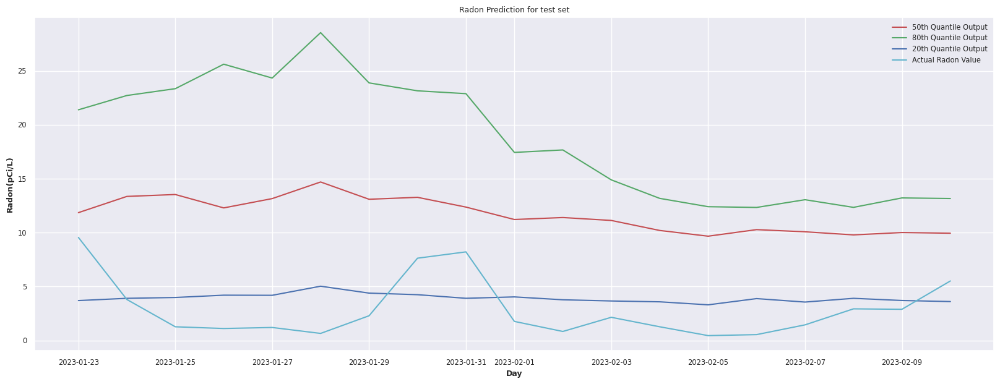

In [152]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()